In [11]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from astropy.io import fits
from astropy.wcs import WCS
import os
import astropy.units as u
import pandas as pd
from astropy.modeling import models, fitting
from astropy.coordinates import SkyCoord
import scipy.signal
import glob
from astropy.stats import sigma_clip
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches
from astropy.wcs.utils import wcs_to_celestial_frame
plt.rcParams.update({'font.size': 17})

%matplotlib inline

In [12]:
#Wavelength dictionary, Å
wvldict = {'Hbeta':4861.35, 'Hgamma':4340.472, 'Hdelta':4101.734, 'Hepsilon':3970.075,
		'OII3727':3727.320, 'OII3729':3729.225, 'OII3727_doublet':3728., 'NeIII3869':3868.760, 'OIII4363':4363.209, 'OIII4959':4959., 'OIII5007':5006.8}

In [13]:
#Load in the data
flux_array = np.load('Data/data_norm.npy')
var_array = np.load('Data/var_norm.npy')
wvl_array = np.load('Data/wvl.npy')
single_wvl_array = wvl_array[:,35,35]

print(single_wvl_array)
#Save data cube as fits file to view data in ds9
hdu = fits.PrimaryHDU(flux_array)
hdulist = fits.HDUList([hdu])
hdulist.writeto('Data/data_sample.fits', overwrite = True)
hdulist.close()

print(np.shape(wvl_array), np.shape(var_array), np.shape(flux_array))

[3700.43954607 3701.26069723 3702.08203061 ... 5096.87189061 5098.00291902
 5099.13419841]
(1446, 80, 67) (1446, 80, 67) (1446, 80, 67)


## Plotting the SED of a single spaxel

#### Code to plot SED

In [14]:
#Choosing a spaxel that looks interesting from ds9 
spaxel_coords_x = 33
spaxel_coords_y = 28

#Selecting spaxel data in each array and double-checking length
spaxel_flux = flux_array[:,spaxel_coords_y,spaxel_coords_x]
print(len(spaxel_flux))
spaxel_wvl = single_wvl_array
print(len(spaxel_wvl))
spaxel_var = var_array[:,spaxel_coords_y,spaxel_coords_x]
print(len(spaxel_var))
print(spaxel_wvl)

test_wvl = spaxel_wvl[35]
test_wvl

1446
1446
1446
[3700.43954607 3701.26069723 3702.08203061 ... 5096.87189061 5098.00291902
 5099.13419841]


3729.288521781827

Text(0, 0.5, 'Flux (F$\\lambda*10^{-16}$)')

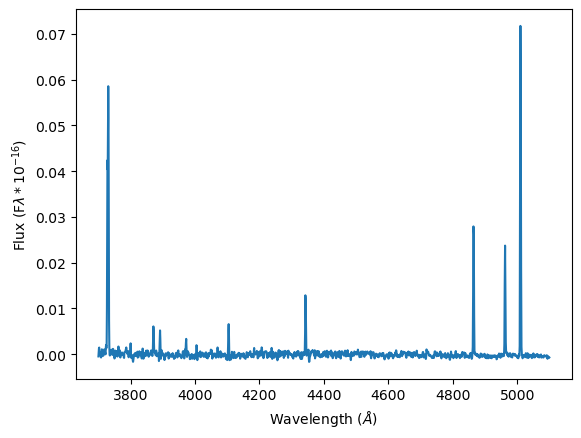

In [5]:
#Plot spectrum of spaxel
#Plotting SED
plt.plot(spaxel_wvl, spaxel_flux)
#Adding axes
plt.xlabel('Wavelength ($\AA$)')
plt.ylabel('Flux (F$\lambda*10^{-16}$)')

#### Function to plot SED and find approximate locations of emission lines

In [15]:
#Function to guess locations and fluxes of emission lines 
def estimate_emline(foldername, linenames, spaxel_coords_y = 28,spaxel_coords_x = 33, makeplot = False):
    """
    Inputs: 
    foldername (str) - name of folder w/data files
    linenames (list) - name(s) of emission line(s) to measure
    spaxel_coords_y (int), spaxel_coords_x (int) - y and x coordinates of chosen spaxel 
    makeplot (bool) - flag to make spaxel spectrum with emline markers

    Outputs -> list of linename, location, wavelength, flux, fwhm, stddev, and redshift for each emline:
    linename (str) - name of line that was measured
    location (int) - index of emline peak in array
    wavelength (float) - wavelength value of emline peak
    flux (float) - max flux of emline 
    fwhm (float) - estimated FWHM
    sigma (float) - estimated standard deviation (using FWHM)
    shift (float) - red or blue shift, redshift if negative, blueshift if positive
 
    Estimates the location and flux of chosen emission line based on max value in array. If makeplot == True, creates spectrum of spaxel with emission line marker.
    """
    print(f'Spaxel [{spaxel_coords_x},{spaxel_coords_y}]')
    out_list = []

    #Loading in data arrays
    flux_array = np.load(foldername + '/data_norm.npy')
    var_array = np.load(foldername + '/var_norm.npy')

    #Selecting spaxel data
    spaxel_flux = flux_array[:,spaxel_coords_y,spaxel_coords_x]
    spaxel_wvl = single_wvl_array
    spaxel_var = var_array[:,spaxel_coords_y,spaxel_coords_x]
    arr_len = len(spaxel_flux)

    #Define an array and fill it with wvl and flux data
    spaxel_arr = np.zeros((2,arr_len))
    spaxel_arr[0] = spaxel_wvl
    spaxel_arr[1] = spaxel_flux

    #Find each line
    for line in linenames:

        #Lookup wvl from linename & select range
        central_wvl = wvldict[line]
        
        wvl_min = int(central_wvl - 7)
        wvl_max = int(central_wvl + 7)
       
        wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
    
        #Look for emline
        line_flux = np.max(flux_range)

        if line_flux == 0.0 or line_flux == np.inf:
            raise TypeError

        line_wvl = wvl_range[np.where(flux_range == line_flux)]
        #print(line_wvl)
       
        line_loc = np.where(spaxel_arr[0] == line_wvl)[0]
        
        
        #FWHM estimation
        #Iterate over wvl values until reaching half max
        half_max = line_flux*.5
        half_max_wvl = spaxel_arr[0][line_loc]

        #Make a copy of line loc so line loc doesn't change with i
        i = np.copy(line_loc)
        while spaxel_arr[1][i] >= half_max:
            half_max_wvl = spaxel_arr[0][i]
            
            i += 1

        fwhm = abs((half_max_wvl - line_wvl)*2)

        if i == line_loc or fwhm < 2:
            #try again with loser conditions to account for observation spacing
            half_max = line_flux*.2
            while spaxel_arr[1][i] >= half_max:
                half_max_wvl = spaxel_arr[0][i]
                
                i += 1

            fwhm = abs((half_max_wvl - line_wvl)*2)

        #check for bad fits
        if fwhm > 10: 
            fwhm = 10

        #print(fwhm)
        #Stddev = FWHM / 2*sqrt(2ln2)
        sigma = fwhm / (2*np.sqrt(2*np.log(2)))
        #print(sigma)
        #Red/blueshift (blue if positive, red if negative)
        shift = central_wvl - line_wvl

        out_list.append([line, line_loc, line_wvl, line_flux, fwhm, sigma, shift])

    #Make plot 
    if makeplot:
        plt.figure(figsize=(12,10))
        
        #Plot SED
        plt.plot(spaxel_wvl, spaxel_flux, label = 'Emission spectrum', color = 'black', linewidth = .7)

        #Adding axes
        plt.xlabel('Wavelength ($\AA$)')
        plt.ylabel('Flux (F$\lambda*10^{-16}$)')

        #Colors to cycle through for emline markers
        colors = ['brown', 'crimson', 'darkorange', 'gold', 'lime', 'forestgreen', 'blue', 'dodgerblue', 'darkviolet', 'fuchsia', 'lightpink', 'slategray']

        #Add emline marker
        for line, color in zip(out_list, colors):
            plt.vlines(x = line[2], ymin = -.005, ymax = line[3] + .005, color = color, label = line[0] + ' - Located', linewidth = .5)
        plt.title('Spaxel Emission Spectrum')
        plt.legend()

    return out_list


#### Test function

Spaxel [33,26]


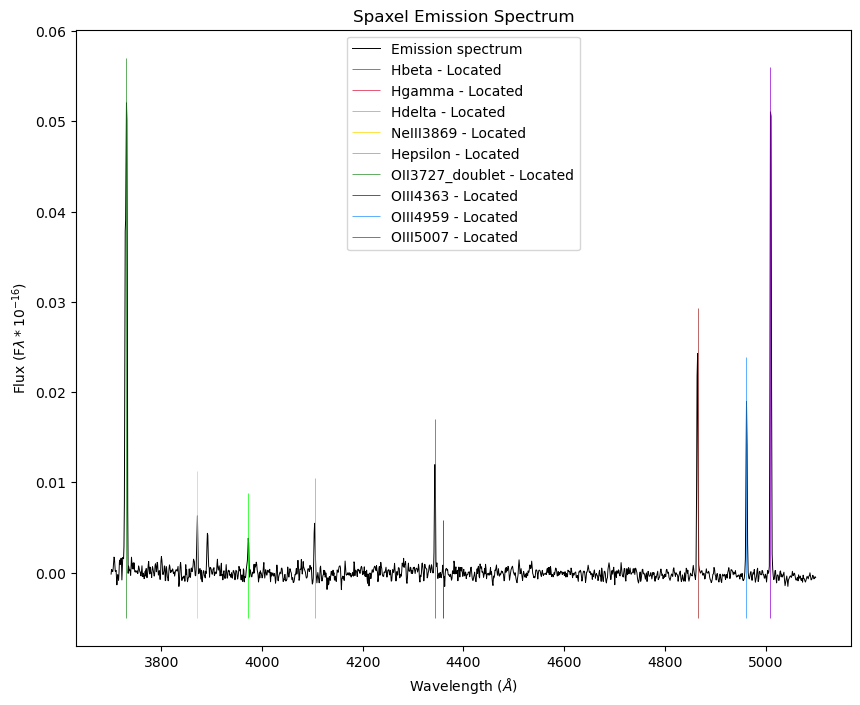

In [7]:
#All emission lines
test = estimate_emline('Data', ['Hbeta', 'Hgamma', 'Hdelta', 'NeIII3869', 'Hepsilon', 'OII3727_doublet', 'OIII4363', 'OIII4959', 'OIII5007'], spaxel_coords_y = 26, spaxel_coords_x = 33, makeplot=True)
#plt.vlines(3890, 0, .05, linewidth = .5)
plt.savefig('All_lines_SED.png')

#4363 not very notable – means more massive and higher metallicity

#### Fit Gaussians to emission lines

In [16]:
#Gaussian fit function
def Gaussian_fit(foldername, linenames, spaxel_coords_y = 28,spaxel_coords_x = 33, xlim = [3650,5150], makeplots = False):
    """
    Inputs: 
    foldername (str) - name of folder w/data files
    linenames (list) - name(s) of emission line(s) to fit gaussians to
    spaxel_coords_y (int), spaxel_coords_x (int) - y and x coordinates of chosen spaxel 
    xlim (list) - lower and upper x limits for gaussian fit plot
    makeplots (bool) - Flag to make emission line model plots

    Outputs -> list of linename, wavelength, flux, stddev, and redshift for each emline:
    linename (str) - name of line that was modeled
    wavelength (float) - wavelength value of model max
    flux (float) - max flux value of model
    stddev (float) - standard deviation of emission line fit
    width (float) - width of line
    N (int) - number of pixels in line width 
    shift (float) - red or blue shift compared with expected wavelength, redshift if negative, blueshift if positive
    g (array) - gaussian model(s) of emission line(s)
 
    Calls estimate function to estimate location and flux of each emission line, fits gaussian curves to each emission line, returns wavelength and flux of peak.
    """
    #Loading in data arrays
    flux_array = np.load(foldername + '/data_norm.npy')

    #Selecting spaxel data
    spaxel_flux = flux_array[:,spaxel_coords_y,spaxel_coords_x]
    spaxel_wvl = single_wvl_array
    arr_len = len(spaxel_flux)

    #Define an array and fill it with wvl and flux data
    spaxel_arr = np.zeros((2,arr_len))
    spaxel_arr[0] = spaxel_wvl
    spaxel_arr[1] = spaxel_flux

    #Set up figure 
    if makeplots:
        plt.figure(figsize=(10,8))
        plt.plot(spaxel_wvl, spaxel_flux, label = 'Emission spectrum', color = 'black', linewidth = .5)
        #plt.scatter(spaxel_wvl, spaxel_flux)
        plt.xlim(xlim[0],xlim[1])
        plt.xlabel('Wavelength ($\AA$)')
        plt.ylabel('Flux (F$\lambda*10^{-16}$)')

        
    #Estimate = [[line, line_loc, line_wvl, line_flux, fwhm, sigma, shift],...]
    estimate = estimate_emline(foldername, linenames, spaxel_coords_y, spaxel_coords_x, makeplot = False)
    outlist = []

    #Set up fitter
    fitter = fitting.LevMarLSQFitter()
    
    #Find each line
    for line in estimate:
        #print(line)
        #Lookup central line wvl and estimated fwhm to select range
        central_wvl = line[2]
        fwhm = line[4]
        
        wvl_min = int(central_wvl - 2*fwhm)
        wvl_max = int(central_wvl + 2*fwhm)

        wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]

        #Generate model 
        g_model = models.Gaussian1D(amplitude = line[3], mean = line[2], stddev = line[5])
        
        try:
            #Fit data
            g = fitter(g_model, wvl_range, flux_range)
            #Wavelengths for plotting
            wvl_sample = np.linspace(wvl_min, wvl_max, num = 500)

            #Calculate width of line and count number of pixels
            width = 2*(g.fwhm)
            N = len(spaxel_arr[0][np.where((spaxel_arr[0] >= (central_wvl - width/2)) & ((spaxel_arr[0] <= (central_wvl + width/2))))])
            
            #Red/blueshift (blue if positive, red if negative)
            shift = central_wvl - g.mean[0]

            #Plot gaussian fit for emission line
            if makeplots:
                plt.plot(wvl_sample, g(wvl_sample), label = line[0] + ' Fit', linewidth = .9)
                #Line region 
                plt.axvspan(xmin = (g.mean - 1.3*g.fwhm), xmax = (g.mean + 1.3*g.fwhm), color = 'red', alpha=0.2)
            
            #Bad fits
            if g.stddev[0] > 10: 
                print(f'Warning: large standard deviation. Fit of {line[0]} in pixel {spaxel_coords_y}, {spaxel_coords_x} was unsuccessful.')
                outlist.append([line[0], central_wvl, line[3], line[5], 2*fwhm, N, 0, None])

            elif g.amplitude[0] < .001:
                print(f'Warning: small amplitude. Fit of {line[0]} in pixel {spaxel_coords_y}, {spaxel_coords_x} may be unsuccessful.')
                outlist.append([line[0], g.mean[0], g.amplitude[0], g.stddev[0], width, N, shift, g])
           
            #Good fit    
            else:
                #Outputs: linename, wvl, flux, stddev, width (defined as 2*fwhm), number of pixels, redshift, gaussian 1d
                outlist.append([line[0], g.mean[0], g.amplitude[0], g.stddev[0], width, N, shift, g])
        except: 
            N = len(spaxel_arr[0][np.where((spaxel_arr[0] >= (central_wvl - fwhm)) & ((spaxel_arr[0] <= (central_wvl + fwhm))))])
            outlist.append([line[0], central_wvl, line[3], line[5], 2*fwhm, N, 0, None])

    #Emission line plot
    if makeplots:
        plt.title('Emission Line Fits')
        plt.legend()
        plt.savefig('Gaussian_fit_spectrum.png')

    return outlist
    
    

Spaxel [33,26]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4864.389417117117, 0.026159734464765497, 1.1019395732119484, 5.18973879082469, 5, array([0.4408476]), <Gaussian1D(amplitude=0.02615973, mean=4864.38941712, stddev=1.10193957)>]]


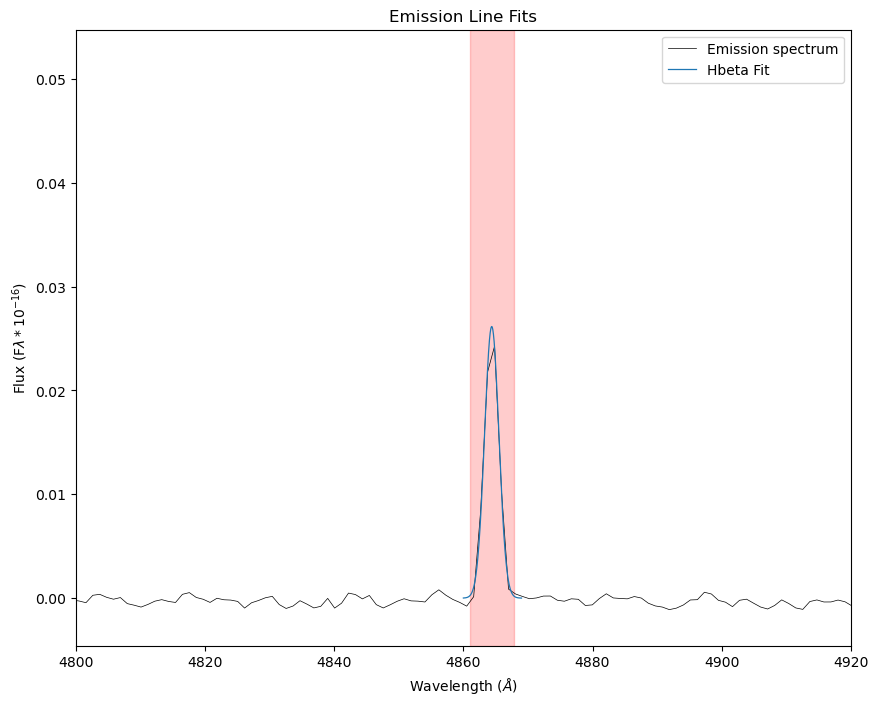

In [48]:
gaus = Gaussian_fit('Data', ['Hbeta'], spaxel_coords_y = 26, spaxel_coords_x = 33, xlim = [4800,4920], makeplots = True)
plt.savefig('Hbeta_example_fit.png')
print(gaus)

In [11]:
for i in range(34,39):
    for j in range(35,40):
        print(Gaussian_fit('Data', ['Hbeta'], spaxel_coords_y = i, spaxel_coords_x = j, makeplots = False))

Spaxel [35,34]
[['Hbeta', 4864.1528226921255, 0.006461936782893428, 1.0598423571326618, 4.991476054297684, 5, array([-0.40185536]), <Gaussian1D(amplitude=0.00646194, mean=4864.15282269, stddev=1.05984236)>]]
Spaxel [36,34]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4864.08181555988, 0.00705842695422616, 1.0283484636952167, 4.843151151172555, 5, array([-0.33084823]), <Gaussian1D(amplitude=0.00705843, mean=4864.08181556, stddev=1.02834846)>]]
Spaxel [37,34]
[['Hbeta', 4863.946997421254, 0.006027981350260203, 1.010414672114507, 4.758689447377231, 5, array([-0.19603009]), <Gaussian1D(amplitude=0.00602798, mean=4863.94699742, stddev=1.01041467)>]]
Spaxel [38,34]
[['Hbeta', 4863.945470179539, 0.004838186974883616, 1.0201365441161756, 4.8044759655067395, 5, array([-0.19450285]), <Gaussian1D(amplitude=0.00483819, mean=4863.94547018, stddev=1.02013654)>]]
Spaxel [39,34]
[['Hbeta', 4863.983967651287, 0.0023607639075120166, 1.1136481408208014, 5.244881930232546, 5, array([-0.23300032]), <Gaussian1D(amplitude=0.00236076, mean=4863.98396765, stddev=1.11364814)>]]
Spaxel [35,35]
[['Hbeta', array([4864.83026472]), 0.007123736244948233, array([0.]), array([0.]), 1, 0, None]]
Spaxel [36,35]
[['Hbeta', 4864.059115758919, 0.009643174048250585, 1.05614303

Spaxel [33,28]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['OII3727_doublet',
  3730.302357956561,
  0.05721197384751221,
  1.9377982008056742,
  9.12633209296422,
  11,
  array([0.64145332]),
  <Gaussian1D(amplitude=0.05721197, mean=3730.30235796, stddev=1.9377982)>],
 ['Hgamma',
  4342.946058434037,
  0.013671393016511036,
  1.0594815912263154,
  4.989776976722028,
  5,
  array([-0.54097236]),
  <Gaussian1D(amplitude=0.01367139, mean=4342.94605843, stddev=1.05948159)>],
 ['Hdelta',
  4104.284096188365,
  0.006933438036671238,
  0.946520620538147,
  4.457771460556723,
  5,
  array([0.16033179]),
  <Gaussian1D(amplitude=0.00693344, mean=4104.28409619, stddev=0.94652062)>],
 ['Hbeta',
  4864.168550917218,
  0.03069664925425561,
  1.1020389944637627,
  5.1902070291380396,
  5,
  array([-0.41758359]),
  <Gaussian1D(amplitude=0.03069665, mean=4864.16855092, stddev=1.10203899)>]]

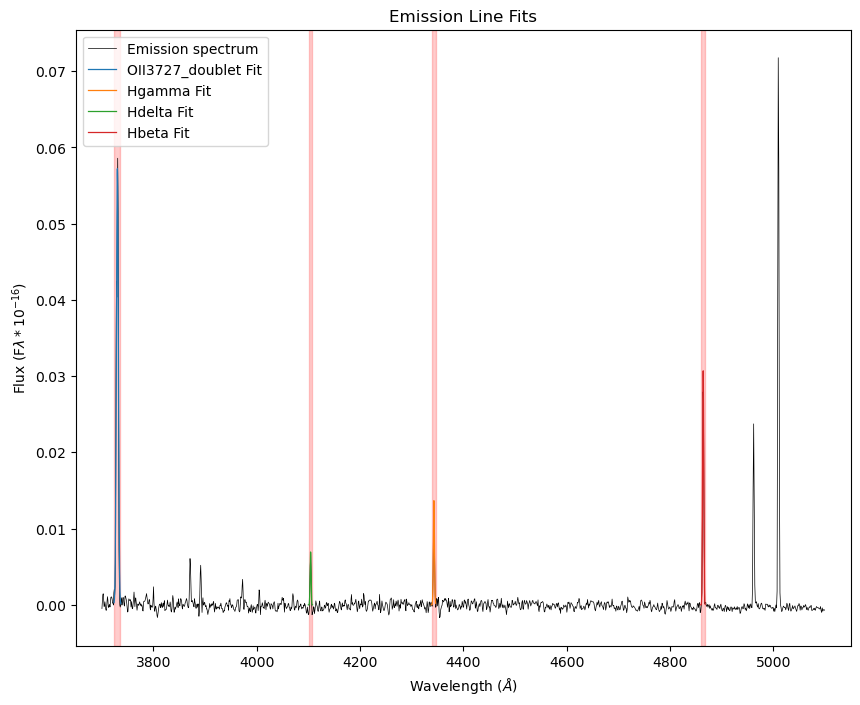

In [12]:
Gaussian_fit('Data', ['OII3727_doublet', 'Hgamma', 'Hdelta', 'Hbeta'], spaxel_coords_y = 28, spaxel_coords_x = 33, makeplots = True)

## Calculating the S/N ratio 

#### Calculating S/N of One Emission Line

Spaxel [33,28]
[['Hbeta', 4864.168550917218, 0.03069664925425561, 1.1020389944637627, 5.1902070291380396, 5, array([-0.41758359]), <Gaussian1D(amplitude=0.03069665, mean=4864.16855092, stddev=1.10203899)>]]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


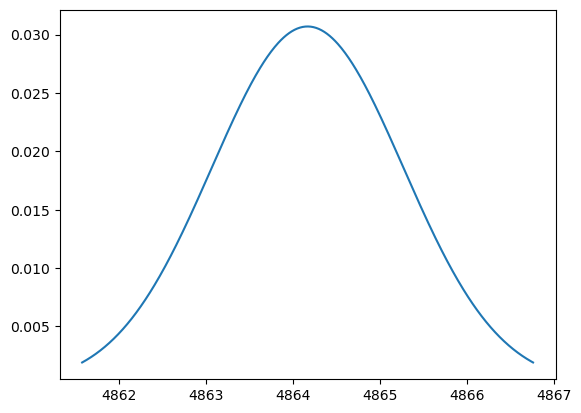

In [13]:
#Signal of one emission line
hbeta = Gaussian_fit('Data', ['Hbeta'], spaxel_coords_y = 28, spaxel_coords_x = 33, makeplots = False)

#Outlist = (linename, wavelength, flux, stddev, width, N, shift, g)
print(hbeta)

#Variables
model_flux = hbeta[0][2]
model_wvl = hbeta[0][1]
width = hbeta[0][4]
N = hbeta[0][5]
g = hbeta[0][7]

#Setting up spaxel array
spaxel_arr = np.zeros((2,len(spaxel_flux)))
spaxel_arr[0] = spaxel_wvl
spaxel_arr[1] = spaxel_flux

wvl_min = model_wvl - g.fwhm
wvl_max = model_wvl + g.fwhm

wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
left_cont_range = wvl_range - 5 * g.stddev
right_cont_range = wvl_range + 5 * g.stddev

flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]

#Sum flux over wvls
flux_sum = 0
flux_em = []

left_wavelengths = []
right_wavelengths = []
left_continuum = []
right_continuum = []

#Calculating sum in signal equation
for wvl in wvl_range:

    flux = spaxel_arr[1][np.where(spaxel_arr[0] == wvl)]

    #Continuum arrays 
    #Find first wvl after starting wvl, look up flux and wvl values and store in arrays

    #Left side, left and 1 are synonymous
    #Starting guess for wavelength
    left_starting_wvl = wvl - 5 * g.stddev 
    #Actual wavelength where there is a flux measurement
    fc_1_wvl = spaxel_arr[0][np.where(spaxel_arr[0] >= left_starting_wvl)[0][0]]
    #Flux value 
    fc_1 = spaxel_arr[1][np.where(spaxel_arr[0] == fc_1_wvl)]
    left_wavelengths.append(fc_1_wvl)
    left_continuum.append(fc_1[0])
    #print(fc_1_wvl)
    #print(fc_1)

    #Right side, right and 2 are synonymous
    #Starting guess for wavelength
    right_starting_wvl = wvl + 5 * g.stddev  
    #Actual wavelength where there is a flux measurement
    fc_2_wvl = spaxel_arr[0][np.where(spaxel_arr[0] >= right_starting_wvl)[0][0]]
    #Flux value
    fc_2 = spaxel_arr[1][np.where(spaxel_arr[0] == fc_2_wvl)]
    right_wavelengths.append(fc_2_wvl)
    right_continuum.append(fc_2[0])
    #print(fc_2_wvl)
    #print(fc_2)
    
    flux_sum += (flux - np.mean([fc_1[0], fc_2[0]]))

    #Flux array 
    flux_em.append(flux)

#Calculate signal of emission
signal = (1/np.sqrt(N))*(flux_sum) #integrated flux



wvl_range = np.linspace(wvl_min, wvl_max, num = 500)

plt.plot(wvl_range, g(wvl_range))



In [14]:
#Noise of the emission line
#Generate random Poisson noise
l = len(flux_em)
P = np.random.poisson(size=l)

#Calculate poisson noise of line
n_p = P * np.sqrt(flux_em)
print(n_p)

#Calculate standard deviation of poisson noise
std_np = np.std(n_p)
print(std_np)


#Calculate standard deviation of continuum bands 
#Fit line to continuums
lin_model = models.Linear1D(slope=0, intercept=0)
fitter = fitting.LinearLSQFitter()
#Linear fit
lin_fit_left = fitter(lin_model, left_wavelengths, left_continuum)
lin_fit_right = fitter(lin_model, right_wavelengths, right_continuum)

#Difference from line to points
left_diff = []
right_diff = []

for index, point in enumerate(left_continuum):

    diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
    left_diff.append(diff_1)

for index, point in enumerate(right_continuum):

    diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
    right_diff.append(diff_2)



sig_1 = np.std(left_diff)
sig_2 = np.std(right_diff)
#std_c1 = np.std(left_continuum)
#std_c2 = np.std(right_continuum)

#Calculate noise of emission
noise_em = np.sqrt((np.mean([sig_1,sig_2]))**2 + (std_np)**2)
print(noise_em)

#Poisson noise dominant source of error

[[0.         0.0398539  0.         0.0398539  0.11956169]
 [0.         0.11347531 0.         0.11347531 0.34042593]
 [0.         0.16712739 0.         0.16712739 0.50138217]
 [0.         0.16182459 0.         0.16182459 0.48547376]
 [0.         0.0925568  0.         0.0925568  0.2776704 ]]
0.14397455394666295
0.14397493916206702


In [16]:
#S/N of emission line 
SN = signal/noise_em
print(SN)

[0.24118509]


#### Function to Calculate SN (with Poisson Noise)

In [17]:
def calculate_SN_p(foldername = 'Data', linenames = [], spaxel_coords_y = 28, spaxel_coords_x = 33, xlim = [3650,5150], makeplots = False, suppress_output = False):
    """
    Inputs: 
    foldername (str) - name of folder w/data files
    linenames (list) - name(s) of emission line(s) to measure
    spaxel_coords_y (int), spaxel_coords_x (int) - y and x coordinates of chosen spaxel 
    xlim (list) - lower and upper x limits for gaussian fit plot
    makeplots (bool) - flag to make all plots 
    supress_output (bool) - flag to suppress all text output

    Outputs:
    SN (list) - list of SN for every inputted line
 
    Calculates the S/N of inputted emission lines with poisson noise. 
    """
    if not suppress_output:
        print('Fitting Gaussian models to lines...')
    fit = Gaussian_fit(foldername, linenames, spaxel_coords_y, spaxel_coords_x, xlim, makeplots)
    #Outlist = (linename, wavelength, flux, stddev, width, N, shift, g)
    
    signal_list = []
    noise_list = []
    SN = []

    #Data arrays
    flux_array = np.load(foldername + '/data_norm.npy')
    var_array = np.load(foldername + '/var_norm.npy')
    wvl_array = np.load(foldername + '/wvl.npy')

    #Selecting spaxel data
    spaxel_flux = flux_array[:,spaxel_coords_y,spaxel_coords_x]
    spaxel_wvl = single_wvl_array
    spaxel_var = var_array[:,spaxel_coords_y,spaxel_coords_x]
    
    #Gaussian fit subplots
    if makeplots:
            fig, ax = plt.subplots(1, len(linenames), figsize = (4*len(linenames), 8))
    #Plot counter 
    i = 0

    #Calculating singal
    if not suppress_output:
        print('Calculating signal to noise ratio of the emission...')
    for line in fit:
        if not suppress_output:
            print('Calculating the signal of ' + line[0] + '...')

        #Variables
        # model_flux = line[2]
        model_wvl = line[1]
        # width = line[4]
        N = line[5]
        g = line[7]

        #Setting up spaxel array
        spaxel_arr = np.zeros((2,len(spaxel_flux)))
        spaxel_arr[0] = spaxel_wvl
        spaxel_arr[1] = spaxel_flux

        wvl_min = model_wvl - g.fwhm
        wvl_max = model_wvl + g.fwhm
        
        wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        
        #Error array
        var_range = spaxel_var[np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        y_err = np.sqrt(var_range)

        # left_cont_range = wvl_range - 5 * g.stddev
        # right_cont_range = wvl_range + 5 * g.stddev

        flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]

        #Sum flux over wvls
        flux_sum = 0
        flux_em = []

        left_wavelengths = []
        right_wavelengths = []
        left_continuum = []
        right_continuum = []

        #Calculating sum in signal equation
        for wvl in wvl_range:

            flux = spaxel_arr[1][np.where(spaxel_arr[0] == wvl)]

            #Continuum arrays 
            #Find first wvl after starting wvl, look up flux and wvl values and store in arrays

            #Left side, left and 1 are synonymous
            #Starting guess for wavelength
            left_starting_wvl = wvl - 5 * g.stddev 
            #Actual wavelength where there is a flux measurement
            fc_1_wvl = spaxel_arr[0][np.where(spaxel_arr[0] >= left_starting_wvl)[0][0]]
            #Flux value 
            fc_1 = spaxel_arr[1][np.where(spaxel_arr[0] == fc_1_wvl)]
            left_wavelengths.append(fc_1_wvl)
            left_continuum.append(fc_1[0])
            #print(fc_1_wvl)
            #print(fc_1)

            #Right side, right and 2 are synonymous
            #Starting guess for wavelength
            right_starting_wvl = wvl + 5 * g.stddev  
            #Actual wavelength where there is a flux measurement
            fc_2_wvl = spaxel_arr[0][np.where(spaxel_arr[0] >= right_starting_wvl)[0][0]]
            #Flux value
            fc_2 = spaxel_arr[1][np.where(spaxel_arr[0] == fc_2_wvl)]
            right_wavelengths.append(fc_2_wvl)
            right_continuum.append(fc_2[0])
            #print(fc_2_wvl)
            #print(fc_2)
            
            flux_sum += (flux - np.mean([fc_1[0], fc_2[0]]))

            #Flux array 
            flux_em.append(flux)

        #Calculate signal of emission
        signal = (1/np.sqrt(N))*(flux_sum) #integrated flux

        signal_list.append(signal)


        #Subplots of guassian models 
        if makeplots:
            lin_wvl_range = np.linspace(wvl_min, wvl_max, num = 500)
            
            if len(linenames) > 1:
                ax[i].plot(lin_wvl_range, g(lin_wvl_range))
                ax[i].errorbar(wvl_range, flux_range, y_err, ecolor = 'black', barsabove = True)
                ax[i].set_ylabel('Flux (F$\lambda*10^{-16}$)')
                ax[i].set_xlabel('Wavelength ($\AA$)')
                ax[i].set_title(line[0] + ' Gaussian Fit')
                
            else:
                ax.plot(lin_wvl_range, g(lin_wvl_range))
                ax.errorbar(wvl_range, flux_range, y_err, ecolor = 'black', barsabove = True)
                ax.set_ylabel('Flux (F$\lambda*10^{-16}$)')
                ax.set_xlabel('Wavelength ($\AA$)')
                ax.set_title(line[0] + ' Gaussian Fit')

        if not suppress_output:
            print('Calculating the noise of ' + line[0] +'...')
        #Noise of the emission line
        #Generate random Poisson noise
        l = len(flux_em)
        P = np.random.poisson(size=l)
        if not suppress_output:
            print(P.shape)
        
        #Calculate poisson noise of line
        n_p = P * np.sqrt(flux_em).T

        if not suppress_output:
            print('np:',n_p)
            print(n_p.shape)
            print('s',np.sqrt(flux_em))
            print(np.sqrt(flux_em).shape)


        #Calculate standard deviation of poisson noise
        std_np = np.std(n_p)
        #print(std_np)


        #Calculate standard deviation of continuum bands 
        #Fit line to continuums
        lin_model = models.Linear1D(slope=0, intercept=0)
        fitter = fitting.LinearLSQFitter()
        #Linear fit
        lin_fit_left = fitter(lin_model, left_wavelengths, left_continuum)
        lin_fit_right = fitter(lin_model, right_wavelengths, right_continuum)

        #Difference from line to points
        left_diff = []
        right_diff = []


        #### np.array(left_continuum)
        #### subtract entire array from left_continuum (instead of for loop)
        
        for index, point in enumerate(left_continuum):

            diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
            left_diff.append(diff_1)

        for index, point in enumerate(right_continuum):

            diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
            right_diff.append(diff_2)

        sig_1 = np.std(left_diff)
        sig_2 = np.std(right_diff)

        #Calculate noise of emission
        noise_em = np.sqrt((np.mean([sig_1,sig_2]))**2 + (std_np)**2)

        noise_list.append(noise_em)

        SN.append(signal / noise_em)
         
        i += 1

    return SN

   

    


#### Testing the SN Calculation Function

Fitting Gaussian models to lines...
Spaxel [33,28]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
Calculating the noise of Hbeta...
(5,)
np: [[0.         0.11347531 0.16712739 0.48547376 0.0925568 ]]
(1, 5)
s [[0.0398539 ]
 [0.11347531]
 [0.16712739]
 [0.16182459]
 [0.0925568 ]]
(5, 1)
Calculating the signal of Hgamma...
Calculating the noise of Hgamma...
(6,)
np: [[0.         0.06637247 0.         0.         0.15950514 0.07392894]]
(1, 6)
s [[0.02408657]
 [0.06637247]
 [0.11345909]
 [0.10853206]
 [0.07975257]
 [0.03696447]]
(6, 1)
Calculating the signal of Hdelta...
Calculating the noise of Hdelta...
(5,)
np: [[0.         0.07158493 0.08106729 0.06418229 0.05081879]]
(1, 5)
s [[0.04184452]
 [0.07158493]
 [0.08106729]
 [0.06418229]
 [0.0169396 ]]
(5, 1)
Calculating the signal of OII3727_doublet...
Calculating the noise of OII3727_doublet...
(11,)
np: [[0.04913996 0.         0.         0.         0.20089939 0.67702318
  0.         0.22704528 0.         0.08555464 0.        ]]
(1, 11)
s [[0.049139

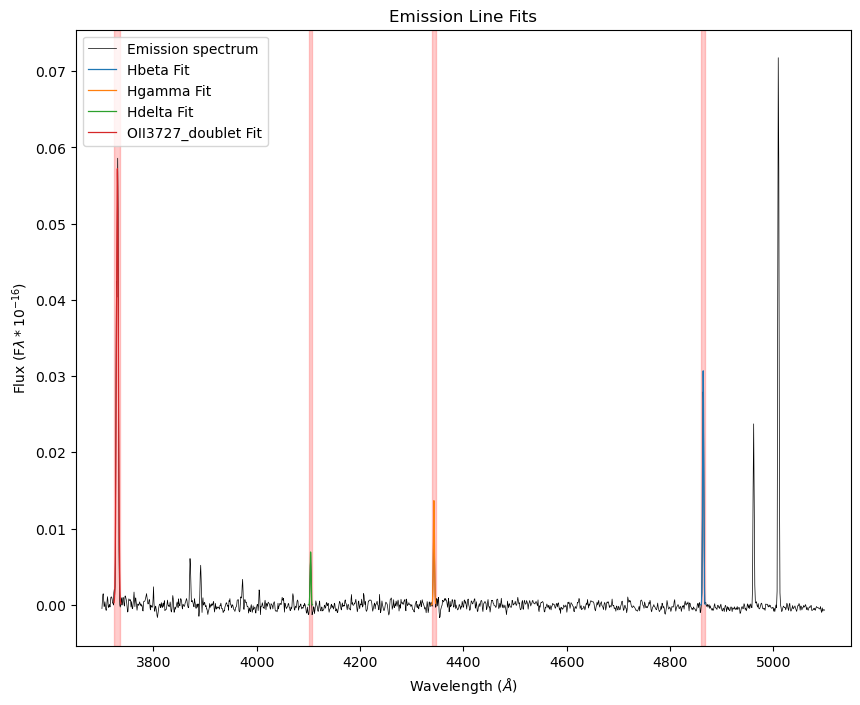

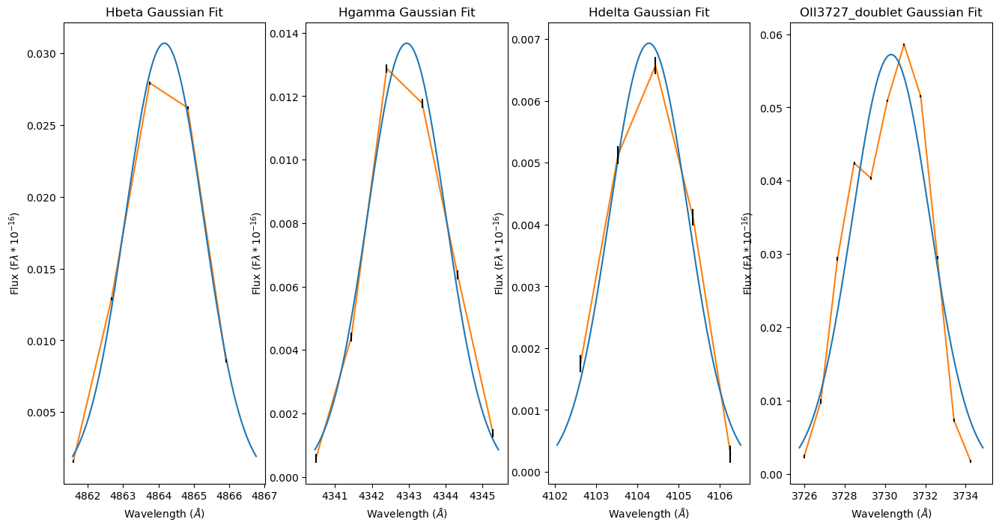

In [18]:
calculate_SN_p('Data', ['Hbeta', 'Hgamma', 'Hdelta', 'OII3727_doublet'], spaxel_coords_y = 28, spaxel_coords_x = 33, makeplots = True)
plt.savefig('spaxel_spectrum.png')

#### Histograms of SN Values

Fitting Gaussian models to lines...


Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
Calculating the noise of Hbeta...
(5,)
np: [[0.0398539  0.11347531 0.33425478 0.         0.2776704 ]]
(1, 5)
s [[0.0398539 ]
 [0.11347531]
 [0.16712739]
 [0.16182459]
 [0.0925568 ]]
(5, 1)
Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
Calculating the noise of Hbeta...
(5,)
np: [[0.         0.11347531 0.16712739 0.         0.        ]]
(1, 5)
s [[0.0398539 ]
 [0.11347531]
 [0.16712739]
 [0.16182459]
 [0.0925568 ]]
(5, 1)
Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
Calculating the noise of Hbeta...
(5,)
np: [[0.0398539  0.         0.         0.16182459 0.0925568 ]]
(1, 5)
s [[0.0398539 ]
 [0.11347531]
 [0.16712739]
 [0.16182459]
 [0.0925568 ]]
(5, 1)
Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculat

(array([9.640e+02, 3.021e+03, 1.875e+03, 1.459e+03, 1.532e+03, 3.040e+02,
        3.930e+02, 4.200e+01, 2.030e+02, 3.700e+01, 1.300e+01, 3.000e+00,
        0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 8.000e+01]),
 array([0.08563479, 0.1902415 , 0.29484822, 0.39945494, 0.50406165,
        0.60866837, 0.71327509, 0.8178818 , 0.92248852, 1.02709523,
        1.13170195, 1.23630867, 1.34091538, 1.4455221 , 1.55012881,
        1.65473553, 1.75934225, 1.86394896, 1.96855568, 2.0731624 ,
        2.17776911]),
 <BarContainer object of 20 artists>)

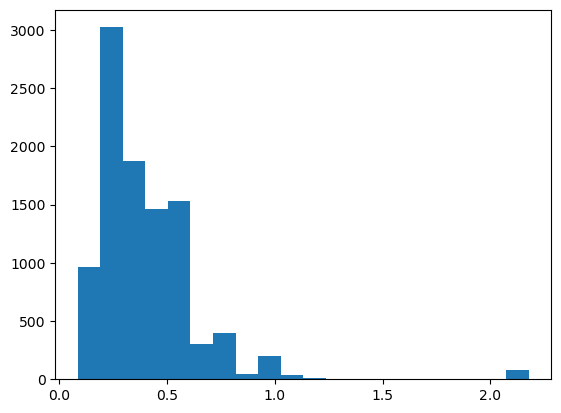

In [ ]:
SN_list = []
for i in range(10000):
    SN = calculate_SN_p('Data', ['Hbeta'], 28, 33, False)[0][0]
    if SN < 40:
        SN_list.append(SN)
    
plt.hist(SN_list, bins = 20)

Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3729...
Calculating the noise of OII3729...
(11,)
np: [[0.         0.         0.1885323  0.         0.20852027 0.23425685
  0.         0.2135486  0.14602344 0.06644669 0.02929672]]
(1, 11)
s [[0.07193051]
 [0.1305234 ]
 [0.1885323 ]
 [0.20429501]
 [0.20852027]
 [0.23425685]
 [0.241928  ]
 [0.2135486 ]
 [0.14602344]
 [0.06644669]
 [0.02929672]]
(11, 1)
Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3729...
Calculating the noise of OII3729...
(11,)
np: [[0.07193051 0.39157019 0.1885323  0.20429501 0.41704053 0.70277054
  0.241928   0.2135486  0.         0.         0.        ]]
(1, 11)
s [[0.07193051]
 [0.1305234 ]
 [0.1885323 ]
 [0.20429501]
 [0.20852027]
 [0.23425685]
 [0.241928  ]
 [0.2135486 ]
 [0.14602344]
 [0.06644669]
 [0.02929672]]
(11, 1)
Fitting Gaussian models to lines...
Calculating signal t

(array([ 21., 161., 262., 226., 160.,  55.,  53.,  44.,   8.,   6.,   1.,
          0.,   0.,   1.,   0.,   1.,   0.,   0.,   0.,   1.]),
 array([0.05870176, 0.09254962, 0.12639749, 0.16024535, 0.19409321,
        0.22794108, 0.26178894, 0.2956368 , 0.32948467, 0.36333253,
        0.39718039, 0.43102826, 0.46487612, 0.49872398, 0.53257185,
        0.56641971, 0.60026757, 0.63411543, 0.6679633 , 0.70181116,
        0.73565902]),
 <BarContainer object of 20 artists>)

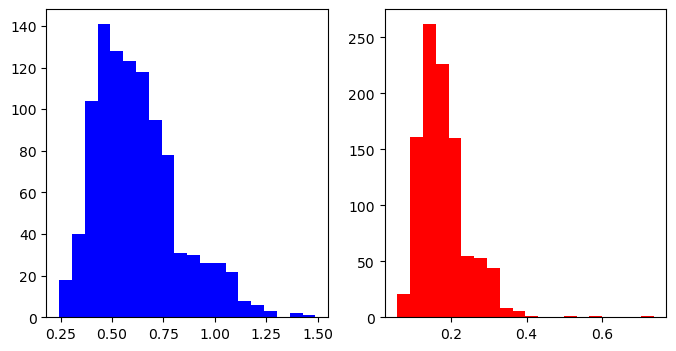

In [ ]:
#Testing code on high SNR [y,x = (29,23)] vs. low SNR [y,x = (57,16)], using OII3729 emission line (best image in DS9)
#High SN
figure, axs = plt.subplots(1,2, figsize = (8, 4))
high_SN_list = []
for i in range(1000):
    high_SN = calculate_SN_p('Data', ['OII3729'], 29, 23, False)[0][0]
    high_SN_list.append(high_SN)
axs[0].hist(high_SN_list, bins = 20, color = 'blue')

#Low SN
low_SN_list = []
for i in range(1000):
    low_SN = calculate_SN_p('Data', ['OII3729'], 57, 16, False)[0][0]
    low_SN_list.append(low_SN)
axs[1].hist(low_SN_list, bins = 20, color = 'red')

Fitting Gaussian models to lines...


23 29
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3729...
Calculating the noise of OII3729...
(11,)
np: [[0.21579152 0.26104679 0.1885323  0.61288502 0.         0.
  0.         0.2135486  0.         0.06644669 0.05859344]]
(1, 11)
s [[0.07193051]
 [0.1305234 ]
 [0.1885323 ]
 [0.20429501]
 [0.20852027]
 [0.23425685]
 [0.241928  ]
 [0.2135486 ]
 [0.14602344]
 [0.06644669]
 [0.02929672]]
(11, 1)


0.5471841661224859

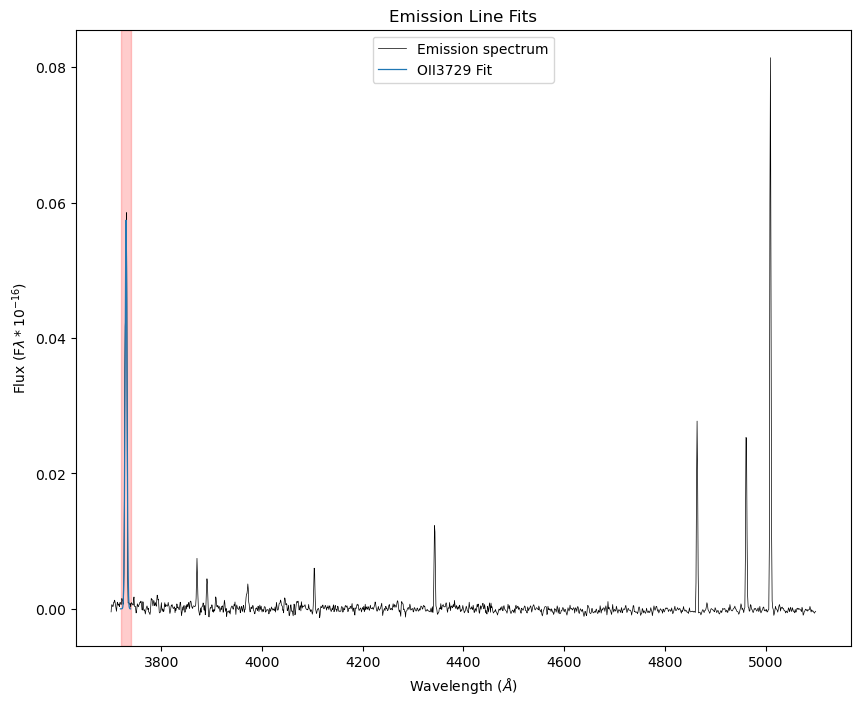

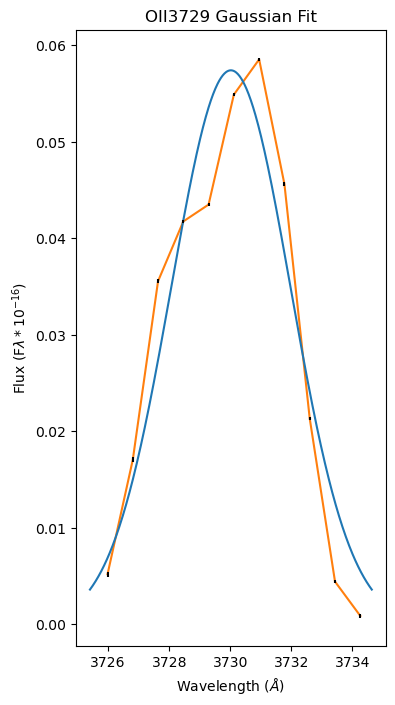

In [158]:
calculate_SN_p('Data', ['OII3729'], 29, 23, True)[0][0]

Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3729...
Calculating the noise of OII3729...
(11,)
np: [[0.         0.         0.         0.20429501 0.83408107 0.23425685
  0.48385599 0.2135486  0.29204688 0.         0.        ]]
(1, 11)
s [[0.07193051]
 [0.1305234 ]
 [0.1885323 ]
 [0.20429501]
 [0.20852027]
 [0.23425685]
 [0.241928  ]
 [0.2135486 ]
 [0.14602344]
 [0.06644669]
 [0.02929672]]
(11, 1)
Fitting Gaussian models to lines...
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3729...
Calculating the noise of OII3729...
(11,)
np: [[0.07193051 0.26104679 0.56559689 0.20429501 0.         0.
  0.241928   0.2135486  0.         0.         0.02929672]]
(1, 11)
s [[0.07193051]
 [0.1305234 ]
 [0.1885323 ]
 [0.20429501]
 [0.20852027]
 [0.23425685]
 [0.241928  ]
 [0.2135486 ]
 [0.14602344]
 [0.06644669]
 [0.02929672]]
(11, 1)
Fitting Gaussian models to lines...
Calculating signal to noise 

(array([ 3.,  9., 27., 36., 48., 46., 55., 46., 41., 25., 15.,  1.,  7.,
        14., 12.,  7.,  4.,  1.,  0.,  1.,  0.,  0.,  1.,  0.,  0.,  0.,
         0.,  0.,  0.,  1.]),
 array([0.06468313, 0.08080412, 0.09692511, 0.1130461 , 0.12916709,
        0.14528808, 0.16140907, 0.17753006, 0.19365105, 0.20977204,
        0.22589304, 0.24201403, 0.25813502, 0.27425601, 0.290377  ,
        0.30649799, 0.32261898, 0.33873997, 0.35486096, 0.37098195,
        0.38710294, 0.40322393, 0.41934492, 0.43546591, 0.4515869 ,
        0.46770789, 0.48382889, 0.49994988, 0.51607087, 0.53219186,
        0.54831285]),
 <BarContainer object of 30 artists>)

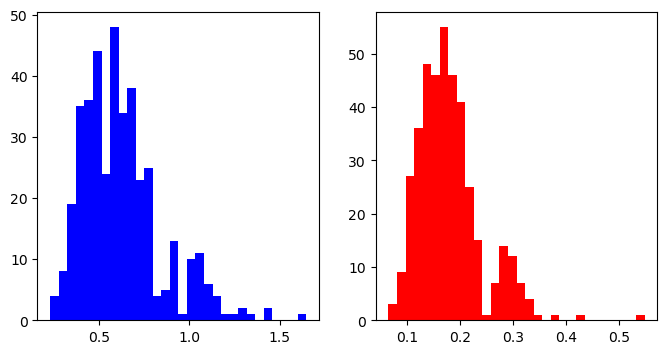

In [ ]:
#Testing code on high SNR [y,x = (29,23)] vs. low SNR [y,x = (57,16)], using OII3729 emission line (best image in DS9)
#High SN
figure, axs = plt.subplots(1,2, figsize = (8, 4))
high_SN_list = []
for i in range(400):
    high_SN = calculate_SN_p('Data', ['OII3729'], 29, 23, False)[0][0]
    high_SN_list.append(high_SN)
axs[0].hist(high_SN_list, bins = 30, color = 'blue')

#Low SN
low_SN_list = []
for i in range(400):
    low_SN = calculate_SN_p('Data', ['OII3729'], 57, 16, False)[0][0]
    low_SN_list.append(low_SN)
axs[1].hist(low_SN_list, bins = 30, color = 'red')

#### Function to Create SN Value Histograms

In [159]:
def plot_hist_p(foldername = 'Data', linenames = ['Hbeta'], n = 100, spaxel_coords_y = [28], spaxel_coords_x = [33], makeplots = False, suppress_output = False):
    """
    Inputs: 
    foldername (str) - name of folder w/data files
    linenames (list) - name(s) of emission line(s) to measure
    n (int) - number of samples for each histogram
    spaxel_coords_y (list), spaxel_coords_x (list) - y and x coordinates of spaxels to compare
    makeplots (bool) - flag to make all plots 
    supress_output (bool) - flag to suppress all text output

    Outputs:
    none

    For each emission line, runs S/N calculation n times for each spaxel and plots histograms. 
    """
    #Make sure dimensions match
    if len(spaxel_coords_y) == len(spaxel_coords_x):

        #Create a plot for each emission line
        for line in linenames:

            #Create a subplot for each spaxel
            figure, axs = plt.subplots(1,len(spaxel_coords_y), figsize = (4*len(spaxel_coords_y), 4), sharex = True, sharey = True)
            figure.suptitle(line)

            #Create a histogram for each spaxel
            for index, y_coord in enumerate(spaxel_coords_y):
                SN_list = []
                axs[index].set_title('Pixel ' + str(spaxel_coords_x[index]) + ', ' + str(y_coord))
                if not suppress_output:
                    print(index, y_coord, spaxel_coords_x[index])
                for i in range(0,n):

                    SN = calculate_SN_p(foldername, linenames, y_coord, spaxel_coords_x[index], makeplots, suppress_output)[0][0]
                    if SN < 80:
                        SN_list.append(SN)

                if len(spaxel_coords_y) > 1:
                    axs[index].hist(SN_list, bins = 50)

                else:
                    axs.hist(SN_list, bins = 50)
    
    else:
        print('Dimensions of x and y coordinate lists must match.')

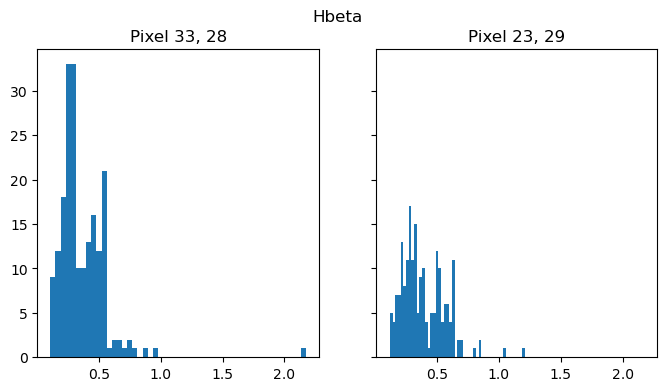

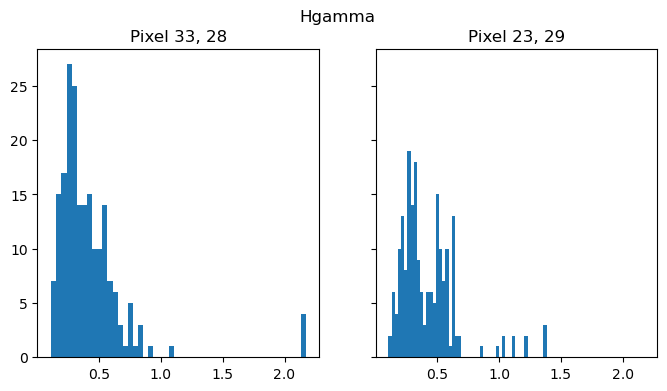

In [ ]:
plot_hist_p('Data', ['Hbeta', 'Hgamma'], 200, [28,29], [33,23], makeplots = False, suppress_output= True)

##

## Recreating SN Calculation Function without Poisson Noise

In [27]:
def calculate_SN(foldername = 'Data', linenames = [], spaxel_coords_y = 28, spaxel_coords_x = 33, xlim = [3650,5150], makeplots = False, suppress_output = False, variance_noise = False):
    """
    Inputs: 
    foldername (str) - name of folder w/data files
    linenames (list) - name(s) of emission line(s) to measure
    spaxel_coords_y (int), spaxel_coords_x (int) - y and x coordinates of chosen spaxel 
    xlim (list) - lower and upper x limits for gaussian fit plot
    makeplots (bool) - flag to make all plots 
    suppress_output (bool) - flag to supress all text output 
    variance_noise (bool) - flag to calculate noise (and S/N) using the variance rather than continuum error

    Outputs:
    SN (list) - list of SN for every inputted line
 
    Calculates the S/N of inputted emission lines without poisson noise. 
    """
    if not suppress_output:
        print('Fitting Gaussian models to lines...')
    try:
        fit = Gaussian_fit(foldername, linenames, spaxel_coords_y, spaxel_coords_x, xlim, makeplots)
    except TypeError:
        SN = 0
        return SN
    if not suppress_output:
        print(fit)
        #Outlist = (linename, wavelength, flux, stddev, width, N, shift, g)
    
    signal_list = []
    noise_list = []
    SN = []

    #Data arrays
    flux_array = np.load(foldername + '/data_norm.npy')
    var_array = np.load(foldername + '/var_norm.npy')
    wvl_array = np.load(foldername + '/wvl.npy')

    #Selecting spaxel data
    spaxel_flux = flux_array[:,spaxel_coords_y,spaxel_coords_x]
    spaxel_wvl = single_wvl_array
    spaxel_var = var_array[:,spaxel_coords_y,spaxel_coords_x]
    
    #Gaussian fit subplots
    if makeplots:
            fig, ax = plt.subplots(1, len(linenames), figsize = (4*len(linenames), 8))
    #Plot counter 
    i = 0

    #Calculating signal
    if not suppress_output:
        print('Calculating signal to noise ratio of the emission...')
    for line in fit:
        if not suppress_output:
            print('Calculating the signal of ' + line[0] + '...')

        #Variables
        model_wvl = line[1]
        g = line[7]

        #Bad fits
        if g == None:
            SN.append(0)
            continue

        #Setting up spaxel array
        spaxel_arr = np.zeros((3,len(spaxel_flux)))
        spaxel_arr[0] = spaxel_wvl
        spaxel_arr[1] = spaxel_flux
        spaxel_arr[2] = spaxel_var

        #wavelength range
        wvl_min = model_wvl - 2*g.fwhm
        wvl_max = model_wvl + 2*g.fwhm
        
        wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        
        #Error array
        var_range = spaxel_arr[2][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        print(var_range)
        y_err = np.sqrt(var_range)

        flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]

        #For flux sum over wvls (signal)
        flux_sum = 0
        flux_em = []

        #For continuum error
        left_wavelengths = []
        right_wavelengths = []
        left_continuum = []
        right_continuum = []
        
        #For variance error
        var = []
        var_sum = 0

        #Calculating sum in signal equation
        for wvl in wvl_range:

            flux = spaxel_arr[1][np.where(spaxel_arr[0] == wvl)]
            variance = spaxel_arr[2][np.where(spaxel_arr[0] == wvl)]
            
            #Continuum arrays 
            #Find first wvl after starting wvl, look up flux and wvl values and store in arrays
            #Left side, left and 1 are synonymous
            #Starting wavelgnth 6 stddev away (to not pick up emission flux)
            left_starting_wvl = wvl - 6 * g.stddev 

            if not suppress_output:
                print('Left starting wvl: ',left_starting_wvl)
                print('Wavelength flux: ', flux)
                
            #Actual wavelength where there is a flux measurement
            fc_1_wvl = spaxel_arr[0][np.where(spaxel_arr[0] >= left_starting_wvl)[0][0]]
            #Flux value 
            fc_1 = spaxel_arr[1][np.where(spaxel_arr[0] == fc_1_wvl)]
            try:
                fc_1 = fc_1[0]
            except:
                pass
            
            #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
            if -.0008 < fc_1 < .0008:
                left_wavelengths.append(fc_1_wvl)
                left_continuum.append(fc_1)
            else: 
                fc_1 = np.nan

            #Right side, right and 2 are synonymous
            #Starting guess for wavelength
            right_starting_wvl = wvl + 6 * g.stddev  
            if not suppress_output:
                print('Right starting wvl: ',right_starting_wvl)
                print('Wavelength flux: ', flux)

            #Actual wavelength where there is a flux measurement
            fc_2_wvl = spaxel_arr[0][np.where(spaxel_arr[0] >= right_starting_wvl)[0][0]]
            #Flux value
            fc_2 = spaxel_arr[1][np.where(spaxel_arr[0] == fc_2_wvl)]
            try:
                fc_2 = fc_2[0]
            except:
                pass

            #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
            if -.0008 < fc_2 < .0008:
                right_wavelengths.append(fc_2_wvl)
                right_continuum.append(fc_2)
            else: 
                fc_2 = np.nan
            if not suppress_output:
                print('Flux continuum values: ', fc_1, fc_2)
            if not (np.isnan(fc_1) and np.isnan(fc_2)):
                flux_sum += (flux - np.nanmean([fc_1, fc_2]))
            else: 
                flux_sum += flux

            #Calculating the noise a different way, using variance
            var_sum+=variance
            var.append(variance)
                
            #Flux array 
            flux_em.append(flux)
            

        if not suppress_output:
            print('Signal:')
            print(flux_sum)

            try:
                print('Variance:')
                print(var_sum)

                print('Continuum flux mean:')
                print(np.nanmean([fc_1, fc_2]))

            except:
                pass

        #Signal of emission
        signal_list.append(flux_sum)

        #Subplots of guassian models 
        if makeplots:
            #wavelength range + some continuum
            plot_wvl_min = model_wvl - 5*g.fwhm
            plot_wvl_max = model_wvl + 5*g.fwhm
            
            plot_wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= plot_wvl_min) & (spaxel_arr[0] <= plot_wvl_max))]
            
            #Error array
            plot_var_range = spaxel_var[np.where((spaxel_arr[0] >= plot_wvl_min) & (spaxel_arr[0] <= plot_wvl_max))]
            plot_y_err = np.sqrt(plot_var_range)

            plot_flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= plot_wvl_min) & (spaxel_arr[0] <= plot_wvl_max))]
            lin_wvl_range = np.linspace(plot_wvl_min, plot_wvl_max, num = 700)
            
            if len(linenames) > 1:
                ax[i].plot(lin_wvl_range, g(lin_wvl_range))
                ax[i].errorbar(plot_wvl_range, plot_flux_range, plot_y_err, ecolor = 'black', barsabove = True)
                ax[i].set_ylabel('Flux (F$\lambda*10^{-16}$)')
                ax[i].set_xlabel('Wavelength ($\AA$)')
                ax[i].set_title(line[0] + ' Gaussian Fit')
                plt.savefig('emline_gaussian.png')
            else:
                ax.plot(lin_wvl_range, g(lin_wvl_range))
                ax.errorbar(plot_wvl_range, plot_flux_range, plot_y_err, ecolor = 'black', barsabove = True)
                ax.set_ylabel('Flux (F$\lambda*10^{-16}$)')
                ax.set_xlabel('Wavelength ($\AA$)')
                ax.set_title(line[0] + ' Gaussian Fit')
                plt.savefig(linenames[0] + '_gaussian.png')

        if not suppress_output:
            print('Calculating the continuum noise around ' + line[0] +'...')
        
        #Calculate standard deviation of continuum bands 
        #Fit line to continuums
        lin_model = models.Linear1D(slope=0, intercept=0)
        fitter = fitting.LinearLSQFitter()
        
        #Linear fit
        lin_fit_left = fitter(lin_model, left_wavelengths, left_continuum)
        lin_fit_right = fitter(lin_model, right_wavelengths, right_continuum)

        #Difference from line to points
        left_diff = []
        right_diff = []

        for index, point in enumerate(left_continuum):

            diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
            left_diff.append(diff_1)

        for index, point in enumerate(right_continuum):

            diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
            right_diff.append(diff_2)

        sig_1 = np.std(left_diff)
        sig_2 = np.std(right_diff)

        #Calculate noise 
        noise = np.nanmean([sig_1,sig_2])

        noise_list.append(noise)
        if not suppress_output:
            print('noise')
            print(noise)
        sn = flux_sum / noise 

        #Noise using variance
        sn_var = np.sqrt(var_sum)
        if sn_var > 10000: 
            sn_var = 0

        #Masking really bad fits (visually inspected colormaps and fits, these are all pixels at the outskirts of image with terrible fits)
        if sn > 10000: 
            sn = 0
        
        if variance_noise: 
            SN.append(sn_var)
        else:
            SN.append(sn)
        
        i += 1
    if not suppress_output:
        print('SN:', SN)
    
    return SN


In [21]:
#Testing the noise estimation methods 
test = np.array([-2,-1,0,1,2,4,5,7])
pts = np.array([0,1,2,3,4,5,6,7])
lin_model = models.Linear1D(slope=1, intercept=-2)
fitter = fitting.LinearLSQFitter()
lin_fit = fitter(lin_model, pts, test)
diff =[]
for i in range(0,8):
    diff.append(test - lin_fit(pts[1]))
print(np.std(test))
print(np.std(diff))
a = np.nan
b = np.nan
np.nanmean([a,b])
if not (np.isnan(a) and np.isnan(b)): 
    print(a)

2.9154759474226504
2.9154759474226504


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/2595538387.py:14: RuntimeWarning: Mean of empty slice
  np.nanmean([a,b])


In [38]:
#Hbeta S/N of all spaxels

SN_list = []
for i in range (0,67):
    for j in range (0,80):
        SN = calculate_SN('Data', ['Hbeta'], j, i, makeplots = False, suppress_output=True)
        SN_list.append(SN)

Spaxel [0,0]


Spaxel [0,1]
Spaxel [0,2]
Spaxel [0,3]
Spaxel [0,4]
Spaxel [0,5]
Spaxel [0,6]
Spaxel [0,7]
Spaxel [0,8]
Spaxel [0,9]
Spaxel [0,10]
Spaxel [0,11]
Spaxel [0,12]
Spaxel [0,13]
Spaxel [0,14]
Spaxel [0,15]
Spaxel [0,16]
Spaxel [0,17]
Spaxel [0,18]
Spaxel [0,19]
Spaxel [0,20]
Spaxel [0,21]
Spaxel [0,22]
Spaxel [0,23]
Spaxel [0,24]
Spaxel [0,25]
Spaxel [0,26]
Spaxel [0,27]
Spaxel [0,28]
Spaxel [0,29]
Spaxel [0,30]
Spaxel [0,31]
Spaxel [0,32]
Spaxel [0,33]
Spaxel [0,34]
Spaxel [0,35]
Spaxel [0,36]
Spaxel [0,37]
Spaxel [0,38]
Spaxel [0,39]
Spaxel [0,40]
Spaxel [0,41]
Spaxel [0,42]
Spaxel [0,43]
Spaxel [0,44]
Spaxel [0,45]
Spaxel [0,46]
Spaxel [0,47]
Spaxel [0,48]
Spaxel [0,49]
Spaxel [0,50]
Spaxel [0,51]
Spaxel [0,52]
Spaxel [0,53]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:61: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [0,54]
Spaxel [0,55]
Spaxel [0,56]
Spaxel [0,57]
[2.39464932e-08 2.35826383e-08 2.31603883e-08 2.35231728e-08
 2.36499990e-08 2.33449301e-08 2.34483794e-08 2.39269760e-08
 2.41495528e-08]
Spaxel [0,58]
[2.35231728e-08 2.36499990e-08]
Spaxel [0,59]
Spaxel [0,60]
Spaxel [0,61]
Spaxel [0,62]
Spaxel [0,63]
Spaxel [0,64]
Spaxel [0,65]
Spaxel [0,66]
Spaxel [0,67]
Spaxel [0,68]
Spaxel [0,69]
Spaxel [0,70]
Spaxel [0,71]
Spaxel [0,72]
Spaxel [0,73]
Spaxel [0,74]
Spaxel [0,75]
Spaxel [0,76]
Spaxel [0,77]
Spaxel [0,78]
Spaxel [0,79]
Spaxel [1,0]
Spaxel [1,1]
Spaxel [1,2]
Spaxel [1,3]
Spaxel [1,4]
Spaxel [1,5]
Spaxel [1,6]
Spaxel [1,7]
Spaxel [1,8]
Spaxel [1,9]
Spaxel [1,10]
Spaxel [1,11]
Spaxel [1,12]
Spaxel [1,13]
Spaxel [1,14]
Spaxel [1,15]
Spaxel [1,16]
Spaxel [1,17]
Spaxel [1,18]
Spaxel [1,19]
Spaxel [1,20]
Spaxel [1,21]
Spaxel [1,22]
Spaxel [1,23]
Spaxel [1,24]
Spaxel [1,25]
Spaxel [1,26]
Spaxel [1,27]
Spaxel [1,28]
Spaxel [1,29]
Spaxel [1,30]
Spaxel [1,31]
Spaxel [1,32]
Spaxel [1,33]

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:249: RuntimeWarning: divide by zero encountered in divide
  sn = flux_sum / noise


Spaxel [1,61]
Spaxel [1,62]
Spaxel [1,63]
Spaxel [1,64]
Spaxel [1,65]
Spaxel [1,66]
Spaxel [1,67]
Spaxel [1,68]
Spaxel [1,69]
Spaxel [1,70]
Spaxel [1,71]
Spaxel [1,72]
Spaxel [1,73]
Spaxel [1,74]
Spaxel [1,75]
Spaxel [1,76]
Spaxel [1,77]
Spaxel [1,78]
Spaxel [1,79]
Spaxel [2,0]
Spaxel [2,1]
Spaxel [2,2]
Spaxel [2,3]
Spaxel [2,4]
Spaxel [2,5]
Spaxel [2,6]
Spaxel [2,7]
Spaxel [2,8]
Spaxel [2,9]
Spaxel [2,10]
Spaxel [2,11]
Spaxel [2,12]
Spaxel [2,13]
Spaxel [2,14]
Spaxel [2,15]
Spaxel [2,16]
Spaxel [2,17]
Spaxel [2,18]
Spaxel [2,19]
Spaxel [2,20]
Spaxel [2,21]
Spaxel [2,22]
Spaxel [2,23]
Spaxel [2,24]
Spaxel [2,25]
Spaxel [2,26]
Spaxel [2,27]
Spaxel [2,28]
Spaxel [2,29]
Spaxel [2,30]
Spaxel [2,31]
Spaxel [2,32]
Spaxel [2,33]
Spaxel [2,34]
Spaxel [2,35]
Spaxel [2,36]
Spaxel [2,37]
Spaxel [2,38]
Spaxel [2,39]
Spaxel [2,40]
Spaxel [2,41]
Spaxel [2,42]
Spaxel [2,43]
Spaxel [2,44]
Spaxel [2,45]
Spaxel [2,46]


Spaxel [2,47]
Spaxel [2,48]
Spaxel [2,49]
Spaxel [2,50]
Spaxel [2,51]
Spaxel [2,52]
Spaxel [2,53]
Spaxel [2,54]
Spaxel [2,55]
Spaxel [2,56]
Spaxel [2,57]
Spaxel [2,58]
Spaxel [2,59]
[2.31603883e-08 2.35231728e-08]
Spaxel [2,60]
Spaxel [2,61]
Spaxel [2,62]
Spaxel [2,63]
Spaxel [2,64]
Spaxel [2,65]
Spaxel [2,66]
Spaxel [2,67]
Spaxel [2,68]
Spaxel [2,69]
Spaxel [2,70]
Spaxel [2,71]
Spaxel [2,72]
Spaxel [2,73]
Spaxel [2,74]
Spaxel [2,75]
Spaxel [2,76]
Spaxel [2,77]
Spaxel [2,78]
Spaxel [2,79]
Spaxel [3,0]
Spaxel [3,1]
Spaxel [3,2]
Spaxel [3,3]
Spaxel [3,4]
Spaxel [3,5]
Spaxel [3,6]
Spaxel [3,7]
Spaxel [3,8]
Spaxel [3,9]
Spaxel [3,10]
Spaxel [3,11]
Spaxel [3,12]
Spaxel [3,13]
Spaxel [3,14]
Spaxel [3,15]
Spaxel [3,16]
Spaxel [3,17]
Spaxel [3,18]
Spaxel [3,19]
Spaxel [3,20]
Spaxel [3,21]
Spaxel [3,22]
Spaxel [3,23]
Spaxel [3,24]
Spaxel [3,25]
Spaxel [3,26]
Spaxel [3,27]
Spaxel [3,28]
Spaxel [3,29]
Spaxel [3,30]
Spaxel [3,31]
Spaxel [3,32]
Spaxel [3,33]
Spaxel [3,34]
Spaxel [3,35]
Spaxel [3,36

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:243: RuntimeWarning: Mean of empty slice
  noise = np.nanmean([sig_1,sig_2])


Spaxel [4,62]
Spaxel [4,63]
Spaxel [4,64]
Spaxel [4,65]
Spaxel [4,66]
Spaxel [4,67]
Spaxel [4,68]
Spaxel [4,69]
Spaxel [4,70]
Spaxel [4,71]
Spaxel [4,72]
Spaxel [4,73]
Spaxel [4,74]
Spaxel [4,75]
Spaxel [4,76]
Spaxel [4,77]
Spaxel [4,78]
Spaxel [4,79]
Spaxel [5,0]
Spaxel [5,1]
Spaxel [5,2]
Spaxel [5,3]
Spaxel [5,4]
Spaxel [5,5]
Spaxel [5,6]
Spaxel [5,7]
Spaxel [5,8]
Spaxel [5,9]
Spaxel [5,10]
Spaxel [5,11]
Spaxel [5,12]
Spaxel [5,13]
Spaxel [5,14]
Spaxel [5,15]
Spaxel [5,16]
Spaxel [5,17]
Spaxel [5,18]
Spaxel [5,19]
Spaxel [5,20]
Spaxel [5,21]
Spaxel [5,22]
Spaxel [5,23]
Spaxel [5,24]
Spaxel [5,25]
Spaxel [5,26]
Spaxel [5,27]
Spaxel [5,28]
Spaxel [5,29]
Spaxel [5,30]
Spaxel [5,31]
Spaxel [5,32]
Spaxel [5,33]
Spaxel [5,34]
Spaxel [5,35]
Spaxel [5,36]
Spaxel [5,37]
Spaxel [5,38]
Spaxel [5,39]
Spaxel [5,40]
Spaxel [5,41]
Spaxel [5,42]
Spaxel [5,43]
Spaxel [5,44]
[2.07788330e-08 2.11081205e-08 2.09577083e-08 2.08600040e-08
 2.14282827e-08 2.15361111e-08 2.20439026e-08 2.18098367e-08]
Spaxe

In [49]:
print(SN_list)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, [0], 0, 0, 0, [array([12.201104])], [0], 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, [array([4.76923258])], 0, 0, 0, [0], [0], 0, 0, [0], [0], 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, [0], 0, 0, 0, 0, 0, 0, 0, [0], 0, 0, 0, [0], [0], [0], 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, [array([-0.79868873])], [0], 0, [array([14.71236213])], 0, 0, 0, [array([26.02183375])], [ar

In [58]:
Hbeta_SN_list = np.zeros(len(SN_list))
for i,element in enumerate(SN_list):
    try:
        Hbeta_SN_list[i] = element[0][0]
    except:
        try:
            Hbeta_SN_list[i] = element[0]
        except:
            Hbeta_SN_list[i] = element

print(Hbeta_SN_list)

0.0


In [69]:
#OII S/N of all spaxels

OII_SN_list = []
for i in range (0,67):
    for j in range (0,80):
        SN = calculate_SN('Data', ['OII3727'], j, i, makeplots = False, suppress_output=True)
        OII_SN_list.append(SN)

Spaxel [0,0]
Spaxel [0,1]
Spaxel [0,2]
Spaxel [0,3]
Spaxel [0,4]
Spaxel [0,5]
Spaxel [0,6]
Spaxel [0,7]
Spaxel [0,8]
Spaxel [0,9]
Spaxel [0,10]
Spaxel [0,11]
Spaxel [0,12]
Spaxel [0,13]
Spaxel [0,14]
Spaxel [0,15]
Spaxel [0,16]
Spaxel [0,17]
Spaxel [0,18]
Spaxel [0,19]
Spaxel [0,20]
Spaxel [0,21]
Spaxel [0,22]
Spaxel [0,23]
Spaxel [0,24]
Spaxel [0,25]
Spaxel [0,26]
Spaxel [0,27]
Spaxel [0,28]
Spaxel [0,29]
Spaxel [0,30]
Spaxel [0,31]
Spaxel [0,32]
Spaxel [0,33]
Spaxel [0,34]
Spaxel [0,35]
Spaxel [0,36]
Spaxel [0,37]
Spaxel [0,38]
Spaxel [0,39]
Spaxel [0,40]
Spaxel [0,41]
Spaxel [0,42]
Spaxel [0,43]
Spaxel [0,44]
Spaxel [0,45]
Spaxel [0,46]
Spaxel [0,47]
Spaxel [0,48]
Spaxel [0,49]
Spaxel [0,50]
Spaxel [0,51]
Spaxel [0,52]
Spaxel [0,53]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:61: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[6.75998610e-08 6.65997100e-08 6.72771327e-08 7.18843843e-08
 7.31948446e-08 7.66987985e-08 7.90643278e-08 7.50638326e-08
 6.54157401e-08 5.89776401e-08 5.82326923e-08]
Spaxel [0,54]
Spaxel [0,55]
Spaxel [0,56]
Spaxel [0,57]
Spaxel [0,58]
[6.68514049e-08 6.51990809e-08 6.47664770e-08 6.71414107e-08
 6.75998610e-08 6.65997100e-08 6.72771327e-08 7.18843843e-08
 7.31948446e-08 7.66987985e-08]
Spaxel [0,59]
Spaxel [0,60]
Spaxel [0,61]
Spaxel [0,62]
Spaxel [0,63]
Spaxel [0,64]
Spaxel [0,65]
Spaxel [0,66]
Spaxel [0,67]
Spaxel [0,68]
Spaxel [0,69]
Spaxel [0,70]
Spaxel [0,71]
Spaxel [0,72]
Spaxel [0,73]
Spaxel [0,74]
Spaxel [0,75]
Spaxel [0,76]
Spaxel [0,77]
Spaxel [0,78]
Spaxel [0,79]
Spaxel [1,0]
Spaxel [1,1]
Spaxel [1,2]
Spaxel [1,3]
Spaxel [1,4]
Spaxel [1,5]
Spaxel [1,6]
Spaxel [1,7]
Spaxel [1,8]
Spaxel [1,9]
Spaxel [1,10]
Spaxel [1,11]
Spaxel [1,12]
Spaxel [1,13]
Spaxel [1,14]
Spaxel [1,15]
Spaxel [1,16]
Spaxel [1,17]
Spaxel [1,18]
Spaxel [1,19]
Spaxel [1,20]
Spaxel [1,21]
Spaxel [1,22]
S

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:243: RuntimeWarning: Mean of empty slice
  noise = np.nanmean([sig_1,sig_2])


Spaxel [8,32]
Spaxel [8,33]
Spaxel [8,34]
Spaxel [8,35]
Spaxel [8,36]
Spaxel [8,37]
[5.00802883e-08 4.81520505e-08 4.54520621e-08 4.44072761e-08
 4.78408763e-08 5.17296843e-08 5.09870905e-08 5.00540793e-08
 5.23165598e-08 5.41834687e-08 5.17772214e-08 4.96064691e-08
 5.76353360e-08 7.04083898e-08 7.36577889e-08 7.50316482e-08]
Spaxel [8,38]
Spaxel [8,39]
[9.25838741e-08 7.97540817e-08 6.23480407e-08 5.66156013e-08
 5.47650960e-08 5.14264929e-08 4.80524466e-08 4.73907541e-08
 5.07425232e-08 5.53357065e-08 5.85354242e-08]
Spaxel [8,40]
Spaxel [8,41]
[6.23480407e-08 5.66156013e-08 5.47650960e-08 5.14264929e-08
 4.80524466e-08 4.73907541e-08 5.07425232e-08 5.53357065e-08
 5.85354242e-08 5.81738090e-08]
Spaxel [8,42]
[7.42974844e-08 8.26894461e-08 8.38066635e-08 8.92281127e-08
 9.25838741e-08 7.97540817e-08 6.23480407e-08 5.66156013e-08
 5.47650960e-08 5.14264929e-08 4.80524466e-08 4.73907541e-08
 5.07425232e-08 5.53357065e-08 5.85354242e-08 5.81738090e-08
 5.50682708e-08 5.49296257e-08 5.6

Spaxel [14,68]
[3.50617800e-08 3.42247828e-08 3.56170876e-08 4.01800273e-08
 4.56650117e-08 4.91941405e-08 4.81247424e-08 4.72184619e-08
 4.40843629e-08 4.23955903e-08 4.16292468e-08 4.14875946e-08
 3.95324007e-08 3.90937832e-08 3.82445770e-08 3.64728262e-08
 3.76432120e-08 4.03884295e-08 3.94295693e-08 3.89992664e-08
 4.09973669e-08 4.05543995e-08 3.96099059e-08 3.92477860e-08
 3.91793065e-08 4.02785634e-08 4.08381400e-08 4.04257207e-08
 3.77867035e-08 3.53643706e-08 3.45067546e-08 3.40683571e-08
 3.33278785e-08 3.11328319e-08 2.88772222e-08 2.91741996e-08
 3.14282240e-08 3.35369815e-08]
Spaxel [14,69]
[3.94536783e-08 3.97407038e-08 3.76971128e-08 3.50617800e-08
 3.42247828e-08 3.56170876e-08 4.01800273e-08 4.56650117e-08
 4.91941405e-08 4.81247424e-08 4.72184619e-08 4.40843629e-08
 4.23955903e-08 4.16292468e-08 4.14875946e-08 3.95324007e-08
 3.90937832e-08 3.82445770e-08 3.64728262e-08 3.76432120e-08
 4.03884295e-08 3.94295693e-08 3.89992664e-08 4.09973669e-08
 4.05543995e-08 3.96099

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:249: RuntimeWarning: divide by zero encountered in divide
  sn = flux_sum / noise


Spaxel [16,78]
Spaxel [16,79]
Spaxel [17,0]
Spaxel [17,1]
Spaxel [17,2]
Spaxel [17,3]
Spaxel [17,4]
Spaxel [17,5]
Spaxel [17,6]
Spaxel [17,7]
Spaxel [17,8]
Spaxel [17,9]
Spaxel [17,10]
Spaxel [17,11]
[4.08575265e-08 3.97917974e-08 3.93832142e-08 4.17793664e-08
 4.17548677e-08 4.03811071e-08 3.82409623e-08 4.24209512e-08
 5.29824808e-08 5.89065069e-08 5.82720322e-08 6.32405984e-08
 6.47176994e-08 5.00814302e-08 3.60608402e-08 3.33234791e-08
 3.12473262e-08]
Spaxel [17,12]
[3.95644216e-08 3.86544848e-08 3.58912355e-08 3.46288990e-08
 3.80410330e-08 4.08575265e-08 3.97917974e-08 3.93832142e-08
 4.17793664e-08 4.17548677e-08 4.03811071e-08 3.82409623e-08
 4.24209512e-08 5.29824808e-08 5.89065069e-08 5.82720322e-08
 6.32405984e-08 6.47176994e-08 5.00814302e-08 3.60608402e-08
 3.33234791e-08 3.12473262e-08]
Spaxel [17,13]
Spaxel [17,14]
Spaxel [17,15]
Spaxel [17,16]
Spaxel [17,17]
Spaxel [17,18]
[6.32405984e-08 6.47176994e-08 5.00814302e-08 3.60608402e-08
 3.33234791e-08 3.12473262e-08 2.918

In [81]:
OII_SN_list = np.zeros(len(OII_SN_list))
for i,element in enumerate(OII_SN_list):
    try:
        OII_SN_list[i] = element[0][0]
    except:
        try:
            OII_SN_list[i] = element[0]
        except:
            OII_SN_list[i] = element


In [87]:
#OIII S/N of all spaxels

OIII_SN_list = []
for i in range (0,67):
    for j in range (0,80):
        SN = calculate_SN('Data', ['OIII5007'], j, i, makeplots = False, suppress_output=True)
        OIII_SN_list.append(SN)

Spaxel [0,0]
Spaxel [0,1]
Spaxel [0,2]
Spaxel [0,3]
Spaxel [0,4]
Spaxel [0,5]
Spaxel [0,6]
Spaxel [0,7]
Spaxel [0,8]
Spaxel [0,9]
Spaxel [0,10]
Spaxel [0,11]
Spaxel [0,12]
Spaxel [0,13]
Spaxel [0,14]
Spaxel [0,15]
Spaxel [0,16]
Spaxel [0,17]
Spaxel [0,18]
Spaxel [0,19]
Spaxel [0,20]
Spaxel [0,21]
Spaxel [0,22]
Spaxel [0,23]
Spaxel [0,24]
Spaxel [0,25]
Spaxel [0,26]
Spaxel [0,27]
Spaxel [0,28]
Spaxel [0,29]
Spaxel [0,30]
Spaxel [0,31]
Spaxel [0,32]
Spaxel [0,33]
Spaxel [0,34]
Spaxel [0,35]
Spaxel [0,36]
Spaxel [0,37]
Spaxel [0,38]
Spaxel [0,39]
Spaxel [0,40]
Spaxel [0,41]
Spaxel [0,42]
Spaxel [0,43]
Spaxel [0,44]
Spaxel [0,45]
Spaxel [0,46]
Spaxel [0,47]
Spaxel [0,48]
Spaxel [0,49]
Spaxel [0,50]
Spaxel [0,51]
Spaxel [0,52]
Spaxel [0,53]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:61: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [0,54]
Spaxel [0,55]
Spaxel [0,56]
Spaxel [0,57]
Spaxel [0,58]
Spaxel [0,59]
Spaxel [0,60]
Spaxel [0,61]
Spaxel [0,62]
Spaxel [0,63]
Spaxel [0,64]
Spaxel [0,65]
Spaxel [0,66]
Spaxel [0,67]
Spaxel [0,68]
Spaxel [0,69]
Spaxel [0,70]
Spaxel [0,71]
Spaxel [0,72]
Spaxel [0,73]
Spaxel [0,74]
Spaxel [0,75]
Spaxel [0,76]
Spaxel [0,77]
Spaxel [0,78]
Spaxel [0,79]
Spaxel [1,0]
Spaxel [1,1]
Spaxel [1,2]
Spaxel [1,3]
Spaxel [1,4]
Spaxel [1,5]
Spaxel [1,6]
Spaxel [1,7]
Spaxel [1,8]
Spaxel [1,9]
Spaxel [1,10]
Spaxel [1,11]
Spaxel [1,12]
Spaxel [1,13]
Spaxel [1,14]
Spaxel [1,15]
Spaxel [1,16]
Spaxel [1,17]
Spaxel [1,18]
Spaxel [1,19]
Spaxel [1,20]
Spaxel [1,21]
Spaxel [1,22]
Spaxel [1,23]
Spaxel [1,24]
Spaxel [1,25]
Spaxel [1,26]
Spaxel [1,27]
Spaxel [1,28]
Spaxel [1,29]
Spaxel [1,30]
Spaxel [1,31]
Spaxel [1,32]
Spaxel [1,33]
Spaxel [1,34]
Spaxel [1,35]
Spaxel [1,36]
Spaxel [1,37]
Spaxel [1,38]
Spaxel [1,39]
Spaxel [1,40]
Spaxel [1,41]
Spaxel [1,42]
Spaxel [1,43]
Spaxel [1,44]
Spaxel [1,45]
Sp

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:243: RuntimeWarning: Mean of empty slice
  noise = np.nanmean([sig_1,sig_2])


Spaxel [3,45]
[1.91135336e-08 1.77403864e-08]
Spaxel [3,46]
Spaxel [3,47]
Spaxel [3,48]
Spaxel [3,49]
[2.06732830e-08 2.02355825e-08 1.91135336e-08 1.77403864e-08
 1.75387678e-08]
Spaxel [3,50]
[1.99337304e-08 2.11869285e-08]
Spaxel [3,51]
Spaxel [3,52]
Spaxel [3,53]
Spaxel [3,54]
Spaxel [3,55]
Spaxel [3,56]
Spaxel [3,57]
Spaxel [3,58]
Spaxel [3,59]
[2.25167114e-08 2.36089771e-08 2.37608266e-08 2.38983995e-08
 2.37818252e-08 2.30425108e-08 2.20038743e-08 2.23828022e-08
 2.27990251e-08 2.24648371e-08 2.26275008e-08]
Spaxel [3,60]
Spaxel [3,61]
Spaxel [3,62]
Spaxel [3,63]
Spaxel [3,64]
Spaxel [3,65]
Spaxel [3,66]
Spaxel [3,67]
Spaxel [3,68]
Spaxel [3,69]
Spaxel [3,70]
Spaxel [3,71]
Spaxel [3,72]
Spaxel [3,73]
Spaxel [3,74]
Spaxel [3,75]
Spaxel [3,76]
Spaxel [3,77]
Spaxel [3,78]
Spaxel [3,79]
Spaxel [4,0]
Spaxel [4,1]
Spaxel [4,2]
Spaxel [4,3]
Spaxel [4,4]
Spaxel [4,5]
Spaxel [4,6]
Spaxel [4,7]
Spaxel [4,8]
Spaxel [4,9]
Spaxel [4,10]
Spaxel [4,11]
Spaxel [4,12]
Spaxel [4,13]
Spaxel [4,14]

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:249: RuntimeWarning: divide by zero encountered in divide
  sn = flux_sum / noise


Spaxel [15,72]
Spaxel [15,73]
[1.44058354e-08 1.41959293e-08]
Spaxel [15,74]
Spaxel [15,75]
Spaxel [15,76]
Spaxel [15,77]
Spaxel [15,78]
Spaxel [15,79]
Spaxel [16,0]
Spaxel [16,1]
Spaxel [16,2]
Spaxel [16,3]
Spaxel [16,4]
Spaxel [16,5]
Spaxel [16,6]
Spaxel [16,7]
Spaxel [16,8]
Spaxel [16,9]
Spaxel [16,10]
Spaxel [16,11]
Spaxel [16,12]
Spaxel [16,13]
Spaxel [16,14]
Spaxel [16,15]
Spaxel [16,16]
Spaxel [16,17]
[1.67577918e-08 1.21594427e-08 1.17416398e-08 1.17126064e-08
 1.16109577e-08 1.12894411e-08 1.06003216e-08]
Spaxel [16,18]
Spaxel [16,19]
[1.11858772e-08 1.20310887e-08]
Spaxel [16,20]
[1.06003216e-08 9.79688432e-09 9.49244709e-09 1.01707946e-08
 1.11858772e-08 1.20310887e-08 1.21421310e-08 1.20120429e-08
 1.19627981e-08 1.15832272e-08 1.11653505e-08 1.10787914e-08]
Spaxel [16,21]
[1.06003216e-08 9.79688432e-09 9.49244709e-09 1.01707946e-08
 1.11858772e-08 1.20310887e-08 1.21421310e-08 1.20120429e-08
 1.19627981e-08 1.15832272e-08 1.11653505e-08]
Spaxel [16,22]
[9.79688432e-09 9.49

IndexError: index 0 is out of bounds for axis 0 with size 0

(array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0.]),
 array([1.00000000e-03, 4.00097500e+00, 8.00095000e+00, 1.20009250e+01,
        1.60009000e+01, 2.00008750e+01, 2.40008500e+01, 2.80008250e+01,
        3.20008000e+01, 3.60007750e+01, 4.00007500e+01, 4.40007250e+01,
        4.80007000e+01, 5.20006750e+01, 5.60006500e+01, 6.00006250e+01,
        6.40006000e+01, 6.80005750e+01, 7.20005500e+01, 7.60005250e+01,
        8.00005000e+01, 8.40004750e+01, 8.80004500e+01, 9.20004250e+01,
        9.60004000e+01, 1.00000375e+02, 1.04000350e+02, 1.08000325e+02,
        1.12000300e+02, 1.16000275e+02, 1.20000250e+02, 1.24000225e+02,
        1.28000200e+02, 1.32000175e+02, 1.36000150e+02, 1.40000125e+02,
        1.44000100e+02, 1.48000075e+02, 1.52000050e+02, 1.56000025e+02,
        1.60000000e+02]),
 <BarContainer object of 40 artists>)

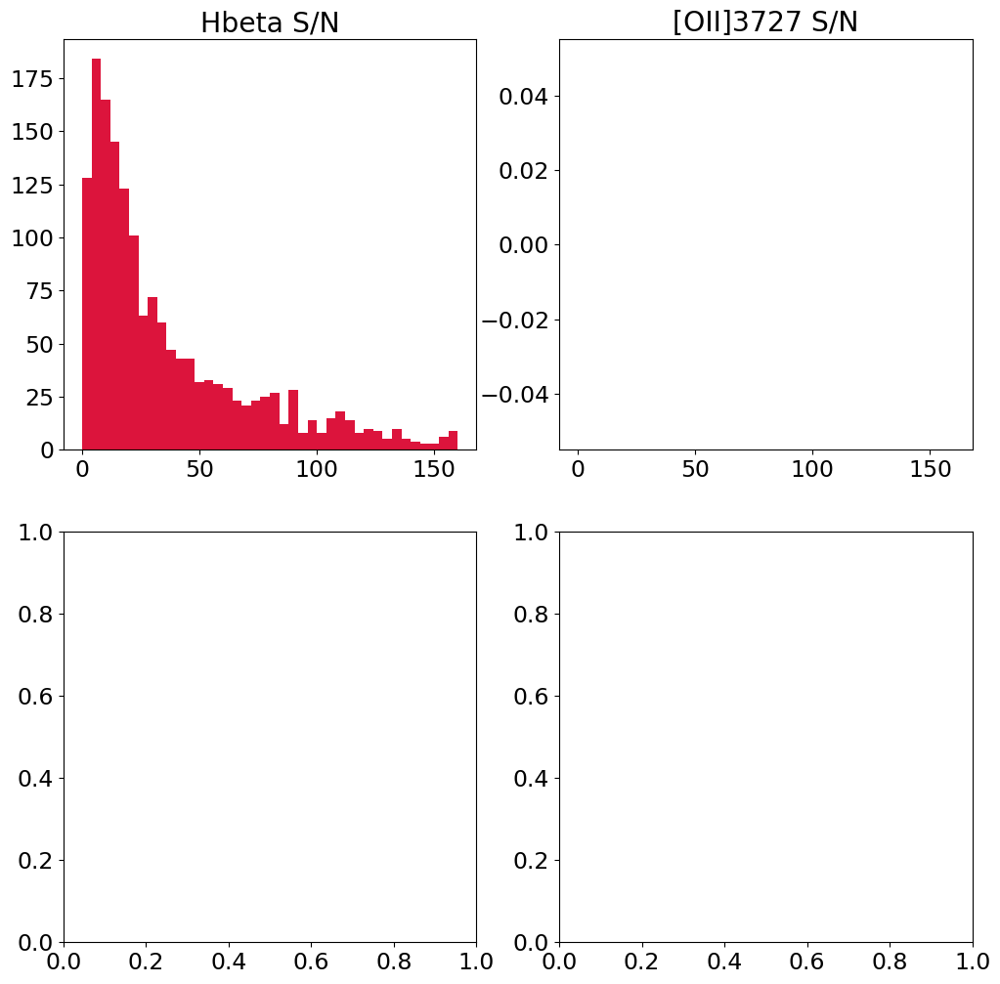

In [86]:
#Making a histogram of the S/N
#Create a subplot for each spaxel
figure, axs = plt.subplots(2,2, figsize = (12,12), sharex = False, sharey = False)
#figure.suptitle('S/N')

#Create a histogram for each emline
axs[0][0].set_title('Hbeta S/N')
axs[0][0].hist(Hbeta_SN_list, bins = 40, range = (0.001,160), color = 'crimson')
axs[0][1].set_title('[OII]3727 S/N')
axs[0][1].hist(OII_SN_list, bins = 40, range = (0.000001,160), color = 'blueviolet')


Fitting Gaussian models to lines...
Spaxel [35,22]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:61: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['OIII4363', array([4362.68580924]), 0.0006442169771228121, array([0.]), array([0.]), 1, 0, None]]
Calculating signal to noise ratio of the emission...
Calculating the signal of OIII4363...
SN: [0]


[0]

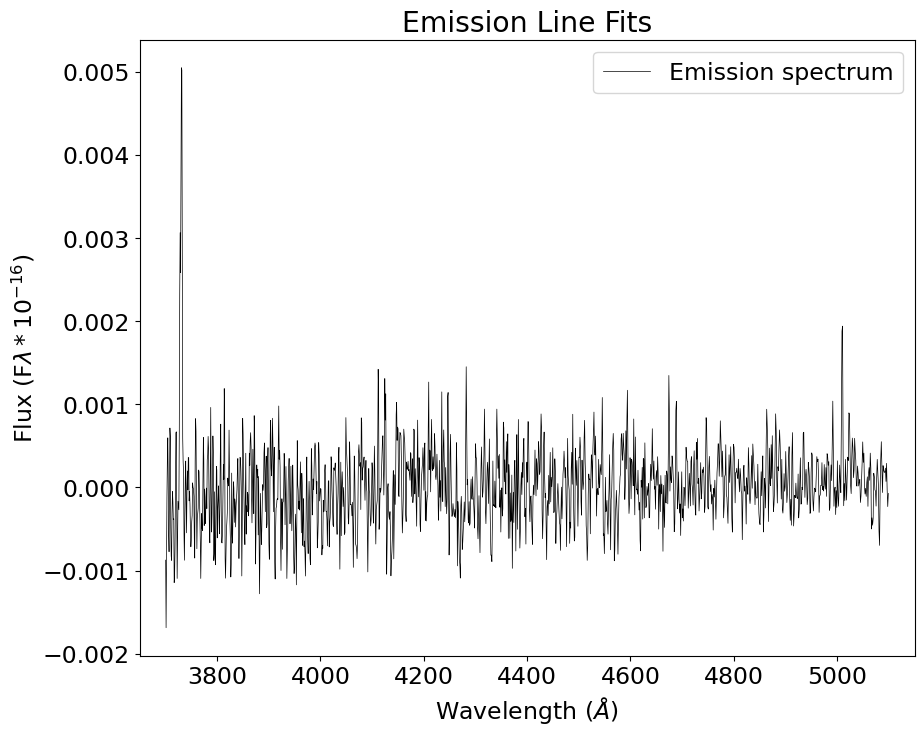

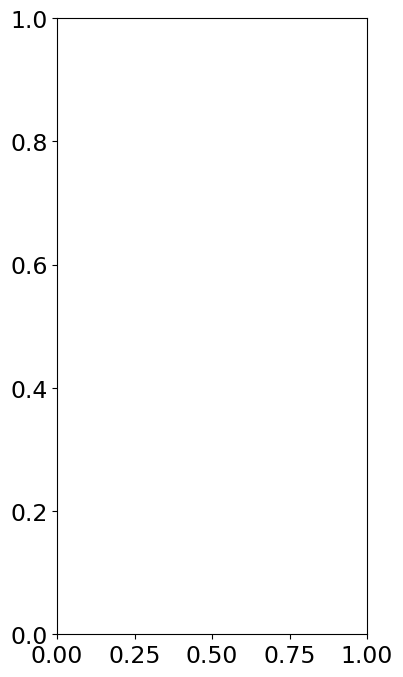

In [32]:
#Edge case
calculate_SN('Data', ['OIII4363'], spaxel_coords_y = 22, spaxel_coords_x = 35, makeplots = True, variance_noise = True)

Fitting Gaussian models to lines...
Spaxel [23,29]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:61: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4863.782332905559, 0.02839822793943947, 1.146832039304231, 5.401166148874649, 5, array([-0.03136558]), <Gaussian1D(amplitude=0.02839823, mean=4863.78233291, stddev=1.14683204)>], ['Hgamma', 4342.780696433283, 0.01324511315511864, 1.081278434605811, 5.092432264138901, 5, array([-0.37561036]), <Gaussian1D(amplitude=0.01324511, mean=4342.78069643, stddev=1.08127843)>], ['OIII5007', 5009.337448394436, 0.0840653001943273, 1.1374865404330592, 5.357152212729351, 5, array([0.08294791]), <Gaussian1D(amplitude=0.0840653, mean=5009.33744839, stddev=1.13748654)>], ['OII3727', 3730.019005583783, 0.05740903766686066, 1.958270421999503, 9.222748886631292, 11, array([0.92480569]), <Gaussian1D(amplitude=0.05740904, mean=3730.01900558, stddev=1.95827042)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
[1.17411038e-08 1.17443756e-08 1.18974125e-08 1.19332982e-08
 1.20476735e-08 1.22314856e-08 1.21376020e-08 1.22499646e-08
 1.25135450e-08 1.23379185e-0

[array([0.00034761]),
 array([0.00042287]),
 array([0.00031682]),
 array([0.00096452])]

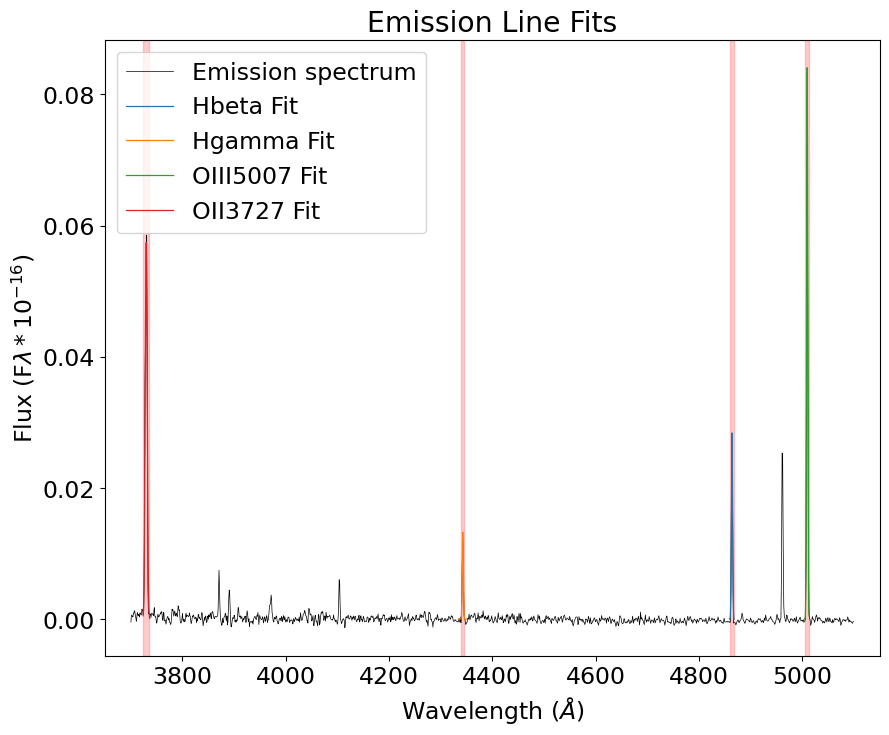

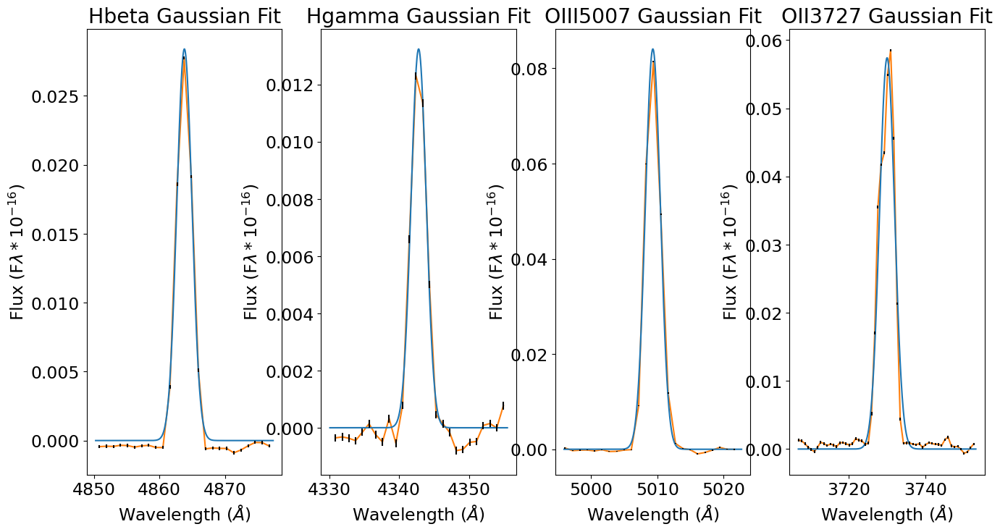

In [34]:
#High S/N spaxel
calculate_SN('Data', ['Hbeta', 'Hgamma', 'OIII5007', 'OII3727'], spaxel_coords_y = 29, spaxel_coords_x = 23, makeplots = True, variance_noise=True)

Fitting Gaussian models to lines...
Spaxel [32,25]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4864.390078488075, 0.018735368092041675, 1.085787126418393, 5.11366657985317, 5, array([0.44018623]), <Gaussian1D(amplitude=0.01873537, mean=4864.39007849, stddev=1.08578713)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
Left starting wvl:  4852.921448992704
Wavelength flux:  [-0.00020237]
Right starting wvl:  4865.950894509725
Flux continuum values:  0.00017481505267053334 0.0004898657366848246
Left starting wvl:  4853.999788898478
Wavelength flux:  [-0.00011979]
Right starting wvl:  4867.029234415499
Flux continuum values:  -4.68021204500361e-05 0.0007966964833715728
Left starting wvl:  4855.078368094761
Wavelength flux:  [0.00034118]
Right starting wvl:  4868.107813611781
Flux continuum values:  0.00011614070200468164 0.0004494286744698168
Left starting wvl:  4856.157186634643
Wavelength flux:  [0.00565591]
Right starting wvl:  4869.186632151664
Flux continuum values:  0.0006132284874447742 4.0475803322582386e-05
Left starting 

[array([187.90701683])]

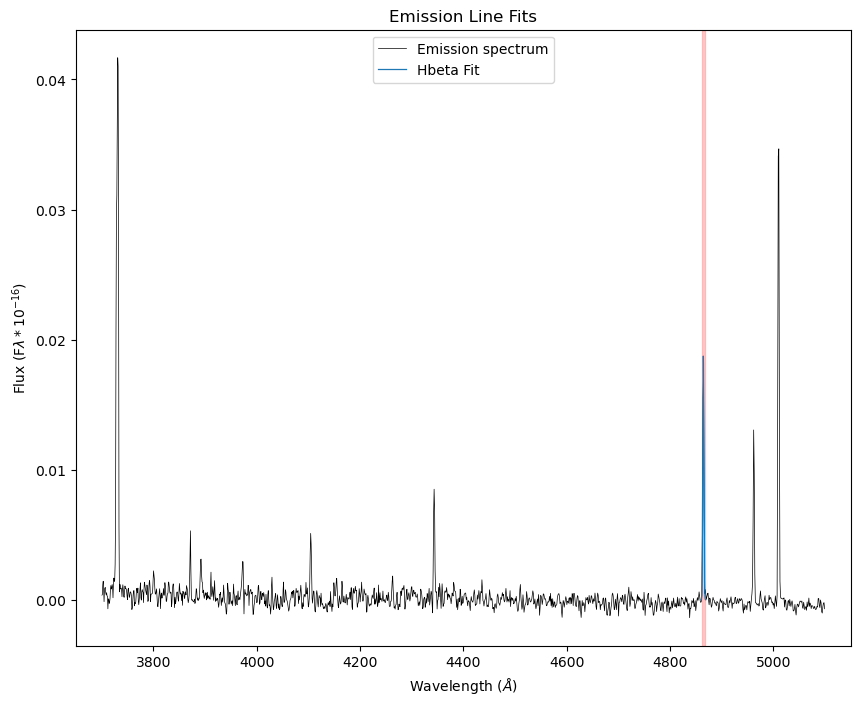

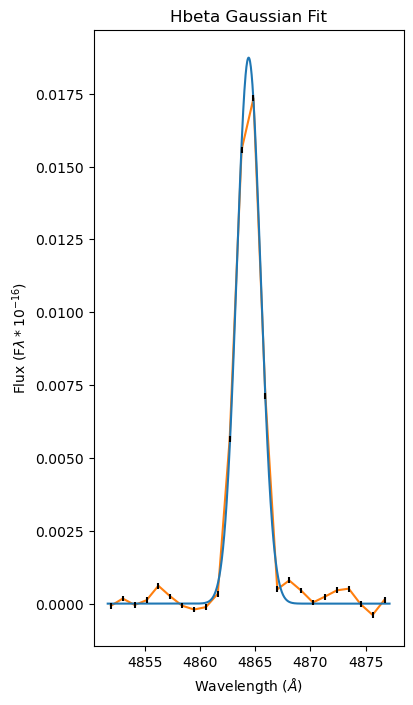

In [45]:
calculate_SN('Data', ['Hbeta'], 25, 32, makeplots =True)

In [35]:
def SN_cmap(foldername = 'Data', linename = 'Hbeta', spaxel_coords_y = [28,29], spaxel_coords_x = [33,34], xlim = [3650,5150], makeplots = False, suppress_output = False):
    """
    Inputs: 
    foldername (str) - name of folder w/data files
    linename (string) - name(s) of emission line(s) to measure
    n (int) - number of samples for each histogram
    spaxel_coords_y (list of len 2), spaxel_coords_x (list of len 2) - y and x endpoints of spaxels to compare (end noninclusive)
    makeplots (bool) - flag to make all plots 
    supress_output (bool) - flag to suppress all text output
    
    Outputs:
    Displays S/N colormap at given wvl, saves image to folder 

    Runs non-poisson S/N calculation on given coordinate range for given emline, creates a colormap of S/N values
    """
    #Check for correct range length
    y_len = len(spaxel_coords_y)
    x_len = len(spaxel_coords_x)
    
    if y_len == 2 and x_len == 2: 

        #flux_array = np.load('Data/data_norm.npy')

        #Endpoints (s for start, e for end)
        y_s = spaxel_coords_y[0]
        y_e = spaxel_coords_y[1]

        x_s = spaxel_coords_x[0]
        x_e = spaxel_coords_x[1]

        #Shape of SN array 
        y_range = range(y_s, y_e)
        x_range = range(x_s, x_e)
       
        #Create empty array for SN image
        SN_image = np.zeros((len(y_range), len(x_range)))

        if not suppress_output:
            print('Calculating S/N of...')

        #Loop over x and y coords, calculate SN, fill image 
        for y_index, y_coord in enumerate(y_range):
                
                for x_index, x_coord in enumerate(x_range):
                    
                    if not suppress_output:
                        print(y_coord, x_coord)

                    #Check for nan values (assuming empty pixels span all wvls)
                    # if not np.isnan(flux_array[0][y_coord][x_coord]):
                    
                    #Exception handling for S/N output array index error 
                    #Calculate S/N, if nan or value error, S/N = 0
                    try:
                        SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)[0][0]
                        # print(SN)
                        if np.isnan(SN):
                            SN = 0
                        SN_image[y_index][x_index] = SN

                    # except ValueError:
                    #     SN_image[y_index][x_index] = 0
 
                    except TypeError:

                        try:
                            SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)[0]
                            
                            if np.isnan(SN):
                                SN = 0
                            SN_image[y_index][x_index] = SN
                            
                        except TypeError:
                            SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)
                            if np.isnan(SN):
                                SN = 0
                            SN_image[y_index][x_index] = SN
                        except IndexError:
                            SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)
                            if np.isnan(SN):
                                SN = 0
                            SN_image[y_index][x_index] = SN
                   
                    except IndexError:
                        try:
                            SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)[0]
                            
                            if np.isnan(SN):
                                SN = 0
                            SN_image[y_index][x_index] = SN
                            
                        except TypeError:
                            SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)
                            if np.isnan(SN):
                                SN = 0
                            SN_image[y_index][x_index] = SN
                        except IndexError:
                            try:
                                SN = calculate_SN(foldername, [linename], y_coord, x_coord, xlim, makeplots, suppress_output)
                                if np.isnan(SN):
                                    SN = 0
                                SN_image[y_index][x_index] = SN
                                
                            except:
                                SN = 0 
                                SN_image[y_index][x_index] = SN
                        # print(SN)
                        # print(y_coord, x_coord)

        #Displaying image 
        if not suppress_output: 
            print('Compiling S/N image...')

        plt.imshow(np.flip(SN_image), vmin = 0, vmax = .1)
        plt.colorbar()
        plt.title('S/N Colormap of ' + linename)
        plt.savefig('Images/' + linename + '_SN_colormap.png', bbox_inches='tight')
        # header = input('Input image header or press enter...')

        #Save image to fits file
        fits.writeto('cmaps/' + linename + '_SN_Colormap.fits', SN_image, overwrite = True)
        
    else:
        print('Coordinate ranges must be of length 2.')


Spaxel [30,40]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [31,40]
Spaxel [32,40]
Spaxel [33,40]
Spaxel [34,40]
Spaxel [35,40]
Spaxel [36,40]
Spaxel [37,40]
Spaxel [38,40]
Spaxel [38,40]
Spaxel [39,40]
Spaxel [30,41]
Spaxel [31,41]
Spaxel [32,41]
Spaxel [33,41]
Spaxel [34,41]
Spaxel [35,41]
Spaxel [36,41]
Spaxel [37,41]
Spaxel [37,41]
Spaxel [38,41]
Spaxel [39,41]
Spaxel [30,42]
Spaxel [31,42]
Spaxel [31,42]
Spaxel [32,42]
Spaxel [33,42]
Spaxel [34,42]
Spaxel [35,42]
Spaxel [35,42]
Spaxel [36,42]
Spaxel [37,42]
Spaxel [38,42]
Spaxel [39,42]
Spaxel [30,43]
Spaxel [30,43]
Spaxel [31,43]
Spaxel [32,43]
Spaxel [33,43]
Spaxel [34,43]
Spaxel [35,43]
Spaxel [36,43]
Spaxel [37,43]
Spaxel [38,43]
Spaxel [39,43]
Spaxel [30,44]
Spaxel [31,44]
Spaxel [32,44]
Spaxel [33,44]
Spaxel [34,44]
Spaxel [35,44]
Spaxel [36,44]
Spaxel [37,44]
Spaxel [38,44]
Spaxel [39,44]
Spaxel [30,45]
Spaxel [31,45]
Spaxel [32,45]
Spaxel [33,45]
Spaxel [34,45]
Spaxel [35,45]
Spaxel [36,45]
Spaxel [37,45]
Spaxel [38,45]
Spaxel [38,45]
Spaxel [39,45]
Spaxel [30,46]
Spaxel [31

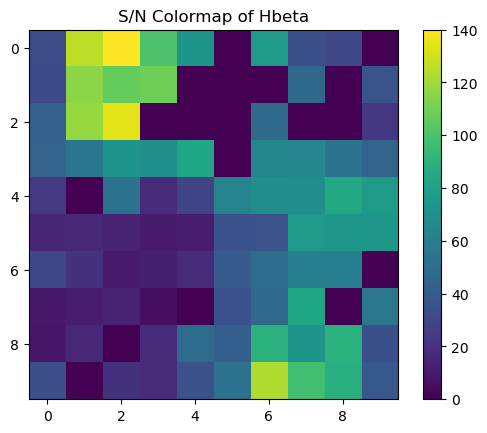

In [28]:
SN_cmap('Data', 'Hbeta', [40,50], [30,40], makeplots = False, suppress_output= True)

Spaxel [30,40]
['OII3729', array([39]), array([3730.94381128]), 0.00839085672105871, array([1.65584049]), array([0.70317072]), array([-1.71881128])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/2021919962.py:62: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/2021919962.py:63: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Flux continuum values:  5.7565297287068534e-05 nan
Flux continuum values:  8.566652608848037e-05 3.756018375156156e-06
Flux continuum values:  -9.582533194908271e-05 -5.557970566573336e-05
Flux continuum values:  -0.00012432917716330427 -0.00044242659963309025
Flux continuum values:  0.0006316178099433703 -0.0007956494687298967
Flux continuum values:  0.00036894787444534784 nan
Flux continuum values:  -0.00039970916374333686 -0.0004920087595890075
Flux continuum values:  0.00028881313501616726 0.00024307146024638232
Flux continuum values:  0.0005963347725621675 nan
Flux continuum values:  0.00010798591985326312 -0.0002450643293590228
Flux continuum values:  -0.0007356120954780305 5.441464897116546e-05
Flux continuum values:  -0.0007666724482638882 -0.00020006018380574163
Flux continuum values:  -0.0006596532369700522 -6.718929009485747e-05
Flux continuum values:  nan 0.00042898646951793334
Flux continuum values:  nan 0.0003315633401733617
Flux continuum values:  -0.00019734399270503536

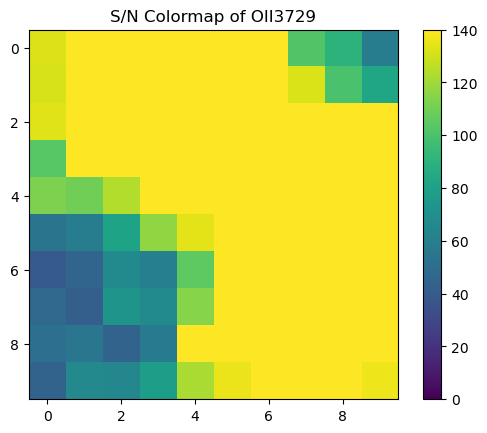

In [67]:
#OII 3729
SN_cmap('Data', 'OII3729', [40,50], [30,40], makeplots = False, suppress_output = True)


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_11769/646192618.py:175: RuntimeWarning: invalid value encountered in sqrt
  n_p = np.sqrt(flux_em).T


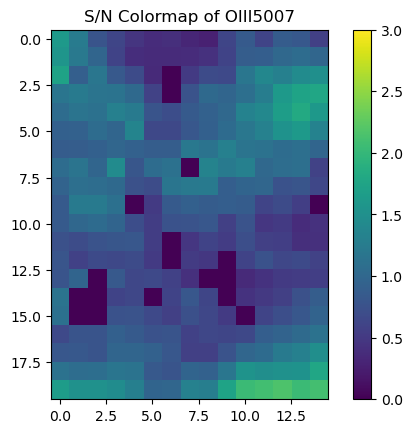

In [ ]:
#Looking at area of image where target is in reddest emission line (OIII5007)
OIII = SN_cmap('Data', 'OIII5007', [30,50], [20,35], False, True)

Spaxel [0,0]
Spaxel [0,0]
Spaxel [0,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/2130731779.py:61: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [31,9]
Spaxel [31,9]
Spaxel [31,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel [54,9]
Spaxel

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:243: RuntimeWarning: Mean of empty slice
  noise = np.nanmean([sig_1,sig_2])


Spaxel [32,12]
Spaxel [32,12]
Spaxel [33,12]
[9.55708161e-09 9.72312537e-09]
Spaxel [33,12]
[9.55708161e-09 9.72312537e-09]
Spaxel [34,12]
[9.55708161e-09 9.72312537e-09]
Spaxel [34,12]
[9.55708161e-09 9.72312537e-09]
Spaxel [35,12]
Spaxel [35,12]
Spaxel [36,12]
[8.77459777e-09 8.96038064e-09 9.43479597e-09 9.80676806e-09
 9.89021271e-09 9.95624614e-09 9.82306342e-09 9.44499308e-09]
Spaxel [37,12]
Spaxel [37,12]
Spaxel [38,12]
[9.72312537e-09 9.74840424e-09 9.81964874e-09 9.89363267e-09
 1.01074084e-08 1.00654459e-08 9.95014797e-09 9.88041622e-09]
Spaxel [39,12]
Spaxel [39,12]
Spaxel [39,12]
Spaxel [40,12]
Spaxel [40,12]
Spaxel [40,12]
Spaxel [41,12]
Spaxel [41,12]
Spaxel [41,12]
Spaxel [42,12]
Spaxel [42,12]
Spaxel [42,12]
Spaxel [43,12]
Spaxel [43,12]
Spaxel [43,12]
Spaxel [44,12]
Spaxel [44,12]
Spaxel [44,12]
Spaxel [45,12]
Spaxel [45,12]
Spaxel [45,12]
Spaxel [46,12]
Spaxel [46,12]
Spaxel [46,12]
Spaxel [47,12]
Spaxel [47,12]
Spaxel [47,12]
Spaxel [48,12]
Spaxel [48,12]
Spaxel [48,

Spaxel [28,15]
Spaxel [29,15]
[9.82306342e-09 9.44499308e-09]
Spaxel [29,15]
[9.82306342e-09 9.44499308e-09]
Spaxel [30,15]
[9.55708161e-09 9.72312537e-09 9.74840424e-09 9.81964874e-09
 9.89363267e-09 1.01074084e-08 1.00654459e-08]
Spaxel [31,15]
Spaxel [31,15]
Spaxel [32,15]
Spaxel [32,15]
Spaxel [33,15]
[9.45383247e-09 9.55708161e-09 9.72312537e-09 9.74840424e-09
 9.81964874e-09 9.89363267e-09 1.01074084e-08 1.00654459e-08
 9.95014797e-09 9.88041622e-09 1.00340200e-08]
Spaxel [34,15]
Spaxel [34,15]
Spaxel [35,15]
Spaxel [35,15]
Spaxel [36,15]
Spaxel [36,15]
Spaxel [37,15]
[9.35417627e-09 9.45383247e-09 9.55708161e-09 9.72312537e-09
 9.74840424e-09 9.81964874e-09 9.89363267e-09]
Spaxel [38,15]
Spaxel [38,15]
Spaxel [38,15]
Spaxel [39,15]
Spaxel [39,15]
Spaxel [39,15]
Spaxel [40,15]
Spaxel [40,15]
Spaxel [40,15]
Spaxel [41,15]
Spaxel [41,15]
Spaxel [41,15]
Spaxel [42,15]
Spaxel [42,15]
Spaxel [42,15]
Spaxel [43,15]
Spaxel [43,15]
Spaxel [43,15]
Spaxel [44,15]
Spaxel [44,15]
Spaxel [44,

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/3302258093.py:249: RuntimeWarning: divide by zero encountered in divide
  sn = flux_sum / noise


[1.18974125e-08 1.19332982e-08 1.20476735e-08 1.22314856e-08
 1.21376020e-08 1.22499646e-08 1.25135450e-08]
Spaxel [19,21]
[1.18974125e-08 1.19332982e-08 1.20476735e-08 1.22314856e-08
 1.21376020e-08 1.22499646e-08 1.25135450e-08]
Spaxel [20,21]
[1.18974125e-08 1.19332982e-08 1.20476735e-08 1.22314856e-08
 1.21376020e-08 1.22499646e-08 1.25135450e-08]
Spaxel [21,21]
[1.17411038e-08 1.17443756e-08 1.18974125e-08 1.19332982e-08
 1.20476735e-08 1.22314856e-08 1.21376020e-08 1.22499646e-08
 1.25135450e-08 1.23379185e-08]
Spaxel [22,21]
[1.17411038e-08 1.17443756e-08 1.18974125e-08 1.19332982e-08
 1.20476735e-08 1.22314856e-08 1.21376020e-08 1.22499646e-08
 1.25135450e-08 1.23379185e-08]
Spaxel [23,21]
[1.17411038e-08 1.17443756e-08 1.18974125e-08 1.19332982e-08
 1.20476735e-08 1.22314856e-08 1.21376020e-08 1.22499646e-08
 1.25135450e-08 1.23379185e-08]
Spaxel [24,21]
[1.17411038e-08 1.17443756e-08 1.18974125e-08 1.19332982e-08
 1.20476735e-08 1.22314856e-08 1.21376020e-08 1.22499646e-08
 1

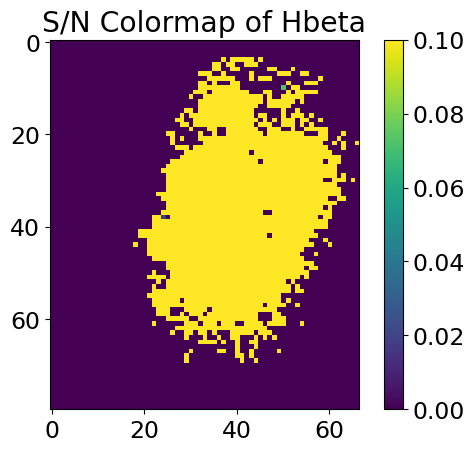

In [36]:
SN_cmap('Data', 'Hbeta', [0,80], [0,67], suppress_output = True)

Spaxel [0,0]


Spaxel [0,0]
Spaxel [0,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [24,0]
Spaxel 

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [30,9]
Spaxel [31,9]
Spaxel [31,9]
Spaxel [31,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Spaxel [32,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [39,12]
Spaxel [39,12]
Spaxel [39,12]
Spaxel [40,12]
Spaxel [40,12]
Spaxel [40,12]
Spaxel [41,12]
Spaxel [41,12]
Spaxel [41,12]
Spaxel [42,12]
Spaxel [42,12]
Spaxel [42,12]
Spaxel [43,12]
Spaxel [43,12]
Spaxel [43,12]
Spaxel [44,12]
Spaxel [44,12]
Spaxel [44,12]
Spaxel [45,12]
Spaxel [45,12]
Spaxel [45,12]
Spaxel [46,12]
Spaxel [46,12]
Spaxel [46,12]
Spaxel [47,12]
Spaxel [47,12]
Spaxel [47,12]
Spaxel [48,12]
Spaxel [48,12]
Spaxel [48,12]
Spaxel [49,12]
Spaxel [49,12]
Spaxel [49,12]
Spaxel [50,12]
Spaxel [50,12]
Spaxel [50,12]
Spaxel [51,12]
Spaxel [51,12]
Spaxel [51,12]
Spaxel [52,12]
Spaxel [52,12]
Spaxel [52,12]
Spaxel [53,12]
Spaxel [53,12]
Spaxel [53,12]
Spaxel [54,12]
Spaxel [54,12]
Spaxel [54,12]
Spaxel [55,12]
Spaxel [55,12]
Spaxel [55,12]
Spaxel [56,12]
Spaxel [56,12]
Spaxel [56,12]
Spaxel [57

Spaxel [29,15]
Spaxel [29,15]
Spaxel [30,15]
Spaxel [31,15]
Spaxel [31,15]
Spaxel [32,15]
Spaxel [32,15]
Spaxel [33,15]
Spaxel [34,15]
Spaxel [34,15]
Spaxel [35,15]
Spaxel [35,15]
Spaxel [36,15]
Spaxel [36,15]
Spaxel [37,15]
Spaxel [38,15]
Spaxel [38,15]
Spaxel [38,15]
Spaxel [39,15]
Spaxel [39,15]
Spaxel [39,15]
Spaxel [40,15]
Spaxel [40,15]
Spaxel [40,15]
Spaxel [41,15]
Spaxel [41,15]
Spaxel [41,15]
Spaxel [42,15]
Spaxel [42,15]
Spaxel [42,15]
Spaxel [43,15]
Spaxel [43,15]
Spaxel [43,15]
Spaxel [44,15]
Spaxel [44,15]
Spaxel [44,15]
Spaxel [45,15]
Spaxel [45,15]
Spaxel [45,15]
Spaxel [46,15]
Spaxel [46,15]
Spaxel [46,15]
Spaxel [47,15]
Spaxel [47,15]
Spaxel [47,15]
Spaxel [48,15]
Spaxel [48,15]
Spaxel [48,15]
Spaxel [49,15]
Spaxel [49,15]
Spaxel [49,15]
Spaxel [50,15]
Spaxel [50,15]
Spaxel [50,15]
Spaxel [51,15]
Spaxel [51,15]
Spaxel [51,15]
Spaxel [52,15]
Spaxel [52,15]
Spaxel [52,15]
Spaxel [53,15]
Spaxel [53,15]
Spaxel [53,15]
Spaxel [54,15]
Spaxel [54,15]
Spaxel [54,15]
Spaxel [55

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3705364789.py:229: RuntimeWarning: divide by zero encountered in divide
  sn = flux_sum / noise


Spaxel [17,21]
Spaxel [18,21]
Spaxel [19,21]
Spaxel [20,21]
Spaxel [21,21]
Spaxel [22,21]
Spaxel [23,21]
Spaxel [24,21]
Spaxel [25,21]
Spaxel [26,21]
Spaxel [27,21]
Spaxel [28,21]
Spaxel [29,21]
Spaxel [30,21]
Spaxel [31,21]
Spaxel [32,21]
Spaxel [32,21]
Spaxel [33,21]
Spaxel [34,21]
Spaxel [35,21]
Spaxel [36,21]
Spaxel [37,21]
Spaxel [38,21]
Spaxel [38,21]
Spaxel [39,21]
Spaxel [39,21]
Spaxel [40,21]
Spaxel [40,21]
Spaxel [41,21]
Spaxel [42,21]
Spaxel [43,21]
Spaxel [44,21]
Spaxel [44,21]
Spaxel [44,21]
Spaxel [45,21]
Spaxel [45,21]
Spaxel [45,21]
Spaxel [46,21]
Spaxel [46,21]
Spaxel [46,21]
Spaxel [47,21]
Spaxel [47,21]
Spaxel [47,21]
Spaxel [48,21]
Spaxel [48,21]
Spaxel [48,21]
Spaxel [49,21]
Spaxel [49,21]
Spaxel [49,21]
Spaxel [50,21]
Spaxel [50,21]
Spaxel [50,21]
Spaxel [51,21]
Spaxel [51,21]
Spaxel [51,21]
Spaxel [52,21]
Spaxel [52,21]
Spaxel [52,21]
Spaxel [53,21]
Spaxel [53,21]
Spaxel [53,21]
Spaxel [54,21]
Spaxel [54,21]
Spaxel [54,21]
Spaxel [55,21]
Spaxel [55,21]
Spaxel [55

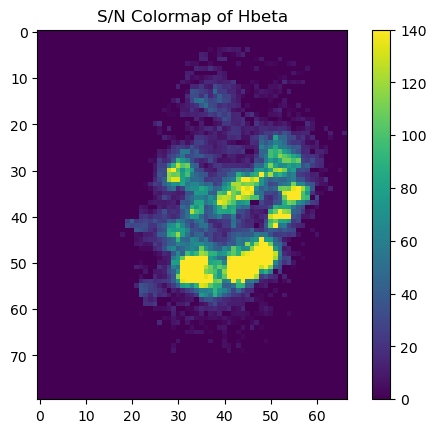

In [55]:
SN_cmap('Data', 'Hbeta', [0,80], [0,67], suppress_output = True)

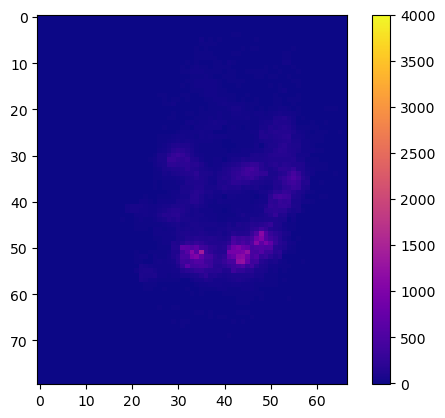

In [296]:
map = np.flip(fits.getdata('cmaps/OIII5007_SN_Colormap.fits'))
plt.imshow(map, cmap = 'plasma', vmax = 4000)
plt.colorbar()

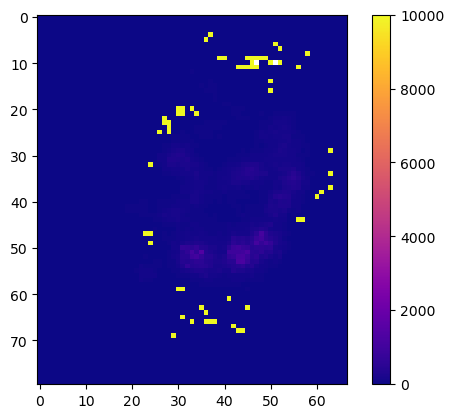

In [88]:
map = np.flip(fits.getdata('cmaps/OIII5007_SN_Colormap.fits'))
plt.imshow(map, cmap = 'plasma', vmax = 10000)
plt.colorbar()

## Locating Target 

#### From Reines et al ID 65

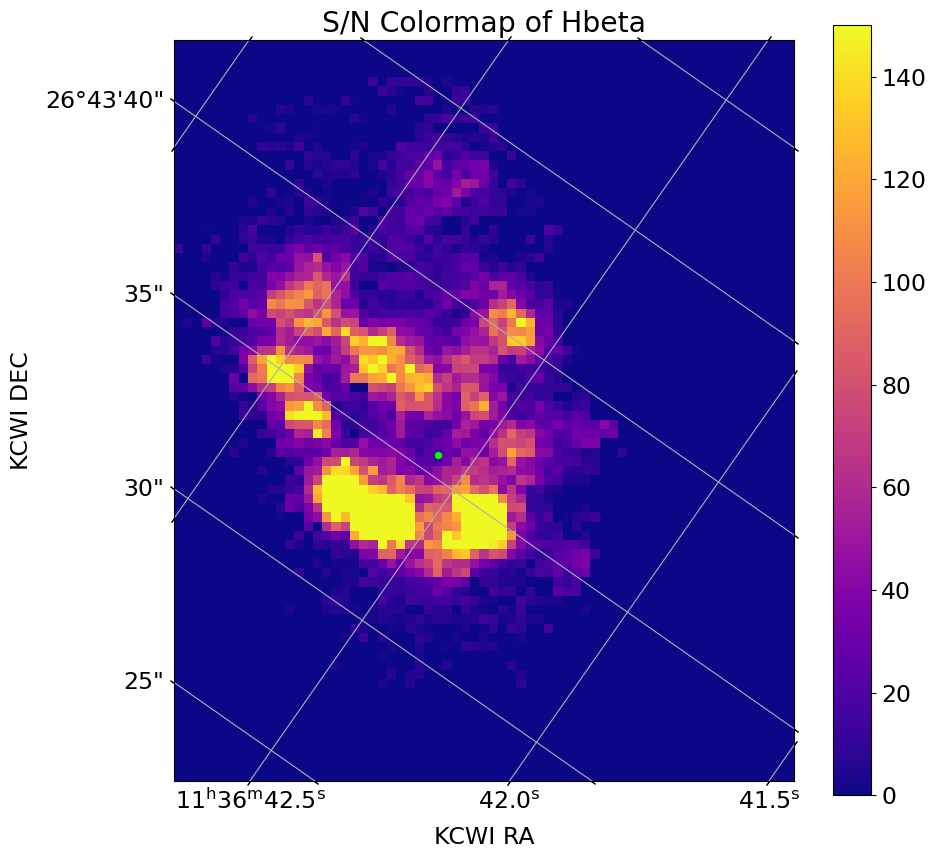

In [37]:
#Coordinates of target
ra_targ = 174.17740 * u.degree #degrees
dec_targ = 26.72657 * u.degree #degrees

c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')

#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)
ax = plt.subplot(projection = coords)
plt.title('S/N Colormap of Hbeta')
hbeta_data = fits.getdata('cmaps/Hbeta_SN_Colormap.fits')
hbeta_map = plt.imshow(hbeta_data, cmap = 'plasma', vmin = 0, vmax = 150)

#Plotting target on colormap
x,y = coords.world_to_pixel(c_targ)
plt.scatter(x, y, color = 'lime', s = 18)
#plt.scatter(32,25)
plt.colorbar(hbeta_map)

plt.grid()


#### Plot diagonal RA/Dec

#### Function to Plot Cmap in RA/Dec and Add Target Marker

In [73]:
def add_targ(ra_targ, dec_targ, filename, linename, SN = False, set_vmax = 3): 
    """
    Function takes in linename and plots cmap (from saved file) with RA and Dec coords. 
    Adds marker for location of target and saves image. 
    
    Inputs: 
    ra_targ (float): RA of target, any coords
    dec_targ (float): Dec of target, any coords
    filename (str): name of file to grab header from
    linename (str): name of emission line 
    SN (Bool): flag to add SN to title
    set_vmax (float): vmax
    
    Outputs: 
    None
    """
    #Coordinates of target
    c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')

    #Get header info 
    header = fits.getheader(filename)
    #Pointing corrections
    header['CRVAL1'] += 174.17801 - 174.1787083
    header['CRVAL2'] += 26.727126 - 26.7263583

    #Create colormap w/coords in RA and Dec
    #3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
    plt.figure(figsize=(10,10))
    coords = WCS(header, naxis = 2)
    plot = plt.subplot(projection = coords)
    
    if SN:
        plt.title('S/N Colormap of ' + linename.replace('_',' '))
        data = fits.getdata('cmaps/' + linename + '_SN_Colormap.fits')
    else:
        plt.title('Colormap of ' + linename.replace('_',' '))
        data = fits.getdata('cmaps/' + linename + '_Colormap.fits')

    if SN:
        cmap = plt.imshow(data, cmap = 'inferno', vmin = 0, vmax = set_vmax)
        units = 'S/N'
    else:
        cmap = plt.imshow(data, cmap = 'plasma', vmin = 0, vmax = set_vmax)
        units = 'Flux ($F_\lambda*10^{-16}$)'

    #Plotting target on colormap
    x,y = coords.world_to_pixel(c_targ)
    print(x,y)
    plt.scatter(x, y, color = 'lime', s = 55, marker='X')
    plt.colorbar(cmap, label = units)

    plt.grid()
    

28.02606651075986 34.697076776399825


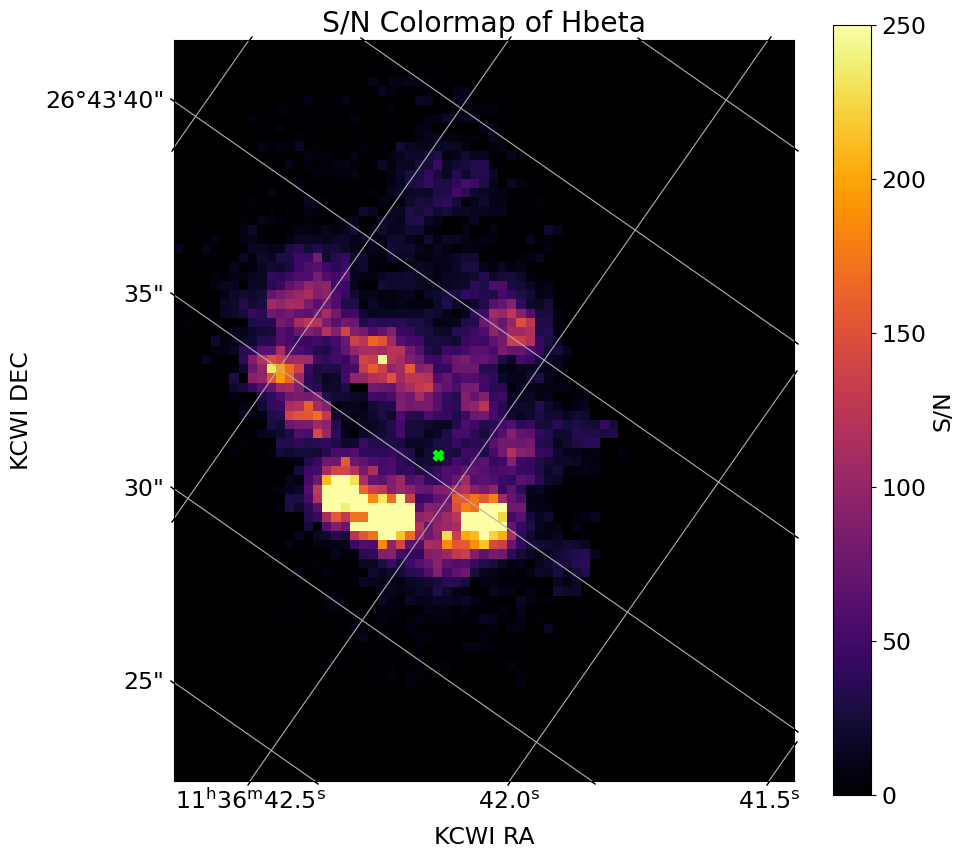

In [74]:
add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'Hbeta', True, set_vmax=250)
plt.savefig('Images/Hbeta_SN_colormap_targ.png', bbox_inches='tight')

#### Creating Colormap of OIII 

In [48]:
SN_cmap('Data', 'OIII5007', [0,80], [0,67], suppress_output=True)

NameError: name 'SN_cmap' is not defined

28.02606651075986 34.697076776399825


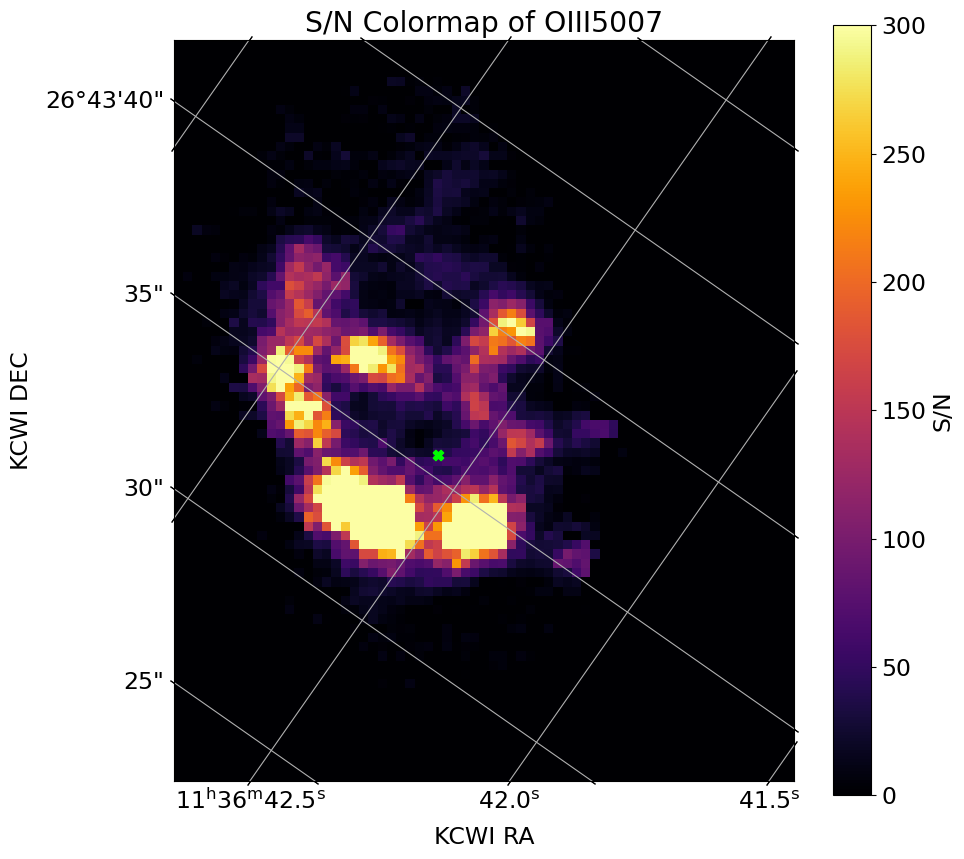

In [75]:
add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'OIII5007', True, set_vmax=300)
plt.savefig('Images/OIII_SN_colormap_targ.png', bbox_inches='tight')

Spaxel [0,0]
Spaxel [0,0]


Spaxel [0,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [24,0]
Spaxel [24,0]
Spaxel

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [31,9]
Spaxel [31,9]
Spaxel [31,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel [54,9]
Spaxel

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Spaxel [26,10]
Spaxel [26,10]
Spaxel [26,10]
Spaxel [27,10]
Spaxel [27,10]
Spaxel [27,10]
Spaxel [28,10]
Spaxel [28,10]
Spaxel [28,10]
Spaxel [29,10]
Spaxel [29,10]
Spaxel [29,10]
Spaxel [30,10]
Spaxel [30,10]
Spaxel [30,10]
Spaxel [31,10]
Spaxel [31,10]
Spaxel [31,10]
Spaxel [32,10]
Spaxel [32,10]
Spaxel [32,10]
Spaxel [33,10]
Spaxel [33,10]
Spaxel [33,10]
Spaxel [34,10]
Spaxel [34,10]
Spaxel [34,10]
Spaxel [35,10]
Spaxel [35,10]
Spaxel [35,10]
Spaxel [36,10]
Spaxel [36,10]
Spaxel [36,10]
Spaxel [37,10]
Spaxel [37,10]
Spaxel [38,10]
Spaxel [38,10]
Spaxel [38,10]
Spaxel [39,10]
Spaxel [39,10]
Spaxel [39,10]
Spaxel [40,10]
Spaxel [40,10]
Spaxel [40,10]
Spaxel [41,10]
Spaxel [41,10]
Spaxel [41,10]
Spaxel [42,10]
Spaxel [42,10]
Spaxel [42,10]
Spaxel [43,10]
Spaxel [43,10]
Spaxel [43,10]
Spaxel [44,10]
Spaxel [44,10]
Spaxel [44,10]
Spaxel [45,10]
Spaxel [45,10]
Spaxel [45,10]
Spaxel [46,10]
Spaxel [46,10]
Spaxel [46,10]
Spaxel [47,10]
Spaxel [47,10]
Spaxel [47,10]
Spaxel [48,10]
Spaxel [48

Spaxel [15,67]
Spaxel [15,67]
Spaxel [16,67]
Spaxel [17,67]
Spaxel [18,67]
Spaxel [19,67]
Spaxel [20,67]
Spaxel [21,67]
Spaxel [22,67]
Spaxel [23,67]
Spaxel [24,67]
Spaxel [25,67]
Spaxel [26,67]
Spaxel [27,67]
Spaxel [28,67]
Spaxel [29,67]
Spaxel [30,67]
Spaxel [31,67]
Spaxel [32,67]
Spaxel [33,67]
Spaxel [34,67]
Spaxel [35,67]
Spaxel [36,67]
Spaxel [37,67]
Spaxel [37,67]
Spaxel [37,67]
Spaxel [38,67]
Spaxel [38,67]
Spaxel [38,67]
Spaxel [39,67]
Spaxel [39,67]
Spaxel [39,67]
Spaxel [40,67]
Spaxel [40,67]
Spaxel [40,67]
Spaxel [41,67]
Spaxel [41,67]
Spaxel [41,67]
Spaxel [42,67]
Spaxel [42,67]
Spaxel [42,67]
Spaxel [43,67]
Spaxel [43,67]
Spaxel [43,67]
Spaxel [44,67]
Spaxel [44,67]
Spaxel [44,67]
Spaxel [45,67]
Spaxel [45,67]
Spaxel [45,67]
Spaxel [46,67]
Spaxel [46,67]
Spaxel [46,67]
Spaxel [47,67]
Spaxel [47,67]
Spaxel [47,67]
Spaxel [48,67]
Spaxel [48,67]
Spaxel [48,67]
Spaxel [49,67]
Spaxel [49,67]
Spaxel [49,67]
Spaxel [50,67]
Spaxel [50,67]
Spaxel [50,67]
Spaxel [51,67]
Spaxel [51

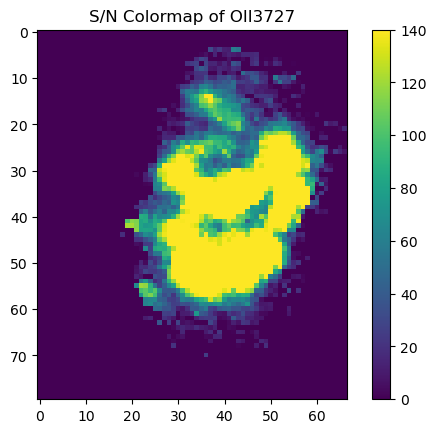

In [62]:
SN_cmap('Data', 'OII3727', [0,80], [0,67], suppress_output=True)

28.02606651075986 34.697076776399825


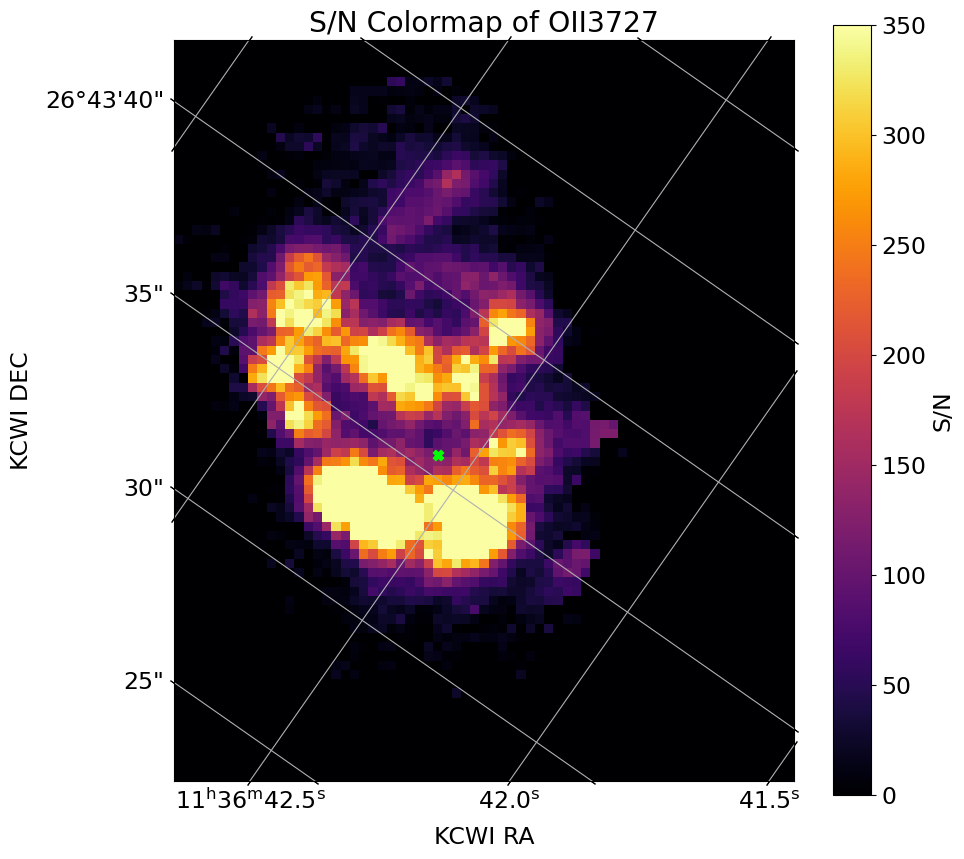

In [76]:
add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'OII3727', True, set_vmax=350)
plt.savefig('Images/OII_SN_colormap_targ.png', bbox_inches='tight')

Text(0.5, 1.0, 'S/N Colormap of OII3727')

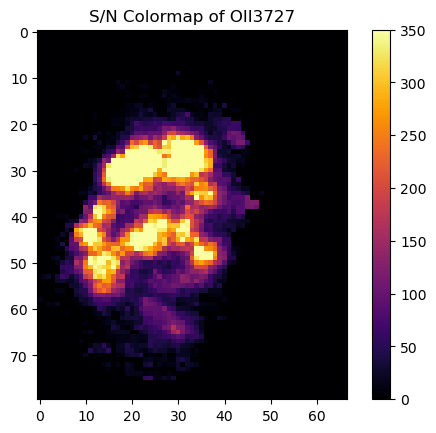

In [64]:
map = fits.getdata('cmaps/OII3727_SN_Colormap.fits')
plt.imshow(map, cmap = 'inferno', vmin = 0, vmax = 350)
plt.colorbar()
plt.title('S/N Colormap of OII3727')

Spaxel [0,0]
Spaxel [0,0]


Spaxel [0,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [24,0]
Spaxel [24,0]
Spaxel

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [30,9]
Spaxel [31,9]
Spaxel [31,9]
Spaxel [31,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [32,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Spaxel [37,11]
Spaxel [38,11]
Spaxel [38,11]
Spaxel [38,11]
Spaxel [39,11]
Spaxel [39,11]
Spaxel [39,11]
Spaxel [40,11]
Spaxel [40,11]
Spaxel [40,11]
Spaxel [41,11]
Spaxel [41,11]
Spaxel [41,11]
Spaxel [42,11]
Spaxel [42,11]
Spaxel [42,11]
Spaxel [43,11]
Spaxel [43,11]
Spaxel [43,11]
Spaxel [44,11]
Spaxel [44,11]
Spaxel [44,11]
Spaxel [45,11]
Spaxel [45,11]
Spaxel [45,11]
Spaxel [46,11]
Spaxel [46,11]
Spaxel [46,11]
Spaxel [47,11]
Spaxel [47,11]
Spaxel [47,11]
Spaxel [48,11]
Spaxel [48,11]
Spaxel [48,11]
Spaxel [49,11]
Spaxel [49,11]
Spaxel [49,11]
Spaxel [50,11]
Spaxel [50,11]
Spaxel [50,11]
Spaxel [51,11]
Spaxel [51,11]
Spaxel [51,11]
Spaxel [52,11]
Spaxel [52,11]
Spaxel [52,11]
Spaxel [53,11]
Spaxel [53,11]
Spaxel [53,11]
Spaxel [54,11]
Spaxel [54,11]
Spaxel [54,11]
Spaxel [55,11]
Spaxel [55,11]
Spaxel [55,11]
Spaxel [56,11]
Spaxel [56,11]
Spaxel [56,11]
Spaxel [57,11]
Spaxel [57,11]
Spaxel [57,11]
Spaxel [58,11]
Spaxel [58,11]
Spaxel [58,11]
Spaxel [59,11]
Spaxel [59,11]
Spaxel [59

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3705364789.py:229: RuntimeWarning: divide by zero encountered in divide
  sn = flux_sum / noise


Spaxel [39,20]
Spaxel [39,20]
Spaxel [40,20]
Spaxel [41,20]
Spaxel [42,20]
Spaxel [43,20]
Spaxel [44,20]
Spaxel [44,20]
Spaxel [44,20]
Spaxel [45,20]
Spaxel [45,20]
Spaxel [45,20]
Spaxel [46,20]
Spaxel [46,20]
Spaxel [46,20]
Spaxel [47,20]
Spaxel [47,20]
Spaxel [47,20]
Spaxel [48,20]
Spaxel [48,20]
Spaxel [48,20]
Spaxel [49,20]
Spaxel [49,20]
Spaxel [49,20]
Spaxel [50,20]
Spaxel [50,20]
Spaxel [50,20]
Spaxel [51,20]
Spaxel [51,20]
Spaxel [51,20]
Spaxel [52,20]
Spaxel [52,20]
Spaxel [52,20]
Spaxel [53,20]
Spaxel [53,20]
Spaxel [53,20]
Spaxel [54,20]
Spaxel [54,20]
Spaxel [54,20]
Spaxel [55,20]
Spaxel [55,20]
Spaxel [55,20]
Spaxel [56,20]
Spaxel [56,20]
Spaxel [56,20]
Spaxel [57,20]
Spaxel [57,20]
Spaxel [57,20]
Spaxel [58,20]
Spaxel [58,20]
Spaxel [58,20]
Spaxel [59,20]
Spaxel [59,20]
Spaxel [59,20]
Spaxel [60,20]
Spaxel [60,20]
Spaxel [60,20]
Spaxel [61,20]
Spaxel [61,20]
Spaxel [61,20]
Spaxel [62,20]
Spaxel [62,20]
Spaxel [62,20]
Spaxel [63,20]
Spaxel [63,20]
Spaxel [63,20]
Spaxel [64

Spaxel [40,47]
Spaxel [41,47]
Spaxel [41,47]
Spaxel [42,47]
Spaxel [42,47]
Spaxel [43,47]
Spaxel [43,47]
Spaxel [44,47]
Spaxel [44,47]
Spaxel [44,47]
Spaxel [45,47]
Spaxel [45,47]
Spaxel [45,47]
Spaxel [46,47]
Spaxel [46,47]
Spaxel [46,47]
Spaxel [47,47]
Spaxel [47,47]
Spaxel [47,47]
Spaxel [48,47]
Spaxel [48,47]
Spaxel [48,47]
Spaxel [49,47]
Spaxel [49,47]
Spaxel [49,47]
Spaxel [50,47]
Spaxel [50,47]
Spaxel [50,47]
Spaxel [51,47]
Spaxel [51,47]
Spaxel [51,47]
Spaxel [52,47]
Spaxel [52,47]
Spaxel [52,47]
Spaxel [53,47]
Spaxel [53,47]
Spaxel [53,47]
Spaxel [54,47]
Spaxel [54,47]
Spaxel [54,47]
Spaxel [55,47]
Spaxel [55,47]
Spaxel [55,47]
Spaxel [56,47]
Spaxel [56,47]
Spaxel [56,47]
Spaxel [57,47]
Spaxel [57,47]
Spaxel [57,47]
Spaxel [58,47]
Spaxel [58,47]
Spaxel [58,47]
Spaxel [59,47]
Spaxel [59,47]
Spaxel [59,47]
Spaxel [60,47]
Spaxel [60,47]
Spaxel [60,47]
Spaxel [61,47]
Spaxel [61,47]
Spaxel [61,47]
Spaxel [62,47]
Spaxel [62,47]
Spaxel [62,47]
Spaxel [63,47]
Spaxel [63,47]
Spaxel [63

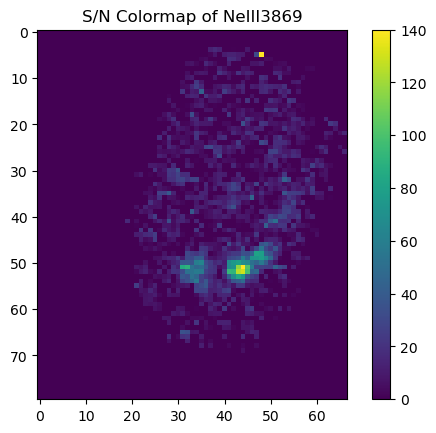

In [65]:
SN_cmap('Data', 'NeIII3869', [0,80], [0,67], suppress_output=True)

28.02606651075986 34.697076776399825


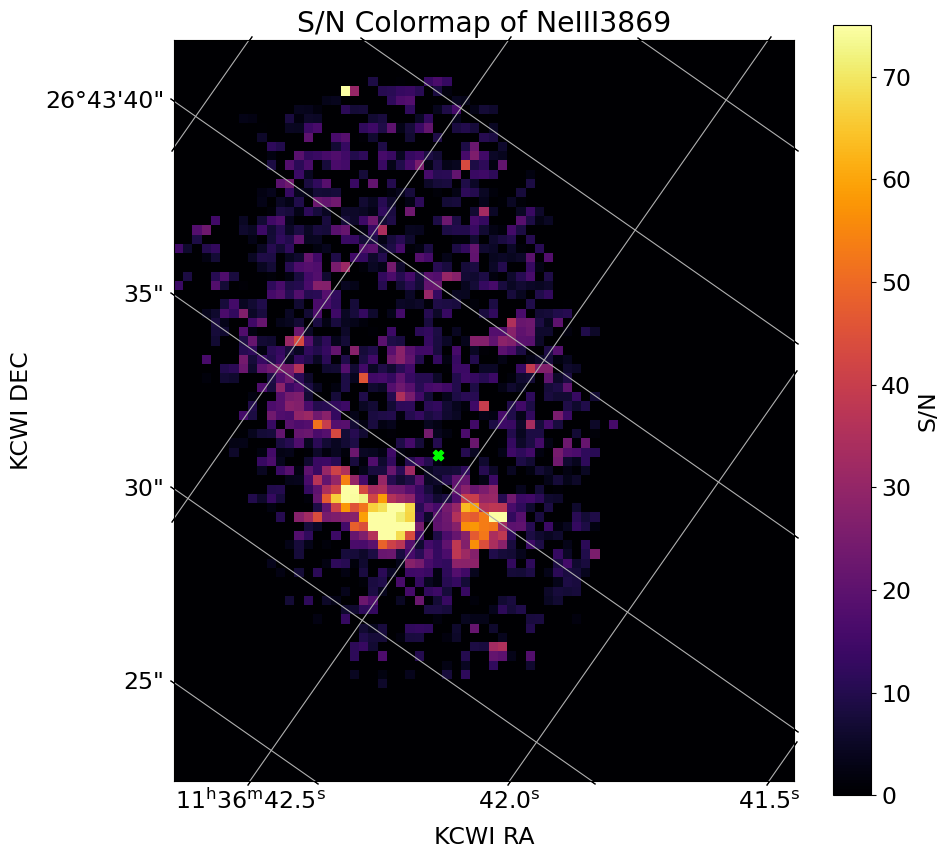

In [77]:
add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'NeIII3869', True, set_vmax=75)
#plt.scatter(48,74)
plt.savefig('Images/NeIII_SN_colormap_targ.png', bbox_inches='tight')

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/501326164.py:4: RuntimeWarning: divide by zero encountered in divide
  Ratio_map = OIII_map_data/Hbeta_map_data
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/501326164.py:4: RuntimeWarning: invalid value encountered in divide
  Ratio_map = OIII_map_data/Hbeta_map_data


28.02606651075986 34.697076776399825


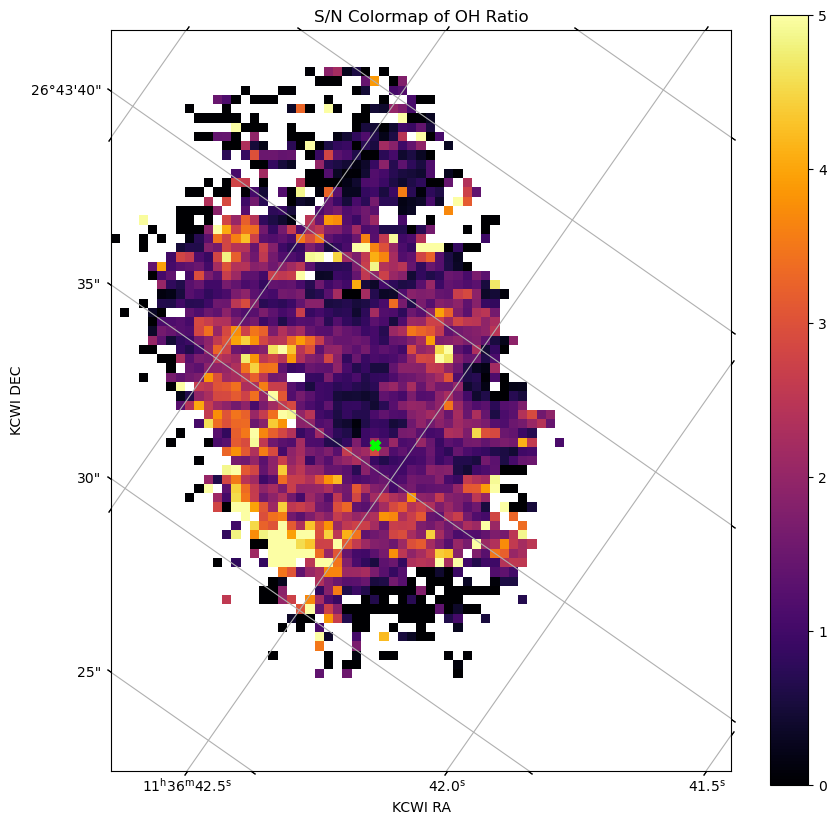

In [67]:
Hbeta_map_data = fits.getdata('cmaps/Hbeta_SN_Colormap.fits')
OIII_map_data = fits.getdata('cmaps/OIII5007_SN_Colormap.fits')

Ratio_map = OIII_map_data/Hbeta_map_data

fits.writeto('cmaps/OH_Ratio_SN_Colormap.fits', Ratio_map, overwrite = True)

add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'OH_Ratio', True, set_vmax = 5)

#### (not integrated) Flux Colormaps of Hbeta, OIII5007, and OII3727

In [68]:
OIII_flux_map = np.zeros([80,67])
for y_coord in range(0,80):
    for x_coord in range (0,67): 
        if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
            OIII_flux_map[y_coord,x_coord] = Gaussian_fit('Data', ['OIII5007'], y_coord, x_coord)[0][2]
            
fits.writeto('cmaps/OIII_flux_Colormap.fits', OIII_flux_map, overwrite = True)

Spaxel [30,9]
Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

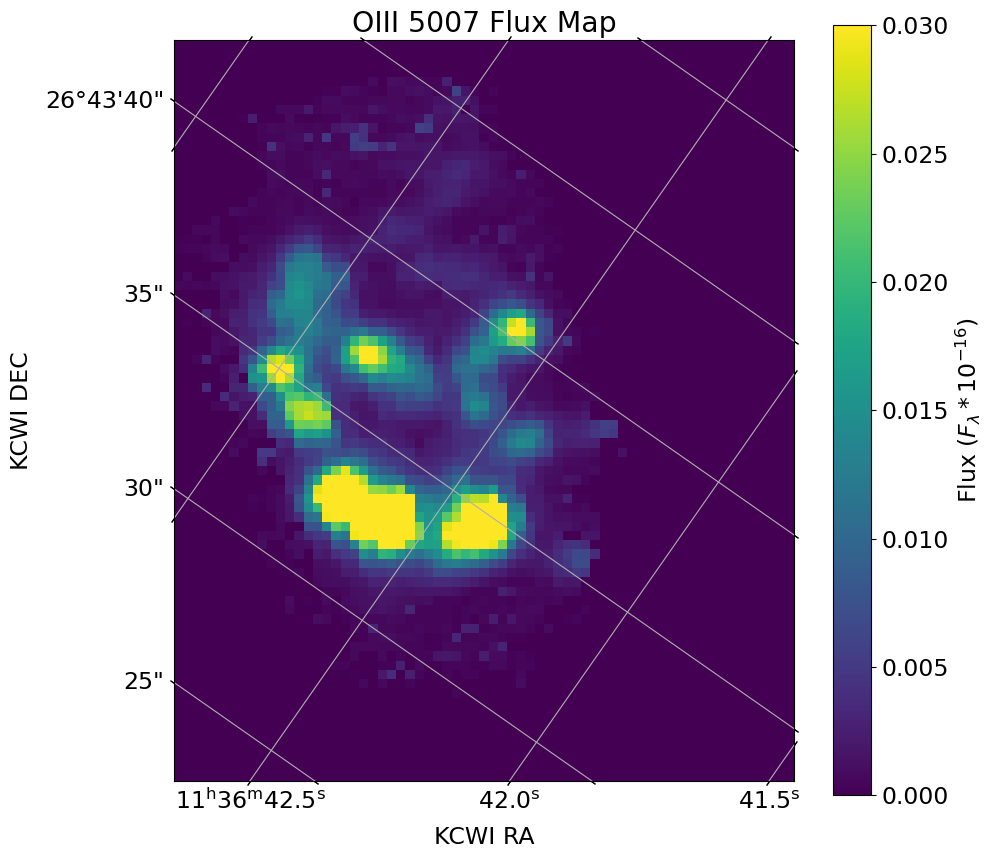

In [56]:

#Displaying OIII flux map
#Coordinates of target
ra_targ = 174.17740 * u.degree #degrees
dec_targ = 26.72657 * u.degree #degrees

c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')
#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)
plot = plt.subplot(projection = coords)
plt.title('OIII 5007 Flux Map')
data = fits.getdata('cmaps/OIII_flux_Colormap.fits')
cmap = plt.imshow(data, cmap = 'viridis', vmin = 0, vmax = .03)
#cmap.scatter_coord(c_targ)
#Good spaxel
#plt.scatter(33,26)
#plt.scatter(38.05215174427657,80-39.7737979639778)
plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()
plt.savefig('OIII_flux_map.png', bbox_inches='tight')


28.02606651075986 34.697076776399825


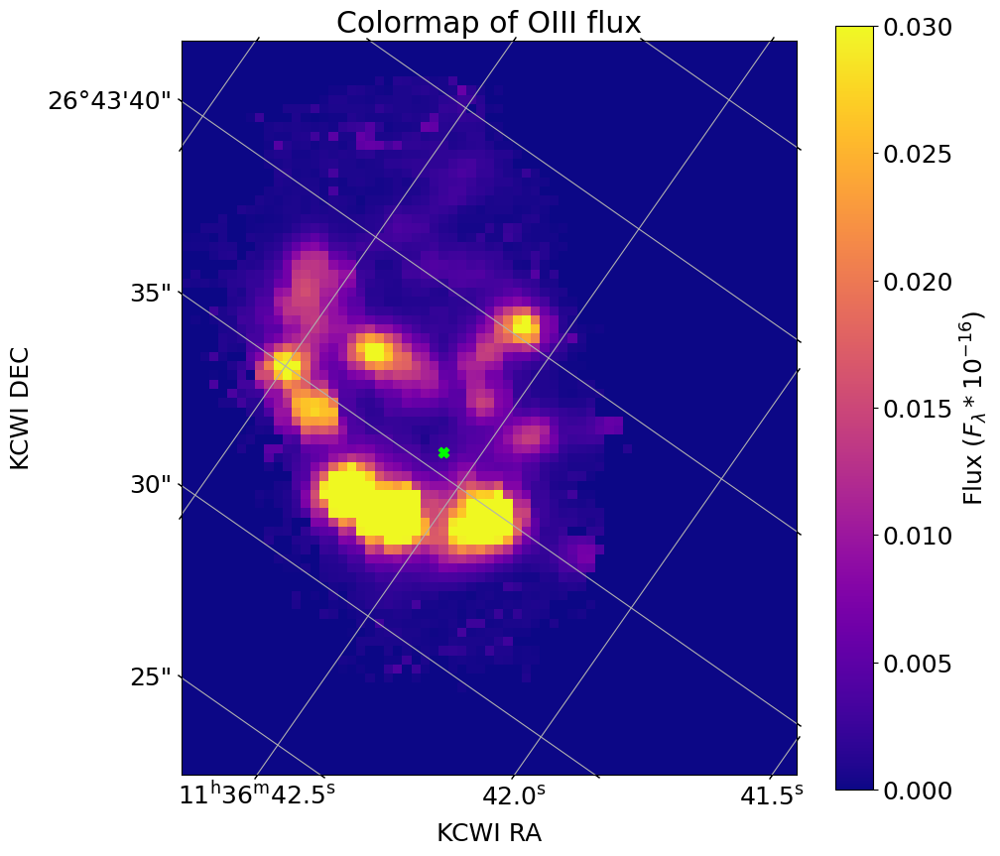

In [38]:
add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'OIII_flux', set_vmax=.03)

In [71]:
Hbeta_flux_map = np.zeros([80,67])
for y_coord in range(0,80):
    for x_coord in range (0,67): 
        if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
            Hbeta_flux_map[y_coord,x_coord] = Gaussian_fit('Data', ['Hbeta'], y_coord, x_coord)[0][2]
        
        else:
            Hbeta_flux_map[y_coord,x_coord] = np.nan

fits.writeto('cmaps/Hbeta_flux_Colormap.fits', Hbeta_flux_map, overwrite = True)

Spaxel [30,9]
Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

Spaxel [30,15]
Spaxel [31,15]
Spaxel [32,15]
Spaxel [33,15]
Spaxel [34,15]
Spaxel [35,15]
Spaxel [36,15]
Spaxel [37,15]
Spaxel [19,16]
Spaxel [20,16]
Spaxel [21,16]
Spaxel [22,16]
Spaxel [23,16]
Spaxel [24,16]
Spaxel [25,16]
Spaxel [26,16]
Spaxel [27,16]
Spaxel [28,16]
Spaxel [29,16]
Spaxel [30,16]
Spaxel [31,16]
Spaxel [32,16]
Spaxel [33,16]
Spaxel [34,16]
Spaxel [35,16]
Spaxel [36,16]
Spaxel [37,16]
Spaxel [38,16]
Spaxel [40,16]
Spaxel [15,17]
Spaxel [16,17]
Spaxel [18,17]
Spaxel [19,17]
Spaxel [20,17]
Spaxel [21,17]
Spaxel [22,17]
Spaxel [23,17]
Spaxel [24,17]
Spaxel [25,17]
Spaxel [26,17]
Spaxel [27,17]
Spaxel [28,17]
Spaxel [29,17]
Spaxel [30,17]
Spaxel [31,17]
Spaxel [32,17]
Spaxel [33,17]
Spaxel [34,17]
Spaxel [35,17]
Spaxel [36,17]
Spaxel [37,17]
Spaxel [38,17]
Spaxel [39,17]
Spaxel [42,17]
Spaxel [43,17]
Spaxel [12,18]
Spaxel [16,18]
Spaxel [17,18]
Spaxel [18,18]
Spaxel [19,18]
Spaxel [20,18]
Spaxel [21,18]
Spaxel [22,18]
Spaxel [23,18]
Spaxel [24,18]
Spaxel [25,18]
Spaxel [26

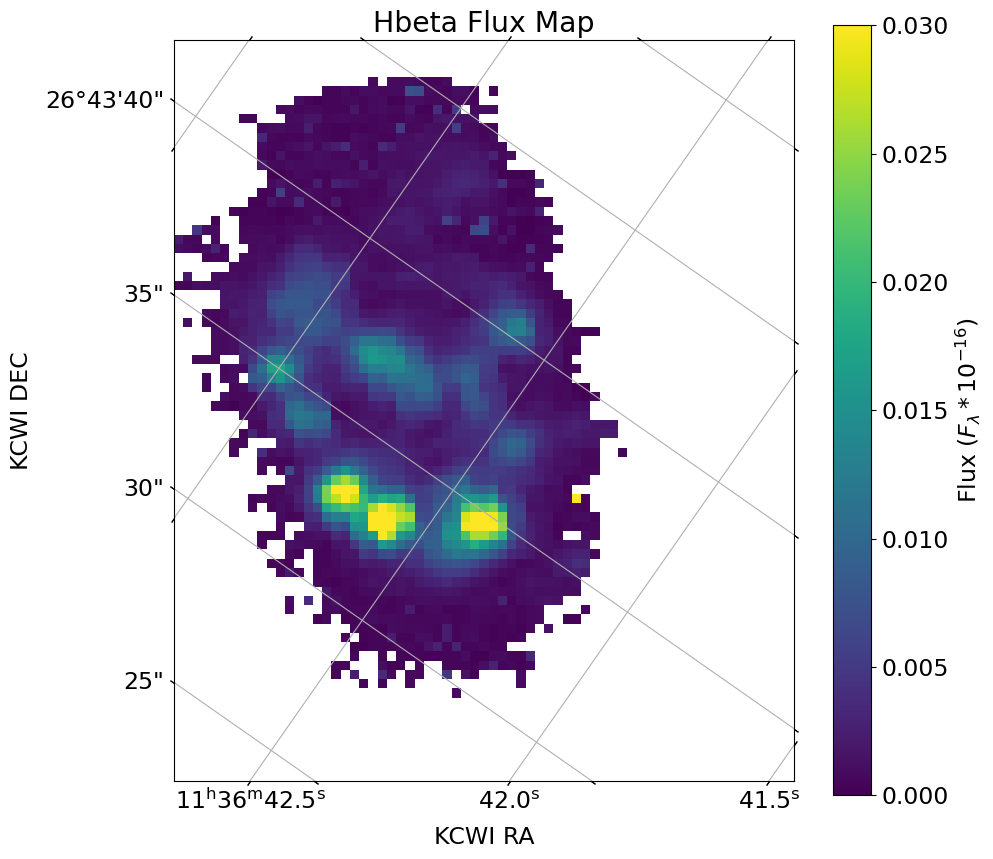

In [78]:
#Displaying Hbeta flux map
#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)
plot = plt.subplot(projection = coords)
plt.title('Hbeta Flux Map')
data = fits.getdata('cmaps/Hbeta_flux_Colormap.fits')
cmap = plt.imshow(data, cmap = 'viridis', vmin = 0, vmax = .03)

plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()
plt.savefig('Hbeta_flux_map.png', bbox_inches='tight')

In [162]:
#OII 3727 flux map
OII_flux_map = np.zeros([80,67])
for y_coord in range(0,80):
    for x_coord in range (0,67): 
        if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
            OII_flux_map[y_coord,x_coord] = Gaussian_fit('Data', ['OII3727'], y_coord, x_coord)[0][2]
        
        else:
            OII_flux_map[y_coord,x_coord] = np.nan

fits.writeto('cmaps/OII_flux_Colormap.fits', OII_flux_map, overwrite = True)

Spaxel [30,9]
Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3090613136.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3090613136.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

Spaxel [19,64]
Spaxel [20,64]
Spaxel [21,64]
Spaxel [22,64]
Spaxel [23,64]
Spaxel [24,64]
Spaxel [25,64]
Spaxel [26,64]
Spaxel [27,64]
Spaxel [28,64]
Spaxel [29,64]
Spaxel [30,64]
Spaxel [31,64]
Spaxel [32,64]
Spaxel [33,64]
Spaxel [34,64]
Spaxel [35,64]
Spaxel [36,64]
Spaxel [37,64]
Spaxel [38,64]
Spaxel [39,64]
Spaxel [10,65]
Spaxel [11,65]
Spaxel [12,65]
Spaxel [13,65]
Spaxel [14,65]
Spaxel [15,65]
Spaxel [16,65]
Spaxel [17,65]
Spaxel [18,65]
Spaxel [19,65]
Spaxel [20,65]
Spaxel [21,65]
Spaxel [22,65]
Spaxel [23,65]
Spaxel [24,65]
Spaxel [25,65]
Spaxel [26,65]
Spaxel [27,65]
Spaxel [28,65]
Spaxel [29,65]
Spaxel [30,65]
Spaxel [31,65]
Spaxel [32,65]
Spaxel [33,65]
Spaxel [34,65]
Spaxel [35,65]
Spaxel [36,65]
Spaxel [37,65]
Spaxel [38,65]
Spaxel [9,66]
Spaxel [10,66]
Spaxel [11,66]
Spaxel [12,66]
Spaxel [13,66]
Spaxel [14,66]
Spaxel [15,66]
Spaxel [16,66]
Spaxel [17,66]
Spaxel [18,66]
Spaxel [19,66]
Spaxel [20,66]
Spaxel [21,66]
Spaxel [22,66]
Spaxel [23,66]
Spaxel [24,66]
Spaxel [25,

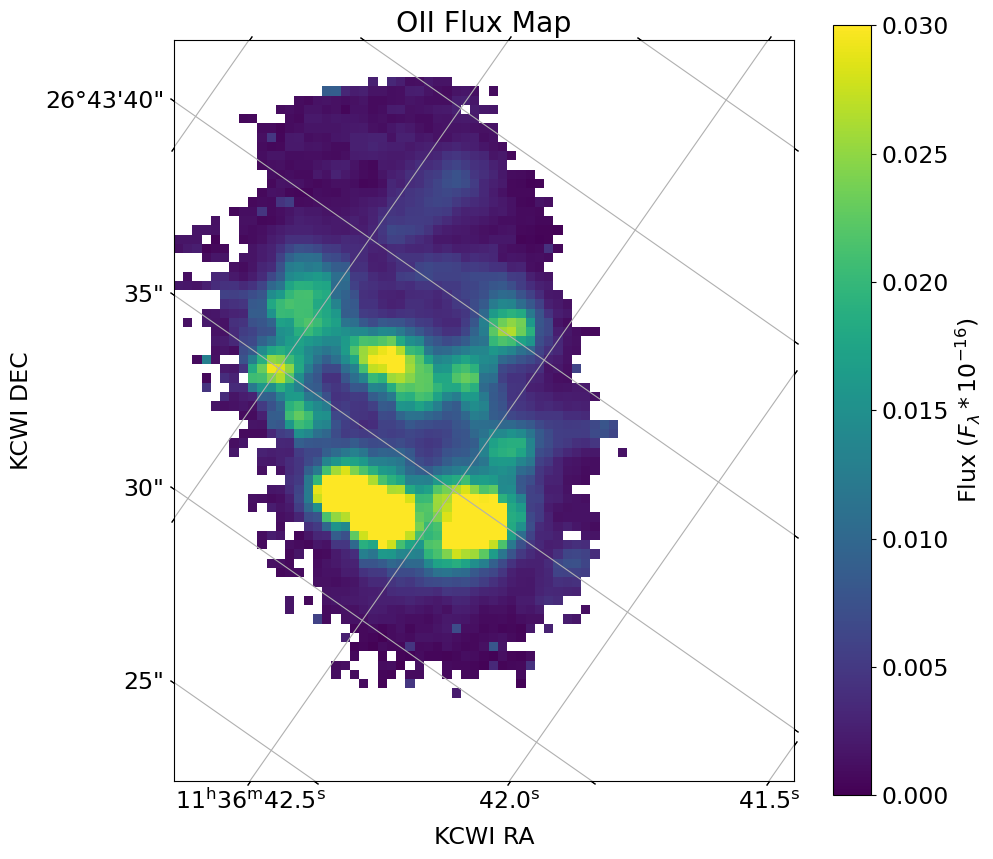

In [79]:
#Displaying OII flux map
#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)
plot = plt.subplot(projection = coords)
plt.title('OII Flux Map')
data = fits.getdata('cmaps/OII_flux_Colormap.fits')
cmap = plt.imshow(data, cmap = 'viridis', vmin = 0, vmax = .03)

plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()
plt.savefig('OII_flux_map.png', bbox_inches='tight')

28.02606651075986 34.697076776399825


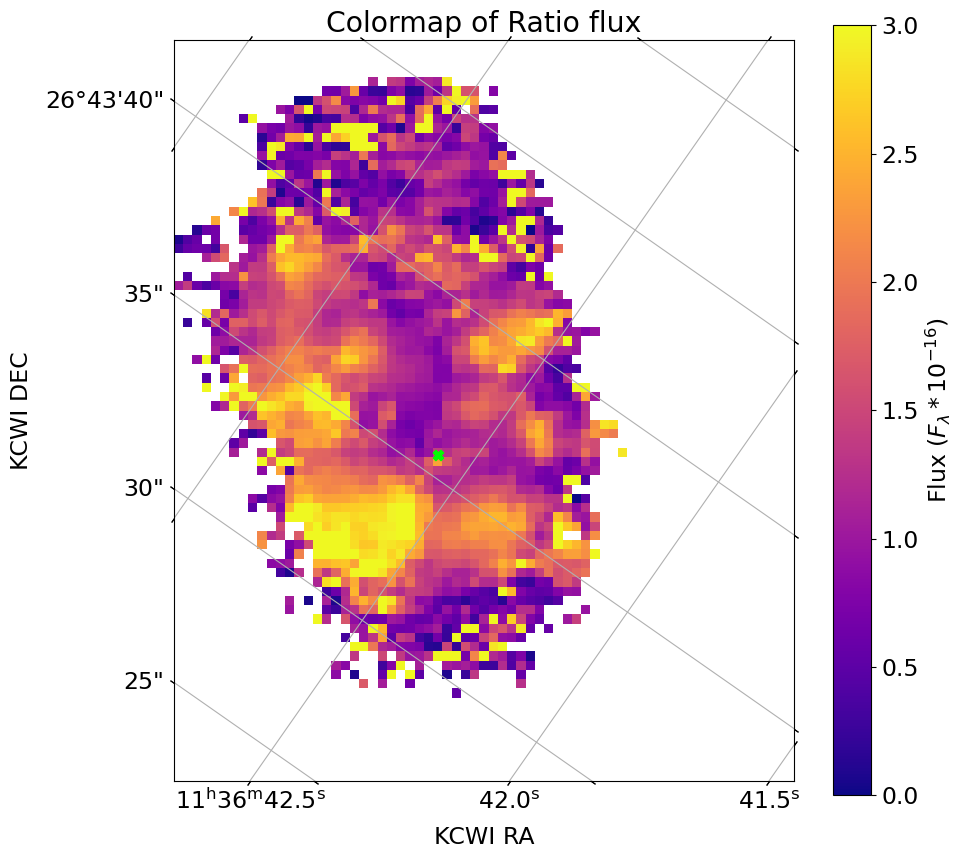

In [59]:
#ratio of OIII to Hbeta flux map
Hbeta_map_data = fits.getdata('cmaps/Hbeta_flux_Colormap.fits')
OIII_map_data = fits.getdata('cmaps/OIII_flux_Colormap.fits')

Ratio_map = OIII_map_data/Hbeta_map_data

fits.writeto('cmaps/Ratio_flux_Colormap.fits', Ratio_map, overwrite = True)

add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'Ratio_flux', False)
plt.savefig('Flux_ratio_map.png', bbox_inches='tight')

#### Integrated Flux Colormaps of Hbeta, OIII5007, and OII3727

In [75]:
#Integrated flux map of Hbeta
#empty map
Hbeta_integrated_flux_map = np.zeros([80,67])
for y_coord in range(0,80):
    for x_coord in range (0,67): 
        #check for 0 values in flux and wvl
        if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
            #get amplitude and stddev of line at spaxel
            g_fit = Gaussian_fit('Data', ['Hbeta'], y_coord, x_coord)[0]
            stddev = g_fit[3]
            amplitude = g_fit[2]
            #fill map
            Hbeta_integrated_flux_map[y_coord,x_coord] = amplitude * stddev * (np.sqrt(2*np.pi))
        
        else:
            Hbeta_integrated_flux_map[y_coord,x_coord] = np.nan

fits.writeto('cmaps/Hbeta_integrated_flux_Colormap.fits', Hbeta_integrated_flux_map, overwrite = True)


Spaxel [30,9]
Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/2662086703.py:13: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Hbeta_integrated

Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

Spaxel [29,15]
Spaxel [30,15]
Spaxel [31,15]
Spaxel [32,15]
Spaxel [33,15]
Spaxel [34,15]
Spaxel [35,15]
Spaxel [36,15]
Spaxel [37,15]
Spaxel [19,16]
Spaxel [20,16]
Spaxel [21,16]
Spaxel [22,16]
Spaxel [23,16]
Spaxel [24,16]
Spaxel [25,16]
Spaxel [26,16]
Spaxel [27,16]
Spaxel [28,16]
Spaxel [29,16]
Spaxel [30,16]
Spaxel [31,16]
Spaxel [32,16]
Spaxel [33,16]
Spaxel [34,16]
Spaxel [35,16]
Spaxel [36,16]
Spaxel [37,16]
Spaxel [38,16]
Spaxel [40,16]
Spaxel [15,17]
Spaxel [16,17]
Spaxel [18,17]
Spaxel [19,17]
Spaxel [20,17]
Spaxel [21,17]
Spaxel [22,17]
Spaxel [23,17]
Spaxel [24,17]
Spaxel [25,17]
Spaxel [26,17]
Spaxel [27,17]
Spaxel [28,17]
Spaxel [29,17]
Spaxel [30,17]
Spaxel [31,17]
Spaxel [32,17]
Spaxel [33,17]
Spaxel [34,17]
Spaxel [35,17]
Spaxel [36,17]
Spaxel [37,17]
Spaxel [38,17]
Spaxel [39,17]
Spaxel [42,17]
Spaxel [43,17]
Spaxel [12,18]
Spaxel [16,18]
Spaxel [17,18]
Spaxel [18,18]
Spaxel [19,18]
Spaxel [20,18]
Spaxel [21,18]
Spaxel [22,18]
Spaxel [23,18]
Spaxel [24,18]
Spaxel [25

28.02606651075986 34.697076776399825


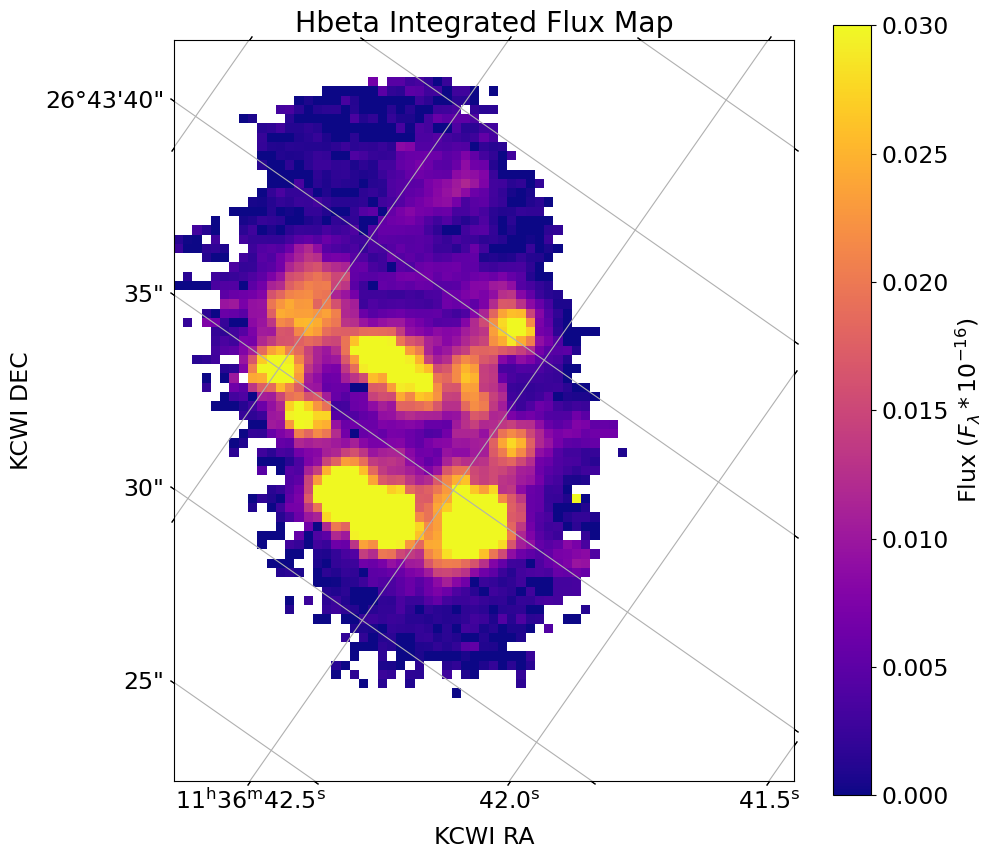

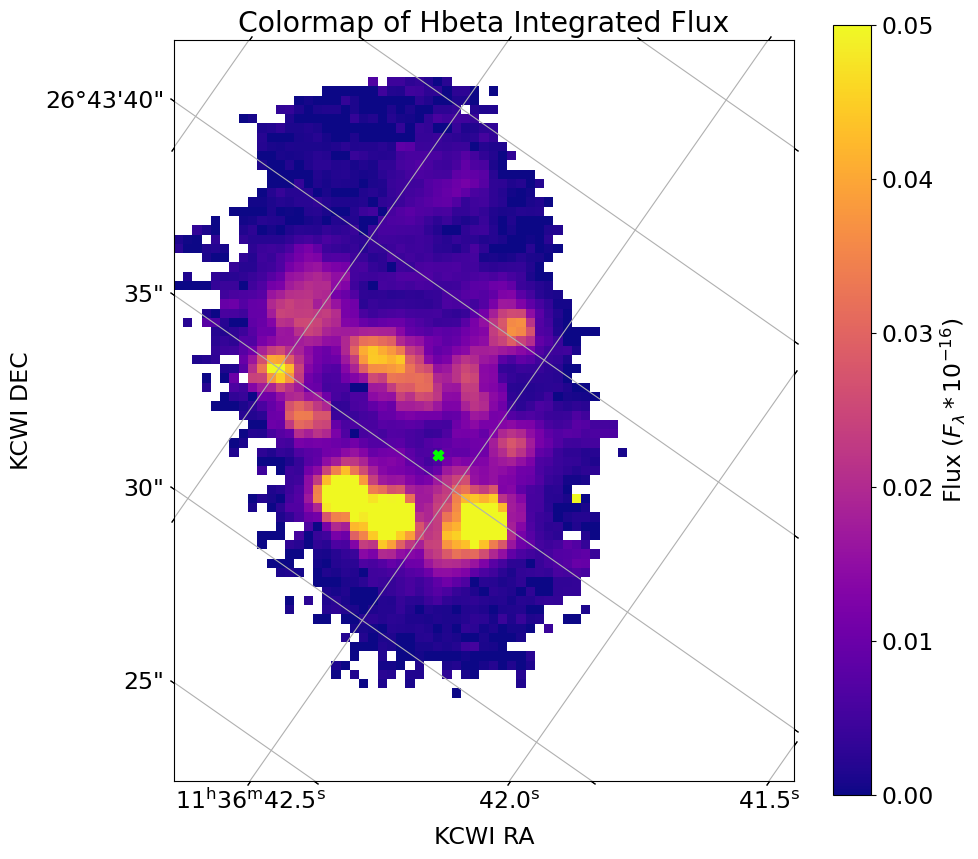

In [80]:
ra_targ = 174.17740 * u.degree #degrees
dec_targ = 26.72657 * u.degree #degrees

#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)
plot = plt.subplot(projection = coords)
plt.title('Hbeta Integrated Flux Map')
data = fits.getdata('cmaps/Hbeta_integrated_flux_Colormap.fits')
cmap = plt.imshow(data, cmap = 'plasma', vmin = 0, vmax = .03)
#plt.scatter(22,38)
#plt.scatter(31, 35)
plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()
#As a sanity check, running add targ to make sure maps are the same
add_targ(ra_targ, dec_targ, 'Data/reines65_icubes.fits', 'Hbeta_Integrated_Flux', False, .05)
plt.savefig('Hbeta_integrated_flux_cmap.png', bbox_inches='tight')


In [534]:
#Integrated flux map of OIII
#empty map
OIII_integrated_flux_map = np.zeros([80,67])
for y_coord in range(0,80):
    for x_coord in range (0,67): 
        #check for 0 values in flux and wvl
        if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
            #get amplitude and stddev of line at spaxel
            g_fit = Gaussian_fit('Data', ['OIII5007'], y_coord, x_coord)[0]
            stddev = g_fit[3]
            amplitude = g_fit[2]
            #fill map
            OIII_integrated_flux_map[y_coord,x_coord] = amplitude * stddev * (np.sqrt(2*np.pi))
        
        else:
            OIII_integrated_flux_map[y_coord,x_coord] = np.nan

fits.writeto('cmaps/OIII_integrated_flux_Colormap.fits', OIII_flux_map, overwrite = True)


Spaxel [30,9]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/245203141.py:13: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  OIII_integrate

Spaxel [20,10]
Spaxel [22,10]


Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22,15]
Spaxel [23

Spaxel [9,39]
Spaxel [10,39]
Spaxel [11,39]
Spaxel [12,39]
Spaxel [13,39]
Spaxel [14,39]
Spaxel [15,39]
Spaxel [16,39]
Spaxel [17,39]
Spaxel [18,39]
Spaxel [19,39]
Spaxel [20,39]
Spaxel [21,39]
Spaxel [22,39]
Spaxel [23,39]
Spaxel [24,39]
Spaxel [25,39]
Spaxel [26,39]
Spaxel [27,39]
Spaxel [28,39]
Spaxel [29,39]
Spaxel [30,39]
Spaxel [31,39]
Spaxel [32,39]
Spaxel [33,39]
Spaxel [34,39]
Spaxel [35,39]
Spaxel [36,39]
Spaxel [37,39]
Spaxel [38,39]
Spaxel [39,39]
Spaxel [40,39]
Spaxel [41,39]
Spaxel [42,39]
Spaxel [43,39]
Spaxel [44,39]
Spaxel [4,40]
Spaxel [5,40]
Spaxel [6,40]
Spaxel [7,40]
Spaxel [8,40]
Spaxel [9,40]
Spaxel [10,40]
Spaxel [11,40]
Spaxel [12,40]
Spaxel [13,40]
Spaxel [14,40]
Spaxel [15,40]
Spaxel [16,40]
Spaxel [17,40]
Spaxel [18,40]
Spaxel [19,40]
Spaxel [20,40]
Spaxel [21,40]
Spaxel [22,40]
Spaxel [23,40]
Spaxel [24,40]
Spaxel [25,40]
Spaxel [26,40]
Spaxel [27,40]
Spaxel [28,40]
Spaxel [29,40]
Spaxel [30,40]
Spaxel [31,40]
Spaxel [32,40]
Spaxel [33,40]
Spaxel [34,40]
Sp

(2598, 80, 67)


Set MJD-BEG to 58870.621278 from DATE-BEG.
Set MJD-END to 58870.628223 from DATE-END'. [astropy.wcs.wcs]


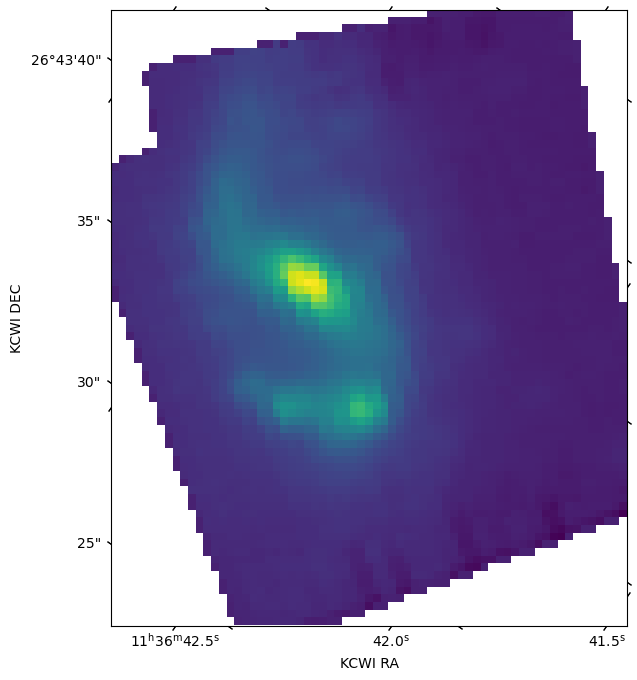

In [77]:
#Whitelight image from original cubes (adapted from VDA)
#Getting data
icube = fits.open('Data/reines65_icubes.fits')
data = icube[0].data
vcube = fits.open('Data/reines65_vcubes.fits')
var = vcube[0].data
mcube = fits.open('Data/reines65_mcubes.fits')
mask = mcube[0].data
#negative and infinite variance
var[np.where(var < 0)] = np.mean(var[np.where((np.isfinite(var)))])
var[np.where((~np.isfinite(var)))] = np.mean(var[np.where((np.isfinite(var)))])
#masking data and variance arrays
data = np.ma.array(data, mask=mask)
var = np.ma.array(var, mask=mask)
print(np.shape(data))
#Header
header = icube[0].header
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
coords = WCS(header)
#Whitelight image
fig = plt.figure(figsize=(8,8))
ax = plt.subplot(projection=coords,slices=('x', 'y', 50))
totaldata = np.ma.sum(data, axis=0)
plt.imshow(totaldata)

28.02606651075986 34.697076776399825


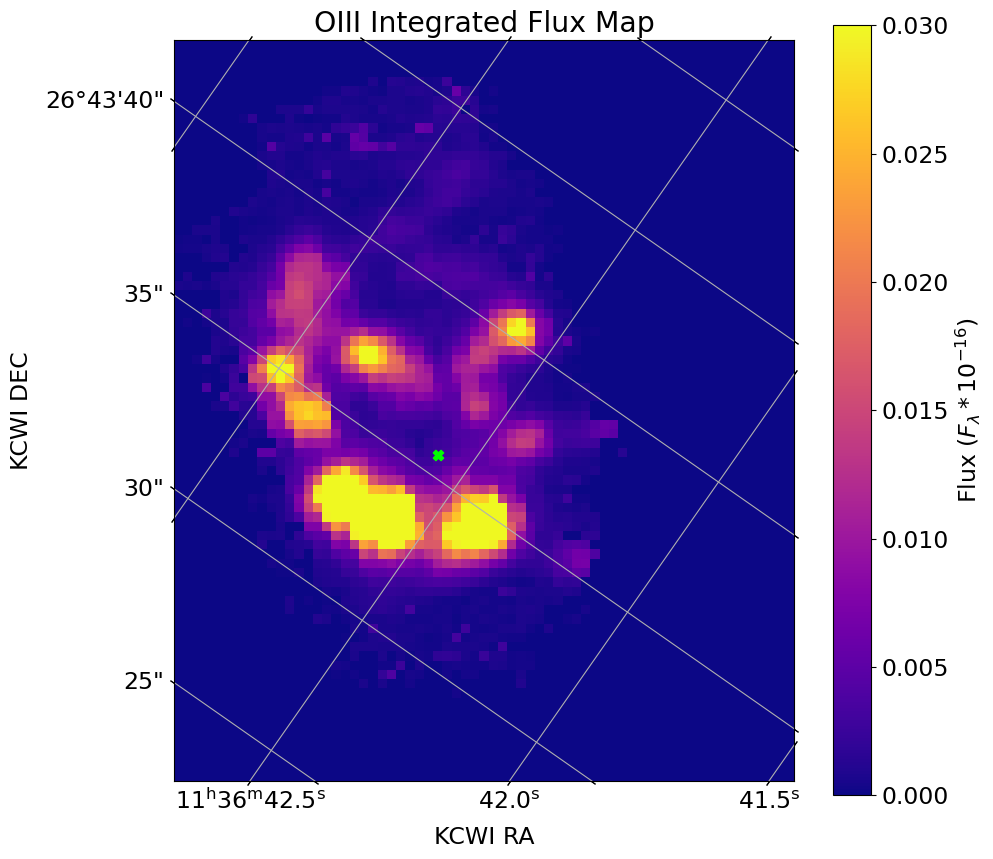

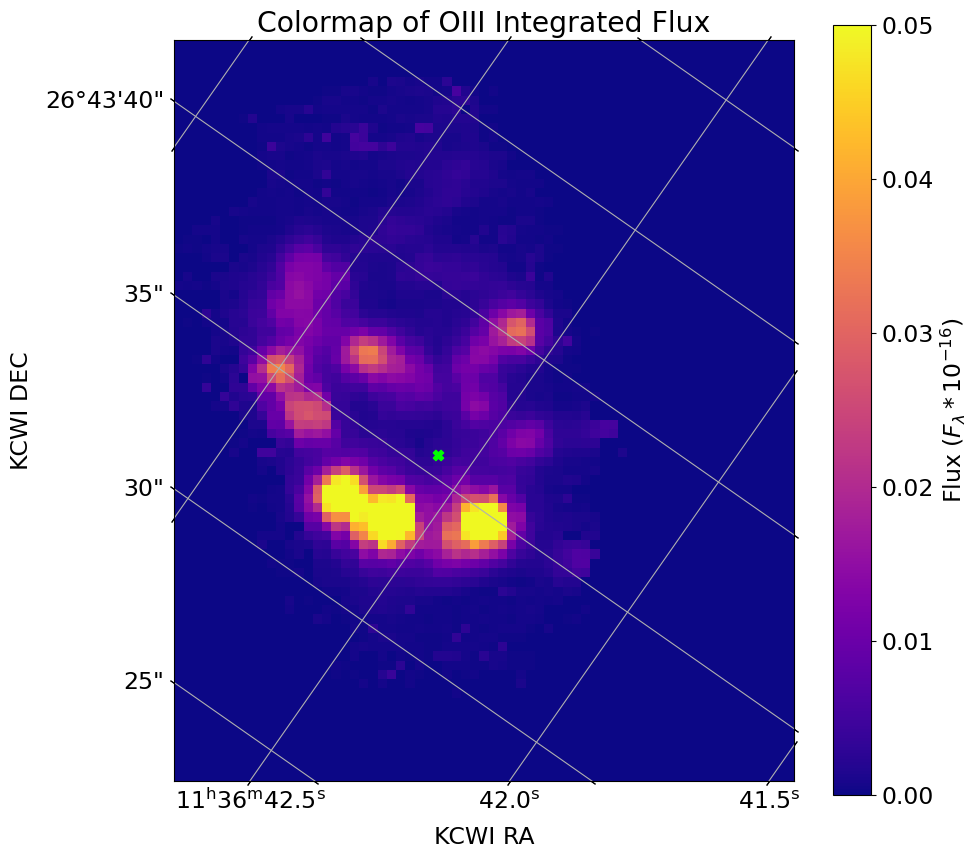

In [81]:

ra_targ = 174.17740 * u.degree #degrees
dec_targ = 26.72657 * u.degree #degrees
#Sanity check for integrated OIII
#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583

#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)
#header_frame = wcs_to_celestial_frame(coords)

plot = plt.subplot(projection = coords)
plt.title('OIII Integrated Flux Map')
#Fixing frame
data = fits.getdata('cmaps/OIII_integrated_flux_Colormap.fits')
cmap = plot.imshow(data, cmap = 'plasma', vmin = 0, vmax = .03)
plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()
#Plotting the target
c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')
#plot.plot_coord(c_targ, 'o')
x,y = coords.world_to_pixel(c_targ)
plt.scatter(x,y, color = 'lime', s = 55, marker='X')

add_targ(ra_targ, dec_targ, 'data/reines65_icubes.fits', 'OIII_Integrated_Flux', set_vmax=.05)
plt.savefig('OIII_integrated_flux_colormap.png', bbox_inches='tight')
#Coords check



In [80]:
#Integrated flux map of OII doublet
#empty map
OII_integrated_flux_map = np.zeros([80,67])
for y_coord in range(0,80):
    for x_coord in range (0,67): 
        #check for 0 values in flux and wvl
        if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
            #get amplitude and stddev of line at spaxel
            g_fit = Gaussian_fit('Data', ['OII3727'], y_coord, x_coord)[0]
            stddev = g_fit[3]
            amplitude = g_fit[2]
            #fill map
            OII_integrated_flux_map[y_coord,x_coord] = amplitude * stddev * (np.sqrt(2*np.pi))
        
        else:
            OII_integrated_flux_map[y_coord,x_coord] = np.nan

fits.writeto('cmaps/OII_integrated_flux_Colormap.fits', OII_integrated_flux_map, overwrite = True)


Spaxel [30,9]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3808596988.py:13: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  OII_integrated_flux_map[y_coord,x_coord] = amplitude * stddev * (np.sqrt(2*np.pi))


Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

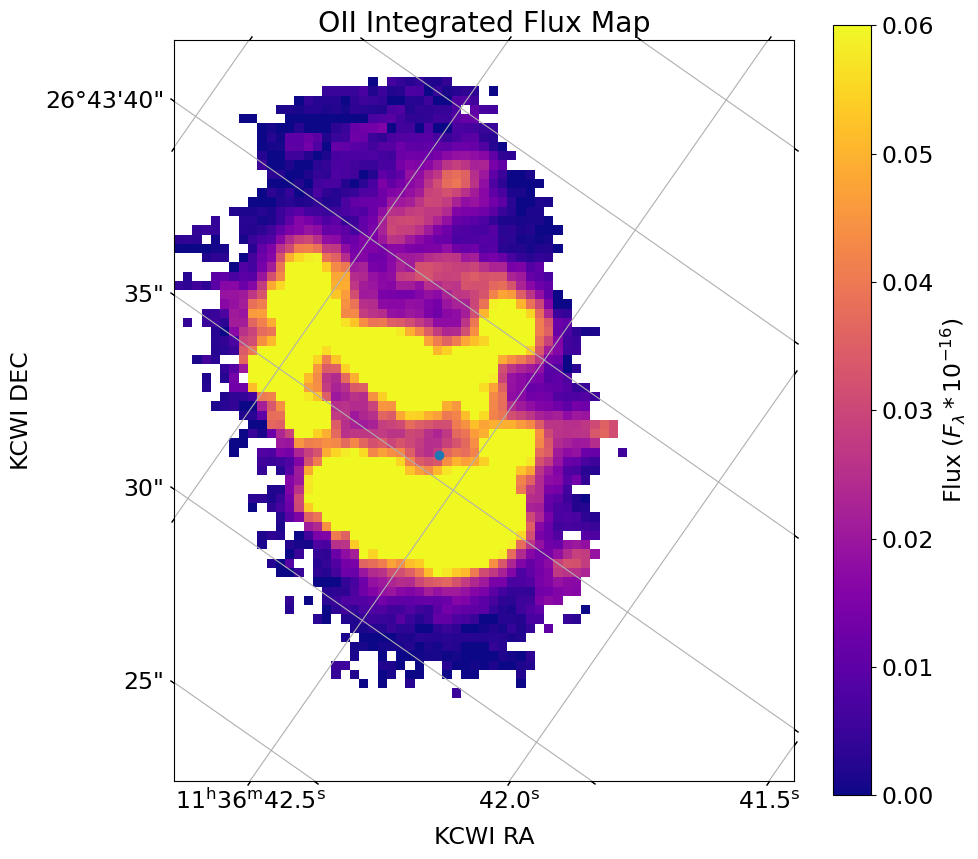

In [82]:
#Coords check
ra_targ = 174.17740 * u.degree #degrees
dec_targ = 26.72657 * u.degree #degrees

header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583

#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
coords = WCS(header, naxis = 2)
header_frame = wcs_to_celestial_frame(coords)
c_targ = SkyCoord(ra_targ, dec_targ, frame=header_frame)

plt.figure(figsize=(10,10))
plot = plt.subplot(projection = coords)
plt.title('OII Integrated Flux Map')
data = fits.getdata('cmaps/OII_integrated_flux_Colormap.fits')
cmap = plot.imshow(data, cmap = 'plasma', vmin = 0, vmax = .06)
plot.plot_coord(c_targ, 'o')

plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()


28.02606651075986 34.697076776399825


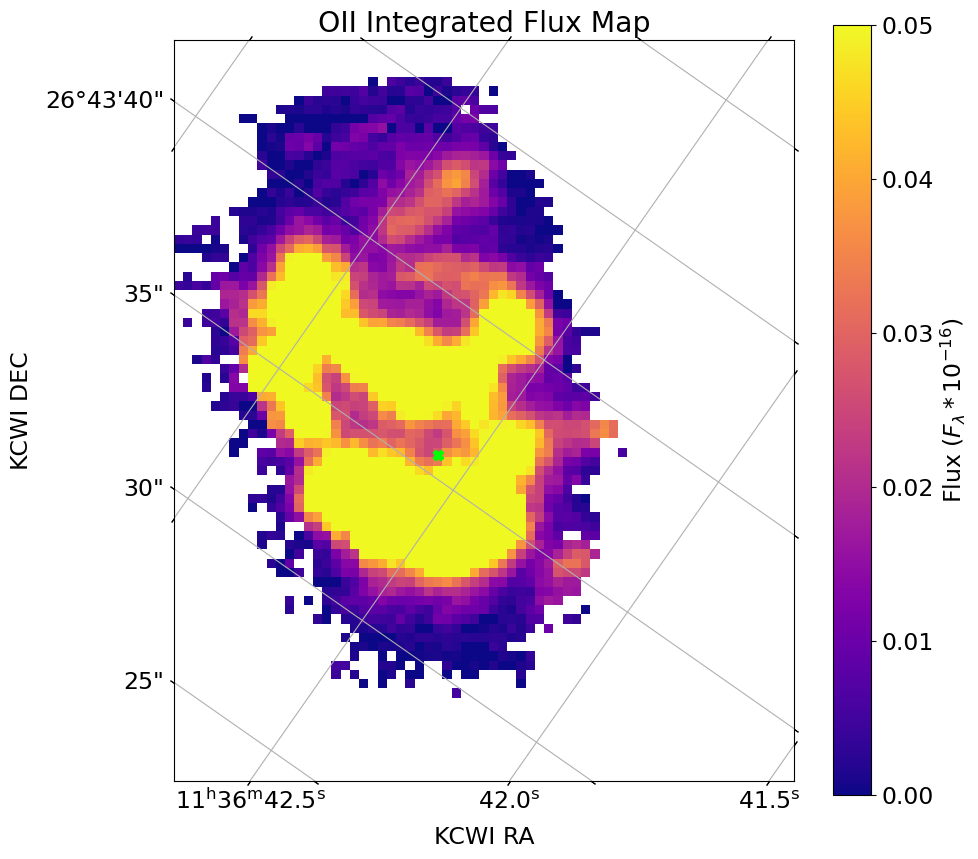

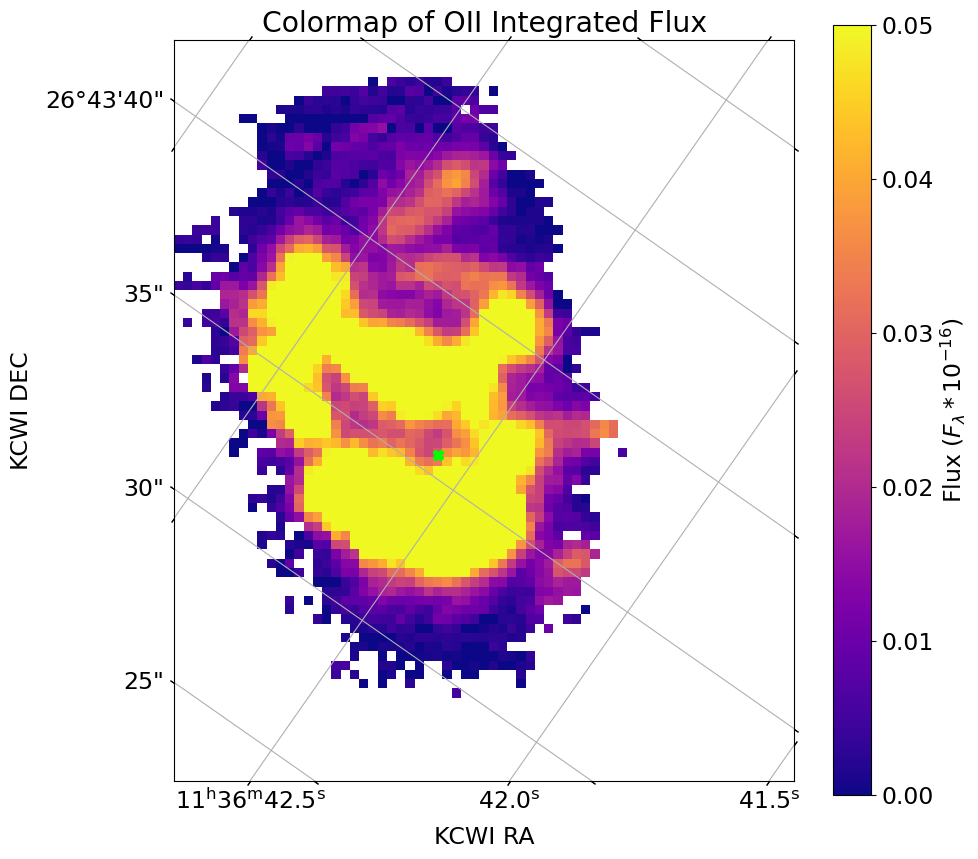

In [66]:
#Sanity check for integrated OII
#Get header info 
header = fits.getheader('Data/reines65_icubes.fits')
#Pointing corrections
header['CRVAL1'] += 174.17801 - 174.1787083
header['CRVAL2'] += 26.727126 - 26.7263583
#Create colormap w/coords in RA and Dec
#3 WCS axes (RA, Dec, Wavelength) so need to select RA and Dec
plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)

plot = plt.subplot(projection = coords)
plt.title('OII Integrated Flux Map')
data = fits.getdata('cmaps/OII_integrated_flux_Colormap.fits')


cmap = plt.imshow(data, cmap = 'plasma', vmin = 0, vmax = .05)
plt.colorbar(cmap, label = 'Flux ($F_\lambda*10^{-16}$)')
plt.grid()
c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')
x,y = coords.world_to_pixel(c_targ)
plt.scatter(x, y, color = 'lime', s = 55, marker='X')

#Sanity check
add_targ(ra_targ, dec_targ, 'data/reines65_icubes.fits', 'OII_Integrated_Flux', set_vmax=.05)
plt.savefig('OII_integrated_flux_colormap.png', bbox_inches='tight')

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2429532945.py:7: RuntimeWarning: divide by zero encountered in divide
  Ratio_map = OIII_map_data/Hbeta_map_data


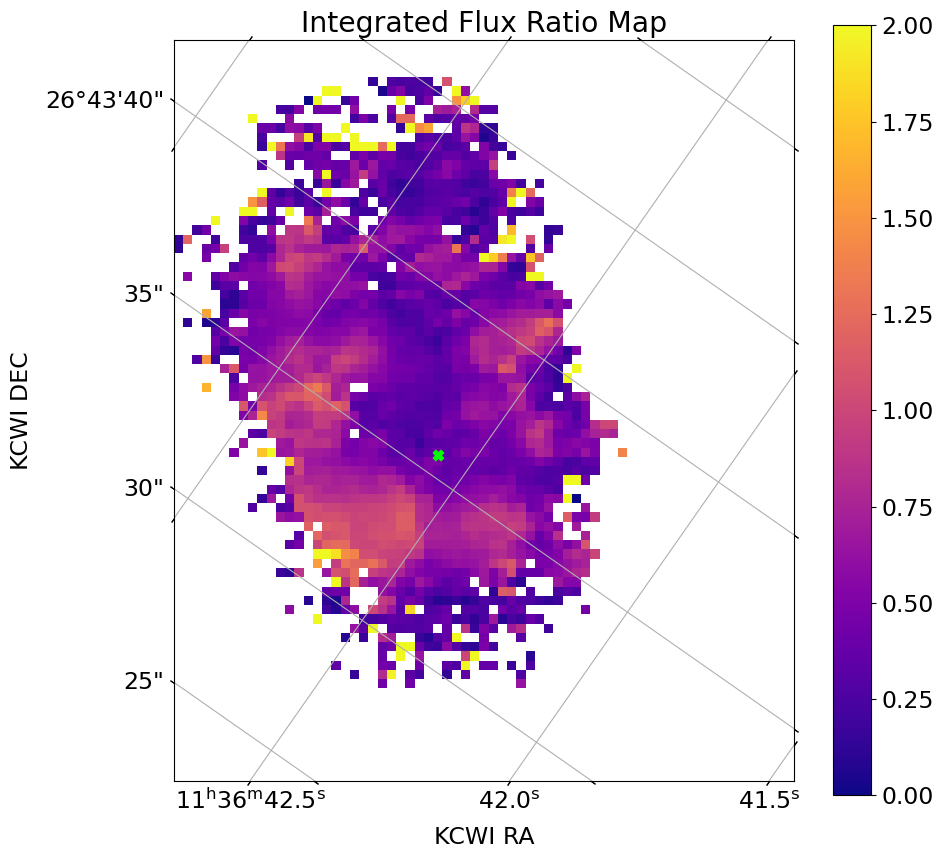

In [83]:
ra_targ = 174.17740 * u.degree #degrees
dec_targ = 26.72657 * u.degree #degrees

Hbeta_map_data = fits.getdata('cmaps/Hbeta_integrated_flux_colormap.fits')
OIII_map_data = fits.getdata('cmaps/OIII_integrated_flux_colormap.fits')

Ratio_map = OIII_map_data/Hbeta_map_data

fits.writeto('cmaps/Ratio_integrated_flux_colormap.fits', Ratio_map, overwrite = True)

plt.figure(figsize=(10,10))
coords = WCS(header, naxis = 2)

plot = plt.subplot(projection = coords)
plt.title('Integrated Flux Ratio Map')
data = fits.getdata('cmaps/Ratio_integrated_flux_Colormap.fits')
cmap = plt.imshow(data, cmap = 'plasma', vmin = 0, vmax = 2)
plt.colorbar(cmap)
plt.grid()
c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')
x,y = coords.world_to_pixel(c_targ)
plt.scatter(x, y, color = 'lime', s = 55, marker='X')

plt.savefig('Integrated_flux_ratio_map.png', bbox_inches='tight')

In [84]:
#Function to create integrated map
def integrate_map(linename, ylen = 80, xlen = 67):
    """
    Function creates an integrated flux map of given emline and saves figure. 
    
    Inputs:
    linename (str): name of line to created integrated flux map of.

    Outputs:
    integrated_flux_map (array): color map of integreated emission line flux.
    """  
    integrated_flux_map = np.zeros([ylen,xlen])

    for y_coord in range(0,ylen):
        for x_coord in range (0,xlen): 
            #check for 0 values in flux and wvl
            if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
                #get amplitude and stddev of line at spaxel
                g_fit = Gaussian_fit('Data', [linename], y_coord, x_coord)[0]
                stddev = g_fit[3]
                amplitude = g_fit[2]
                #fill map
                integrated_flux_map[y_coord,x_coord] = amplitude * stddev * (np.sqrt(2*np.pi))
            
            else:
                integrated_flux_map[y_coord,x_coord] = np.nan

    fits.writeto('cmaps/' + linename + '_integrated_flux_Colormap.fits', integrated_flux_map, overwrite = True)
    return integrated_flux_map

In [85]:
integrate_map('Hbeta')

Spaxel [30,9]
Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3660083892.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  integrated_flux_

Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

Spaxel [30,15]
Spaxel [31,15]
Spaxel [32,15]
Spaxel [33,15]
Spaxel [34,15]
Spaxel [35,15]
Spaxel [36,15]
Spaxel [37,15]
Spaxel [19,16]
Spaxel [20,16]
Spaxel [21,16]
Spaxel [22,16]
Spaxel [23,16]
Spaxel [24,16]
Spaxel [25,16]
Spaxel [26,16]
Spaxel [27,16]
Spaxel [28,16]
Spaxel [29,16]
Spaxel [30,16]
Spaxel [31,16]
Spaxel [32,16]
Spaxel [33,16]
Spaxel [34,16]
Spaxel [35,16]
Spaxel [36,16]
Spaxel [37,16]
Spaxel [38,16]
Spaxel [40,16]
Spaxel [15,17]
Spaxel [16,17]
Spaxel [18,17]
Spaxel [19,17]
Spaxel [20,17]
Spaxel [21,17]
Spaxel [22,17]
Spaxel [23,17]
Spaxel [24,17]
Spaxel [25,17]
Spaxel [26,17]
Spaxel [27,17]
Spaxel [28,17]
Spaxel [29,17]
Spaxel [30,17]
Spaxel [31,17]
Spaxel [32,17]
Spaxel [33,17]
Spaxel [34,17]
Spaxel [35,17]
Spaxel [36,17]
Spaxel [37,17]
Spaxel [38,17]
Spaxel [39,17]
Spaxel [42,17]
Spaxel [43,17]
Spaxel [12,18]
Spaxel [16,18]
Spaxel [17,18]
Spaxel [18,18]
Spaxel [19,18]
Spaxel [20,18]
Spaxel [21,18]
Spaxel [22,18]
Spaxel [23,18]
Spaxel [24,18]
Spaxel [25,18]
Spaxel [26

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

In [86]:
integrate_map('NeIII3869')

Spaxel [30,9]
Spaxel [20,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3660083892.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  integrated_flux_

Spaxel [22,10]
Spaxel [25,10]
Spaxel [37,10]
Spaxel [17,11]
Spaxel [19,11]
Spaxel [22,11]
Spaxel [23,11]
Spaxel [25,11]
Spaxel [26,11]
Spaxel [29,11]
Spaxel [31,11]
Spaxel [32,11]
Spaxel [37,11]
Spaxel [17,12]
Spaxel [18,12]
Spaxel [22,12]
Spaxel [23,12]
Spaxel [24,12]
Spaxel [26,12]
Spaxel [29,12]
Spaxel [30,12]
Spaxel [31,12]
Spaxel [32,12]
Spaxel [33,12]
Spaxel [34,12]
Spaxel [35,12]
Spaxel [36,12]
Spaxel [37,12]
Spaxel [38,12]
Spaxel [19,13]
Spaxel [22,13]
Spaxel [24,13]
Spaxel [25,13]
Spaxel [26,13]
Spaxel [27,13]
Spaxel [28,13]
Spaxel [29,13]
Spaxel [30,13]
Spaxel [31,13]
Spaxel [32,13]
Spaxel [33,13]
Spaxel [34,13]
Spaxel [35,13]
Spaxel [36,13]
Spaxel [37,13]
Spaxel [38,13]
Spaxel [19,14]
Spaxel [20,14]
Spaxel [21,14]
Spaxel [22,14]
Spaxel [23,14]
Spaxel [24,14]
Spaxel [25,14]
Spaxel [26,14]
Spaxel [27,14]
Spaxel [28,14]
Spaxel [29,14]
Spaxel [30,14]
Spaxel [31,14]
Spaxel [32,14]
Spaxel [33,14]
Spaxel [34,14]
Spaxel [35,14]
Spaxel [18,15]
Spaxel [20,15]
Spaxel [21,15]
Spaxel [22

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

28.02606651075986 34.697076776399825


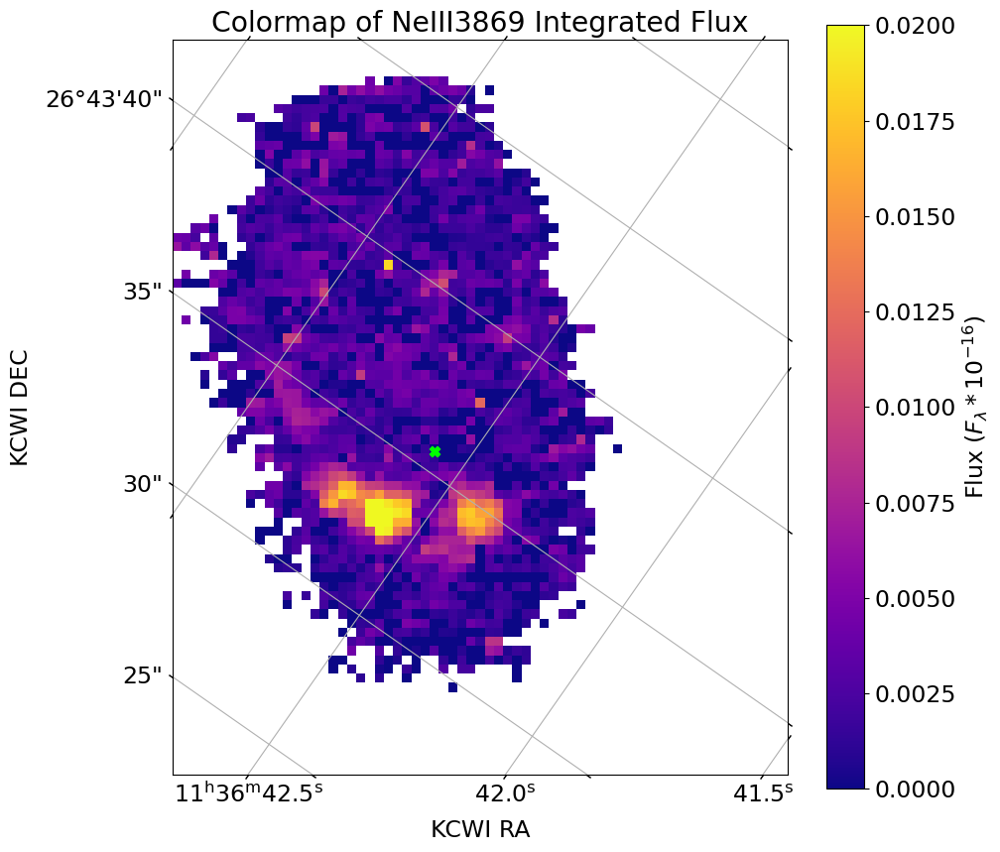

In [84]:
add_targ(ra_targ, dec_targ, 'data/reines65_icubes.fits', 'NeIII3869_Integrated_Flux', set_vmax=.02)
plt.savefig('NeIII_integrated_flux_colormap.png', bbox_inches='tight')

Fitting Gaussian models to lines...
Spaxel [28,34]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_897/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4863.976592323585, 0.0014353382414616183, 1.8863925312484908, 8.884229890761235, 9, array([-0.22562499]), <Gaussian1D(amplitude=0.00143534, mean=4863.97659232, stddev=1.88639253)>], ['OII3727', 3730.538538179574, 0.006919137153071721, 1.9373174599628544, 9.124067976617946, 11, array([1.23319335]), <Gaussian1D(amplitude=0.00691914, mean=3730.53853818, stddev=1.93731746)>], ['OIII5007', 5009.699742896998, 0.0033958793652217674, 1.2652306217927045, 5.958780859568865, 5, array([-0.27934659]), <Gaussian1D(amplitude=0.00339588, mean=5009.6997429, stddev=1.26523062)>], ['NeIII3869', 3865.517046952036, 0.000571948743557663, 0.8179793009074429, 3.852388108394498, 5, array([-0.59916623]), <Gaussian1D(amplitude=0.00057195, mean=3865.51704695, stddev=0.8179793)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
Left starting wvl:  4843.8068487841665
Wavelength flux:  [-1.56598047e-05]
Right starting wvl:  4866.443559159148
Flux continuum values:  

[array([19.37728661]),
 array([136.17615212]),
 array([54.98268377]),
 array([2.13318947])]

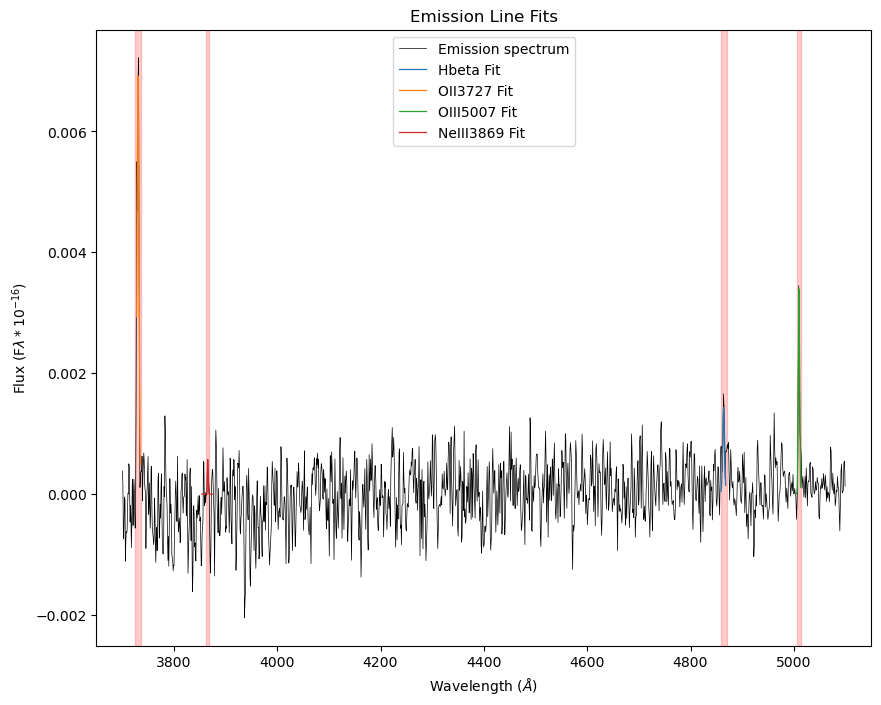

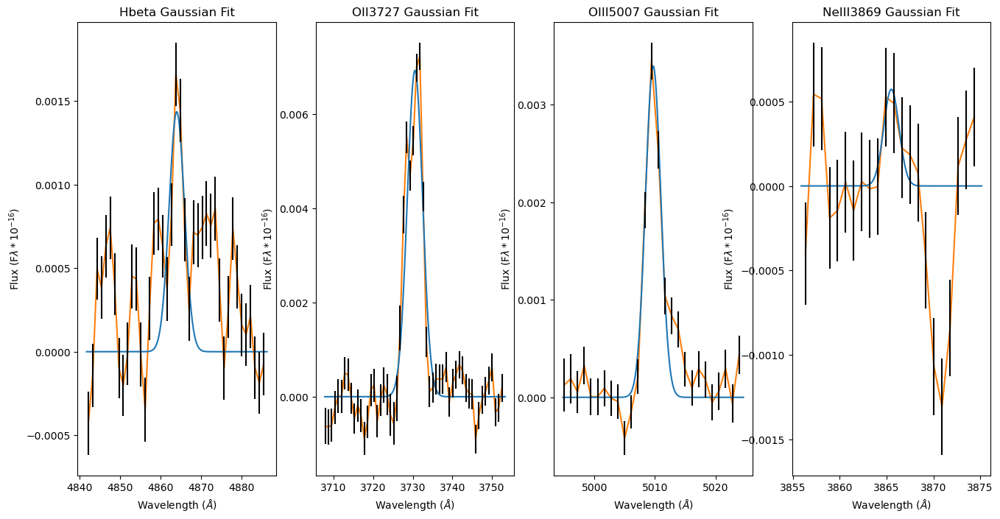

In [90]:
#Checking spectrum fits of radio source spaxel
calculate_SN('Data', ['Hbeta', 'OII3727','OIII5007', 'NeIII3869'], spaxel_coords_y = 34, spaxel_coords_x = 28, makeplots = True)

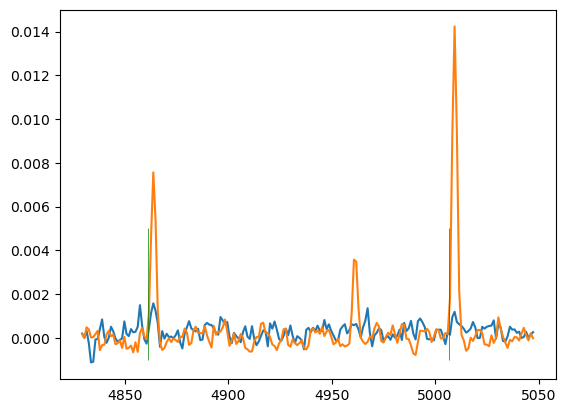

In [186]:
#Comparing two spaxels
spaxel_flux = flux_array[:,36,26]
spaxel_wvl = wvl_array[:,36,26]
plt.plot(spaxel_wvl[1200:1400],spaxel_flux[1200:1400])

spaxel_flux = flux_array[:,40,32]
spaxel_wvl = wvl_array[:,36,26]
plt.plot(spaxel_wvl[1200:1400],spaxel_flux[1200:1400])

plt.vlines(x = 4861.35, ymin = -.001, ymax = .005, color = 'green', linewidth = .5)
plt.vlines(x = 5006.8, ymin = -.001, ymax = .005, color = 'red', linewidth = .5)

#### Emission line width maps

In [192]:
#Width of OIII5007 across galaxy
OIII_width_map = np.zeros([80,67])
for y_spaxel in range(0, 80):
    for x_spaxel in range(0,67):
        try:
            width = Gaussian_fit('data', ['OIII5007'], y_spaxel, x_spaxel, makeplots = False)[0][4]
            OIII_width_map[y_spaxel,x_spaxel] = width
        except TypeError:
            width = 0
            OIII_width_map[y_spaxel,x_spaxel] = width
            
plt.imshow(OIII_width_map, vmin = 0, vmax = 10)
plt.colorbar()


Spaxel [0,0]
Spaxel [1,0]


Spaxel [2,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [25,0]
Spaxel [26,0]
Spaxel [27,0]
Spaxel [28,0]
Spaxel [29,0]
Spaxel [30,0]
Spaxel [31,0]
Spaxel [32,0]
Spaxel [33,0]
Spaxel [34,0]
Spaxel [35,0]
Spaxel [36,0]
Spaxel [37,0]
Spaxel [38,0]
Spaxel [39,0]
Spaxel [40,0]
Spaxel [41,0]
Spaxel [42,0]
Spaxel [43,0]
Spaxel [44,0]
Spaxel [45,0]
Spaxel [46,0]
Spaxel [47,0]
Spaxel [48,0]
Spaxel [49,0]
Spaxel [50,0]
Spaxel [51,0]
Spaxel [52,0]
Spaxel [53,0]
Spaxel [54,0]
Spaxel [55,0]
Spaxel [56,0]
Spaxel [57,0]
Spaxel [58,0]
Spaxel [59,0]
Spaxel [60,0]
Spaxel [61,0]
Spaxel [62,0]
Spaxel [63,0]
Spaxel [64,0]
Spaxel [65,0]
Spaxel [66,0]
Spaxel [0,1]
Spaxel [1,1]
Spaxel [2,1]
Spaxel [3,1]
Spaxel [4,1]
Spaxel [5,1]
Spaxel [6,1]
Spaxel 

KeyboardInterrupt: 

In [191]:

c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')
x,y = coords.world_to_pixel(c_targ)
plt.figure(figsize=(10,10))
plt.imshow(OIII_width_map, vmin = 0, vmax = 10)
plt.colorbar()
plt.scatter(x, y, color = 'red', s = 55, marker='X', alpha = .5)



NameError: name 'OIII_width_map' is not defined

<Figure size 1000x1000 with 0 Axes>

In [198]:
#Width of Hbeta across galaxy
Hbeta_width_map = np.zeros([80,67])
for y_spaxel in range(0, 80):
    for x_spaxel in range(0,67):
        try:
            width = Gaussian_fit('data', ['Hbeta'], y_spaxel, x_spaxel, makeplots = False)[0][4]
            Hbeta_width_map[y_spaxel,x_spaxel] = width
        except TypeError:
            width = 0
            Hbeta_width_map[y_spaxel,x_spaxel] = width

Spaxel [0,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [25,0]
Spaxel [26,0]
Spaxel [27,0]
Spaxel [28,0]
Spaxel [29,0]
Spaxel [30,0]
Spaxel [31,0]
Spaxel [32,0]
Spaxel [33,0]
Spaxel [34,0]
Spaxel [35,0]
Spaxel [36,0]
Spaxel [37,0]
Spaxel [38,0]
Spaxel [39,0]
Spaxel [40,0]
Spaxel [41,0]
Spaxel [42,0]
Spaxel [43,0]
Spaxel [44,0]
Spaxel [45,0]
Spaxel [46,0]
Spaxel [47,0]
Spaxel [48,0]
Spaxel [49,0]
Spaxel [50,0]
Spaxel [51,0]
Spaxel [52,0]
Spaxel [53,0]
Spaxel [54,0]
Spaxel [55,0]
Spaxel [56,0]
Spaxel [57,0]
Spaxel [58,0]
Spaxel [59,0]
Spaxel [60,0]
Spaxel [61,0]
Spaxel [62,0]
Spaxel [63,0]
Spaxel [64,0]
Spaxel [65,0]
Spaxel [66,0]
Spaxel [0,1]
Spaxel [1,1]
Spaxel [2,1]
Spaxel [3,1]
Spaxel [4,1]
Spaxel 

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3090613136.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3090613136.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3107806802.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Hbeta_width_ma

Spaxel [32,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel [55,9]
Spaxel [56,9]
Spaxel [57,9]
Spaxel [58,9]
Spaxel [59,9]
Spaxel [60,9]
Spaxel [61,9]
Spaxel [62,9]
Spaxel [63,9]
Spaxel [64,9]
Spaxel [65,9]
Spaxel [66,9]
Spaxel [0,10]
Spaxel [1,10]
Spaxel [2,10]
Spaxel [3,10]
Spaxel [4,10]
Spaxel [5,10]
Spaxel [6,10]
Spaxel [7,10]
Spaxel [8,10]
Spaxel [9,10]
Spaxel [10,10]
Spaxel [11,10]
Spaxel [12,10]
Spaxel [13,10]
Spaxel [14,10]
Spaxel [15,10]
Spaxel [16,10]
Spaxel [17,10]
Spaxel [18,10]
Spaxel [19,10]
Spaxel [20,10]
Spaxel [21,10]
Spaxel [22,10]
Spaxel [23,10]
Spaxel [24,10]
Spaxel [25,10]
Spaxel [26,10]
Spaxel [27,10]
Spaxel [28,10]
Spaxel [29,10]
Spaxel [30,10]
Spaxel [31,10]
Spaxel [32,10]
Spaxel [33,10]
Spaxel [34

Spaxel [4,45]
Spaxel [5,45]
Spaxel [6,45]
Spaxel [7,45]
Spaxel [8,45]
Spaxel [9,45]
Spaxel [10,45]
Spaxel [11,45]
Spaxel [12,45]
Spaxel [13,45]
Spaxel [14,45]
Spaxel [15,45]
Spaxel [16,45]
Spaxel [17,45]
Spaxel [18,45]
Spaxel [19,45]
Spaxel [20,45]
Spaxel [21,45]
Spaxel [22,45]
Spaxel [23,45]
Spaxel [24,45]
Spaxel [25,45]
Spaxel [26,45]
Spaxel [27,45]
Spaxel [28,45]
Spaxel [29,45]
Spaxel [30,45]
Spaxel [31,45]
Spaxel [32,45]
Spaxel [33,45]
Spaxel [34,45]
Spaxel [35,45]
Spaxel [36,45]
Spaxel [37,45]
Spaxel [38,45]
Spaxel [39,45]
Spaxel [40,45]
Spaxel [41,45]
Spaxel [42,45]
Spaxel [43,45]
Spaxel [44,45]
Spaxel [45,45]
Spaxel [46,45]
Spaxel [47,45]
Spaxel [48,45]
Spaxel [49,45]
Spaxel [50,45]
Spaxel [51,45]
Spaxel [52,45]
Spaxel [53,45]
Spaxel [54,45]
Spaxel [55,45]
Spaxel [56,45]
Spaxel [57,45]
Spaxel [58,45]
Spaxel [59,45]
Spaxel [60,45]
Spaxel [61,45]
Spaxel [62,45]
Spaxel [63,45]
Spaxel [64,45]
Spaxel [65,45]
Spaxel [66,45]
Spaxel [0,46]
Spaxel [1,46]
Spaxel [2,46]
Spaxel [3,46]
Spaxe

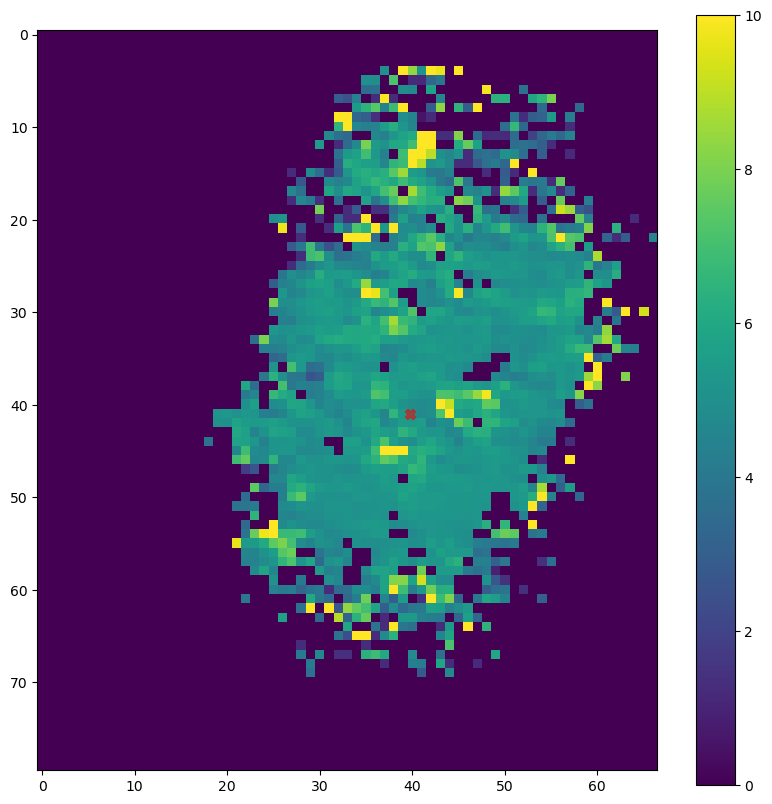

In [204]:
plt.figure(figsize=(10,10))
Hbeta_width_map_flipped = np.flip(Hbeta_width_map)
plt.imshow(Hbeta_width_map_flipped, vmin = 0, vmax = 10)
plt.colorbar()
plt.scatter(x, 79-y, color = 'red', s = 55, marker='X', alpha = .5)

#### Stddev maps to make sure I can mask large stddevs (don't rerun these, I already changed Gaus function)

Spaxel [0,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [25,0]
Spaxel [26,0]
Spaxel [27,0]
Spaxel [28,0]
Spaxel [29,0]
Spaxel [30,0]
Spaxel [31,0]
Spaxel [32,0]
Spaxel [33,0]
Spaxel [34,0]
Spaxel [35,0]
Spaxel [36,0]
Spaxel [37,0]
Spaxel [38,0]
Spaxel [39,0]
Spaxel [40,0]
Spaxel [41,0]
Spaxel [42,0]
Spaxel [43,0]
Spaxel [44,0]
Spaxel [45,0]
Spaxel [46,0]
Spaxel [47,0]
Spaxel [48,0]
Spaxel [49,0]
Spaxel [50,0]
Spaxel [51,0]
Spaxel [52,0]
Spaxel [53,0]
Spaxel [54,0]
Spaxel [55,0]
Spaxel [56,0]
Spaxel [57,0]
Spaxel [58,0]
Spaxel [59,0]
Spaxel [60,0]
Spaxel [61,0]
Spaxel [62,0]
Spaxel [63,0]
Spaxel [64,0]
Spaxel [65,0]
Spaxel [66,0]
Spaxel [0,1]
Spaxel [1,1]
Spaxel [2,1]
Spaxel [3,1]
Spaxel [4,1]
Spaxel 

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2602175109.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2602175109.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2881880838.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  OIII_stddev

Spaxel [31,9]
Spaxel [32,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel [55,9]
Spaxel [56,9]
Spaxel [57,9]
Spaxel [58,9]
Spaxel [59,9]
Spaxel [60,9]
Spaxel [61,9]
Spaxel [62,9]
Spaxel [63,9]
Spaxel [64,9]
Spaxel [65,9]
Spaxel [66,9]
Spaxel [0,10]
Spaxel [1,10]
Spaxel [2,10]
Spaxel [3,10]
Spaxel [4,10]
Spaxel [5,10]
Spaxel [6,10]
Spaxel [7,10]
Spaxel [8,10]
Spaxel [9,10]
Spaxel [10,10]
Spaxel [11,10]
Spaxel [12,10]
Spaxel [13,10]
Spaxel [14,10]
Spaxel [15,10]
Spaxel [16,10]
Spaxel [17,10]
Spaxel [18,10]
Spaxel [19,10]
Spaxel [20,10]
[5010.53201866]
[2.22373808]
[0.94433461]
['OIII5007', array([1368]), array([5010.53201866]), 0.000661192791010845, array([2.22373808]), array([0.94433461]), array([-3.73201866])]
Spaxel [21,

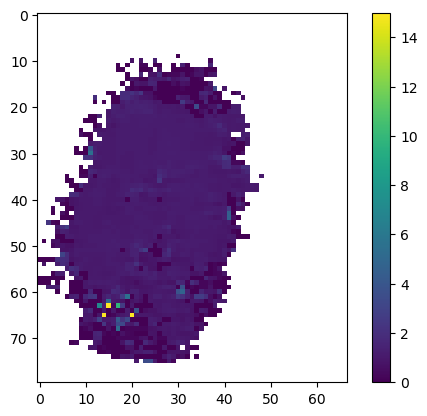

In [699]:
#stddev of OIII5007 across galaxy
OIII_stddev_map = np.zeros([80,67])
for y_spaxel in range(0, 80):
    for x_spaxel in range(0,67):
        try:
            sigma = Gaussian_fit('data', ['OIII5007'], y_spaxel, x_spaxel, makeplots = False)[0][3]
            OIII_stddev_map[y_spaxel,x_spaxel] = sigma
        except TypeError:
            sigma = np.nan
            OIII_stddev_map[y_spaxel,x_spaxel] = sigma
            
plt.imshow(OIII_stddev_map, vmin = 0, vmax = 15)
plt.colorbar()


Spaxel [0,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [25,0]
Spaxel [26,0]
Spaxel [27,0]
Spaxel [28,0]
Spaxel [29,0]
Spaxel [30,0]
Spaxel [31,0]
Spaxel [32,0]
Spaxel [33,0]
Spaxel [34,0]
Spaxel [35,0]
Spaxel [36,0]
Spaxel [37,0]
Spaxel [38,0]
Spaxel [39,0]
Spaxel [40,0]
Spaxel [41,0]
Spaxel [42,0]
Spaxel [43,0]
Spaxel [44,0]
Spaxel [45,0]
Spaxel [46,0]
Spaxel [47,0]
Spaxel [48,0]
Spaxel [49,0]
Spaxel [50,0]
Spaxel [51,0]
Spaxel [52,0]
Spaxel [53,0]
Spaxel [54,0]
Spaxel [55,0]
Spaxel [56,0]
Spaxel [57,0]
Spaxel [58,0]
Spaxel [59,0]
Spaxel [60,0]
Spaxel [61,0]
Spaxel [62,0]
Spaxel [63,0]
Spaxel [64,0]
Spaxel [65,0]
Spaxel [66,0]
Spaxel [0,1]
Spaxel [1,1]
Spaxel [2,1]
Spaxel [3,1]
Spaxel [4,1]
Spaxel 

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2602175109.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2602175109.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


Spaxel [32,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel [55,9]
Spaxel [56,9]
Spaxel [57,9]
Spaxel [58,9]
Spaxel [59,9]
Spaxel [60,9]
Spaxel [61,9]
Spaxel [62,9]
Spaxel [63,9]
Spaxel [64,9]
Spaxel [65,9]
Spaxel [66,9]
Spaxel [0,10]
Spaxel [1,10]
Spaxel [2,10]
Spaxel [3,10]
Spaxel [4,10]
Spaxel [5,10]
Spaxel [6,10]
Spaxel [7,10]
Spaxel [8,10]
Spaxel [9,10]
Spaxel [10,10]
Spaxel [11,10]
Spaxel [12,10]
Spaxel [13,10]
Spaxel [14,10]
Spaxel [15,10]
Spaxel [16,10]
Spaxel [17,10]
Spaxel [18,10]
Spaxel [19,10]
Spaxel [20,10]
[3722.67470448]
[0.]
[0.]
['OII3727', array([28]), array([3722.67470448]), 0.0009745575664793913, array([0.]), array([0.]), array([4.64529552])]
Spaxel [21,10]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/1474614607.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  OII_stddev_map[y_spaxel,x_spaxel] = sigma


Spaxel [22,10]
[3722.67470448]
[0.]
[0.]
['OII3727', array([28]), array([3722.67470448]), 0.00042908503091744417, array([0.]), array([0.]), array([4.64529552])]
Spaxel [23,10]
Spaxel [24,10]
Spaxel [25,10]
[3721.84880248]
[1.65180401]
[0.70145658]
['OII3727', array([28]), array([3721.84880248]), 0.0012157185046438807, array([1.65180401]), array([0.70145658]), array([5.47119752])]
Spaxel [26,10]
Spaxel [27,10]
Spaxel [28,10]
Spaxel [29,10]
Spaxel [30,10]
Spaxel [31,10]
Spaxel [32,10]
Spaxel [33,10]
Spaxel [34,10]
Spaxel [35,10]
Spaxel [36,10]
Spaxel [37,10]
[3721.0230837]
[0.]
[0.]
['OII3727', array([26]), array([3721.0230837]), 0.00032520604721533985, array([0.]), array([0.]), array([6.2969163])]
Spaxel [38,10]
Spaxel [39,10]
Spaxel [40,10]
Spaxel [41,10]
Spaxel [42,10]
Spaxel [43,10]
Spaxel [44,10]
Spaxel [45,10]
Spaxel [46,10]
Spaxel [47,10]
Spaxel [48,10]
Spaxel [49,10]
Spaxel [50,10]
Spaxel [51,10]
Spaxel [52,10]
Spaxel [53,10]
Spaxel [54,10]
Spaxel [55,10]
Spaxel [56,10]
Spaxel [5

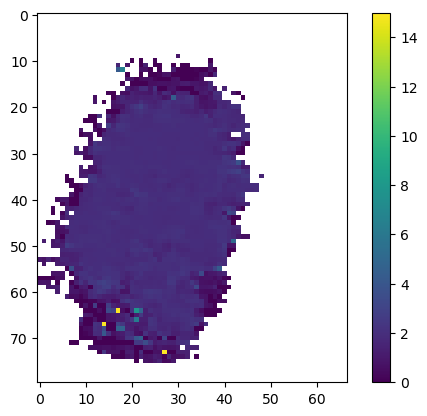

In [700]:
#stddev of OII3727 across galaxy
OII_stddev_map = np.zeros([80,67])
for y_spaxel in range(0, 80):
    for x_spaxel in range(0,67):
        try:
            sigma = Gaussian_fit('data', ['OII3727'], y_spaxel, x_spaxel, makeplots = False)[0][3]
            OII_stddev_map[y_spaxel,x_spaxel] = sigma
        except TypeError:
            sigma = np.nan
            OII_stddev_map[y_spaxel,x_spaxel] = sigma
            
plt.imshow(OII_stddev_map, vmin = 0, vmax = 15)
plt.colorbar()

Spaxel [0,0]
Spaxel [1,0]
Spaxel [2,0]
Spaxel [3,0]
Spaxel [4,0]
Spaxel [5,0]
Spaxel [6,0]
Spaxel [7,0]
Spaxel [8,0]
Spaxel [9,0]
Spaxel [10,0]
Spaxel [11,0]
Spaxel [12,0]
Spaxel [13,0]
Spaxel [14,0]
Spaxel [15,0]
Spaxel [16,0]
Spaxel [17,0]
Spaxel [18,0]
Spaxel [19,0]
Spaxel [20,0]
Spaxel [21,0]
Spaxel [22,0]
Spaxel [23,0]
Spaxel [24,0]
Spaxel [25,0]
Spaxel [26,0]
Spaxel [27,0]
Spaxel [28,0]
Spaxel [29,0]
Spaxel [30,0]
Spaxel [31,0]
Spaxel [32,0]
Spaxel [33,0]
Spaxel [34,0]
Spaxel [35,0]
Spaxel [36,0]
Spaxel [37,0]
Spaxel [38,0]
Spaxel [39,0]
Spaxel [40,0]
Spaxel [41,0]
Spaxel [42,0]
Spaxel [43,0]
Spaxel [44,0]
Spaxel [45,0]
Spaxel [46,0]
Spaxel [47,0]
Spaxel [48,0]
Spaxel [49,0]
Spaxel [50,0]
Spaxel [51,0]
Spaxel [52,0]
Spaxel [53,0]
Spaxel [54,0]
Spaxel [55,0]
Spaxel [56,0]
Spaxel [57,0]
Spaxel [58,0]
Spaxel [59,0]
Spaxel [60,0]
Spaxel [61,0]
Spaxel [62,0]
Spaxel [63,0]
Spaxel [64,0]
Spaxel [65,0]
Spaxel [66,0]
Spaxel [0,1]
Spaxel [1,1]
Spaxel [2,1]
Spaxel [3,1]
Spaxel [4,1]
Spaxel 

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2602175109.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2602175109.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2131058070.py:7: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  Hbeta_stdde

Spaxel [31,9]
Spaxel [32,9]
Spaxel [33,9]
Spaxel [34,9]
Spaxel [35,9]
Spaxel [36,9]
Spaxel [37,9]
Spaxel [38,9]
Spaxel [39,9]
Spaxel [40,9]
Spaxel [41,9]
Spaxel [42,9]
Spaxel [43,9]
Spaxel [44,9]
Spaxel [45,9]
Spaxel [46,9]
Spaxel [47,9]
Spaxel [48,9]
Spaxel [49,9]
Spaxel [50,9]
Spaxel [51,9]
Spaxel [52,9]
Spaxel [53,9]
Spaxel [54,9]
Spaxel [55,9]
Spaxel [56,9]
Spaxel [57,9]
Spaxel [58,9]
Spaxel [59,9]
Spaxel [60,9]
Spaxel [61,9]
Spaxel [62,9]
Spaxel [63,9]
Spaxel [64,9]
Spaxel [65,9]
Spaxel [66,9]
Spaxel [0,10]
Spaxel [1,10]
Spaxel [2,10]
Spaxel [3,10]
Spaxel [4,10]
Spaxel [5,10]
Spaxel [6,10]
Spaxel [7,10]
Spaxel [8,10]
Spaxel [9,10]
Spaxel [10,10]
Spaxel [11,10]
Spaxel [12,10]
Spaxel [13,10]
Spaxel [14,10]
Spaxel [15,10]
Spaxel [16,10]
Spaxel [17,10]
Spaxel [18,10]
Spaxel [19,10]
Spaxel [20,10]
[4858.35807108]
[0.]
[0.]
['Hbeta', array([1228]), array([4858.35807108]), 0.0003947560315217079, array([0.]), array([0.]), array([2.99192892])]
Spaxel [21,10]
Spaxel [22,10]
[4858.35807108]


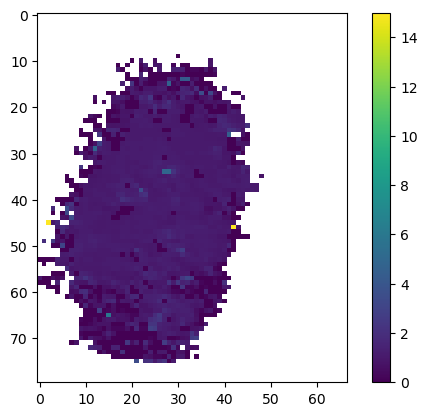

In [705]:
#stddev of Hbeta across galaxy
Hbeta_stddev_map = np.zeros([80,67])
for y_spaxel in range(0, 80):
    for x_spaxel in range(0,67):
        try:
            sigma = Gaussian_fit('data', ['Hbeta'], y_spaxel, x_spaxel, makeplots = False)[0][3]
            Hbeta_stddev_map[y_spaxel,x_spaxel] = sigma
        except TypeError:
            sigma = np.nan
            Hbeta_stddev_map[y_spaxel,x_spaxel] = sigma
plt.imshow(Hbeta_stddev_map, vmin = 0, vmax = 15)
plt.colorbar()

## Cross Correlation to Check Location of Candidate

In [4]:
#Cross correlation function
def cross_corr(data_im, ref_im):
    """
    Function to calculate x and y offsets between two images. 
    If dimensions of images do not match, crops larger image to size of smaller. 
    Assumes if an image is smaller in x, it is also smaller (or equal dim) in y. 
    Inputs:
    data_im (str): file path to main data image 
    ref_im (str): file path to reference image
    Outputs:
    y_offset, x_offset (list of int): offsets of y and x in pixels 
    """
    #Get image data 
    data = fits.getdata(data_im).astype('float')
    ref = fits.getdata(ref_im).astype('float')
    
    for line in data:
        for value in line:
            
            if np.isinf(value):
                value = np.nan
            
            #print(value)
    for line in ref:
        for value in line:
            
            if np.isinf(value):
                value = np.nan
                
            if value == np.inf:
                value = np.nan

            #print(value)
    #np.isinf()
    #np.nanaverage()
    #data[np.where(isinf())]

    #Subtract means from images
    data -= np.average(data)
    ref -= np.average(ref)

    print(data)

    #Check if the dimensions of images match, crop larger image
    #y check, crop
    if len(data[0]) != len(ref[0]):
        #y_trim = True
        y_dim = min(len(data[0]),len(ref[0]))

        data = data[0:y_dim][:]
        ref = ref[0:y_dim][:]

    #x check, crop
    if len(data[1]) != len(ref[1]):
        #x_trim = True 
        x_dim = min(len(data[1]),len(ref[1]))

        data = data[:][0:x_dim]
        ref = ref[:][0:x_dim]
        
    fig,ax = plt.subplots(1,2)
    ax1 = plt.imshow(data)
    ax2 = plt.imshow(ref)
"""
    #crop larger image 

        #Find lower dimension and image to trim
        y_dim = min(np.shape(data)[0], np.shape(ref)[0])
        x_dim = min(np.shape(data)[1], np.shape(ref)[1])
        print(y_dim)
        print(data)
        to_trim = [data, ref][index(max(np.shape(data)[0], np.shape(ref)[0]))]
        print(np.shape(data))
        print(max(np.shape(data)[0], np.shape(ref)[0]))

        #Trim image 
        y_trim = np.shape[to_trim][0] - y_dim
        x_trim = np.shape[to_trim][1] - x_dim
        y_crop = int(y_trim/2)
        x_crop = int(x_trim/2)

        cropped_im = to_trim[y_crop : np.shape[to_trim][0] - y_crop][x_crop : np.shape[to_trim][0] - x_crop]

        plt.imshow(cropped_im)
"""



'\n    #crop larger image \n\n        #Find lower dimension and image to trim\n        y_dim = min(np.shape(data)[0], np.shape(ref)[0])\n        x_dim = min(np.shape(data)[1], np.shape(ref)[1])\n        print(y_dim)\n        print(data)\n        to_trim = [data, ref][index(max(np.shape(data)[0], np.shape(ref)[0]))]\n        print(np.shape(data))\n        print(max(np.shape(data)[0], np.shape(ref)[0]))\n\n        #Trim image \n        y_trim = np.shape[to_trim][0] - y_dim\n        x_trim = np.shape[to_trim][1] - x_dim\n        y_crop = int(y_trim/2)\n        x_crop = int(x_trim/2)\n\n        cropped_im = to_trim[y_crop : np.shape[to_trim][0] - y_crop][x_crop : np.shape[to_trim][0] - x_crop]\n\n        plt.imshow(cropped_im)\n'

In [91]:
r = np.zeros([2,2])
for line in r: 
    for num in line: 
        print(num)

0.0
0.0
0.0
0.0


/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:118: RuntimeWarning: invalid value encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


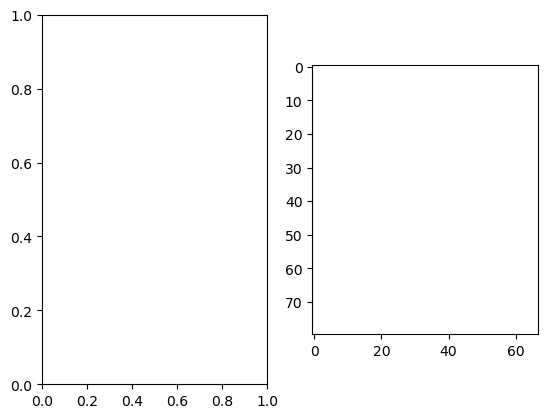

In [5]:
cross_corr('cmaps/Hbeta_SN_Colormap.fits','test.fits')

#### SN mask to check where SN>100

In [65]:
def SN_mask(pathname):
    """
    Masks input SN cmap and displays with ICRS coords.
    """
    coords = WCS(header, naxis = 2)
    plot = plt.subplot(projection = coords)
    linename = pathname.split('/')[1].split('_')[0]
    plt.title(linename + ' SN masked')
    SN_map = fits.getdata(pathname)
    y_max = np.shape(SN_map)[0]
    x_max = np.shape(SN_map)[1]
    for y in range(0,y_max):
            for x in range(0,x_max):
                if SN_map[y][x] < 1:
                    SN_map[y][x] = np.nan
    cmap=plt.imshow(SN_map, vmax = 300)
    plt.colorbar(cmap, label = 'S/N')
    plt.grid()
    


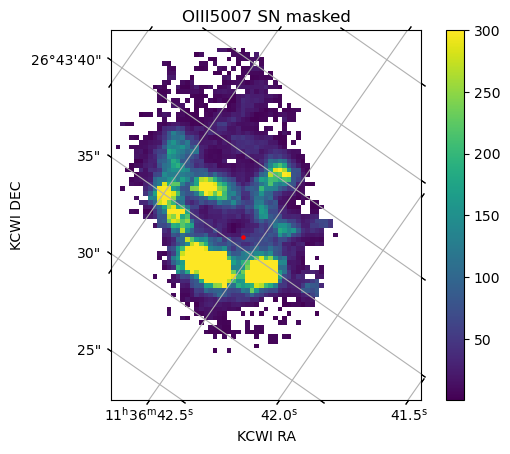

In [92]:

SN_mask('cmaps/OIII5007_SN_Colormap.fits')
plt.scatter(28.02606651075986, 34.697076776399825, s = 5, color = 'red')


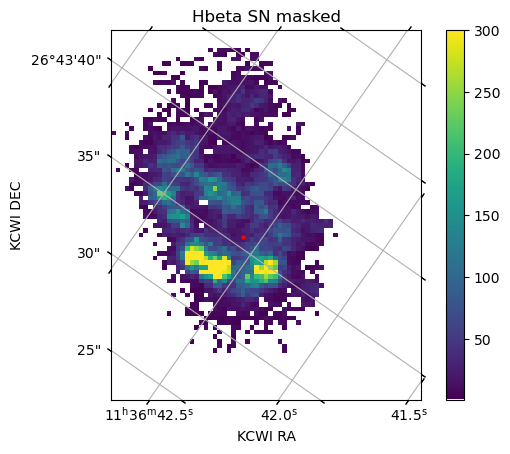

In [ ]:
SN_mask('cmaps/Hbeta_SN_Colormap.fits')
plt.scatter(28.02606651075986, 34.697076776399825, s = 5, color = 'red')
plt.savefig('hbeta_SN_mask.png', bbox_inches='tight')

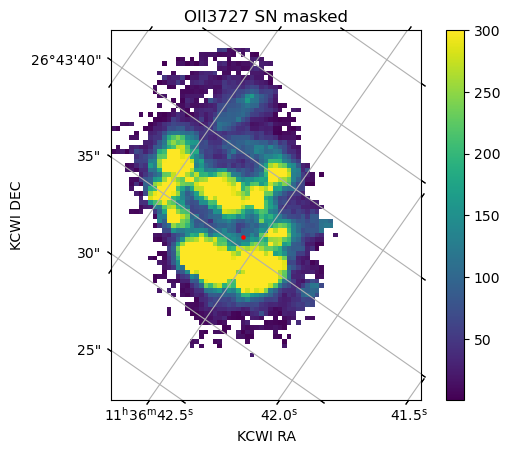

In [200]:
SN_mask('cmaps/OII3727_SN_Colormap.fits')
plt.scatter(28.02606651075986, 34.697076776399825, s = 5, color = 'red')

## Blue Diagram for Individual Spaxels

In [7]:
#Function to plot Blue diagram (notebook version)
def plot_blue(flux_dataset, var_dataset, SN_emline, bin_loc = [0,0], comp_reg = False): 
    """
    Function takes in a dataset and estimates emline, fits gaussians, and estimates S/N in specified emline for all spaxels.
    It creates a Blue diagram which plots all bins/spaxels in dataset. 
    It colors the bins by their distance from chosen bin number (bins containing source).
    It correlates marker sizes with S/N of input emline. 
    
    Inputs:
    flux_dataset (3d array): flux cube of spaxels or bins with spectra attached.
    var_dataset (3d array): variance cube of spaxels or bins with spectra attached.
    SN_emline (str): emline to determine marker sizes.
    bin_loc (list of float): [y,x] index of bin to calculate distances to. If none is entered, defaults to zero. 
    Note must subtract starting spaxel ID if using sub-array. 
    comp_reg (bool): Flag to outline LINER/SF composite region on plot

    Outputs:
    Blue_diagram: Blue diagram plot containing all spaxels or bins.
    """  
    #Check if dimensions of flux and variance arrays match
    assert np.shape(flux_dataset) == np.shape(var_dataset),'Dimensions of flux array must match dimensions of variance array.'
    
    #Set up arrays for x and y values of datapoints
    xvals = []
    yvals = []
    markersize = []
    dist = []
    
    #Set up fitters
    fitter = fitting.LevMarLSQFitter()
    fitter2 = fitting.LinearLSQFitter()

    #Get wavelength ranges of emlines
    OIII5007_central_wvl = wvldict['OIII5007']
    OIII5007_min = int(OIII5007_central_wvl - 7)
    OIII5007_max = int(OIII5007_central_wvl + 7)
    OIII5007_range = single_wvl_array[np.where((single_wvl_array >= OIII5007_min) & (single_wvl_array <= OIII5007_max))]
    
    OII3727_central_wvl = wvldict['OII3727']
    OII3727_min = int(OII3727_central_wvl - 7)
    OII3727_max = int(OII3727_central_wvl + 7)
    OII3727_range = single_wvl_array[np.where((single_wvl_array >= OII3727_min) & (single_wvl_array <= OII3727_max))]

    Hbeta_central_wvl = wvldict['Hbeta']
    Hbeta_min = int(Hbeta_central_wvl - 7)
    Hbeta_max = int(Hbeta_central_wvl + 7)
    Hbeta_range = single_wvl_array[np.where((single_wvl_array >= Hbeta_min) & (single_wvl_array <= Hbeta_max))]


    #Loop through bins, measure integrated flux of emlines, get xval and yval for each bin, append to xvals and yvals lists
    y_range = np.shape(flux_dataset)[1]
    x_range = np.shape(flux_dataset)[2]

    for x in range(0,x_range):
        for y in range(0,y_range):
            bin_flux = flux_dataset[:,y,x]
            bin_var = var_dataset[:,y,x]
            
            if (np.max(bin_flux) != 0):
                #print(f'Spaxel {y}, {x}')

                ##OIII5007
                #get amplitude and stddev of OIII in bin
                OIII5007_flux_range = bin_flux[np.where((single_wvl_array >= OIII5007_min) & (single_wvl_array <= OIII5007_max))]
                OIII5007_peak = np.max(OIII5007_flux_range)

                OIII5007_wvl = OIII5007_range[np.where(OIII5007_flux_range == OIII5007_peak)]
                OIII5007_loc = np.where(single_wvl_array == OIII5007_wvl)[0]

                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OIII5007_half_max = OIII5007_peak*.5
                OIII5007_half_max_wvl = single_wvl_array[OIII5007_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OIII5007_loc)
                while bin_flux[i] >= OIII5007_half_max:
                    OIII5007_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                if i == OIII5007_loc or OIII5007_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OIII5007_half_max = OIII5007_peak*.2
                    while bin_flux[i] >= OIII5007_half_max:
                        OIII5007_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                #check for bad fits
                if OIII5007_fwhm > 10: 
                    OIII5007_fwhm = 10

                if OIII5007_fwhm == 0:
                    g_OIII5007 = None
                    OIII5007 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OIII5007_sigma = OIII5007_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OIII5007_g_min = OIII5007_wvl - 2*OIII5007_fwhm
                    OIII5007_g_max = OIII5007_wvl + 2*OIII5007_fwhm

                    OIII5007_g_range = single_wvl_array[np.where((single_wvl_array >= OIII5007_g_min) & (single_wvl_array <= OIII5007_g_max))]
                    OIII5007_g_flux_range = bin_flux[np.where((single_wvl_array >= OIII5007_g_min) & (single_wvl_array <= OIII5007_g_max))]
                    # print('fwhm: ' ,OIII5007_fwhm)
                    # print('OIII g range: ', OIII5007_g_range)
                    # print('OIII g flux range: ', OIII5007_g_flux_range)

                    OIII5007_model = models.Gaussian1D(amplitude = OIII5007_peak, mean = OIII5007_wvl, stddev = OIII5007_sigma)
                    g_OIII5007 = fitter(OIII5007_model, OIII5007_g_range, OIII5007_g_flux_range)

                    #Masking bad fits
                    if g_OIII5007.stddev > 10:
                        OIII5007 = np.nan
                    else:
                        OIII5007 = g_OIII5007.amplitude * g_OIII5007.stddev * (np.sqrt(2*np.pi))
                

                ##OII3727
                #get amplitude and stddev of OII in bin
                OII3727_flux_range = bin_flux[np.where((single_wvl_array >= OII3727_min) & (single_wvl_array <= OII3727_max))]
                OII3727_peak = np.max(OII3727_flux_range)

                OII3727_wvl = OII3727_range[np.where(OII3727_flux_range == OII3727_peak)]
                OII3727_loc = np.where(single_wvl_array == OII3727_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OII3727_half_max = OII3727_peak*.5
                OII3727_half_max_wvl = single_wvl_array[OII3727_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OII3727_loc)
                while bin_flux[i] >= OII3727_half_max:
                    OII3727_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                if i == OII3727_loc or OII3727_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OII3727_half_max = OII3727_peak*.2
                    while bin_flux[i] >= OII3727_half_max:
                        OII3727_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                #check for bad fits
                if OII3727_fwhm > 10: 
                    OII3727_fwhm = 10

                if OII3727_fwhm == 0:
                    g_OII3727 = None
                    OII3727 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OII3727_sigma = OII3727_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OII3727_g_min = OII3727_wvl - 2*OII3727_fwhm
                    OII3727_g_max = OII3727_wvl + 2*OII3727_fwhm
                    
                    OII3727_g_range = single_wvl_array[np.where((single_wvl_array >= OII3727_g_min) & (single_wvl_array <= OII3727_g_max))]
                    OII3727_g_flux_range = bin_flux[np.where((single_wvl_array >= OII3727_g_min) & (single_wvl_array <= OII3727_g_max))]
                    # print(OII3727_fwhm)
                    # print('OII3727 g range: ', OII3727_g_range)
                    # print('OII3727 g flux range: ', OII3727_g_flux_range)

                    OII3727_model = models.Gaussian1D(amplitude = OII3727_peak, mean = OII3727_wvl, stddev = OII3727_sigma)
                    g_OII3727 = fitter(OII3727_model, OII3727_g_range, OII3727_g_flux_range)
                    
                    #Masking bad fits
                    if g_OII3727.stddev > 10:
                        OII3727 = np.nan
                    else:
                        OII3727 = g_OII3727.amplitude * g_OII3727.stddev * (np.sqrt(2*np.pi))
                

                ##Hbeta
                #get amplitude and stddev of Hbeta in bin
                Hbeta_flux_range = bin_flux[np.where((single_wvl_array >= Hbeta_min) & (single_wvl_array <= Hbeta_max))]
                Hbeta_peak = np.max(Hbeta_flux_range)

                Hbeta_wvl = Hbeta_range[np.where(Hbeta_flux_range == Hbeta_peak)]
                Hbeta_loc = np.where(single_wvl_array == Hbeta_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                Hbeta_half_max = Hbeta_peak*.5
                Hbeta_half_max_wvl = single_wvl_array[Hbeta_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(Hbeta_loc)
                while bin_flux[i] >= Hbeta_half_max:
                    Hbeta_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                if i == Hbeta_loc or Hbeta_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    Hbeta_half_max = Hbeta_peak*.2
                    while bin_flux[i] >= Hbeta_half_max:
                        Hbeta_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                #check for bad fits
                if Hbeta_fwhm > 10: 
                    Hbeta_fwhm = 10

                if Hbeta_fwhm == 0:
                    g_Hbeta = None
                    Hbeta = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    Hbeta_sigma = Hbeta_fwhm / (2*np.sqrt(2*np.log(2)))
                    
                    #Ranges for gaussian fit using estimated fwhm
                    Hbeta_g_min = Hbeta_wvl - 2*Hbeta_fwhm
                    Hbeta_g_max = Hbeta_wvl + 2*Hbeta_fwhm
                    
                    Hbeta_g_range = single_wvl_array[np.where((single_wvl_array >= Hbeta_g_min) & (single_wvl_array <= Hbeta_g_max))]
                    Hbeta_g_flux_range = bin_flux[np.where((single_wvl_array >= Hbeta_g_min) & (single_wvl_array <= Hbeta_g_max))]
                    # print(Hbeta_fwhm)
                    # print('Hbeta g range: ', Hbeta_g_range)
                    # print('Hbeta g flux range: ', Hbeta_g_flux_range)

                    Hbeta_model = models.Gaussian1D(amplitude = Hbeta_peak, mean = Hbeta_wvl, stddev = Hbeta_sigma)
                    g_Hbeta = fitter(Hbeta_model, Hbeta_g_range, Hbeta_g_flux_range)

                    #Masking bad fits
                    if g_Hbeta.stddev > 10:
                        Hbeta = np.nan
                    else:
                        #Integrated flux = A*sigma*sqrt(2pi)
                        Hbeta = g_Hbeta.amplitude * g_Hbeta.stddev * (np.sqrt(2*np.pi))
                
               
                #Calculating S/N for entered emline
                if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007':
                    
                    #accessing gaussian object
                    g = locals()['g_' + SN_emline]

                    #Spaxels with no gaussian fit
                    if g == None:
                        print(f'Unable to fit {SN_emline} in spaxel {y}, {x}. Defaulting to regular markersize.')
                        size = 1

                    #Bad fits/empty spaxels
                    elif g.amplitude <= 0 or g.stddev > 10 or g.stddev == 0:
                        print(f'Unable to fit {SN_emline} in spaxel {y}, {x}. Defaulting to regular markersize.')
                        size = 1

                    else:
                        #wavelength range around emission line
                        wvl_min = g.mean - 2*g.fwhm
                        wvl_max = g.mean + 2*g.fwhm
                        
                        wvl_range = single_wvl_array[np.where((single_wvl_array >= wvl_min) & (single_wvl_array <= wvl_max))]
                        
                        #Sum flux over wvls
                        flux_sum = 0

                        left_wavelengths = []
                        right_wavelengths = []
                        left_continuum = []
                        right_continuum = []

                        #Calculating sum in signal equation
                        for wvl in wvl_range:
                            flux = bin_flux[np.where(single_wvl_array == wvl)]

                            try: 					
                                #Find first wvl after starting wvl, look up flux and wvl values and store in arrays
                                #Starting guess for wavelength, left side
                                left_starting_wvl = wvl - 6 * g.stddev 
                                #Starting guess for wvl, right side
                                right_starting_wvl = wvl + 6 * g.stddev  
                                
                                #Actual wavelength where there is a flux measurement
                                fc_1_wvl = single_wvl_array[np.where(single_wvl_array >= left_starting_wvl)[0][0]]
                                #Flux value 
                                fc_1 = bin_flux[np.where(single_wvl_array == fc_1_wvl)]
                                try:
                                    fc_1 = fc_1[0]
                                except:
                                    pass
                                
                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_1 < .0008:
                                    left_wavelengths.append(fc_1_wvl)
                                    left_continuum.append(fc_1)
                                else: 
                                    fc_1 = np.nan
                        
                                #Actual wavelength where there is a flux measurement
                                fc_2_wvl = single_wvl_array[np.where(single_wvl_array >= right_starting_wvl)[0][0]]
                                #Flux value
                                fc_2 = bin_flux[np.where(single_wvl_array == fc_2_wvl)]
                                try:
                                    fc_2 = fc_2[0]
                                except:
                                    pass

                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_2 < .0008:
                                    right_wavelengths.append(fc_2_wvl)
                                    right_continuum.append(fc_2)
                                else: 
                                    fc_2 = np.nan  

                                #Flux array 
                                if not (np.isnan(fc_1) and np.isnan(fc_2)):
                                    flux_sum += (flux - np.nanmean([fc_1, fc_2]))
                                else: 
                                    flux_sum += flux
                            
                            #Index Error for when the continuum wavelength array is empty
                            except IndexError:
                                flux_sum += flux
                                

                            #signal of emission is just integrated flux
                            signal = flux_sum

                            #Calculate standard deviation of continuum bands 
                            #Fit line to continuums
                            lin_model = models.Linear1D(slope=0, intercept=0)
                            
                            #Linear fit
                            lin_fit_left = fitter2(lin_model, left_wavelengths, left_continuum)
                            lin_fit_right = fitter2(lin_model, right_wavelengths, right_continuum)

                            #Difference from line to points
                            left_diff = []
                            right_diff = []

                            for index, point in enumerate(left_continuum):

                                diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
                                left_diff.append(diff_1)

                            for index, point in enumerate(right_continuum):

                                diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
                                right_diff.append(diff_2)

                            sig_1 = np.std(left_diff)
                            sig_2 = np.std(right_diff)

                            #Calculate noise of emission
                            noise = np.mean([sig_1,sig_2])
                            size = abs((signal / noise)[0])

                            #Masking really bad fits (visually inspected colormaps and fits, these are all pixels at the outskirts of image with terrible fits)
                            if size > 4000: 
                                size = 0

                else:
                    print('S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.')
                    size = 150
            else:
                OIII5007 = np.nan
                OII3727 = np.nan
                Hbeta = np.nan
                size = 0
                
            print(OIII5007,OII3727, Hbeta)

            xval = OII3727/Hbeta
            yval = OIII5007/Hbeta  

            #More bad fits ):
            if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:
                xval = np.nan
                yval = np.nan
                size = 0
            
            #Calculate distance to bin using array locations 
            y_dist = bin_loc[0] - y
            x_dist = bin_loc[1] - x
            d = np.sqrt((x_dist)**2 + (y_dist)**2)

            #Append values to lists
            xvals.append(xval)
            yvals.append(yval)
            markersize.append((size**2)/1000)
            #markersize.append(s)
            dist.append(d)
        
            #print('markersize: ', markersize)

    plt.figure(figsize=(10,10))
    if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007':
        scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Spaxel, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)
    else:
        scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = 'Spaxel, colored by distance to source', s = markersize)
    
    plt.colorbar(label = 'Distance to source, pixels')
    plt.xlim(.1,1.1)
    plt.ylim(-.2,.7)

    #Location of radio source spaxel (calculated earlier)
    plt.scatter(np.log10(4.950697695743618),np.log10(1.5868490797350827), marker = 'X', color = 'dodgerblue', s = 80)

    #dividing line equation:
    #log([OIII]/Hb) = 0.11 / (log([OII]/Hb) - 0.92)  + 0.85

    X1 = np.linspace(0,.9,10000)
    Y1 = 0.11 / (X1 - 0.92)  + 0.85
    X2 = np.linspace(.725,1.2,10000)
    Y2 = .95*X2 - .4

    plt.plot(X1,Y1, color = 'royalblue')
    plt.plot(X2,Y2, color = 'royalblue')

    plt.hlines(y=.3, xmin=.1, xmax = .72, color = 'royalblue')

    #LINER/SF Composite Region
    if comp_reg:
        X3 = np.linspace(0,1.057,10000)
        Y3 = -(X3-1)**2 -0.1*X3 + 0.25
        Y4 = (X3-0.2)**2 -0.6
        plt.plot(X3, Y3, '--', color='k')
        plt.plot(X3, Y4, '--', color='k')
        plt.text(.6, -.1, 'LINER/SF', fontsize = 15)
    
    plt.legend(loc = 'lower left', fontsize = 'x-small')
    #legend = plt.legend(*scatter.legend_elements(s=20),loc='lower left')
    #Manually setting marker size since it doesn't show up otherwise
    #legend.legend_handles[0].set_sizes(10)

    #Adding region labels 
    plt.text(.75, .65, 'Seyfert 2', fontsize = 15)
    plt.text(.95, .2, 'LINER', fontsize = 15)
    plt.text(.2, .4, 'SF/SY2', fontsize = 15)
    plt.text(.2, -.05, 'Star-forming', fontsize = 15)

    plt.xlabel('log([OII]$\lambda\lambda$3726+3729/H$\\beta$)', fontsize = 15)
    plt.ylabel('log([OIII]$\lambda$5007/H$\\beta$)', fontsize = 15)
    plt.title('Blue Diagram of Reines 65', fontsize = 16)
    

In [119]:
Hbeta_test = 1
x = 'Hbeta'
print(globals()[x + '_test'])
print('Flux (F$\lambda*10^{-16}$)')


1
Flux (F$\lambda*10^{-16}$)


[[ 7.85061870e-04  2.88285102e-04  3.16366439e-06 -3.60655343e-04
  -8.92902638e-04 -1.42778679e-03 -1.33039731e-03 -8.65148779e-04
   1.51253463e-04  3.32388068e-04]
 [ 4.99422728e-04  9.83672560e-04  5.73755086e-04  3.25340400e-04
   2.65015877e-05 -8.37111174e-05 -1.26753768e-03 -1.55516237e-03
  -2.30875850e-04 -3.85799469e-05]
 [ 2.00765629e-04  1.24595352e-03  1.31583173e-03  7.76444603e-04
   7.37305820e-04  7.67852492e-04  1.15429285e-03  8.96593870e-04
   2.56401696e-04 -5.55757481e-05]
 [-2.80036609e-04 -2.81006207e-04  2.53838528e-04  9.15484783e-04
   5.25269697e-04  5.05460562e-04  4.21332792e-04  8.35705286e-04
   6.72814100e-04  1.69853246e-04]
 [-5.73174703e-04 -7.50565753e-04 -5.43290716e-04 -3.84449600e-04
  -1.72880638e-04 -2.81706221e-04 -2.02248657e-04 -1.39639420e-04
   3.80919057e-04  8.27710475e-04]
 [-5.58751621e-04 -4.06446873e-04 -6.10355448e-04 -1.38830870e-03
  -5.52263849e-04 -9.97097376e-05 -3.62911536e-04 -9.95458743e-05
   2.54369933e-07  7.67224169e-04

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/1600049591.py:376: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


0.02944812186217565 0.0784224490454929 0.019099301234443644
0.019659386643614427 0.05583417562732234 0.01332685287217944
0.012159106067289956 0.036350273202953455 0.008409204922422314
0.008024219913880696 0.026837154869591418 0.005771634396133795
0.00791031738092423 0.021039595183797048 0.006006049796580757
0.006064006313069187 0.02362476971921413 0.005384953359790118
0.12131998924589768 0.21469644124674087 0.04754610941865848
0.07136932240182933 0.15709209860968187 0.0339532154942452
0.04754386663064813 0.12836058019605542 0.023837710758325366


0.03134407442777394 0.09704367447937862 0.01846437320418378
0.020570018033164748 0.06625220827520392 0.013807559684191313
0.014686600392362609 0.042725244132732584 0.009729331366642849
0.011107785338896444 0.032295050696386066 0.007127225678313051
0.008380488035798378 0.027145518415662304 0.006411689059014891
0.008035853364430568 0.022274411906688187 0.006031609643772763
0.0059525552060524685 0.025292506477437325 0.006016524917173513
0.13745578428238223 0.22900194046082908 0.0533136448049931
0.0708235131015029 0.1489036868705634 0.03171158867059445
0.0399934831520959 0.10458027613216299 0.017020989684284338
0.02536977238531094 0.08219902255738429 0.013798753451175694
0.017300093099418504 0.06465275482659956 0.012828160260181656
0.012703950013945087 0.04698538723428368 0.010927744320291408
0.010601754504605185 0.034077650806002086 0.0071664436290892145
0.009749874796817288 0.027764275842287328 0.005629680048404135
0.009375019909520943 0.02858481077028335 0.007660719448637052
0.008404339

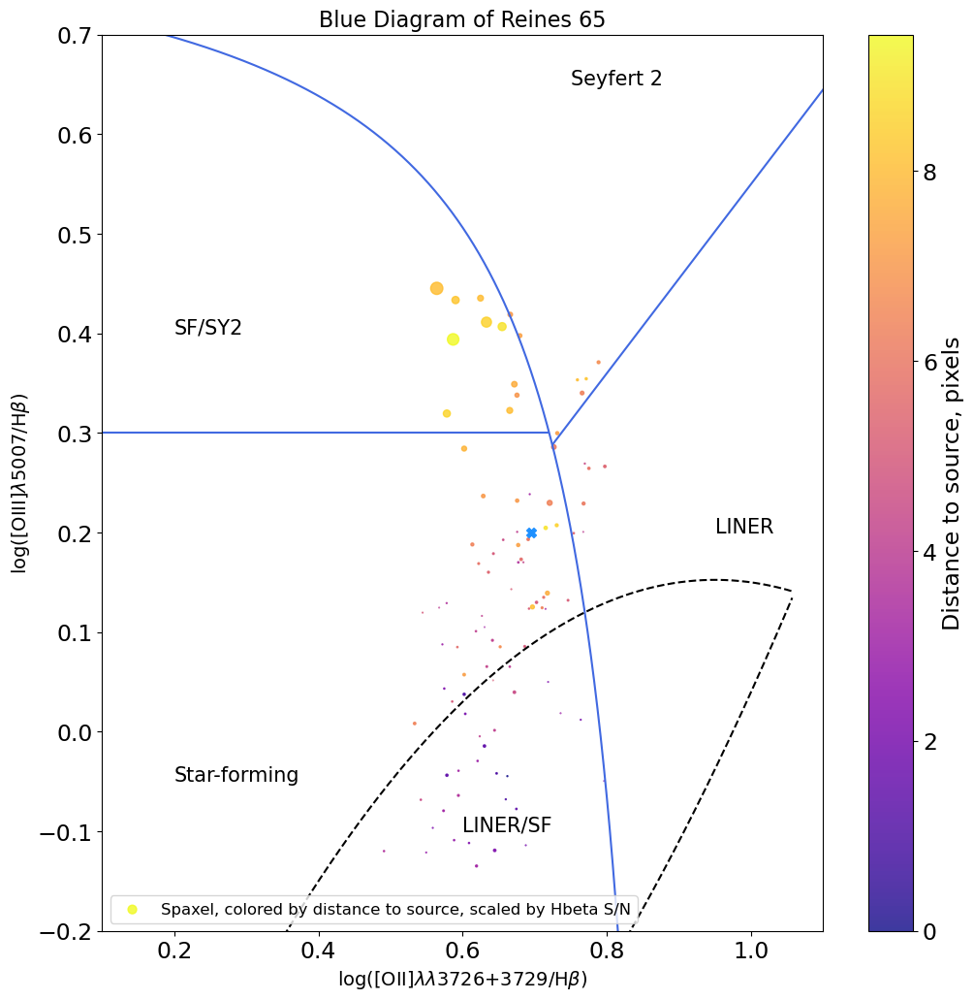

In [141]:
flux_dataset = flux_array[:,30:40,20:30]
print(flux_dataset[0])
var_dataset = var_array[:,30:40,20:30]
bin_loc = [8,5]
plot_blue(flux_dataset, var_dataset, 'Hbeta', bin_loc, True)

0.010769905251629783 0.03360026217585982 0.006786975137816994
[0.6975639721051866]


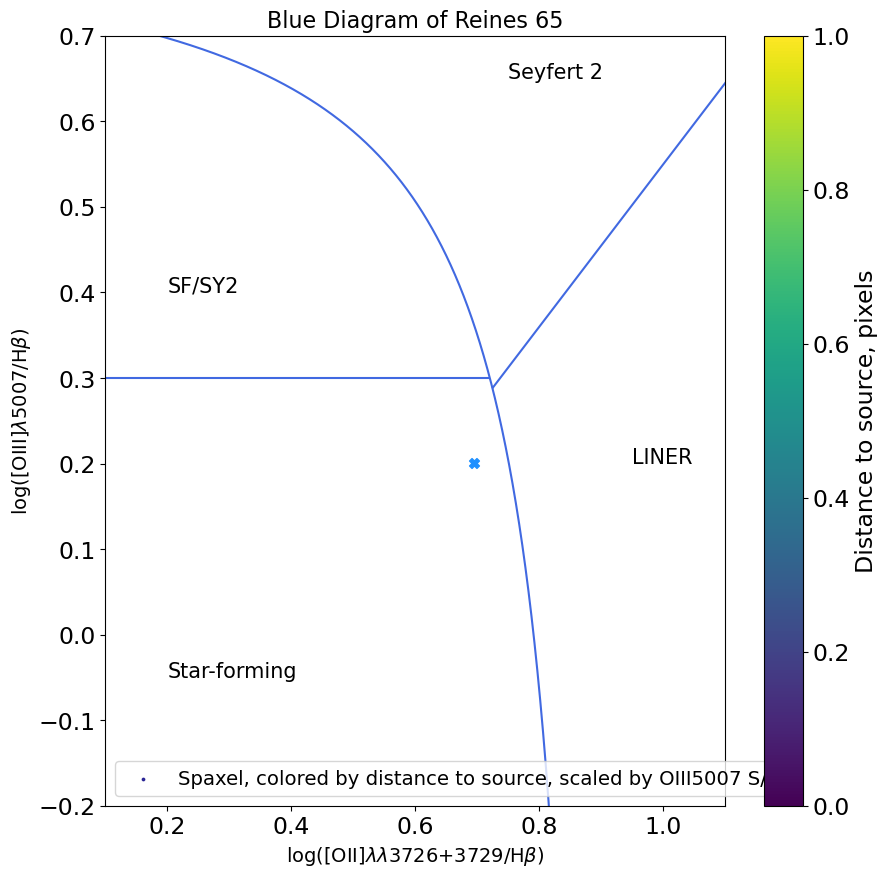

In [136]:
flux_dataset = flux_array[:,34:35,28:29]
var_dataset = var_array[:,34:35,28:29]
bin_loc = [.697076776399825,.02606651075986]
plot_blue(flux_dataset, var_dataset, 'OIII5007', bin_loc)
#plt.savefig('single_spaxel_blue.png')

(1446, 80, 67)
(1446, 80, 67)
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit Hbeta in spaxel 53, 0. Defaulting to regular markersize.
nan 0.004684323659646524 nan
nan nan nan
nan nan nan
nan nan nan
nan nan 0.002650196164070947


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/1388955408.py:376: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


nan 0.003662850428888451 0.0015211554458650577
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan 0.004099947796943642 0.0022156435287003884
nan nan nan
nan nan nan
nan nan nan
Unable to fit Hbeta in spaxel 

0.0016666597830949815 0.0023483745811297184 0.0014557521723861813
nan nan nan
nan nan nan
Unable to fit Hbeta in spaxel 57, 1. Defaulting to regular markersize.
nan nan nan
nan 0.003936791025961831 0.00023201806941363216
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan

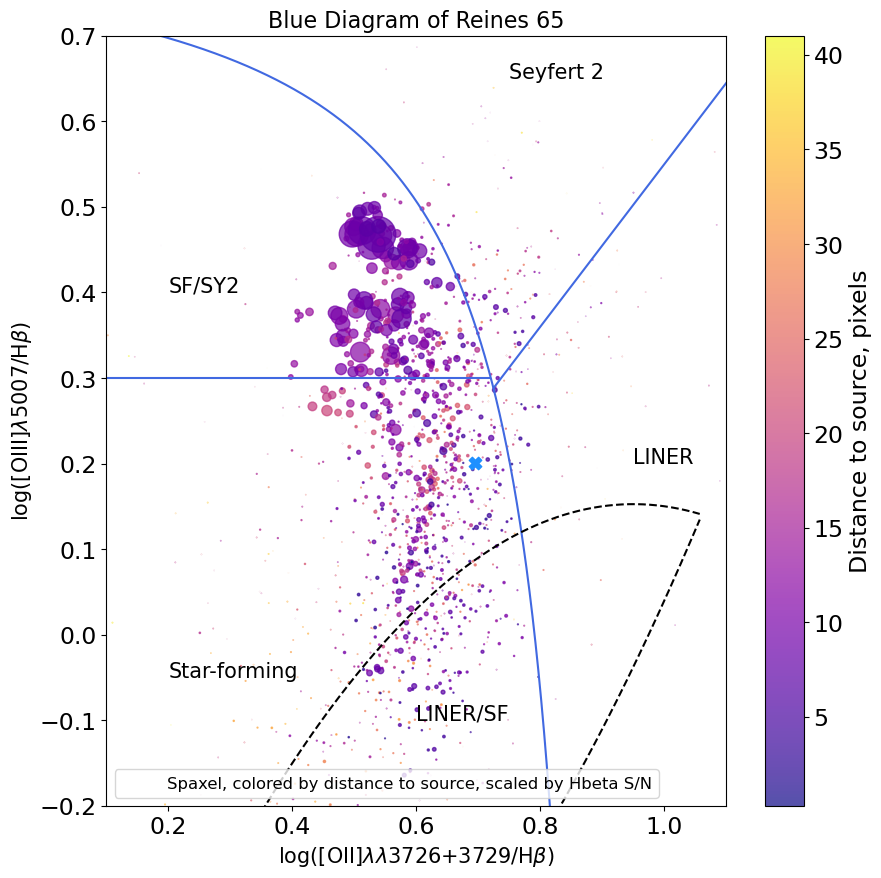

In [8]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
print(np.shape(flux_dataset))
print(np.shape(var_dataset))
bin_loc = [34.697076776399825,28.02606651075986]
plot_blue(flux_dataset, var_dataset, 'Hbeta', bin_loc, True)

plt.savefig('Hbeta_SN_blue.png', bbox_inches='tight')

nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit OIII5007 in spaxel 53, 0. Defaulting to regular markersize.
nan 0.004684323659646524 nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit OIII5007 in spaxel 57, 0. Defaulting to regular markersize.
nan nan 0.002650196164070947
Unable to fit OIII5007 in spaxel 58, 0. Defaulting to regular markersize.
nan 0.003662850428888451 0.0015211554458650577
n

Unable to fit OIII5007 in spaxel 53, 1. Defaulting to regular markersize.
nan 0.0033318541741244444 nan
0.0016666597830949815 0.0023483745811297184 0.0014557521723861813
nan nan nan
nan nan nan
Unable to fit OIII5007 in spaxel 57, 1. Defaulting to regular markersize.
nan nan nan
Unable to fit OIII5007 in spaxel 58, 1. Defaulting to regular markersize.
nan 0.003936791025961831 0.00023201806941363216
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan na

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_898/1388955408.py:376: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


0.0011051928669648585 0.0012743556671209583 nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit OIII5007 in spaxel 53, 2. Defaulting to regular markersize.
nan 0.005851711315366939 nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit OIII5007 in spaxel 57, 2. Defaulting to regular markersize.
nan nan nan
Unable to fit OIII5007 in spaxel 58, 2. Defaulting to regular markersize.
nan 0.003483502406313896 nan
0.002173583022500109 0.004272221545525575 0.003135193653998603
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan n

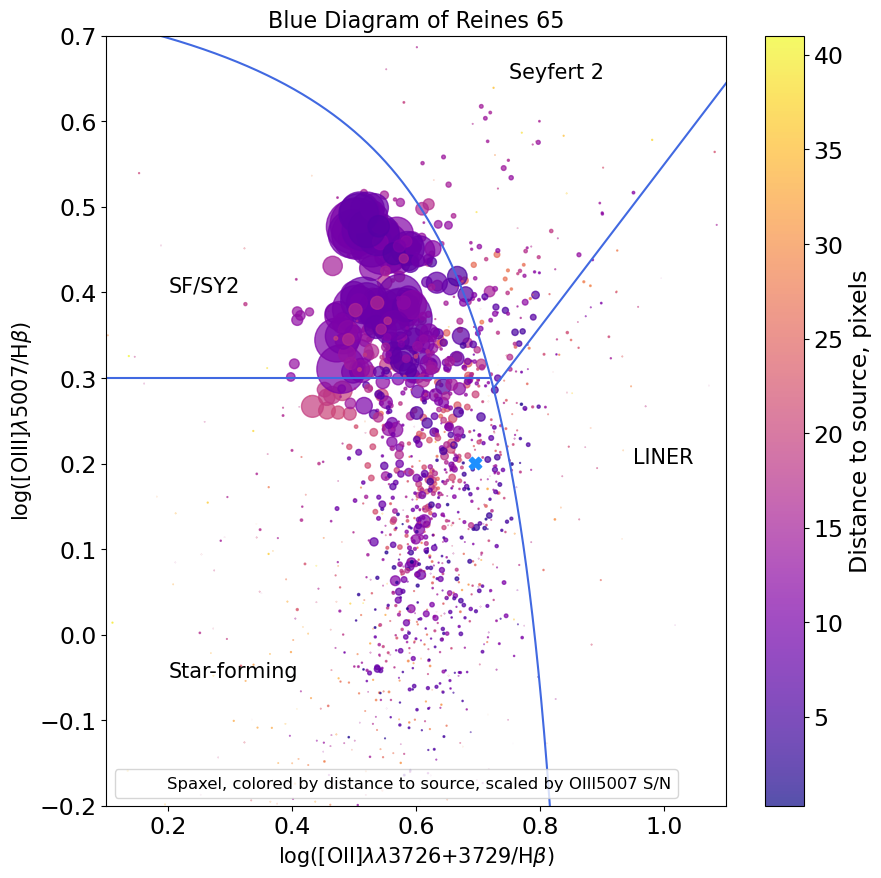

In [10]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [34.697076776399825,28.02606651075986]
plot_blue(flux_dataset, var_dataset, 'OIII5007', bin_loc)
plt.savefig('OIII_SN_blue.png', bbox_inches='tight')

nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan 0.004684323659646524 nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit OII3727 in spaxel 57, 0. Defaulting to regular markersize.
nan nan 0.002650196164070947
nan 0.003662850428888451 0.0015211554458650577
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan na

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2977996898.py:376: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


nan 0.004099947796943642 0.0022156435287003884
nan nan nan
nan nan nan
nan nan nan
nan 0.0033318541741244444 nan
0.0016666597830949815 0.0023483745811297184 0.0014557521723861813
nan nan nan
nan nan nan
Unable to fit OII3727 in spaxel 57, 1. Defaulting to regular markersize.
nan nan nan
nan 0.003936791025961831 0.00023201806941363216
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan 

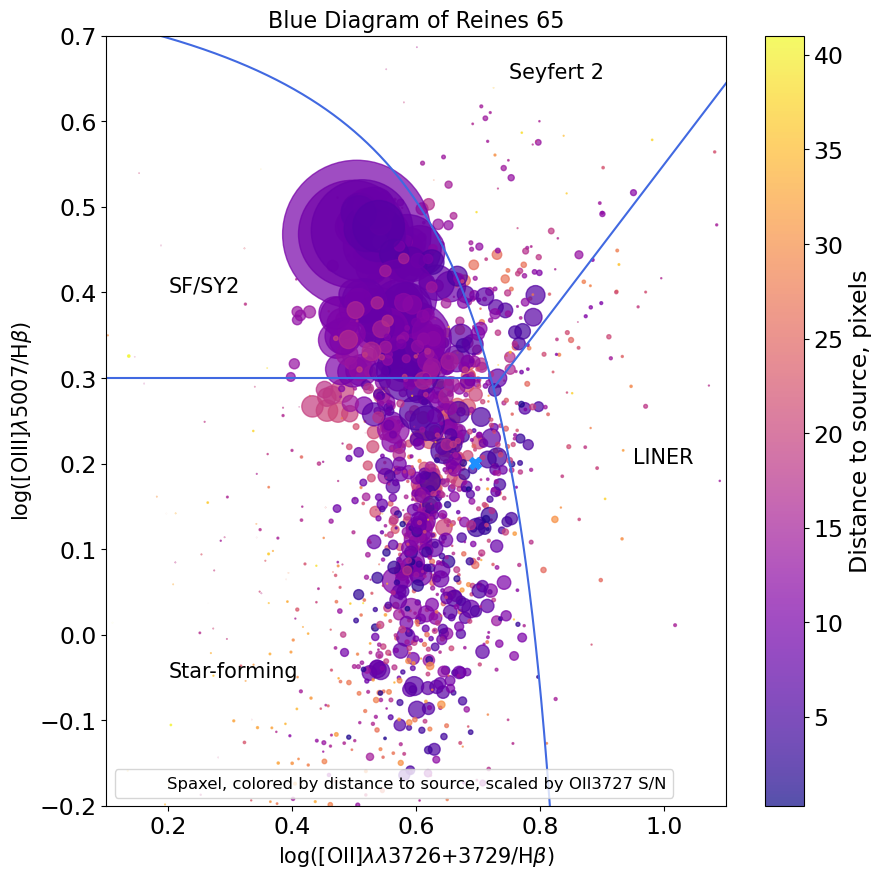

In [160]:
#blue diagram by OII s/n
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [34.697076776399825,28.02606651075986]
plot_blue(flux_dataset, var_dataset, 'OII3727', bin_loc)
plt.savefig('OII_SN_blue.png', bbox_inches='tight')

nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
nan 0.004684323659646524 nan
nan nan nan
nan nan nan
nan nan nan
S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
nan nan 0.002650196164070947
S/N emission line not in wavelength dictionary. Cannot correlate markersiz

S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
0.0011051928669648585 0.0012743556671209583 nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
nan 0.005851711315366939 nan
nan nan nan
nan nan nan
nan nan nan
S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
nan nan nan
S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
nan 0.003483502406313896 nan
S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.
0.002173583022500109 0.004272221545525575 0.003135193653998603
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan n

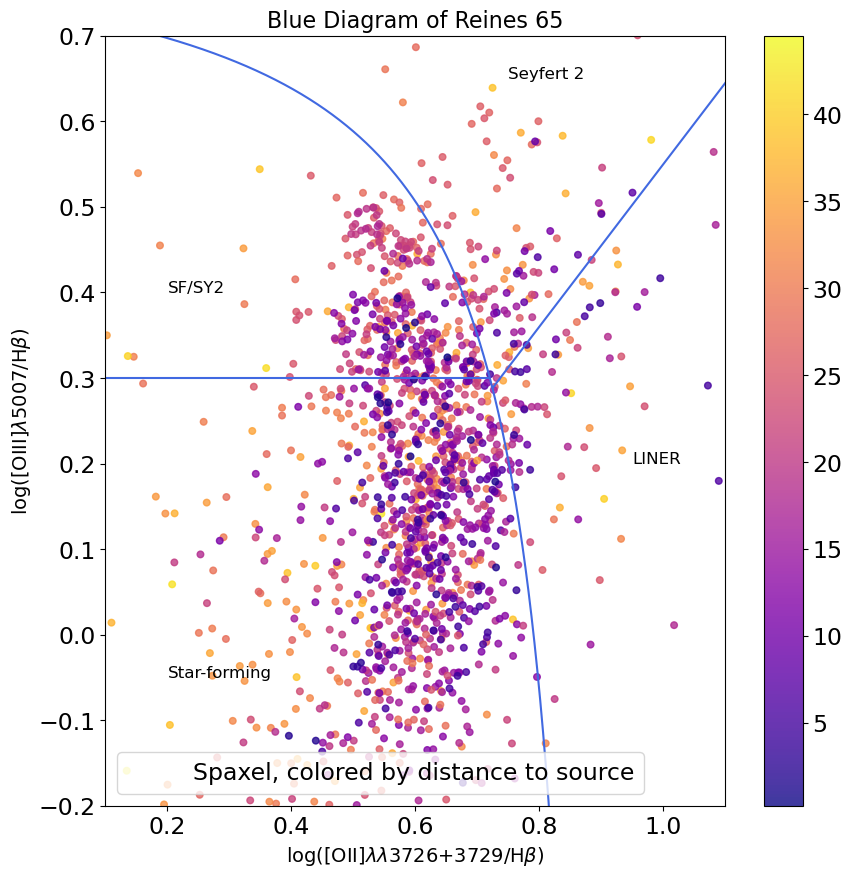

In [86]:
#Plain blue diagram
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [38.05215174427657,39.7737979639778]
plot_blue(flux_dataset, var_dataset, None, bin_loc)
#plt.savefig('plain_blue.png', bbox_inches='tight')

nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
Unable to fit Hbeta in spaxel 53, 0. Defaulting to regular markersize.
nan 0.004684323659646524 nan
nan nan nan
nan nan nan
nan nan nan


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2977996898.py:376: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


nan nan 0.002650196164070947
nan 0.003662850428888451 0.0015211554458650577
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan 0.004099947796943642 0.0022156435287003884
nan nan nan
nan nan nan
nan nan nan
U

0.0025557710773511867 0.0023439079552244908 0.0022093379210905767
Unable to fit Hbeta in spaxel 43, 3. Defaulting to regular markersize.
5.988263354077433e-42 0.001412514150709589 nan
nan nan nan
0.0020058841006367423 0.006635972247551429 0.0019701401111822765
nan nan nan
nan nan nan
nan nan nan
0.0007531946178812288 0.004859941019268387 0.009087079077742399
0.0020455971754842817 0.004288347542151311 0.0017324398118118728
nan nan nan
nan nan nan
Unable to fit Hbeta in spaxel 53, 3. Defaulting to regular markersize.
nan 0.003384395162848358 nan
nan nan nan
nan nan nan
nan 0.0018865282170801335 0.0012198112545163157
nan nan 0.0016437771149141545
nan nan nan
0.0018597152833899457 0.004711521026431402 0.0013428615326036594
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan nan
nan nan

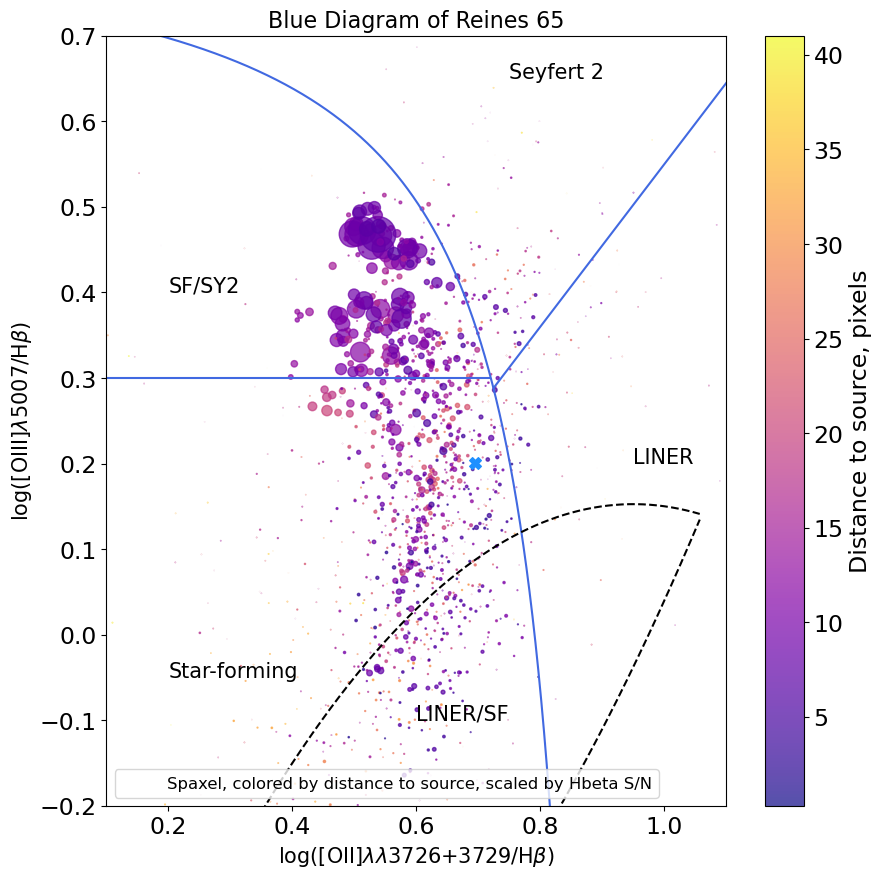

In [161]:
#LINE/SF Comp Region
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [34.697076776399825,28.02606651075986]
plot_blue(flux_dataset, var_dataset, 'Hbeta', bin_loc, True)

plt.savefig('Hbeta_SN_blue_comp.png')


#### Creating a colormap colored by region in Blue diagram

In [173]:
def blue_coded_cmap(flux_dataset, var_dataset, SN_emline, set_targ = False):
    """
    Function takes in a dataset and estimates emline, fits gaussians, and estimates S/N in specified emline for all spaxels.
    It creates colormap with pixels colored by where they would fall on blue diagram.
    Opacity of points is correlated to S/N. 
    
    Inputs:
    flux_dataset (3d array): flux cube of spaxels or bins with spectra attached.
    var_dataset (3d array): variance cube of spaxels or bins with spectra attached.
    SN_emline (str): emline to determine marker size.
    set_targ (Bool): Option to add target marker

    Outputs:
    blue_cmap: cmap colored by blue diagram location.
    """  
    #Check if dimensions of flux and variance arrays match
    assert np.shape(flux_dataset) == np.shape(var_dataset),'Dimensions of flux array must match dimensions of variance array.'
    
    #Get header info 
    header = fits.getheader('Data/reines65_icubes.fits')

    #Pointing corrections
    header['CRVAL1'] += 174.17801 - 174.1787083
    header['CRVAL2'] += 26.727126 - 26.7263583

    y_range = np.shape(flux_dataset)[1]
    x_range = np.shape(flux_dataset)[2]
    
    #Initialize colormap
    color_map = np.zeros((y_range,x_range))
    sn_map = np.zeros((y_range,x_range))

    #Set up arrays 
    xlocs = []
    ylocs = []
    
    #Set up fitters
    fitter = fitting.LevMarLSQFitter()
    fitter2 = fitting.LinearLSQFitter()

    #Get wavelength ranges of emlines
    OIII5007_central_wvl = wvldict['OIII5007']
    OIII5007_min = int(OIII5007_central_wvl - 7)
    OIII5007_max = int(OIII5007_central_wvl + 7)
    OIII5007_range = single_wvl_array[np.where((single_wvl_array >= OIII5007_min) & (single_wvl_array <= OIII5007_max))]
    
    OII3727_central_wvl = wvldict['OII3727']
    OII3727_min = int(OII3727_central_wvl - 7)
    OII3727_max = int(OII3727_central_wvl + 7)
    OII3727_range = single_wvl_array[np.where((single_wvl_array >= OII3727_min) & (single_wvl_array <= OII3727_max))]

    Hbeta_central_wvl = wvldict['Hbeta']
    Hbeta_min = int(Hbeta_central_wvl - 7)
    Hbeta_max = int(Hbeta_central_wvl + 7)
    Hbeta_range = single_wvl_array[np.where((single_wvl_array >= Hbeta_min) & (single_wvl_array <= Hbeta_max))]


    #Loop through bins, measure integrated flux of emlines, get xval and yval for each bin, append to xvals and yvals lists

    for x in range(0,x_range):
        for y in range(0,y_range):
            bin_flux = flux_dataset[:,y,x]
            bin_var = var_dataset[:,y,x]
            
            if (np.max(bin_flux) != 0):

                ##OIII5007
                #get amplitude and stddev of OIII in bin
                OIII5007_flux_range = bin_flux[np.where((single_wvl_array >= OIII5007_min) & (single_wvl_array <= OIII5007_max))]
                OIII5007_peak = np.max(OIII5007_flux_range)

                OIII5007_wvl = OIII5007_range[np.where(OIII5007_flux_range == OIII5007_peak)]
                OIII5007_loc = np.where(single_wvl_array == OIII5007_wvl)[0]

                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OIII5007_half_max = OIII5007_peak*.5
                OIII5007_half_max_wvl = single_wvl_array[OIII5007_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OIII5007_loc)
                while bin_flux[i] >= OIII5007_half_max:
                    OIII5007_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                if i == OIII5007_loc or OIII5007_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OIII5007_half_max = OIII5007_peak*.2
                    while bin_flux[i] >= OIII5007_half_max:
                        OIII5007_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                #check for bad fits
                if OIII5007_fwhm > 10: 
                    OIII5007_fwhm = 10

                if OIII5007_fwhm == 0:
                    g_OIII5007 = None
                    OIII5007 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OIII5007_sigma = OIII5007_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OIII5007_g_min = OIII5007_wvl - 2*OIII5007_fwhm
                    OIII5007_g_max = OIII5007_wvl + 2*OIII5007_fwhm

                    OIII5007_g_range = single_wvl_array[np.where((single_wvl_array >= OIII5007_g_min) & (single_wvl_array <= OIII5007_g_max))]
                    OIII5007_g_flux_range = bin_flux[np.where((single_wvl_array >= OIII5007_g_min) & (single_wvl_array <= OIII5007_g_max))]

                    OIII5007_model = models.Gaussian1D(amplitude = OIII5007_peak, mean = OIII5007_wvl, stddev = OIII5007_sigma)
                    g_OIII5007 = fitter(OIII5007_model, OIII5007_g_range, OIII5007_g_flux_range)

                    #Masking bad fits
                    if g_OIII5007.stddev > 10:
                        OIII5007 = np.nan
                    else:
                        OIII5007 = g_OIII5007.amplitude * g_OIII5007.stddev * (np.sqrt(2*np.pi))
                

                ##OII3727
                #get amplitude and stddev of OII in bin
                OII3727_flux_range = bin_flux[np.where((single_wvl_array >= OII3727_min) & (single_wvl_array <= OII3727_max))]
                OII3727_peak = np.max(OII3727_flux_range)

                OII3727_wvl = OII3727_range[np.where(OII3727_flux_range == OII3727_peak)]
                OII3727_loc = np.where(single_wvl_array == OII3727_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OII3727_half_max = OII3727_peak*.5
                OII3727_half_max_wvl = single_wvl_array[OII3727_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OII3727_loc)
                while bin_flux[i] >= OII3727_half_max:
                    OII3727_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                if i == OII3727_loc or OII3727_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OII3727_half_max = OII3727_peak*.2
                    while bin_flux[i] >= OII3727_half_max:
                        OII3727_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                #check for bad fits
                if OII3727_fwhm > 10: 
                    OII3727_fwhm = 10

                if OII3727_fwhm == 0:
                    g_OII3727 = None
                    OII3727 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OII3727_sigma = OII3727_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OII3727_g_min = OII3727_wvl - 2*OII3727_fwhm
                    OII3727_g_max = OII3727_wvl + 2*OII3727_fwhm
                    
                    OII3727_g_range = single_wvl_array[np.where((single_wvl_array >= OII3727_g_min) & (single_wvl_array <= OII3727_g_max))]
                    OII3727_g_flux_range = bin_flux[np.where((single_wvl_array >= OII3727_g_min) & (single_wvl_array <= OII3727_g_max))]

                    OII3727_model = models.Gaussian1D(amplitude = OII3727_peak, mean = OII3727_wvl, stddev = OII3727_sigma)
                    g_OII3727 = fitter(OII3727_model, OII3727_g_range, OII3727_g_flux_range)
                    
                    #Masking bad fits
                    if g_OII3727.stddev > 10:
                        OII3727 = np.nan
                    else:
                        OII3727 = g_OII3727.amplitude * g_OII3727.stddev * (np.sqrt(2*np.pi))
                

                ##Hbeta
                #get amplitude and stddev of Hbeta in bin
                Hbeta_flux_range = bin_flux[np.where((single_wvl_array >= Hbeta_min) & (single_wvl_array <= Hbeta_max))]
                Hbeta_peak = np.max(Hbeta_flux_range)

                Hbeta_wvl = Hbeta_range[np.where(Hbeta_flux_range == Hbeta_peak)]
                Hbeta_loc = np.where(single_wvl_array == Hbeta_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                Hbeta_half_max = Hbeta_peak*.5
                Hbeta_half_max_wvl = single_wvl_array[Hbeta_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(Hbeta_loc)
                while bin_flux[i] >= Hbeta_half_max:
                    Hbeta_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                if i == Hbeta_loc or Hbeta_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    Hbeta_half_max = Hbeta_peak*.2
                    while bin_flux[i] >= Hbeta_half_max:
                        Hbeta_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                #check for bad fits
                if Hbeta_fwhm > 10: 
                    Hbeta_fwhm = 10

                if Hbeta_fwhm == 0:
                    g_Hbeta = None
                    Hbeta = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    Hbeta_sigma = Hbeta_fwhm / (2*np.sqrt(2*np.log(2)))
                    
                    #Ranges for gaussian fit using estimated fwhm
                    Hbeta_g_min = Hbeta_wvl - 2*Hbeta_fwhm
                    Hbeta_g_max = Hbeta_wvl + 2*Hbeta_fwhm
                    
                    Hbeta_g_range = single_wvl_array[np.where((single_wvl_array >= Hbeta_g_min) & (single_wvl_array <= Hbeta_g_max))]
                    Hbeta_g_flux_range = bin_flux[np.where((single_wvl_array >= Hbeta_g_min) & (single_wvl_array <= Hbeta_g_max))]

                    Hbeta_model = models.Gaussian1D(amplitude = Hbeta_peak, mean = Hbeta_wvl, stddev = Hbeta_sigma)
                    g_Hbeta = fitter(Hbeta_model, Hbeta_g_range, Hbeta_g_flux_range)

                    #Masking bad fits
                    if g_Hbeta.stddev > 10:
                        Hbeta = np.nan
                    else:
                        #Integrated flux = A*sigma*sqrt(2pi)
                        Hbeta = g_Hbeta.amplitude * g_Hbeta.stddev * (np.sqrt(2*np.pi))
                
               
                #Calculating S/N for entered emline
                if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007':
                    
                    #accessing gaussian object
                    g = locals()['g_' + SN_emline]

                    #Spaxels with no gaussian fit
                    if g == None:
                        s = 0

                    #Bad fits/empty spaxels
                    elif g.amplitude <= 0 or g.stddev > 10 or g.stddev == 0:
                        s = 0

                    else:
                        #wavelength range around emission line
                        wvl_min = g.mean - 2*g.fwhm
                        wvl_max = g.mean + 2*g.fwhm
                        
                        wvl_range = single_wvl_array[np.where((single_wvl_array >= wvl_min) & (single_wvl_array <= wvl_max))]
                        
                        #Sum flux over wvls
                        flux_sum = 0

                        left_wavelengths = []
                        right_wavelengths = []
                        left_continuum = []
                        right_continuum = []

                        #Calculating sum in signal equation
                        for wvl in wvl_range:
                            flux = bin_flux[np.where(single_wvl_array == wvl)]

                            try: 					
                                #Find first wvl after starting wvl, look up flux and wvl values and store in arrays
                                #Starting guess for wavelength, left side
                                left_starting_wvl = wvl - 6 * g.stddev 
                                #Starting guess for wvl, right side
                                right_starting_wvl = wvl + 6 * g.stddev  
                                
                                #Actual wavelength where there is a flux measurement
                                fc_1_wvl = single_wvl_array[np.where(single_wvl_array >= left_starting_wvl)[0][0]]
                                #Flux value 
                                fc_1 = bin_flux[np.where(single_wvl_array == fc_1_wvl)]
                                try:
                                    fc_1 = fc_1[0]
                                except:
                                    pass
                                
                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_1 < .0008:
                                    left_wavelengths.append(fc_1_wvl)
                                    left_continuum.append(fc_1)
                                else: 
                                    fc_1 = np.nan
                        
                                #Actual wavelength where there is a flux measurement
                                fc_2_wvl = single_wvl_array[np.where(single_wvl_array >= right_starting_wvl)[0][0]]
                                #Flux value
                                fc_2 = bin_flux[np.where(single_wvl_array == fc_2_wvl)]
                                try:
                                    fc_2 = fc_2[0]
                                except:
                                    pass

                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_2 < .0008:
                                    right_wavelengths.append(fc_2_wvl)
                                    right_continuum.append(fc_2)
                                else: 
                                    fc_2 = np.nan  

                                #Flux array 
                                if not (np.isnan(fc_1) and np.isnan(fc_2)):
                                    flux_sum += (flux - np.nanmean([fc_1, fc_2]))
                                else: 
                                    flux_sum += flux
                            
                            #Index Error for when the continuum wavelength array is empty
                            except IndexError:
                                flux_sum += flux
                                

                            #signal of emission is just integrated flux
                            signal = flux_sum

                            #Calculate standard deviation of continuum bands 
                            #Fit line to continuums
                            lin_model = models.Linear1D(slope=0, intercept=0)
                            
                            #Linear fit
                            lin_fit_left = fitter2(lin_model, left_wavelengths, left_continuum)
                            lin_fit_right = fitter2(lin_model, right_wavelengths, right_continuum)

                            #Difference from line to points
                            left_diff = []
                            right_diff = []

                            for index, point in enumerate(left_continuum):

                                diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
                                left_diff.append(diff_1)

                            for index, point in enumerate(right_continuum):

                                diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
                                right_diff.append(diff_2)

                            sig_1 = np.std(left_diff)
                            sig_2 = np.std(right_diff)

                            #Calculate noise of emission
                            noise = np.mean([sig_1,sig_2])
                            s = abs((signal / noise)[0])

                            #Masking really bad fits (visually inspected colormaps and fits, these are all pixels at the outskirts of image with terrible fits)
                            if s > 4000: 
                                s = 0

                else:
                    s = 0
            else:
                OIII5007 = np.nan
                OII3727 = np.nan
                Hbeta = np.nan
                s = 0
                
            xval = np.log10(OII3727/Hbeta)
            yval = np.log10(OIII5007/Hbeta)
            
            #Assigning color
            #Seyfert 2 = magenta
            if yval > (.95*xval - .4) and xval > (.11/(yval - .85) + .92):
                c = 1
            
            #SF/SY2 = blue violet
            elif yval > .3 and xval < (.11/(yval - .85) + .92):
                c = 2

            #Star forming = dodger blue
            elif yval < .3 and xval < (.11/(yval - .85) + .92):
                c = 3

            #LINER = dark cyan
            elif yval < (.95*xval - .4) and xval > (.11/(yval - .85) + .92):
                c = 4
            
            else: 
                c = 0
            

            #More bad fits ):
            if xval > 10 or xval < -10 or yval > 10 or yval < -10:
                xval = np.nan
                yval = np.nan
                s = 0

            #Spaxel location
            ylocs.append(y)
            xlocs.append(x)

            #color
            color_map[y][x] = c
            #opacity
            sn_map[y][x] = s
    
    #color_map = np.flip(color_map,1)
    #sn_map = np.flip(sn_map,1)
    blue_cmap = ListedColormap(['black', 'magenta', 'blueviolet', 'dodgerblue', 'darkcyan'])

    #Creating a DIY legend with disctionaries
    cmap_colors = {1:'black', 2:'magenta', 3:'blueviolet', 4:'dodgerblue', 5:'darkcyan'}
    labels = {1:'Insufficient data',2:'Seyfert 2',3:'SF/SY2',4:'Star Forming', 5:'LINER'}
    
    #create patches for legend
    patches =[mpatches.Patch(color=cmap_colors[i],label=labels[i]) for i in cmap_colors]

    #Displaying image with RA/Dec grid
    plt.figure(figsize = (12,12))
    coords = WCS(header, naxis = 2)
    plot = plt.subplot(projection = coords)

    #SN cmap underneath to make pixels appear darker or lighter based on SN
    plt.imshow(sn_map, cmap = 'binary_r')

    #Displaying data with sequential cmap to show classifications
    plt.imshow(color_map, alpha=.6, cmap = blue_cmap, vmin = 0, vmax = 5)
    plt.colorbar()
    plt.grid()

    #DIY legend
    plt.legend(handles=patches, loc = 'lower right')
    plt.title('Sources in Galaxy Colored by Blue Diagram Classification')

    if set_targ:
        #Adding the radio source
        ra_targ = 174.17740 * u.degree 
        dec_targ = 26.72657 * u.degree 
        c_targ = SkyCoord(ra_targ, dec_targ, frame='icrs')
        x,y = coords.world_to_pixel(c_targ)
        plt.scatter(x,y, color = 'darkorange', s = 25, marker='X')

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/200676692.py:370: RuntimeWarning: divide by zero encountered in divide
  s = abs((signal / noise)[0])
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


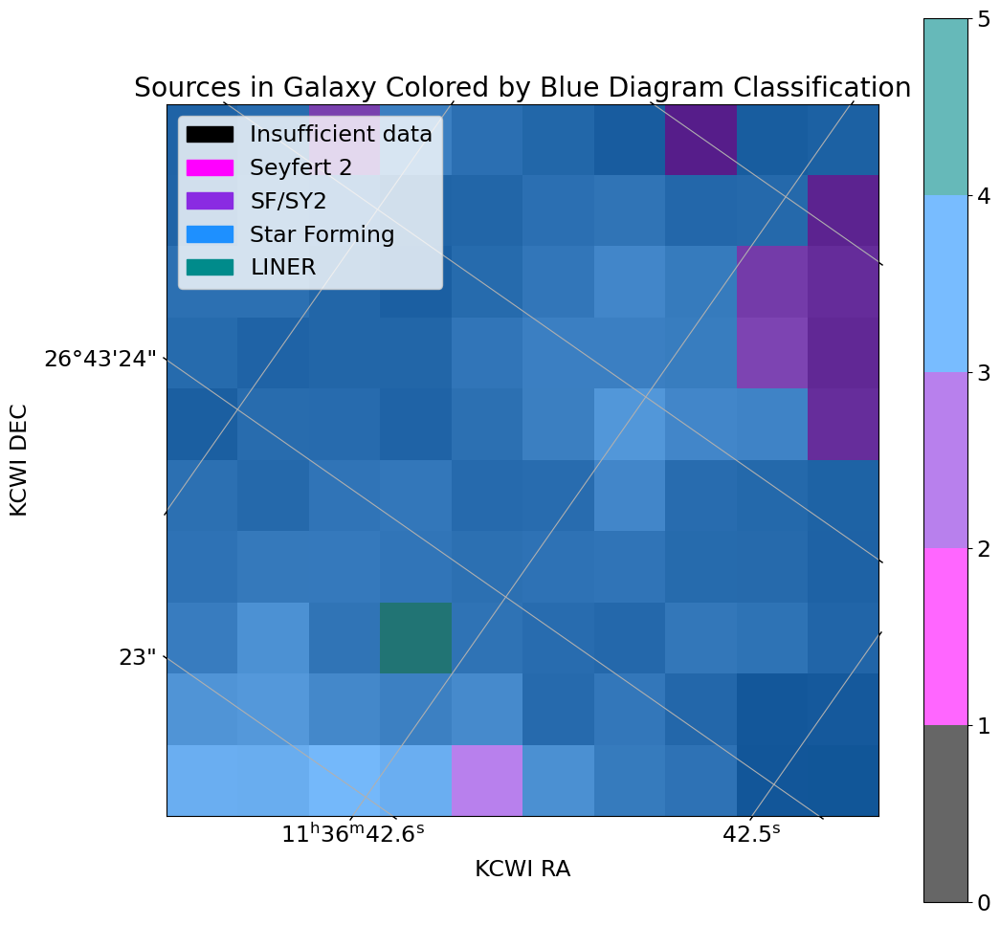

In [168]:
flux_dataset = flux_array[:,30:40,30:40]
var_dataset = var_array[:,30:40,30:40]

blue_coded_cmap(flux_dataset, var_dataset, 'Hbeta', False)

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/467140944.py:370: RuntimeWarning: divide by zero encountered in divide
  s = abs((signal / noise)[0])


/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


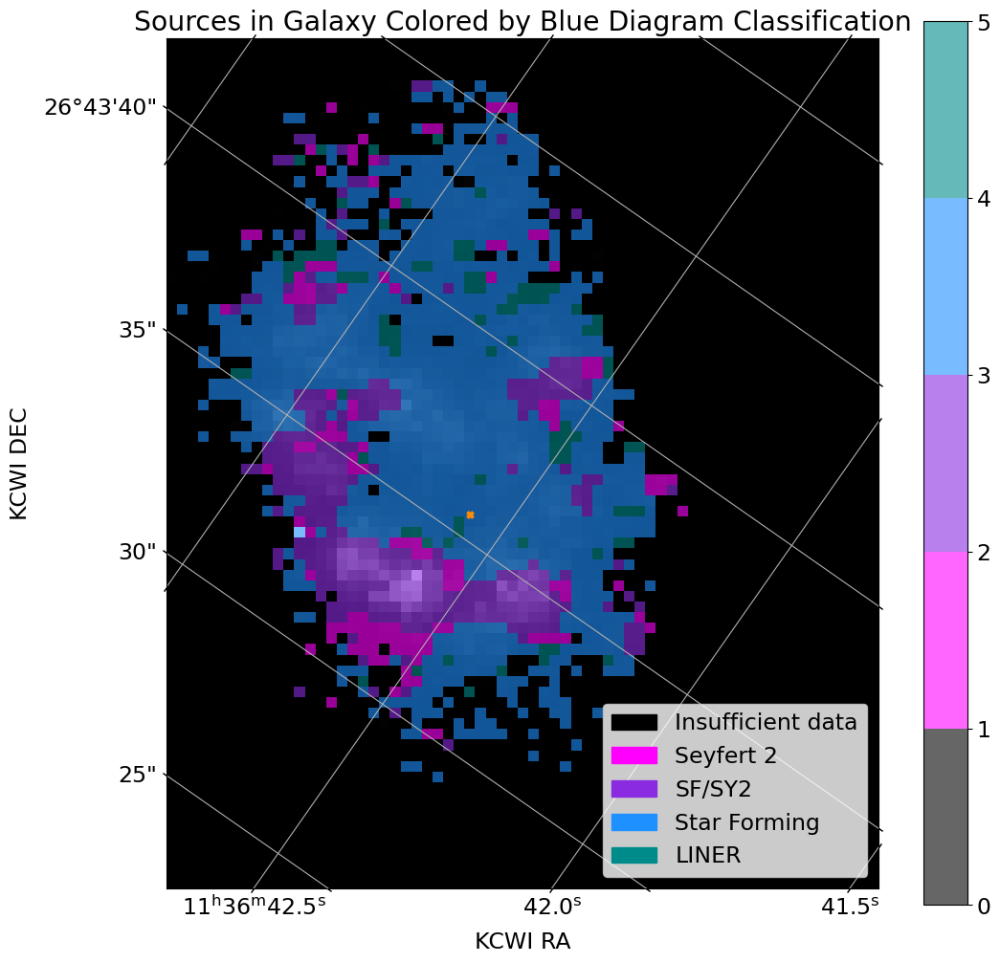

In [174]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
blue_coded_cmap(flux_dataset, var_dataset, 'Hbeta', True)
plt.savefig('blue_coded_cmap_hbeta.png', bbox_inches='tight')

/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/467140944.py:370: RuntimeWarning: divide by zero encountered in divide
  s = abs((signal / noise)[0])


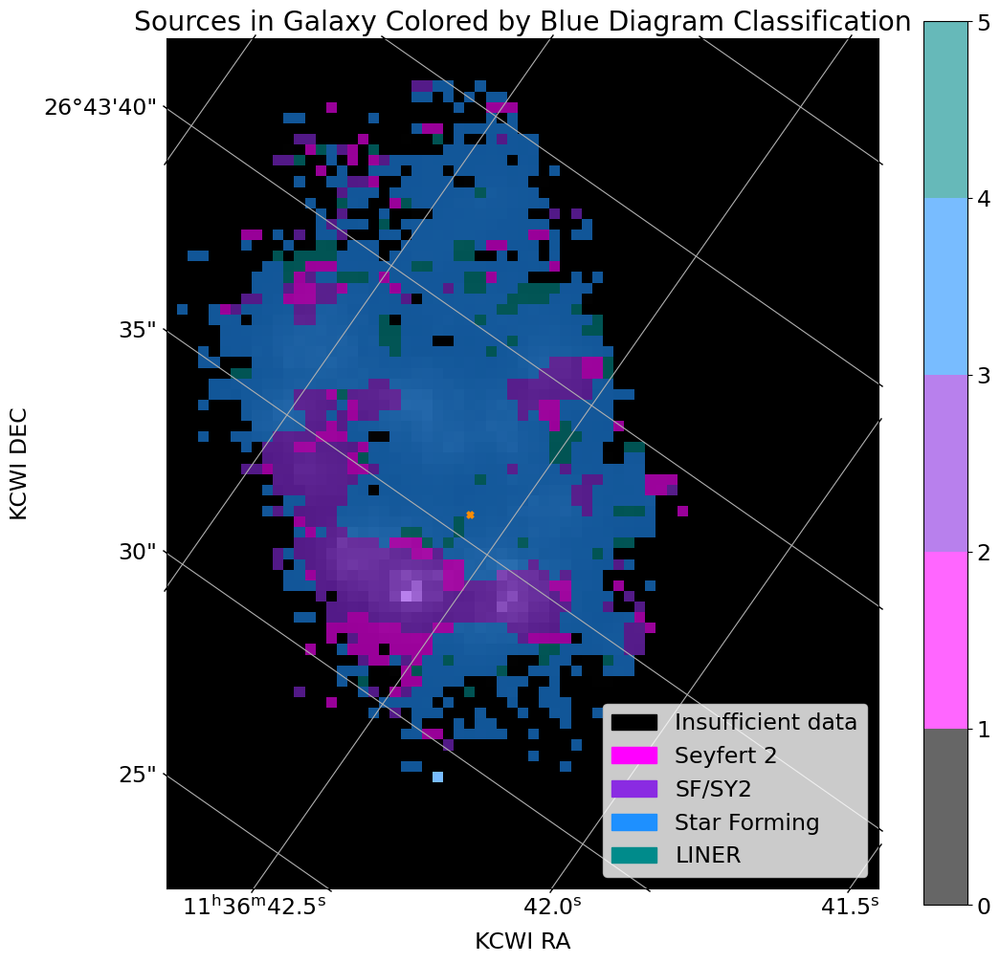

In [175]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
blue_coded_cmap(flux_dataset, var_dataset, 'OII3727', True)
plt.savefig('blue_coded_cmap_OII.png', bbox_inches='tight')

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/467140944.py:370: RuntimeWarning: divide by zero encountered in divide
  s = abs((signal / noise)[0])


/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


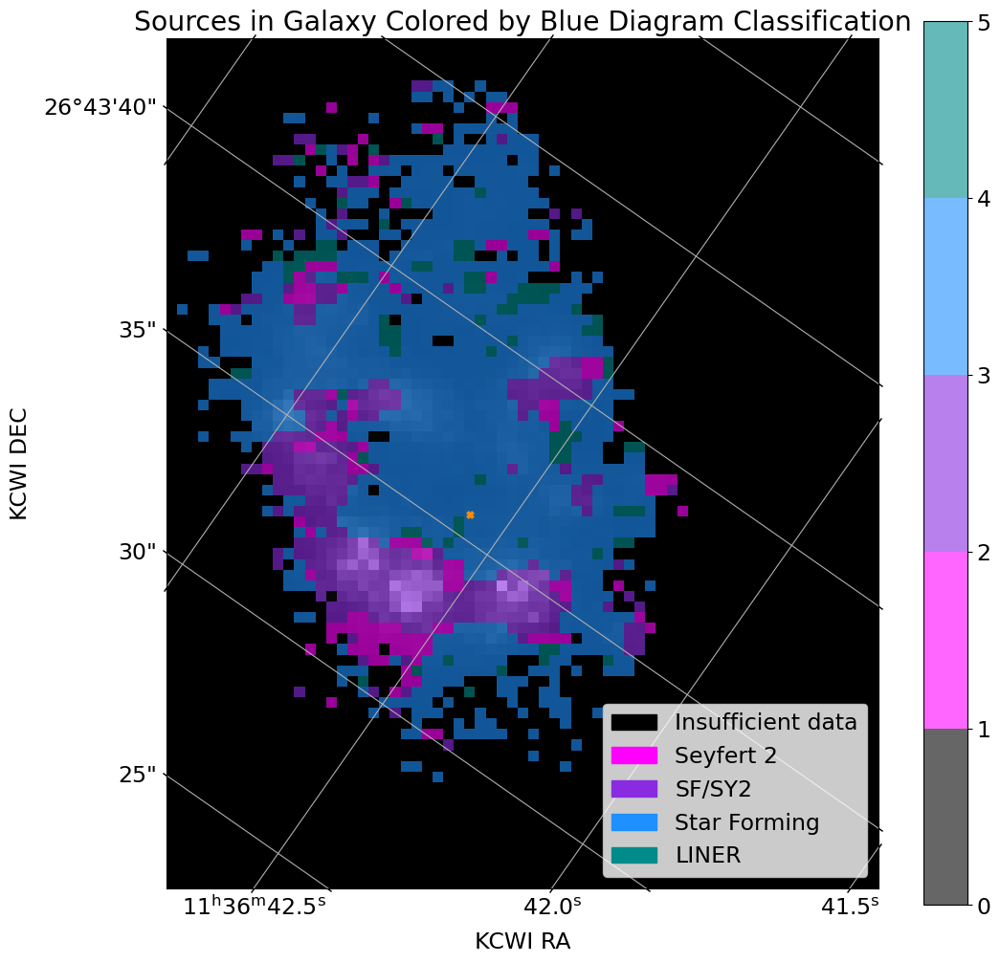

In [176]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
blue_coded_cmap(flux_dataset, var_dataset, 'OIII5007', True)
plt.savefig('blue_coded_cmap_OIII.png', bbox_inches='tight')

#### The OHNO Diagram

In [178]:
def OHNO(flux_dataset, var_dataset, SN_emline, bin_loc = [0,0]): 
    """
    Function takes in a dataset and estimates emline, fits gaussians, and estimates S/N in specified emline for all spaxels.
    It creates an OHNO diagram which plots all bins/spaxels in dataset. 
    It colors the bins by their distance from chosen bin number (bins containing source).
    It correlates marker sizes with S/N of input emline. 
    
    Inputs:
    flux_dataset (3d array): flux cube of spaxels or bins with spectra attached.
    var_dataset (3d array): variance cube of spaxels or bins with spectra attached.
    SN_emline (str): emline to determine marker sizes.
    bin_loc (list of float): index of bin to calculate distances to. If none is entered, defaults to zero. 
    Note must subtract starting spaxel ID if using sub-array. 

    Outputs:
    OHNO diagram plot containing all spaxels or bins.
    """  
    #Check if dimensions of flux and variance arrays match
    assert np.shape(flux_dataset) == np.shape(var_dataset),'Dimensions of flux array must match dimensions of variance array.'
    
    #Set up arrays for x and y values of datapoints
    xvals = []
    yvals = []
    markersize = []
    dist = []
    
    #Set up fitters
    fitter = fitting.LevMarLSQFitter()
    fitter2 = fitting.LinearLSQFitter()

    #Get wavelength ranges of emlines
    OIII5007_central_wvl = wvldict['OIII5007']
    OIII5007_min = int(OIII5007_central_wvl - 7)
    OIII5007_max = int(OIII5007_central_wvl + 7)
    OIII5007_range = single_wvl_array[np.where((single_wvl_array >= OIII5007_min) & (single_wvl_array <= OIII5007_max))]
    
    OII3727_central_wvl = wvldict['OII3727']
    OII3727_min = int(OII3727_central_wvl - 7)
    OII3727_max = int(OII3727_central_wvl + 7)
    OII3727_range = single_wvl_array[np.where((single_wvl_array >= OII3727_min) & (single_wvl_array <= OII3727_max))]

    Hbeta_central_wvl = wvldict['Hbeta']
    Hbeta_min = int(Hbeta_central_wvl - 7)
    Hbeta_max = int(Hbeta_central_wvl + 7)
    Hbeta_range = single_wvl_array[np.where((single_wvl_array >= Hbeta_min) & (single_wvl_array <= Hbeta_max))]

    NeIII3869_central_wvl = wvldict['NeIII3869']
    NeIII3869_min = int(NeIII3869_central_wvl - 7)
    NeIII3869_max = int(NeIII3869_central_wvl + 7)
    NeIII3869_range = single_wvl_array[np.where((single_wvl_array >= NeIII3869_min) & (single_wvl_array <= NeIII3869_max))]


    #Loop through bins, measure integrated flux of emlines, get xval and yval for each bin, append to xvals and yvals lists
    y_range = np.shape(flux_dataset)[1]
    x_range = np.shape(flux_dataset)[2]

    for x in range(0,x_range):
        for y in range(0,y_range):
            bin_flux = flux_dataset[:,y,x]
            bin_var = var_dataset[:,y,x]
            
            if (np.max(bin_flux) != 0):

                ##OIII5007
                #get amplitude and stddev of OIII in bin
                OIII5007_flux_range = bin_flux[np.where((single_wvl_array >= OIII5007_min) & (single_wvl_array <= OIII5007_max))]
                OIII5007_peak = np.max(OIII5007_flux_range)

                OIII5007_wvl = OIII5007_range[np.where(OIII5007_flux_range == OIII5007_peak)]
                OIII5007_loc = np.where(single_wvl_array == OIII5007_wvl)[0]

                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OIII5007_half_max = OIII5007_peak*.5
                OIII5007_half_max_wvl = single_wvl_array[OIII5007_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OIII5007_loc)
                while bin_flux[i] >= OIII5007_half_max:
                    OIII5007_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                if i == OIII5007_loc or OIII5007_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OIII5007_half_max = OIII5007_peak*.2
                    while bin_flux[i] >= OIII5007_half_max:
                        OIII5007_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                #check for bad fits
                if OIII5007_fwhm > 10: 
                    OIII5007_fwhm = 10

                if OIII5007_fwhm == 0:
                    g_OIII5007 = None
                    OIII5007 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OIII5007_sigma = OIII5007_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OIII5007_g_min = OIII5007_wvl - 2*OIII5007_fwhm
                    OIII5007_g_max = OIII5007_wvl + 2*OIII5007_fwhm

                    OIII5007_g_range = single_wvl_array[np.where((single_wvl_array >= OIII5007_g_min) & (single_wvl_array <= OIII5007_g_max))]
                    OIII5007_g_flux_range = bin_flux[np.where((single_wvl_array >= OIII5007_g_min) & (single_wvl_array <= OIII5007_g_max))]
                    # print('fwhm: ' ,OIII5007_fwhm)
                    # print('OIII g range: ', OIII5007_g_range)
                    # print('OIII g flux range: ', OIII5007_g_flux_range)

                    OIII5007_model = models.Gaussian1D(amplitude = OIII5007_peak, mean = OIII5007_wvl, stddev = OIII5007_sigma)
                    g_OIII5007 = fitter(OIII5007_model, OIII5007_g_range, OIII5007_g_flux_range)

                    #Masking bad fits
                    if g_OIII5007.stddev > 10:
                        OIII5007 = np.nan
                    else:
                        OIII5007 = g_OIII5007.amplitude * g_OIII5007.stddev * (np.sqrt(2*np.pi))
                

                ##OII3727
                #get amplitude and stddev of OII in bin
                OII3727_flux_range = bin_flux[np.where((single_wvl_array >= OII3727_min) & (single_wvl_array <= OII3727_max))]
                OII3727_peak = np.max(OII3727_flux_range)

                OII3727_wvl = OII3727_range[np.where(OII3727_flux_range == OII3727_peak)]
                OII3727_loc = np.where(single_wvl_array == OII3727_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OII3727_half_max = OII3727_peak*.5
                OII3727_half_max_wvl = single_wvl_array[OII3727_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OII3727_loc)
                while bin_flux[i] >= OII3727_half_max:
                    OII3727_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                if i == OII3727_loc or OII3727_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OII3727_half_max = OII3727_peak*.2
                    while bin_flux[i] >= OII3727_half_max:
                        OII3727_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                #check for bad fits
                if OII3727_fwhm > 10: 
                    OII3727_fwhm = 10

                if OII3727_fwhm == 0:
                    g_OII3727 = None
                    OII3727 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OII3727_sigma = OII3727_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OII3727_g_min = OII3727_wvl - 2*OII3727_fwhm
                    OII3727_g_max = OII3727_wvl + 2*OII3727_fwhm
                    
                    OII3727_g_range = single_wvl_array[np.where((single_wvl_array >= OII3727_g_min) & (single_wvl_array <= OII3727_g_max))]
                    OII3727_g_flux_range = bin_flux[np.where((single_wvl_array >= OII3727_g_min) & (single_wvl_array <= OII3727_g_max))]
                    # print(OII3727_fwhm)
                    # print('OII3727 g range: ', OII3727_g_range)
                    # print('OII3727 g flux range: ', OII3727_g_flux_range)

                    OII3727_model = models.Gaussian1D(amplitude = OII3727_peak, mean = OII3727_wvl, stddev = OII3727_sigma)
                    g_OII3727 = fitter(OII3727_model, OII3727_g_range, OII3727_g_flux_range)
                    
                    #Masking bad fits
                    if g_OII3727.stddev > 10:
                        OII3727 = np.nan
                    else:
                        OII3727 = g_OII3727.amplitude * g_OII3727.stddev * (np.sqrt(2*np.pi))
                

                ##Hbeta
                #get amplitude and stddev of Hbeta in bin
                Hbeta_flux_range = bin_flux[np.where((single_wvl_array >= Hbeta_min) & (single_wvl_array <= Hbeta_max))]
                Hbeta_peak = np.max(Hbeta_flux_range)

                Hbeta_wvl = Hbeta_range[np.where(Hbeta_flux_range == Hbeta_peak)]
                Hbeta_loc = np.where(single_wvl_array == Hbeta_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                Hbeta_half_max = Hbeta_peak*.5
                Hbeta_half_max_wvl = single_wvl_array[Hbeta_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(Hbeta_loc)
                while bin_flux[i] >= Hbeta_half_max:
                    Hbeta_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                if i == Hbeta_loc or Hbeta_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    Hbeta_half_max = Hbeta_peak*.2
                    while bin_flux[i] >= Hbeta_half_max:
                        Hbeta_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                #check for bad fits
                if Hbeta_fwhm > 10: 
                    Hbeta_fwhm = 10

                if Hbeta_fwhm == 0:
                    g_Hbeta = None
                    Hbeta = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    Hbeta_sigma = Hbeta_fwhm / (2*np.sqrt(2*np.log(2)))
                    
                    #Ranges for gaussian fit using estimated fwhm
                    Hbeta_g_min = Hbeta_wvl - 2*Hbeta_fwhm
                    Hbeta_g_max = Hbeta_wvl + 2*Hbeta_fwhm
                    
                    Hbeta_g_range = single_wvl_array[np.where((single_wvl_array >= Hbeta_g_min) & (single_wvl_array <= Hbeta_g_max))]
                    Hbeta_g_flux_range = bin_flux[np.where((single_wvl_array >= Hbeta_g_min) & (single_wvl_array <= Hbeta_g_max))]
                    # print(Hbeta_fwhm)
                    # print('Hbeta g range: ', Hbeta_g_range)
                    # print('Hbeta g flux range: ', Hbeta_g_flux_range)

                    Hbeta_model = models.Gaussian1D(amplitude = Hbeta_peak, mean = Hbeta_wvl, stddev = Hbeta_sigma)
                    g_Hbeta = fitter(Hbeta_model, Hbeta_g_range, Hbeta_g_flux_range)

                    #Masking bad fits
                    if g_Hbeta.stddev > 10:
                        Hbeta = np.nan
                    else:
                        #Integrated flux = A*sigma*sqrt(2pi)
                        Hbeta = g_Hbeta.amplitude * g_Hbeta.stddev * (np.sqrt(2*np.pi))

                ##NeIII
                #get amplitude and stddev of NeIII in bin
                NeIII3869_flux_range = bin_flux[np.where((single_wvl_array >= NeIII3869_min) & (single_wvl_array <= NeIII3869_max))]
                NeIII3869_peak = np.max(NeIII3869_flux_range)

                NeIII3869_wvl = NeIII3869_range[np.where(NeIII3869_flux_range == NeIII3869_peak)]
                NeIII3869_loc = np.where(single_wvl_array == NeIII3869_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                NeIII3869_half_max = NeIII3869_peak*.5
                NeIII3869_half_max_wvl = single_wvl_array[NeIII3869_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(NeIII3869_loc)
                while bin_flux[i] >= NeIII3869_half_max:
                    NeIII3869_half_max_wvl = single_wvl_array[i]
                    
                    i += 1

                NeIII3869_fwhm = abs((NeIII3869_half_max_wvl - NeIII3869_wvl)*2)

                if i == NeIII3869_loc or NeIII3869_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    NeIII3869_half_max = NeIII3869_peak*.2
                    while bin_flux[i] >= NeIII3869_half_max:
                        NeIII3869_half_max_wvl = single_wvl_array[i]
                        
                        i += 1

                    NeIII3869_fwhm = abs((NeIII3869_half_max_wvl - NeIII3869_wvl)*2)

                #check for bad fits
                if NeIII3869_fwhm > 10: 
                    NeIII3869_fwhm = 10

                if NeIII3869_fwhm == 0:
                    g_NeIII3869 = None
                    NeIII3869 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    NeIII3869_sigma = NeIII3869_fwhm / (2*np.sqrt(2*np.log(2)))
                    
                    #Ranges for gaussian fit using estimated fwhm
                    NeIII3869_g_min = NeIII3869_wvl - 2*NeIII3869_fwhm
                    NeIII3869_g_max = NeIII3869_wvl + 2*NeIII3869_fwhm
                    
                    NeIII3869_g_range = single_wvl_array[np.where((single_wvl_array >= NeIII3869_g_min) & (single_wvl_array <= NeIII3869_g_max))]
                    NeIII3869_g_flux_range = bin_flux[np.where((single_wvl_array >= NeIII3869_g_min) & (single_wvl_array <= NeIII3869_g_max))]

                    NeIII3869_model = models.Gaussian1D(amplitude = NeIII3869_peak, mean = NeIII3869_wvl, stddev = NeIII3869_sigma)
                    g_NeIII3869 = fitter(NeIII3869_model, NeIII3869_g_range, NeIII3869_g_flux_range)

                    #Masking bad fits
                    if g_NeIII3869.stddev > 10:
                        NeIII3869 = np.nan
                    else:
                        #Integrated flux = A*sigma*sqrt(2pi)
                        NeIII3869 = g_NeIII3869.amplitude * g_NeIII3869.stddev * (np.sqrt(2*np.pi))
                
               
                #Calculating S/N for entered emline
                if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007' or SN_emline == 'NeIII3869':
                    
                    #accessing gaussian object
                    g = locals()['g_' + SN_emline]

                    #Spaxels with no gaussian fit
                    if g == None:
                        print(f'Unable to fit {SN_emline} in spaxel {y}, {x}. Defaulting to regular markersize.')
                        size = 1

                    #Bad fits/empty spaxels
                    elif g.amplitude <= 0 or g.stddev > 10 or g.stddev == 0:
                        print(f'Unable to fit {SN_emline} in spaxel {y}, {x}. Defaulting to regular markersize.')
                        size = 1

                    else:
                        #wavelength range around emission line
                        wvl_min = g.mean - 2*g.fwhm
                        wvl_max = g.mean + 2*g.fwhm
                        
                        wvl_range = single_wvl_array[np.where((single_wvl_array >= wvl_min) & (single_wvl_array <= wvl_max))]
                        
                        #Sum flux over wvls
                        flux_sum = 0

                        left_wavelengths = []
                        right_wavelengths = []
                        left_continuum = []
                        right_continuum = []

                        #Calculating sum in signal equation
                        for wvl in wvl_range:
                            flux = bin_flux[np.where(single_wvl_array == wvl)]

                            try: 					
                                #Find first wvl after starting wvl, look up flux and wvl values and store in arrays
                                #Starting guess for wavelength, left side
                                left_starting_wvl = wvl - 6 * g.stddev 
                                #Starting guess for wvl, right side
                                right_starting_wvl = wvl + 6 * g.stddev  
                                
                                #Actual wavelength where there is a flux measurement
                                fc_1_wvl = single_wvl_array[np.where(single_wvl_array >= left_starting_wvl)[0][0]]
                                #Flux value 
                                fc_1 = bin_flux[np.where(single_wvl_array == fc_1_wvl)]
                                try:
                                    fc_1 = fc_1[0]
                                except:
                                    pass
                                
                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_1 < .0008:
                                    left_wavelengths.append(fc_1_wvl)
                                    left_continuum.append(fc_1)
                                else: 
                                    fc_1 = np.nan
                        
                                #Actual wavelength where there is a flux measurement
                                fc_2_wvl = single_wvl_array[np.where(single_wvl_array >= right_starting_wvl)[0][0]]
                                #Flux value
                                fc_2 = bin_flux[np.where(single_wvl_array == fc_2_wvl)]
                                try:
                                    fc_2 = fc_2[0]
                                except:
                                    pass

                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_2 < .0008:
                                    right_wavelengths.append(fc_2_wvl)
                                    right_continuum.append(fc_2)
                                else: 
                                    fc_2 = np.nan  

                                #Flux array 
                                if not (np.isnan(fc_1) and np.isnan(fc_2)):
                                    flux_sum += (flux - np.nanmean([fc_1, fc_2]))
                                else: 
                                    flux_sum += flux
                            
                            #Index Error for when the continuum wavelength array is empty
                            except IndexError:
                                flux_sum += flux
                                

                            #signal of emission is just integrated flux
                            signal = flux_sum

                            #Calculate standard deviation of continuum bands 
                            #Fit line to continuums
                            lin_model = models.Linear1D(slope=0, intercept=0)
                            
                            #Linear fit
                            lin_fit_left = fitter2(lin_model, left_wavelengths, left_continuum)
                            lin_fit_right = fitter2(lin_model, right_wavelengths, right_continuum)

                            #Difference from line to points
                            left_diff = []
                            right_diff = []

                            for index, point in enumerate(left_continuum):

                                diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
                                left_diff.append(diff_1)

                            for index, point in enumerate(right_continuum):

                                diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
                                right_diff.append(diff_2)

                            sig_1 = np.std(left_diff)
                            sig_2 = np.std(right_diff)

                            #Calculate noise of emission
                            noise = np.mean([sig_1,sig_2])
                            size = abs((signal / noise)[0])

                            #Masking really bad fits (visually inspected colormaps and fits, these are all pixels at the outskirts of image with terrible fits)
                            if size > 4000: 
                                size = 0

                else:
                    print('S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.')
                    size = 250
                    
            else:
                OIII5007 = np.nan
                OII3727 = np.nan
                Hbeta = np.nan
                NeIII3869 = np.nan
                size = 0
                
            #print(OIII5007,OII3727, Hbeta, NeIII3869)

            xval = NeIII3869/OII3727
            yval = OIII5007/Hbeta  

            #More bad fits ):
            if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:
                xval = np.nan
                yval = np.nan
                size = 0
            
            #Calculate distance to bin using array locations 
            y_dist = bin_loc[0] - y
            x_dist = bin_loc[1] - x
            d = np.sqrt((x_dist)**2 + (y_dist)**2)

            #Append values to lists
            xvals.append(xval)
            yvals.append(yval)
            markersize.append((size**2)/1000)
            
            dist.append(d)
        
    plt.figure(figsize=(10,10))
    if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007' or SN_emline == 'NeIII3869':
        scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Spaxel, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)
    else:
        scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = 'Spaxel, colored by distance to source', s = markersize)
    
    plt.xlim(-1.7, .25)
    plt.ylim(-.3, .75)
    plt.colorbar(label = 'Distance to source, pixels')
    
    #Location of radio source spaxel (calculated earlier)
    plt.scatter(np.log10(0.0349017089269924),np.log10(1.5868490797350827), marker = 'X', color = 'dodgerblue', s = 70)

    #dividing line
    X = np.linspace(-1.7,1,10000)
    Y = 0.35 / (2.8*X - 0.8)  + 0.64

    plt.plot(X,Y, color = 'royalblue')
    
    plt.legend(loc = 'lower left', fontsize = 'x-small')
    

    #Adding region labels 
    plt.text(0, .7, 'AGN', fontsize = 15)
    plt.text(-.75, -.2, 'Star-forming', fontsize = 15)

    plt.xlabel('log([NeIII]$\lambda$3869/[OII]$\lambda\lambda$3726+3729)', fontsize = 15)
    plt.ylabel('log([OIII]$\lambda$5007/H$\\beta$)', fontsize = 15)
    plt.title('OHNO Diagram of Reines 65', fontsize = 16)

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:441: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


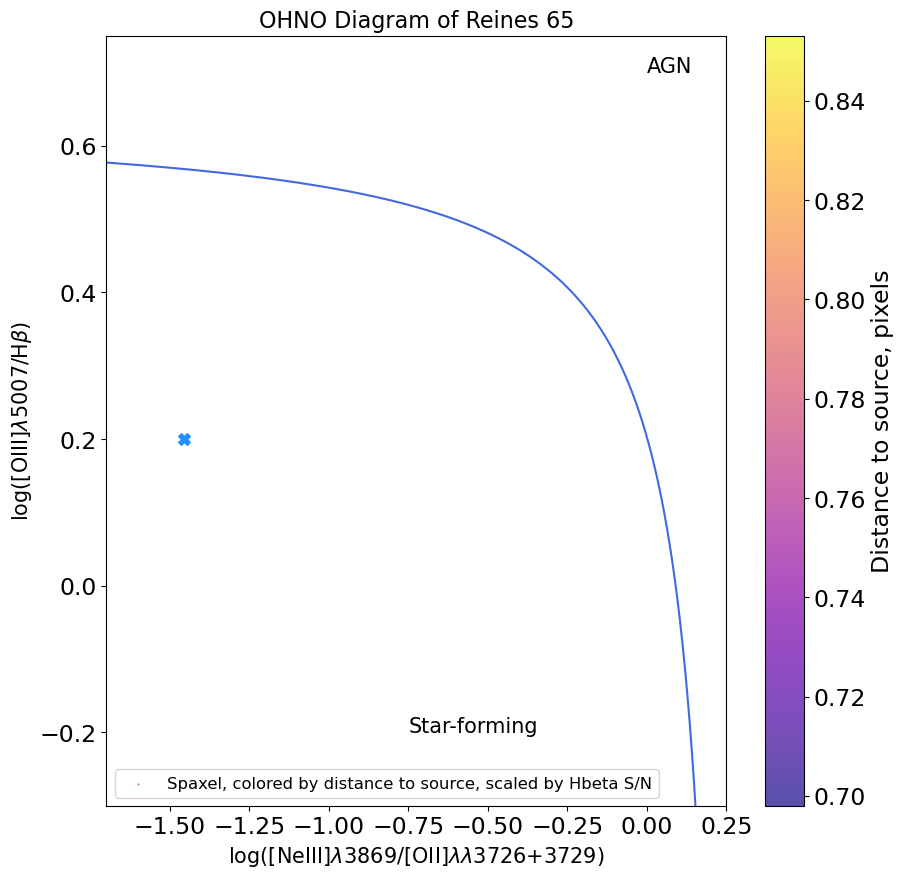

In [179]:
flux_dataset = flux_array[:,34:35,28:29]
var_dataset = var_array[:,34:35,28:29]
bin_loc = [.05215174427657,.7737979639778]
OHNO(flux_dataset, var_dataset, 'Hbeta', bin_loc)

Unable to fit Hbeta in spaxel 53, 0. Defaulting to regular markersize.


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:441: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


Unable to fit Hbeta in spaxel 53, 1. Defaulting to regular markersize.


Unable to fit Hbeta in spaxel 57, 1. Defaulting to regular markersize.


/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Unable to fit Hbeta in spaxel 45, 2. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 53, 2. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 57, 2. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 58, 2. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 43, 3. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 53, 3. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 40, 4. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 50, 4. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 56, 4. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 59, 4. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 40, 5. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 41, 5. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 43, 5. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 56, 5. Defaulting to regular markersize.
Unable

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:464: RuntimeWarning: invalid value encountered in log10
  if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:


Unable to fit Hbeta in spaxel 57, 37. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 58, 37. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 59, 37. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 60, 37. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 62, 37. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 65, 37. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 16, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 18, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 21, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 23, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 59, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 60, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 64, 38. Defaulting to regular markersize.
Unable to fit Hbeta in spaxel 65, 38. Defaulting to regular mark

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:483: RuntimeWarning: invalid value encountered in log10
  scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Spaxel, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)


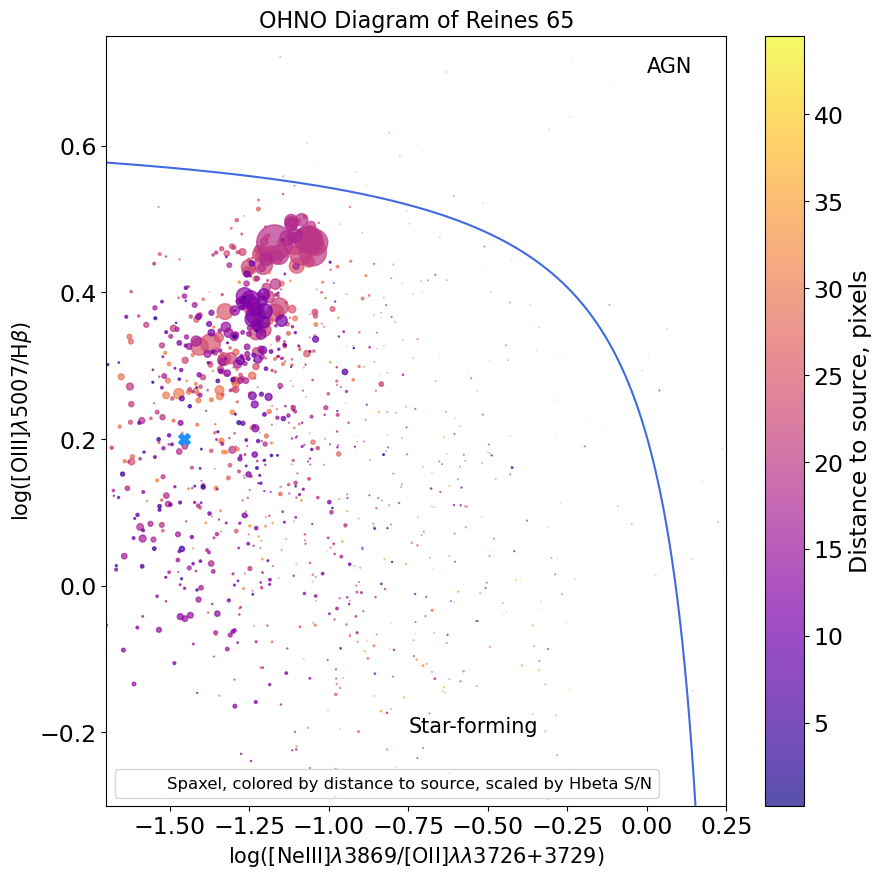

In [180]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [38.05215174427657,39.7737979639778]
OHNO(flux_dataset, var_dataset, 'Hbeta', bin_loc)
plt.savefig('OHNO_hbeta.png')


Unable to fit OIII5007 in spaxel 53, 0. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 57, 0. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 58, 0. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 49, 1. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 53, 1. Defaulting to regular markersize.


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:441: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


Unable to fit OIII5007 in spaxel 57, 1. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 58, 1. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 53, 2. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 57, 2. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 58, 2. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 53, 3. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 56, 3. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 57, 3. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 45, 4. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 48, 4. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 57, 4. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 58, 4. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 60, 4. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 44, 5

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:464: RuntimeWarning: invalid value encountered in log10
  if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:


Unable to fit OIII5007 in spaxel 63, 37. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 64, 37. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 12, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 17, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 19, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 58, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 59, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 64, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 65, 38. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 17, 39. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 19, 39. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 21, 39. Defaulting to regular markersize.
Unable to fit OIII5007 in spaxel 54, 39. Defaulting to regular markersize.
Unable to fit OIII5007 in

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:483: RuntimeWarning: invalid value encountered in log10
  scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Spaxel, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)


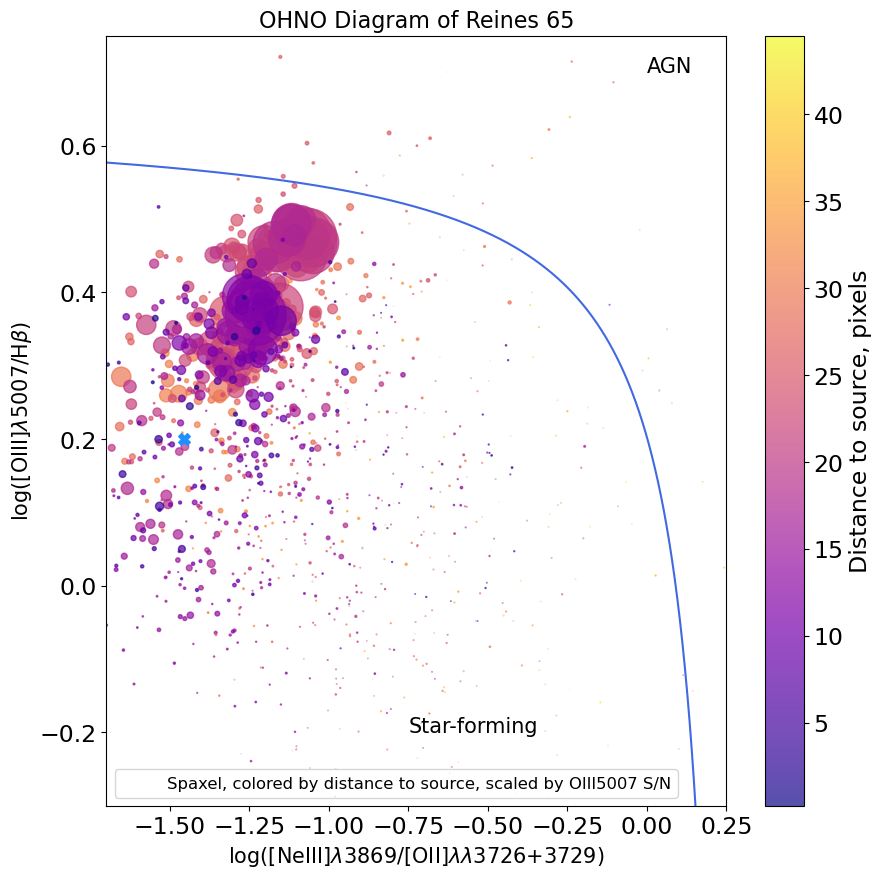

In [181]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [38.05215174427657,39.7737979639778]
OHNO(flux_dataset, var_dataset, 'OIII5007', bin_loc)
plt.savefig('OHNO_OIII.png')

Unable to fit OII3727 in spaxel 57, 0. Defaulting to regular markersize.


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:441: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


Unable to fit OII3727 in spaxel 57, 1. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 57, 2. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 57, 3. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 48, 5. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 35, 6. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 36, 6. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 55, 6. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 36, 7. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 37, 7. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 40, 7. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 56, 7. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 71, 7. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 38, 8. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 40, 8. Defaulting t

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:464: RuntimeWarning: invalid value encountered in log10
  if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:


Unable to fit OII3727 in spaxel 61, 37. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 62, 37. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 64, 37. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 65, 37. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 62, 38. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 64, 38. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 59, 39. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 64, 39. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 59, 40. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 60, 40. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 51, 41. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 52, 41. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 57, 41. Defaulting to regular markersize.
Unable to fit OII3727 in spaxel 44, 42

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:483: RuntimeWarning: invalid value encountered in log10
  scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Spaxel, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)


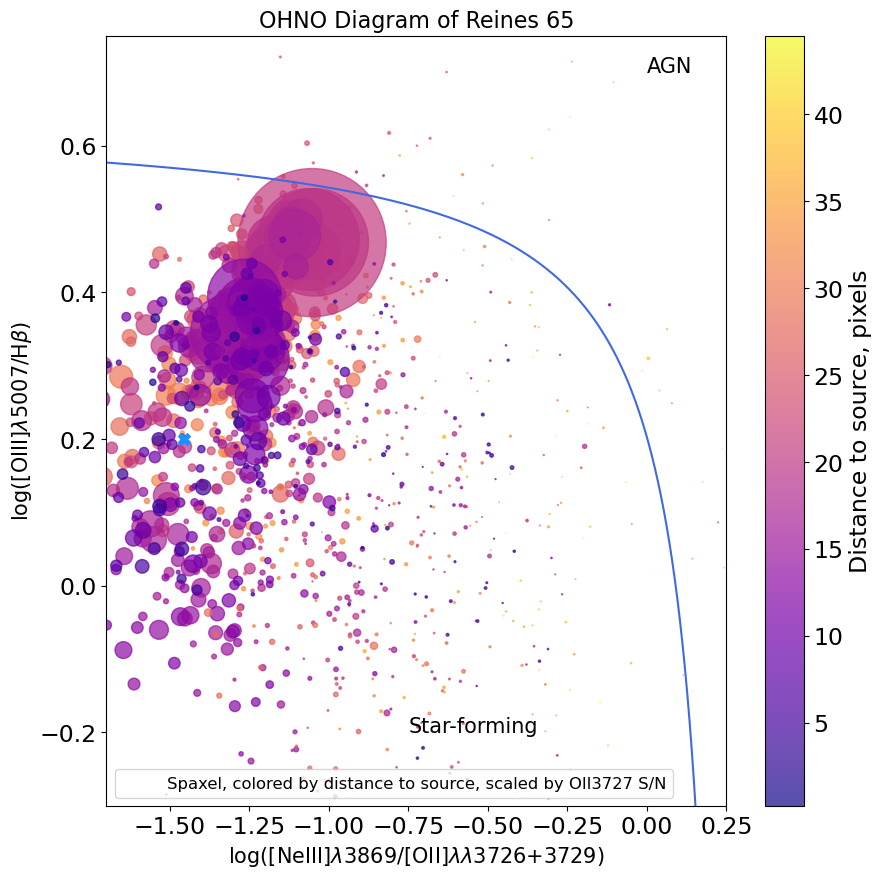

In [182]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [38.05215174427657,39.7737979639778]
OHNO(flux_dataset, var_dataset, 'OII3727', bin_loc)
plt.savefig('OHNO_OII.png')

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:441: RuntimeWarning: divide by zero encountered in divide
  size = abs((signal / noise)[0])


Unable to fit NeIII3869 in spaxel 53, 1. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 45, 2. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 53, 2. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 42, 3. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 49, 3. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 53, 3. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 40, 4. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 46, 4. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 59, 4. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 41, 5. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 46, 5. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 52, 5. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 56, 5. Defaulting to regular markersize.
Unable to fit NeIII3869 i

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:464: RuntimeWarning: invalid value encountered in log10
  if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:


Unable to fit NeIII3869 in spaxel 32, 37. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 33, 37. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 41, 37. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 55, 37. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 58, 37. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 65, 37. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 18, 38. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 19, 38. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 21, 38. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 24, 38. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 28, 38. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 31, 38. Defaulting to regular markersize.
Unable to fit NeIII3869 in spaxel 32, 38. Defaulting to regular markersize.
Unable to fi

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_5887/2143118940.py:483: RuntimeWarning: invalid value encountered in log10
  scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Spaxel, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)


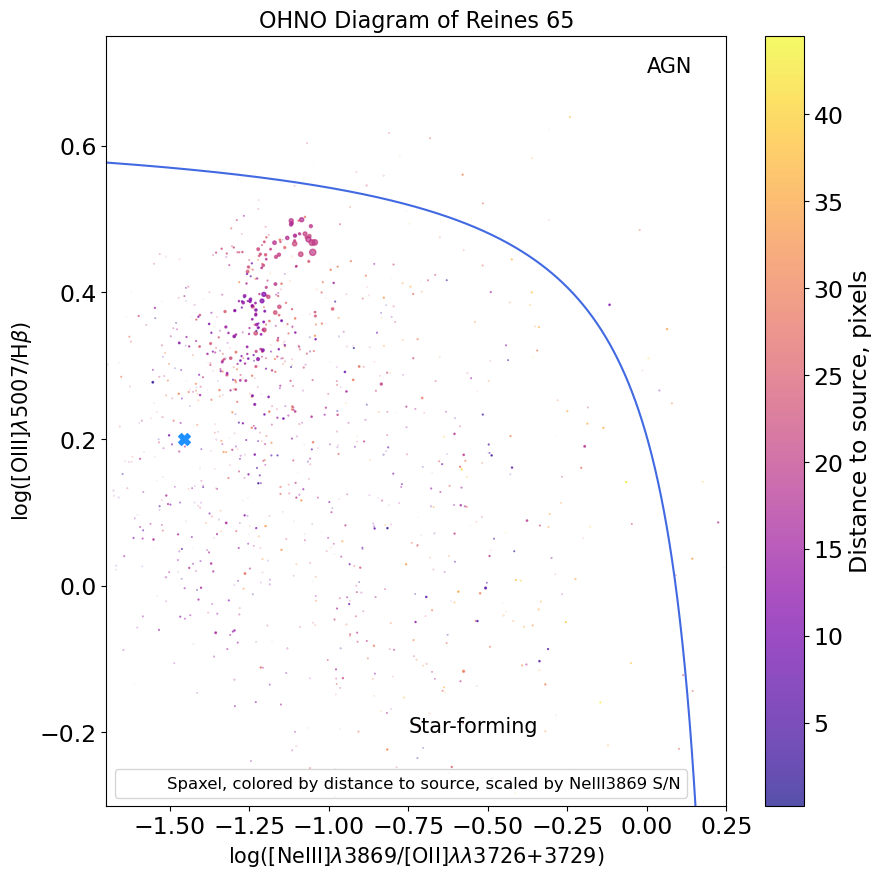

In [183]:
flux_dataset = flux_array[:,:,:]
var_dataset = var_array[:,:,:]
bin_loc = [38.05215174427657,39.7737979639778]
OHNO(flux_dataset, var_dataset, 'NeIII3869', bin_loc)
plt.savefig('OHNO_neIII.png')

#### Spaxel emission line testing

Fitting Gaussian models to lines...
Spaxel [39,38]
[4863.75096733]
[2.15859477]
[0.9166708]
[5009.4203963]
[2.22324473]
[0.94412511]
[3730.94381128]
[1.65584049]
[0.70317072]
['Hbeta', array([1234]), array([4863.75096733]), 0.002886942952166738, array([2.15859477]), array([0.9166708]), array([-2.40096733])]
['OIII5007', array([1367]), array([5009.4203963]), 0.0073562460619305235, array([2.22324473]), array([0.94412511]), array([-2.6203963])]
['OII3727', array([39]), array([3730.94381128]), 0.006717864840564341, array([1.65584049]), array([0.70317072]), array([-3.62381128])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/1305345477.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/1305345477.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4863.4182778663435, 0.0031764933995096153, 1.1229742102446698, 5.288804360673896, 5, array([0.33268946]), <Gaussian1D(amplitude=0.00317649, mean=4863.41827787, stddev=1.12297421)>], ['OIII5007', 5009.21950485927, 0.007830026264466921, 1.0398469401111272, 4.897304836675559, 5, array([0.20089144]), <Gaussian1D(amplitude=0.00783003, mean=5009.21950486, stddev=1.03984694)>], ['OII3727', 3729.7017591365193, 0.006612404441403495, 2.1530118454616045, 10.139910901764125, 13, array([1.24205214]), <Gaussian1D(amplitude=0.0066124, mean=3729.70175914, stddev=2.15301185)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
left wvl:  4845.2031895440405
[0.00018087]
left wvl:  4846.279617035937
[-1.41112833e-05]
left wvl:  4847.356283393956
[0.0001458]
left wvl:  4848.433188671113
[-0.00025577]
left wvl:  4849.510332920434
[5.31005873e-05]
left wvl:  4850.58771619493
[0.00014677]
left wvl:  4851.665338547645
[0.00034025]
left wvl:  4852.743200031646
[

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3521086559.py:183: RuntimeWarning: invalid value encountered in sqrt
  n_p = np.sqrt(flux_em).T


Calculating the noise of OIII5007...
noise
0.0019946084269670664
Calculating the signal of OII3727...
left wvl:  3693.7820652194237
[-0.00018761]
left wvl:  3694.604127873585
[-0.00018761]
left wvl:  3695.426372948697
[-0.00018761]
left wvl:  3696.24880048524
[-0.00018761]
left wvl:  3697.07141052371
[-0.00018761]
left wvl:  3697.8942031045913
[-0.00018761]
left wvl:  3698.7171782683986
[-0.00018761]
left wvl:  3699.540336055648
[-0.00018761]
left wvl:  3700.363676506865
[-0.00018761]
left wvl:  3701.1871996625837
[0.00033874]
left wvl:  3702.0109055633475
[0.0007772]
left wvl:  3702.8347942497153
[0.00099223]
left wvl:  3703.6588657622415
[0.00070882]
left wvl:  3704.4831201414904
[-9.16544299e-06]
left wvl:  3705.307557428047
[0.00064672]
left wvl:  3706.1321776625005
[0.00095763]
left wvl:  3706.9569808854476
[0.00095481]
left wvl:  3707.781967137495
[0.00058766]
left wvl:  3708.6071364592644
[0.00035033]
left wvl:  3709.4324888913607
[0.00045733]
left wvl:  3710.2580244744363
[0.00

[array([0.24579972]), array([0.09516084]), array([1.68980315])]

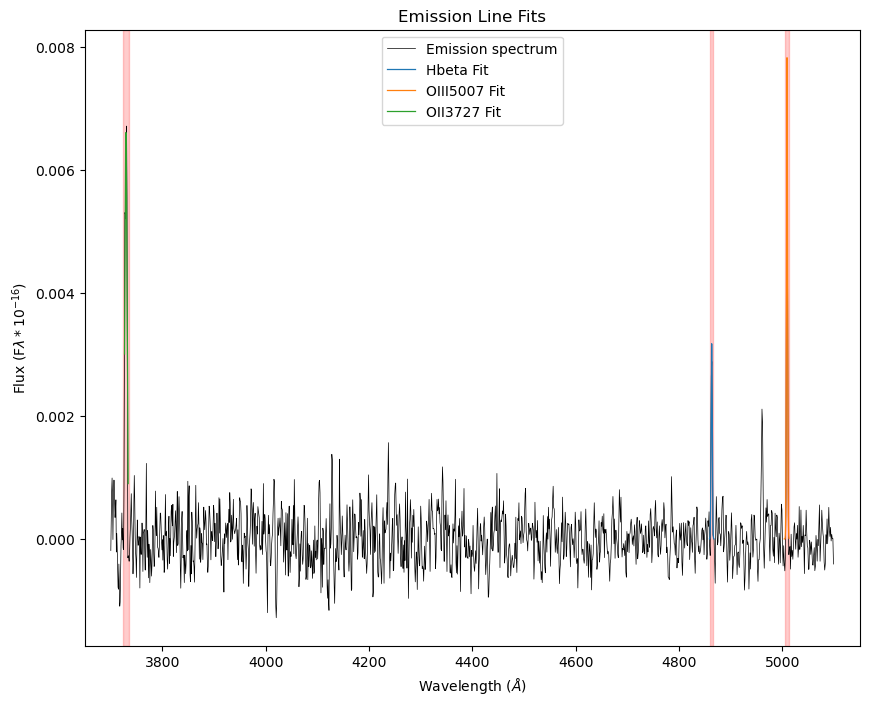

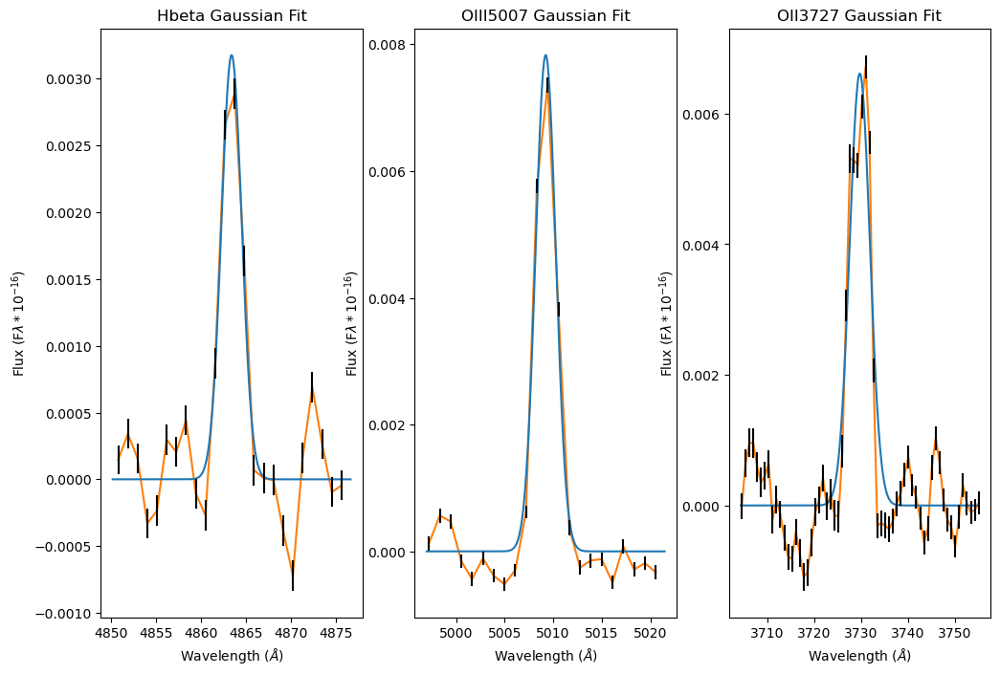

In [540]:
calculate_SN('Data', ['Hbeta', 'OIII5007', 'OII3727'], spaxel_coords_y = 38, spaxel_coords_x = 39, makeplots = True)

Fitting Gaussian models to lines...


Spaxel [39,38]
[3730.94381128]
[['OII3727', 3729.718283467804, 0.006767140419456874, 2.028082045712841, 9.551536508423943, 12, -2.398283467804049, <Gaussian1D(amplitude=0.00676714, mean=3729.71828347, stddev=2.02808205)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3727...
Flux sum:
[0.04115166]
Continuum flux mean:
0.0002171407343150049
Calculating the noise of OII3727...
noise
nan


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/764648011.py:181: RuntimeWarning: invalid value encountered in sqrt
  n_p = np.sqrt(flux_em).T


[array([nan])]

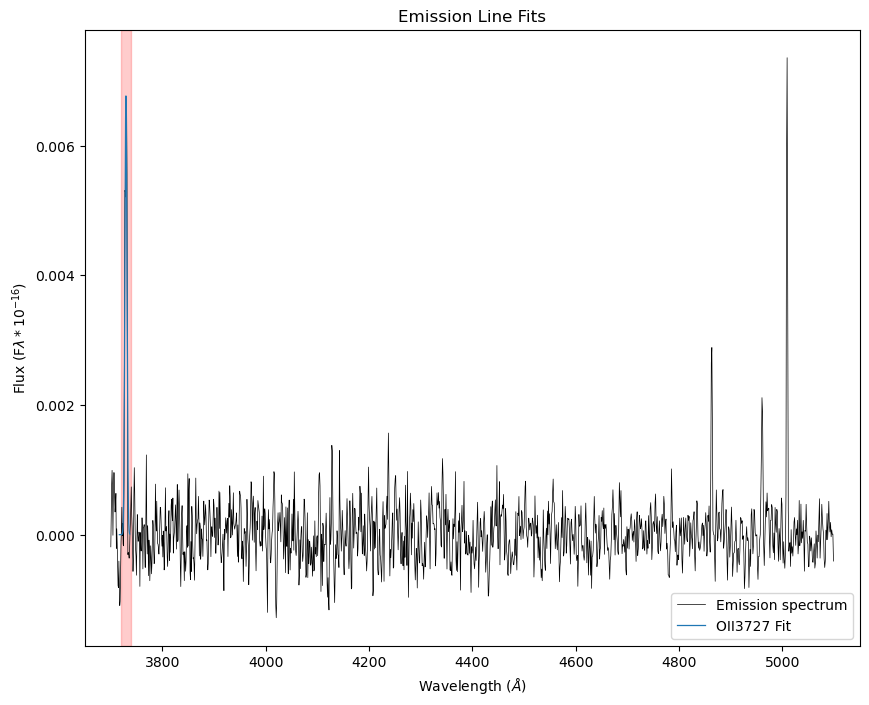

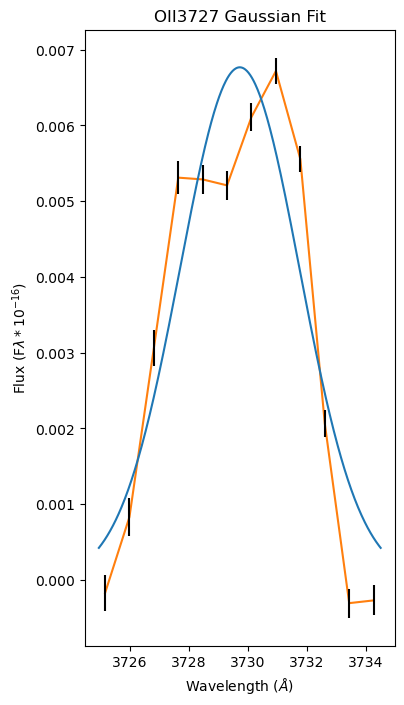

In [370]:
calculate_SN('Data', ['OII3727'], spaxel_coords_y = 38, spaxel_coords_x = 39, makeplots = True)

Fitting Gaussian models to lines...


Spaxel [27,73]
[3720.19754812]
[1.65107117]
[0.70114537]
['OII3727', array([26]), array([3720.19754812]), 0.0011534610039018605, array([1.65107117]), array([0.70114537]), array([7.12245188])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2021919962.py:62: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/2021919962.py:63: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['OII3727', array([3720.19754812]), 0.0011534610039018605, array([0.70114537]), array([3.30214233]), 86, 0, None]]
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3727...
Flux sum:
[0.00579415]
Continuum flux mean:
Calculating the noise of OII3727...
noise
nan
SN: [array([nan])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/1021052169.py:190: RuntimeWarning: invalid value encountered in sqrt
  n_p = np.sqrt(flux_em).T
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/astropy/modeling/fitting.py:830: RuntimeWarning: invalid value encountered in divide
  lacoef /= scl[:, np.newaxis] if scl.ndim < rhs.ndim else scl
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/Eliza/opt/anaconda3/envs/ifu2/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


[array([nan])]

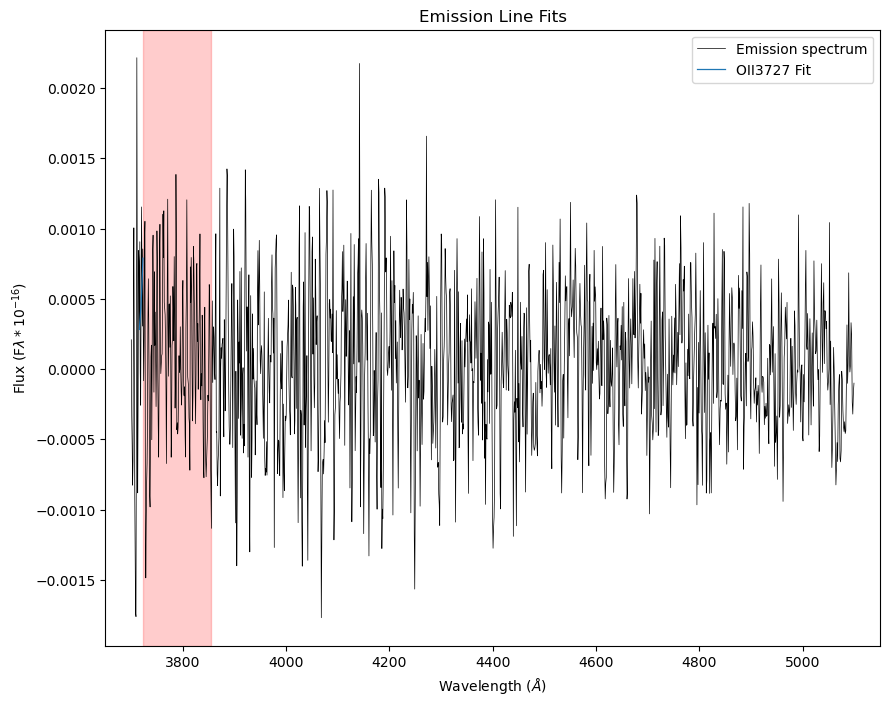

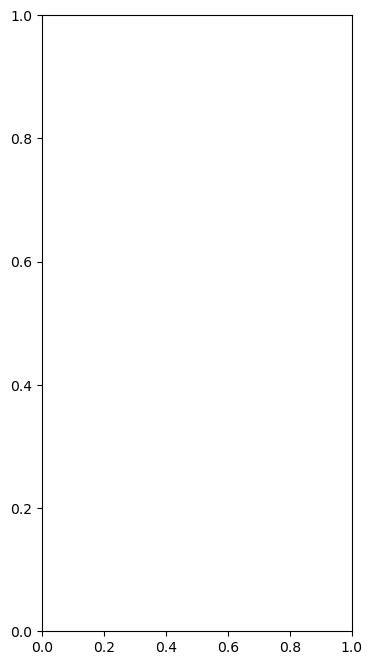

In [716]:
calculate_SN('Data', ['OII3727'], spaxel_coords_y = 73, spaxel_coords_x = 27, makeplots = True)

Fitting Gaussian models to lines...
Spaxel [39,38]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_714/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_714/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['OII3727', 3729.718996697868, 0.006768816938710225, 2.026917145185183, 9.546050246197952, 11, array([1.22481458]), <Gaussian1D(amplitude=0.00676882, mean=3729.7189967, stddev=2.02691715)>], ['OIII5007', 5009.21950485927, 0.007830026264466921, 1.0398469401111272, 4.897304836675559, 5, array([0.20089144]), <Gaussian1D(amplitude=0.00783003, mean=5009.21950486, stddev=1.03984694)>], ['NeIII3869', 3864.8933774403854, 0.0008784916194220843, 0.5161180038493813, 2.4307300421317675, 3, array([0.02450329]), <Gaussian1D(amplitude=0.00087849, mean=3864.89337744, stddev=0.516118)>], ['Hbeta', 4863.4182778663435, 0.0031764933995096153, 1.1229742102446698, 5.288804360673896, 5, array([0.33268946]), <Gaussian1D(amplitude=0.00317649, mean=4863.41827787, stddev=1.12297421)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3727...
Left starting wvl:  3708.0360452475575
Wavelength flux:  [-0.00010569]
Right starting wvl:  3732.35905098978
Flux continuum values:  0.0003

[array([103.51894107]),
 array([59.50045162]),
 array([7.67998437]),
 array([25.79747061])]

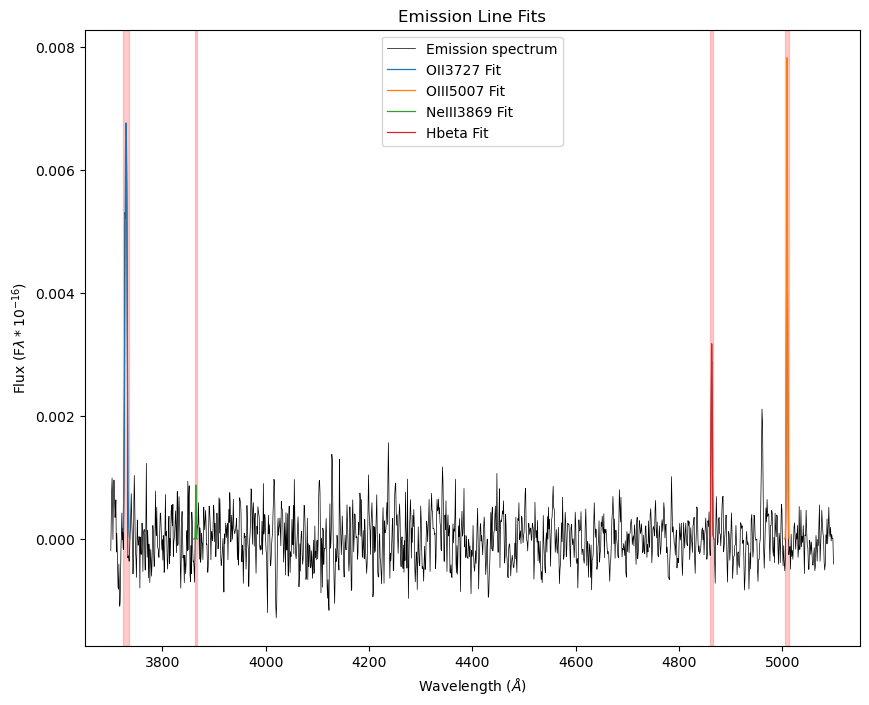

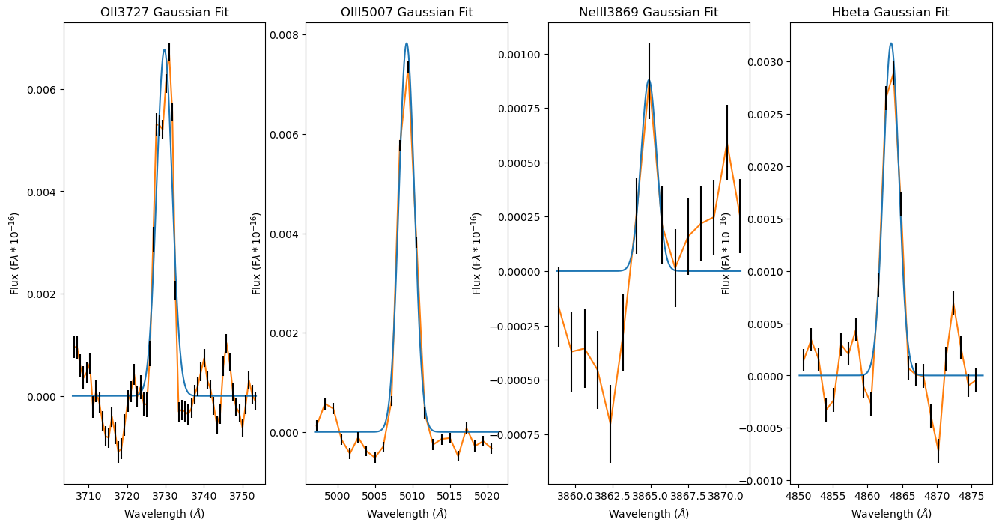

In [77]:
calculate_SN('Data', ['OII3727', 'OIII5007', 'NeIII3869', 'Hbeta'], spaxel_coords_y = 38, spaxel_coords_x = 39, makeplots = True)

[4857.2802096  4858.35807108 4859.43617175 4860.51451166 4861.59309085
 4862.67190939 4863.75096733 4864.83026472 4865.90980161 4866.98957805
 4868.06959411 4869.14984982 4870.23034526 4871.31108046 4872.39205548
 4873.47327038 4874.55472521 4875.63642002]


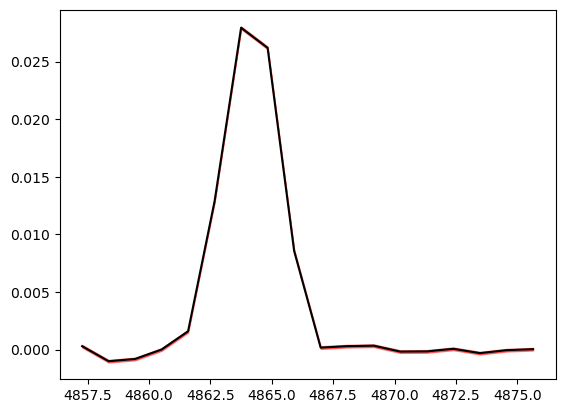

[1.1660487427223463e-07,
 1.2385069390457887e-07,
 1.163064002987988e-07,
 1.0567048637665073e-07,
 1.0019865589653935e-07,
 1.0596342979479783e-07,
 1.1834907179038892e-07,
 1.306352610462328e-07,
 1.4202076883097397e-07,
 1.45303366168999e-07,
 1.3863102219332513e-07,
 1.267922812351339e-07,
 1.2433561105711506e-07,
 1.2681720496118444e-07,
 1.2105331515031875e-07,
 1.1582942136145243e-07,
 1.1416449554512845e-07,
 1.0669313718308728e-07,
 1.0581226723563998e-07,
 1.1577970410460163e-07,
 1.235024620774364e-07,
 1.2104137774986402e-07,
 1.1664647691196999e-07,
 1.2313087066526473e-07,
 1.2559840723213624e-07,
 1.1697829261575424e-07,
 1.1338593555064946e-07,
 1.4129023128450392e-07,
 1.890521174543659e-07,
 2.0020182246382886e-07,
 2.05620079853996e-07,
 2.3593746521687047e-07,
 2.2181860288434228e-07,
 1.566283866974018e-07,
 1.1001411378386923e-07,
 9.895780858355204e-08,
 9.271556250999991e-08,
 8.823560698674024e-08,
 8.559869579724781e-08,
 9.366935071364873e-08,
 1.017810960802

In [116]:
hbeta_wvl = single_wvl_array[np.where((single_wvl_array <= 4876.35) & (single_wvl_array >= 4856.35))]
print(hbeta_wvl)
fluxtest = spaxel_flux[np.where((single_wvl_array <= 4876.35) & (single_wvl_array >= 4856.35))]
vartest = spaxel_var[np.where((single_wvl_array <= 4876.35) & (single_wvl_array >= 4856.35))]

plt.plot(hbeta_wvl, fluxtest, 'k-')
plt.fill_between(hbeta_wvl, fluxtest - np.sqrt(vartest), fluxtest + np.sqrt(vartest), color='r', alpha=0.5)
plt.show()

np.sum(fluxtest)/np.sqrt(np.sum(vartest))
var_array[:,36,26].tolist()

Fitting Gaussian models to lines...
Spaxel [18,39]
[4863.75096733]
[4.31766855]
[1.83354501]
['Hbeta', array([1235]), array([4863.75096733]), 0.0011309360690803876, array([4.31766855]), array([1.83354501]), array([-2.40096733])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3671494080.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3671494080.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4864.294791168445, 0.0010383385670846201, 1.6043446506146124, 7.5558858848109285, 7, array([-0.54382384]), <Gaussian1D(amplitude=0.00103834, mean=4864.29479117, stddev=1.60434465)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
left wvl:  4853.571367600198
[-0.00014826]
left wvl:  4854.65018614008
[1.62911669e-05]
left wvl:  4855.729244076682
[-3.44524567e-05]
left wvl:  4856.80854146313
[-0.00017502]
left wvl:  4857.888078352547
[-0.00022742]
left wvl:  4858.9678547981
[-5.06571393e-06]
left wvl:  4860.047870852947
[-0.00022815]
Flux sum:
[0.00313852]
Continuum flux mean:
0.00016557590215803063
Calculating the noise of Hbeta...
noise
0.00017335109210319923
SN: [array([18.10497671])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/1287830901.py:182: RuntimeWarning: invalid value encountered in sqrt
  n_p = np.sqrt(flux_em).T


[array([18.10497671])]

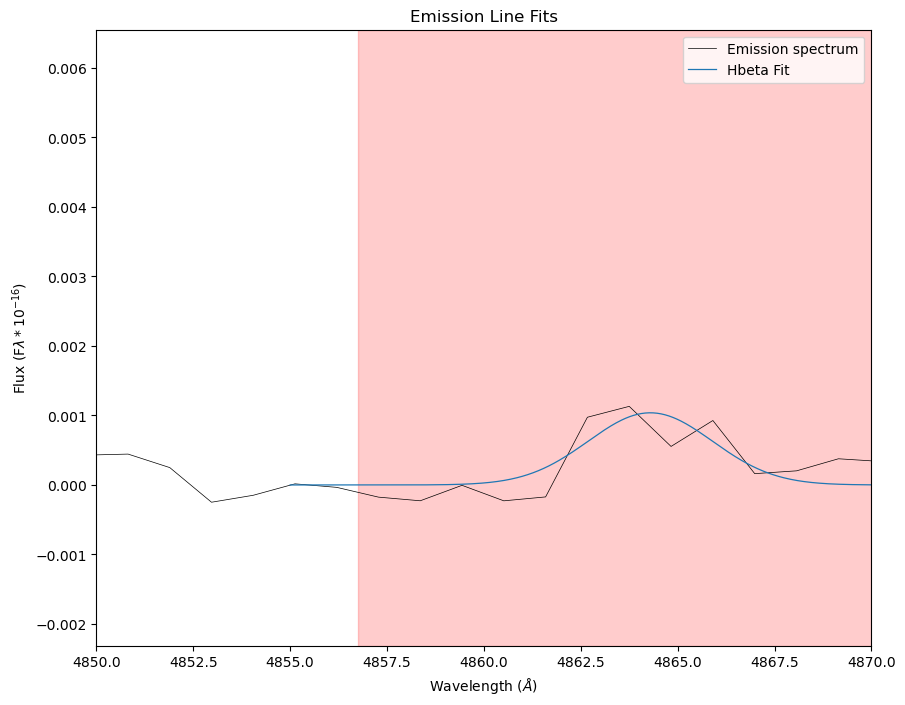

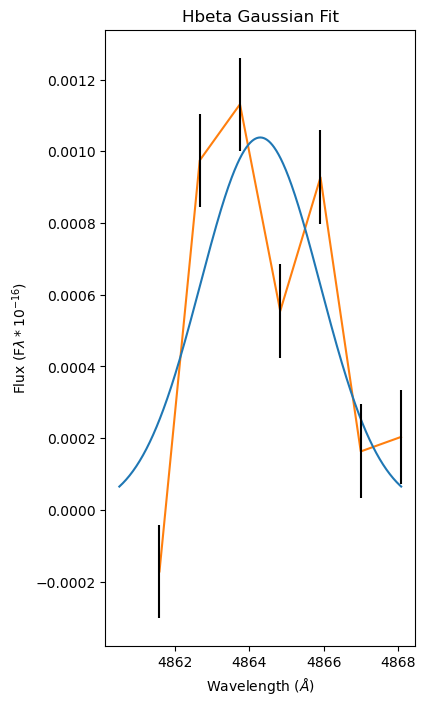

In [519]:
#Gaussian fit for high SN spaxel (39 18 : sn:  2375.6675397129607)
calculate_SN('Data', ['Hbeta'], 39, 18, [4850,4870], makeplots = True)

Fitting Gaussian models to lines...
Spaxel [22,65]
[4861.59309085]


[['Hbeta', 4861.741014942333, 0.0010203910733793157, 1.0006043610763737, 4.7124864132160615, 4, -0.39101494233273115, <Gaussian1D(amplitude=0.00102039, mean=4861.74101494, stddev=1.00060436)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
left wvl:  4854.433149945833
[0.00018215]
left wvl:  4855.511489851607
[0.00024282]
left wvl:  4856.590069047889
[-0.00025431]
left wvl:  4857.668887587772
[-0.00035224]
left wvl:  4858.747945524374
[4.15107902e-05]
Flux sum:
[0.00215197]
Continuum flux mean:
9.107722772898276e-05
Calculating the noise of Hbeta...
noise
0.00016850943833335205
SN: [array([12.77060623])]


[array([12.77060623])]

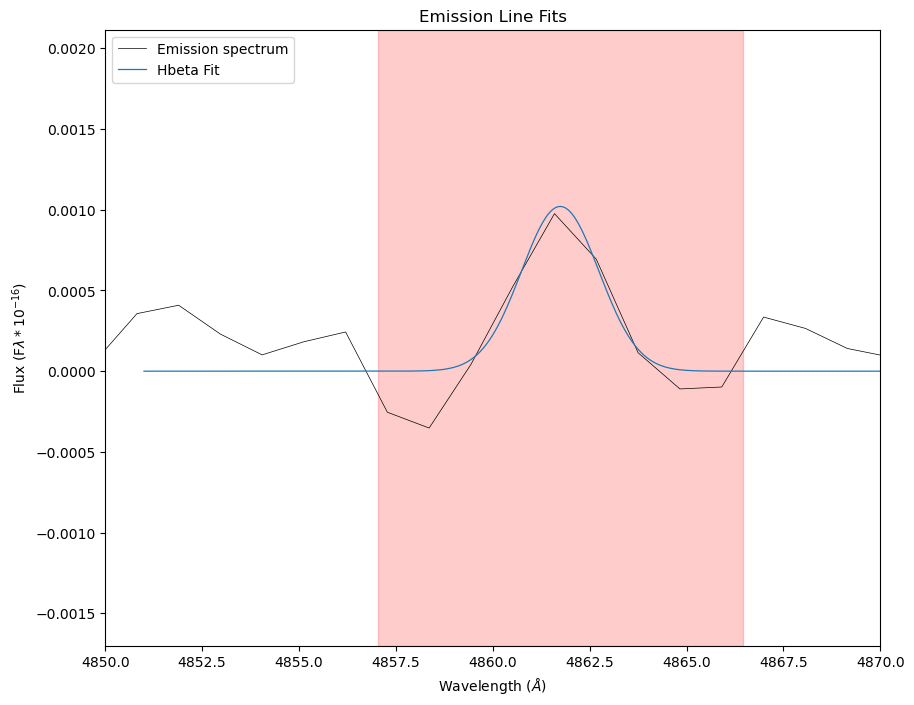

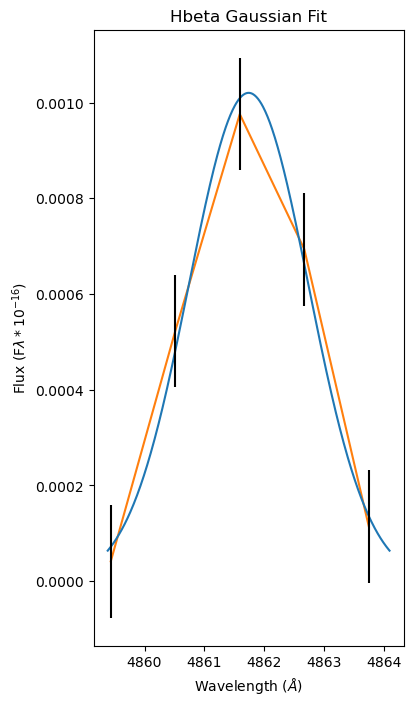

In [378]:
#Gaussian fit for high SN spaxel (65 22 : sn:  11242.845397999248)
calculate_SN('Data', ['Hbeta'], 65, 22, [4850,4870], makeplots = True)

Fitting Gaussian models to lines...


Spaxel [26,52]
[4861.59309085]
[4.31575295]
[1.83273153]
['Hbeta', array([1233]), array([4861.59309085]), 0.0009762131550906448, array([4.31575295]), array([1.83273153]), array([-0.24309085])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3671494080.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3671494080.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['Hbeta', 4862.2645574951885, 0.0010978373750275673, 1.0094081183204173, 4.753948941275782, 5, array([-0.67146664]), <Gaussian1D(amplitude=0.00109784, mean=4862.2645575, stddev=1.00940812)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of Hbeta...
left wvl:  4855.467471065386
[0.00058912]
left wvl:  4856.546050261669
[8.93199827e-05]
left wvl:  4857.624868801551
[0.00017084]
left wvl:  4858.703926738153
[-0.00015114]
Flux sum:
[0.00189748]
Continuum flux mean:
5.1189266355210986e-05
Calculating the noise of Hbeta...
noise
0.00013918248196849025
SN: [array([13.63303925])]


[array([13.63303925])]

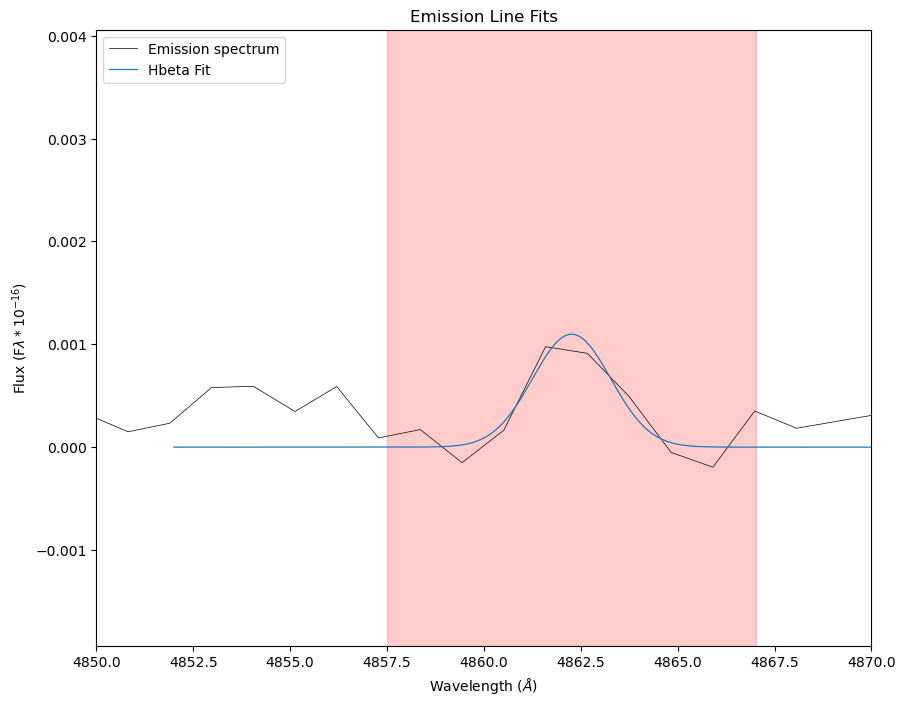

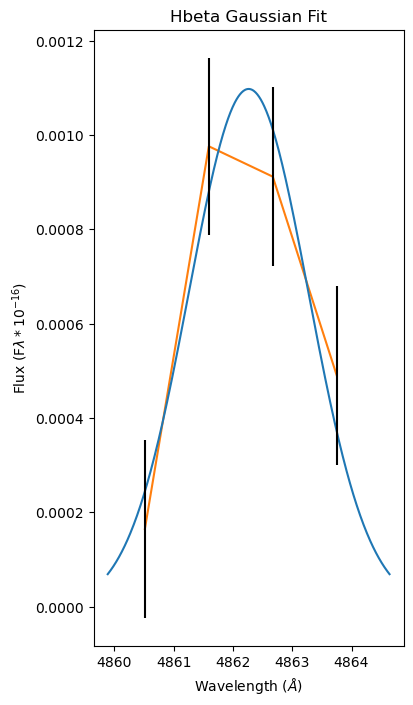

In [513]:
#Gaussian fit for high SN spaxel (52 26 : sn:  1707.9207875772072)
calculate_SN('Data', ['Hbeta'], 52, 26, [4850,4870], makeplots = True)

Fitting Gaussian models to lines...
Spaxel [14,73]
[5010.53201866]
0
0.0
['OIII5007', array([1366]), array([5010.53201866]), -4.998242268445629e-06, 0, 0.0, array([-3.73201866])]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3671494080.py:68: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_22793/3671494080.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


0

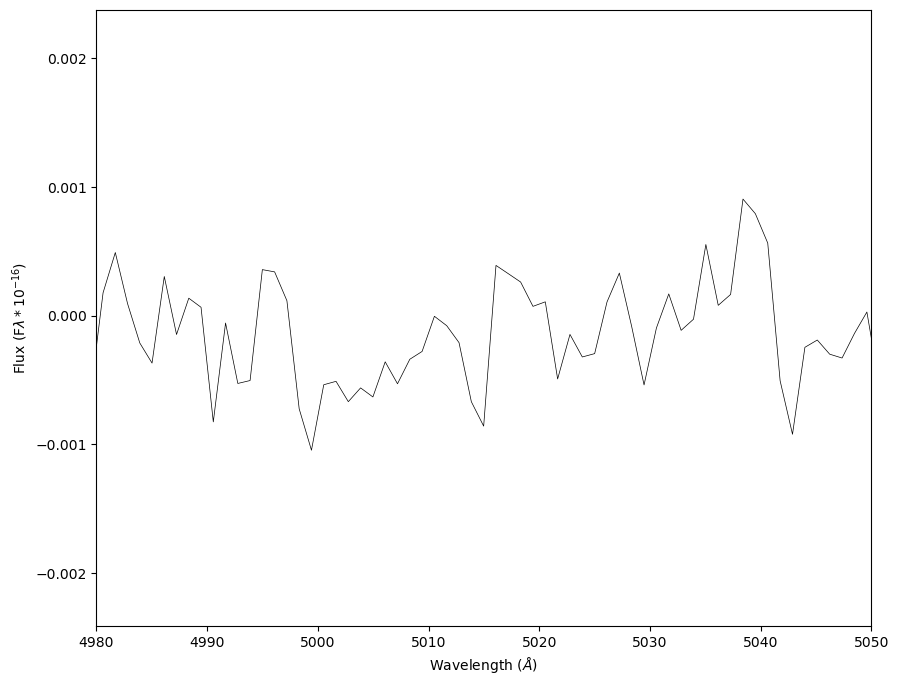

In [512]:
calculate_SN('Data', ['OIII5007'], 73, 14, [4980,5050], makeplots = True)


Fitting Gaussian models to lines...
Spaxel [18,74]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_714/3162315216.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_714/3162315216.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['NeIII3869', 3861.114635553974, 0.003777856483817821, 0.7795194323845857, 3.67125596974074, 5, array([0.37454771]), <Gaussian1D(amplitude=0.00377786, mean=3861.11463555, stddev=0.77951943)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of NeIII3869...
Left starting wvl:  3853.386410926401
Wavelength flux:  [0.00153131]
Right starting wvl:  3862.7406441150156
Flux continuum values:  -0.0002115807997326736 -0.0001566209388060419
Left starting wvl:  3854.242539850353
Wavelength flux:  [0.00046087]
Right starting wvl:  3863.5967730389675
Flux continuum values:  8.879955060352835e-05 -0.00030219700102966705
Left starting wvl:  3855.0988587547718
Wavelength flux:  [0.00098884]
Right starting wvl:  3864.4530919433864
Flux continuum values:  0.0001187670287314882 nan
Left starting wvl:  3855.955367681828
Wavelength flux:  [0.00296324]
Right starting wvl:  3865.309600870443
Flux continuum values:  -7.339572404525233e-05 nan
Left starting wvl:  3856.812066673669

/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_714/3705364789.py:156: RuntimeWarning: Mean of empty slice
  print(np.nanmean([fc_1, fc_2]))


Calculating the continuum noise around NeIII3869...
noise
7.283313798240381e-05
SN: [array([141.32507819])]


[array([141.32507819])]

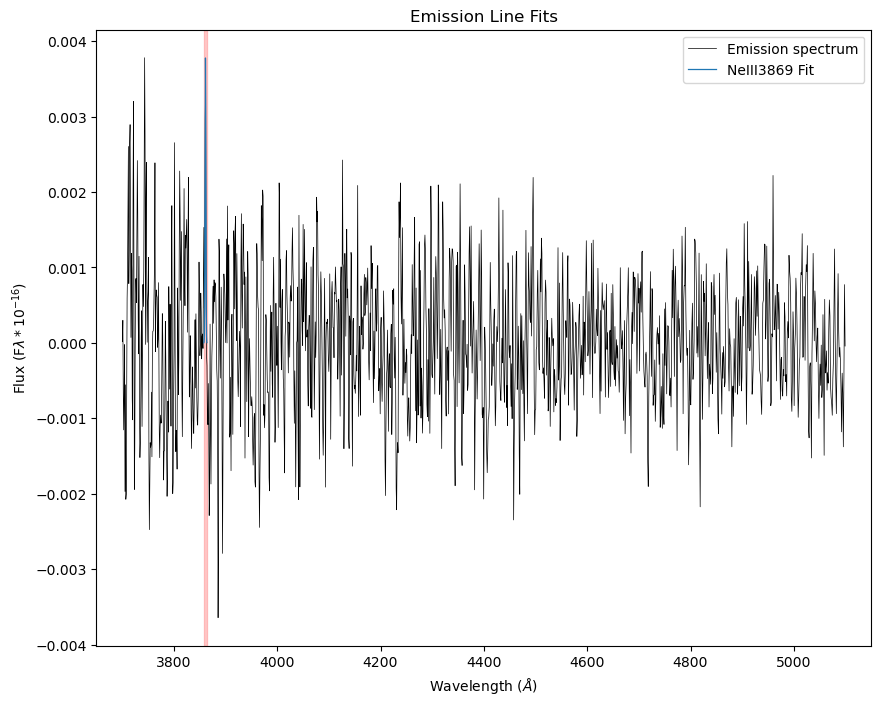

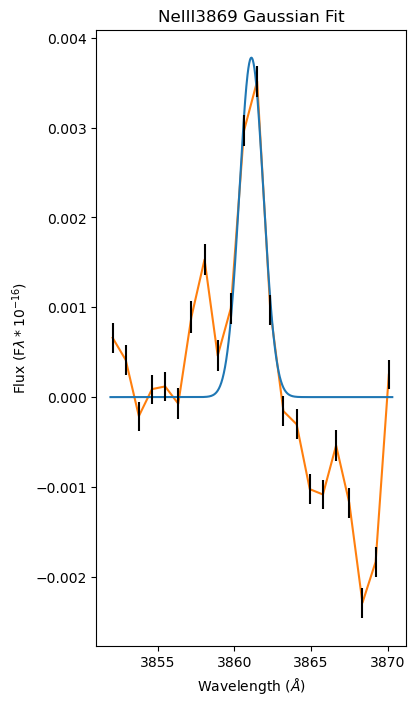

In [29]:
calculate_SN('Data', ['NeIII3869'], 74, 18, makeplots = True)

Fitting Gaussian models to lines...
Spaxel [11,62]


/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3090613136.py:59: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_min = int(central_wvl - 2*fwhm)
/var/folders/4q/qrrm0v295m56rfc1y_784n540000gn/T/ipykernel_1027/3090613136.py:60: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  wvl_max = int(central_wvl + 2*fwhm)


[['OII3727', 3728.8576768027883, 0.00452992109375131, 0.20781347194117802, 0.9787266587091256, 1, array([-0.39652435]), <Gaussian1D(amplitude=0.00452992, mean=3728.8576768, stddev=0.20781347)>]]
Calculating signal to noise ratio of the emission...
Calculating the signal of OII3727...
Left starting wvl:  3727.2142716205467
Wavelength flux:  [0.00073369]
Right starting wvl:  3729.708033283841
Flux continuum values:  -0.00017653994125614917 0.00014955758175628987
Left starting wvl:  3728.04164095018
Wavelength flux:  [0.00052812]
Right starting wvl:  3730.535402613474
Flux continuum values:  0.0007336881907095124 -0.00010400568110552734
Signal:
[0.00096046]
Continuum flux mean:
0.00031484125480199255
Calculating the continuum noise around OII3727...
noise
6.119237061508187e-16
SN: [0]


[0]

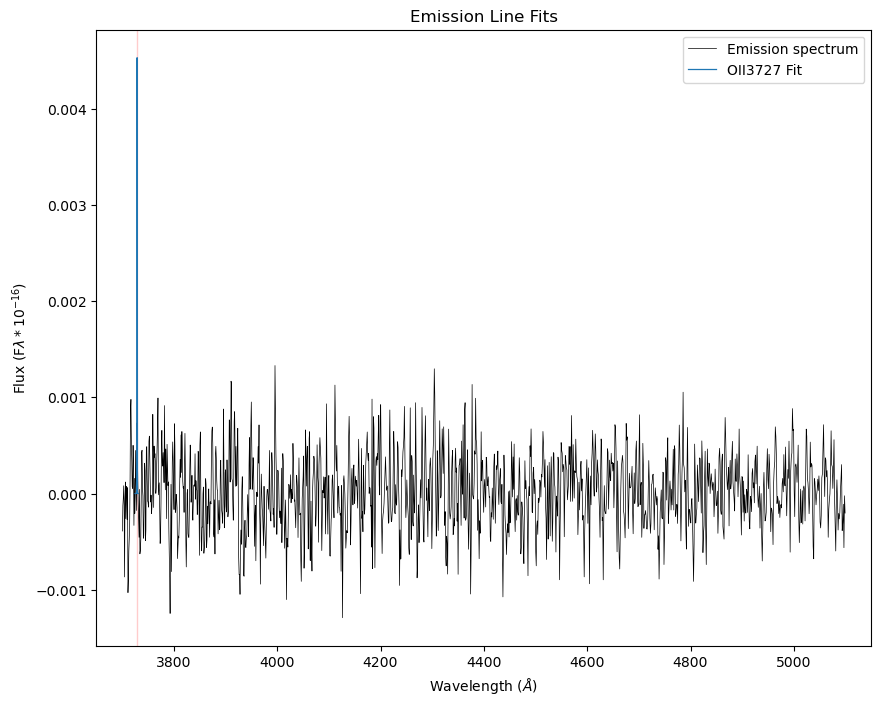

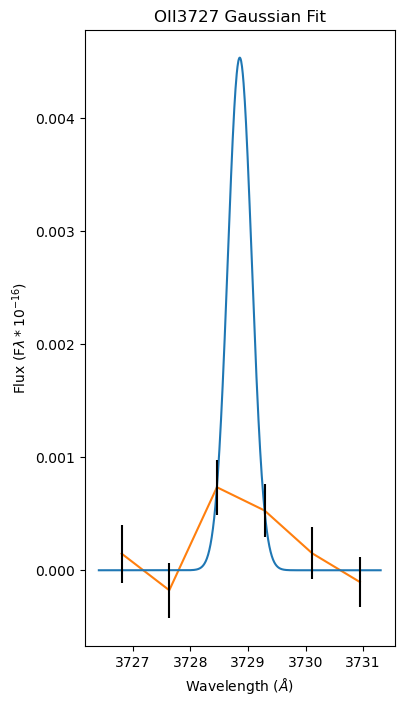

In [337]:
calculate_SN('Data', ['OII3727'], 62, 11, makeplots = True)

### Pipeline versions of functions

In [165]:
#Pipeline version of Gaussian Fit
def Gaussian_Fit(self, spaxel_flux, linenames, spaxel_coords_y = 0, spaxel_coords_x = 0, makeplots = False):
    """
    Inputs: 
    spaxel_flux (list: 1D array) - flux spectrum in a single spaxel
    linenames (list) - name(s) of emission line(s) to fit gaussians to
    spaxel_coords_y (int), spaxel_coords_x (int) - y and x coordinates of chosen spaxel 
    makeplots (bool) - Flag to make emission line model plots

    Outputs -> list of linename, wavelength, flux, stddev, and redshift for each emline:
    linename (str) - name of line that was modeled
    wavelength (float) - wavelength value of model max
    flux (float) - max flux value of model
    stddev (float) - standard deviation of emission line fit
    width (float) - width of line
    N (int) - number of pixels in line width 
    shift (float) - red or blue shift compared with expected wavelength, redshift if negative, blueshift if positive
    g (array) - gaussian model(s) of emission line(s)

    Calls estimate function to estimate location and flux of each emission line, fits gaussian curves to each emission line, returns wavelength and flux of peak.
    """

    #Define an array and fill it with wvl and flux data
    arr_len = len(spaxel_flux)
    spaxel_arr = np.zeros((2,arr_len))
    spaxel_arr[0] = self.wvl_zcorr
    spaxel_arr[1] = spaxel_flux

    #Set up figure 
    if makeplots:
        plt.figure(figsize=(10,8))
        plt.plot(self.wvl_zcorr, spaxel_flux, label = 'Emission spectrum', color = 'black', linewidth = .5)
        plt.xlabel('Wavelength ($\AA$)')
        plt.ylabel('Flux (F$\lambda*10^{-16}$)')
        
    #Estimate = [[line, line_loc, line_wvl, line_flux, N, shift],...]
    estimate = self.Estimate_Emline(spaxel_flux, linenames, makeplots)
    outlist = []

    #Set up fitter
    fitter = fitting.LevMarLSQFitter()
    
    #Find each line
    for line in estimate:

        #Lookup wvl from linename & select range
        central_wvl = wvldict[line[0]]
        wvl_min = int(central_wvl - 10)
        wvl_max = int(central_wvl + 10)

        wvl_range = spaxel_arr[0][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]
        flux_range = spaxel_arr[1][np.where((spaxel_arr[0] >= wvl_min) & (spaxel_arr[0] <= wvl_max))]

        #Generate model 
        g_model = models.Gaussian1D(amplitude = line[3], mean = line[2], stddev = line[5])
        
        #if makeplots:
            #plt.plot(spaxel_wvl, g_model(spaxel_wvl), label = 'Initial Guess', linewidth = .5)

        #Fit data
        try:
            g = fitter(g_model, wvl_range, flux_range)

            #Wavelengths for plotting
            wvl_sample = np.linspace(wvl_min, wvl_max, num = 500)

            #Calculate width of line and count number of pixels
            width = 2*(g.fwhm)
            N = len(spaxel_arr[0][np.where((spaxel_arr[0] >= (central_wvl - width/2)) & ((spaxel_arr[0] <= (central_wvl + width/2))))])
            
            #Red/blueshift (blue if positive, red if negative)
            shift = central_wvl - g.mean[0]

            #Plot gaussian fit for emission line
            if makeplots:
                plt.plot(wvl_sample, g(wvl_sample), label = line[0] + ' Fit', linewidth = .9)
                #Line region 
                plt.axvspan(xmin = (g.mean[0] - width), xmax = (g.mean[0] + width), color = 'red', alpha=0.2)
            
            #Bad fits
            #if g.stddev[0] > 20: 
            #	print(f'Warning: large standard deviation. Fit of {line[0]} in pixel {spaxel_coords_y}, {spaxel_coords_x} may be unsuccessful.')
            #if g.amplitude[0] < .001:
            #	print(f'Warning: small amplitude. Fit of {line[0]} in pixel {spaxel_coords_y}, {spaxel_coords_x} may be unsuccessful.')
            #Outputs
            outlist.append([line[0], g.mean[0], g.amplitude[0], g.stddev[0], width, N, shift, g])
        
        except: 
            raise TypeError

    #Emission line plot
    if makeplots:
        plt.title(f'Emission Line Fits for Spaxel {spaxel_coords_y}, {spaxel_coords_x}')
        plt.legend()
        plt.savefig('Gaussian_fit_spectrum.png')

    return outlist

In [167]:
#Function to create integrated map, pipeline version
def Integrate_Map(self, linename, ylen = 80, xlen = 67):
    """
    Function creates an integrated flux map of given emline and saves figure. 
    
    Inputs:
    linename (str): name of line to created integrated flux map of.

    Outputs:
    integrated_flux_map (array): color map of integreated emission line flux.
    """  
    #Initialize empty map
    integrated_flux_map = np.zeros([ylen,xlen])

    for y_coord in range(0,ylen):
        for x_coord in range (0,xlen): 

            #check for 0 values in flux and wvl
            if np.max(flux_array[:,y_coord,x_coord]) != 0 and np.max(wvl_array[:,y_coord,x_coord]) != 0:
                
                #get amplitude and stddev of line at spaxel
                g_fit = self.Gaussian_fit('Data', [linename], y_coord, x_coord)[0]
                stddev = g_fit[3]
                amplitude = g_fit[2]

                #fill map
                integrated_flux_map[y_coord,x_coord] = amplitude * stddev * (np.sqrt(2*np.pi))
            
            else:
                integrated_flux_map[y_coord,x_coord] = np.nan

    #Save map
    fits.writeto(linename + '_integrated_flux_Colormap.fits', integrated_flux_map, overwrite = True)
    return integrated_flux_map

In [168]:
#Function to plot Blue diagram, pipeline version
def Plot_Blue(self, flux_dataset, var_dataset, bin_loc = [ycenter, xcenter]): 
    """
    Function takes in a dataset and creates a Blue diagram which plots all bins/spaxels in dataset. 
    It colors the bins by their distance from chosen bin number (bins containing source).
    
    Inputs:
    flux_dataset (3d array): flux cube of spaxels or bins with spectra attached
    var_dataset (3d array): variance cube of spaxels or bins with spectra attached
    bin_loc (index): index of bin to calculate distances to. 
    If none is entered, defaults to luminosity-weighted center. 

    Outputs:
    Blue_diagram: Blue diagram plot containing all spaxels or bins
    """  
    #Check if dimensions of flux and variance arrays match
    assert np.shape(flux_dataset) == np.shape(var_dataset),'Dimensions of flux array must match dimensions of variance array.'
    
    #Set up arrays for x and y values of datapoints
    xvals = []
    yvals = []
    dist = []

    wvl_arr = self.wvl_zcorr
    
    #Loop through bins, measure integrated flux of emlines, get xval and yval for each bin, append to xvals and yvals lists
    y_range = np.shape(flux_dataset)[0]
    x_range = np.shape(flux_dataset)[1]

    for x in range(0,x_range):
        for y in range(0,y_range):
            bin_flux = flux_dataset[y][x]
            bin_var = var_dataset[y][x]
            
            if (np.max(bin_flux) != 0) and (np.max(wvl_arr) != 0):
                
                #get amplitude and stddev of OIII in bin
                OIII_fit = self.Gaussian_Fit('Data', 'OIII5007', y, x)[0]
                OIII_stddev = OIII_fit[3]
                OIII_amplitude = OIII_fit[2]

                #Integrated flux value
                OIII_5007 = OIII_amplitude * OIII_stddev * (np.sqrt(2*np.pi))

                #get amplitude and stddev of OII in bin
                OII_fit = self.Gaussian_Fit('Data', ['OII3727'], y, x)[0]
                OII_stddev = OII_fit[3]
                OII_amplitude = OII_fit[2]

                #Integrated flux value
                OII_3727 = OII_amplitude * OII_stddev * (np.sqrt(2*np.pi))

                #get amplitude and stddev of Hbeta in bin
                Hbeta_fit = self.Gaussian_Fit('Data', ['Hbeta'], y, x)[0]
                Hbeta_stddev = Hbeta_fit[3]
                Hbeta_amplitude = Hbeta_fit[2]

                #Integrated flux value
                Hbeta = Hbeta_amplitude * Hbeta_stddev * (np.sqrt(2*np.pi))
           
            else:
                OIII_5007 = np.nan
                OII_3727 = np.nan
                Hbeta = np.nan
        

            #OIII_5007 = self.Calculate_SN(bin_flux, bin_var, ['OIII5007'], y, x, suppress_output = True)
            #OII_3727 = self.Calculate_SN(bin_flux, bin_var, ['OII3727'], y, x, suppress_output = True)
            #Hbeta = self.Calculate_SN(bin_flux, bin_var, ['Hbeta'], y, x, suppress_output = True)

            xval = OII_3727/Hbeta
            yval = OIII_5007/Hbeta  

            #Calculate distance to bin using array locations 
            y_dist = bin_loc[0] - y
            x_dist = bin_loc[1] - x
            d = np.sqrt((x_dist)**2 + (y_dist)**2)

            #Append values to lists
            xvals.append(xval)
            yvals.append(yval)
            dist.append(d)

    plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', label = 'Bins')
    #log([OIII]/Hb) = 0.11 / (log([OII]/Hb) - 0.92)  + 0.85
    X = np.linspace(-2,3,1000)
    Y = 10**(0.11 / (np.log10(X - 0.92)  + 0.85))
    plt.plot(X,Y)
    plt.legend()
    plt.colorbar()

    
    

NameError: name 'ycenter' is not defined

In [184]:
#Function to plot Blue diagram (pipeline version)
def plot_blue(self, flux_dataset, var_dataset, SN_emline, bin_loc = [0,0]): 
    """
    Pipeline version of Blue diagram function (works on bins)
    Function takes in a dataset and estimates emline, fits gaussians, and estimates S/N in specified emline for all bins.
    It creates a Blue diagram which plots all bins/spaxels in dataset. 
    It colors the bins by their distance from chosen bin number (bins containing source).
    It correlates marker sizes with S/N of input emline. 
    
    Inputs:
    flux_dataset (3d array): flux cube of spaxels or bins with spectra attached.
    var_dataset (3d array): variance cube of spaxels or bins with spectra attached.
    SN_emline (str): emline to determine marker sizes.
    bin_loc (list of float): [y,x] index of bin to calculate distances to. If none is entered, defaults to zero. 
    Note must subtract starting spaxel ID if using sub-array. 

    Outputs:
    Blue_diagram: Blue diagram plot containing all spaxels or bins.
    """  
    #Check if dimensions of flux and variance arrays match
    assert np.shape(flux_dataset) == np.shape(var_dataset),'Dimensions of flux array must match dimensions of variance array.'
    
    #Set up arrays for x and y values of datapoints
    xvals = []
    yvals = []
    markersize = []
    dist = []
    
    #Set up fitters
    fitter = fitting.LevMarLSQFitter()
    fitter2 = fitting.LinearLSQFitter()

    #Get wavelength ranges of emlines
    OIII5007_central_wvl = wvldict['OIII5007']
    OIII5007_min = int(OIII5007_central_wvl - 7)
    OIII5007_max = int(OIII5007_central_wvl + 7)
    OIII5007_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= OIII5007_min) & (self.wvl_zcorr <= OIII5007_max))]
    
    OII3727_central_wvl = wvldict['OII3727']
    OII3727_min = int(OII3727_central_wvl - 7)
    OII3727_max = int(OII3727_central_wvl + 7)
    OII3727_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= OII3727_min) & (self.wvl_zcorr <= OII3727_max))]

    Hbeta_central_wvl = wvldict['Hbeta']
    Hbeta_min = int(Hbeta_central_wvl - 7)
    Hbeta_max = int(Hbeta_central_wvl + 7)
    Hbeta_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= Hbeta_min) & (self.wvl_zcorr <= Hbeta_max))]


    #Loop through bins, measure integrated flux of emlines, get xval and yval for each bin, append to xvals and yvals lists
    y_range = np.shape(flux_dataset)[1]
    x_range = np.shape(flux_dataset)[2]

    for x in range(0,x_range):
        for y in range(0,y_range):
            bin_flux = flux_dataset[:,y,x]
            bin_var = var_dataset[:,y,x]
            
            if (np.max(bin_flux) != 0):
                #print(f'Spaxel {y}, {x}')

                ##OIII5007
                #get amplitude and stddev of OIII in bin
                OIII5007_flux_range = bin_flux[np.where((self.wvl_zcorr >= OIII5007_min) & (self.wvl_zcorr <= OIII5007_max))]
                OIII5007_peak = np.max(OIII5007_flux_range)

                OIII5007_wvl = OIII5007_range[np.where(OIII5007_flux_range == OIII5007_peak)]
                OIII5007_loc = np.where(self.wvl_zcorr == OIII5007_wvl)[0]

                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OIII5007_half_max = OIII5007_peak*.5
                OIII5007_half_max_wvl = self.wvl_zcorr[OIII5007_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OIII5007_loc)
                while bin_flux[i] >= OIII5007_half_max:
                    OIII5007_half_max_wvl = self.wvl_zcorr[i]
                    
                    i += 1

                OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                if i == OIII5007_loc or OIII5007_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OIII5007_half_max = OIII5007_peak*.2
                    while bin_flux[i] >= OIII5007_half_max:
                        OIII5007_half_max_wvl = self.wvl_zcorr[i]
                        
                        i += 1

                    OIII5007_fwhm = abs((OIII5007_half_max_wvl - OIII5007_wvl)*2)

                #check for bad fits
                if OIII5007_fwhm > 10: 
                    OIII5007_fwhm = 10

                if OIII5007_fwhm == 0:
                    g_OIII5007 = None
                    OIII5007 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OIII5007_sigma = OIII5007_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OIII5007_g_min = OIII5007_wvl - 2*OIII5007_fwhm
                    OIII5007_g_max = OIII5007_wvl + 2*OIII5007_fwhm

                    OIII5007_g_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= OIII5007_g_min) & (self.wvl_zcorr <= OIII5007_g_max))]
                    OIII5007_g_flux_range = bin_flux[np.where((self.wvl_zcorr >= OIII5007_g_min) & (self.wvl_zcorr <= OIII5007_g_max))]
                    # print('fwhm: ' ,OIII5007_fwhm)
                    # print('OIII g range: ', OIII5007_g_range)
                    # print('OIII g flux range: ', OIII5007_g_flux_range)

                    OIII5007_model = models.Gaussian1D(amplitude = OIII5007_peak, mean = OIII5007_wvl, stddev = OIII5007_sigma)
                    g_OIII5007 = fitter(OIII5007_model, OIII5007_g_range, OIII5007_g_flux_range)

                    #Masking bad fits
                    if g_OIII5007.stddev > 10:
                        OIII5007 = np.nan
                    else:
                        OIII5007 = g_OIII5007.amplitude * g_OIII5007.stddev * (np.sqrt(2*np.pi))
                

                ##OII3727
                #get amplitude and stddev of OII in bin
                OII3727_flux_range = bin_flux[np.where((self.wvl_zcorr >= OII3727_min) & (self.wvl_zcorr <= OII3727_max))]
                OII3727_peak = np.max(OII3727_flux_range)

                OII3727_wvl = OII3727_range[np.where(OII3727_flux_range == OII3727_peak)]
                OII3727_loc = np.where(self.wvl_zcorr == OII3727_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                OII3727_half_max = OII3727_peak*.5
                OII3727_half_max_wvl = self.wvl_zcorr[OII3727_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(OII3727_loc)
                while bin_flux[i] >= OII3727_half_max:
                    OII3727_half_max_wvl = self.wvl_zcorr[i]
                    
                    i += 1

                OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                if i == OII3727_loc or OII3727_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    OII3727_half_max = OII3727_peak*.2
                    while bin_flux[i] >= OII3727_half_max:
                        OII3727_half_max_wvl = self.wvl_zcorr[i]
                        
                        i += 1

                    OII3727_fwhm = abs((OII3727_half_max_wvl - OII3727_wvl)*2)

                #check for bad fits
                if OII3727_fwhm > 10: 
                    OII3727_fwhm = 10

                if OII3727_fwhm == 0:
                    g_OII3727 = None
                    OII3727 = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    OII3727_sigma = OII3727_fwhm / (2*np.sqrt(2*np.log(2)))

                    #Ranges for gaussian fit using estimated fwhm
                    OII3727_g_min = OII3727_wvl - 2*OII3727_fwhm
                    OII3727_g_max = OII3727_wvl + 2*OII3727_fwhm
                    
                    OII3727_g_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= OII3727_g_min) & (self.wvl_zcorr <= OII3727_g_max))]
                    OII3727_g_flux_range = bin_flux[np.where((self.wvl_zcorr >= OII3727_g_min) & (self.wvl_zcorr <= OII3727_g_max))]
                    # print(OII3727_fwhm)
                    # print('OII3727 g range: ', OII3727_g_range)
                    # print('OII3727 g flux range: ', OII3727_g_flux_range)

                    OII3727_model = models.Gaussian1D(amplitude = OII3727_peak, mean = OII3727_wvl, stddev = OII3727_sigma)
                    g_OII3727 = fitter(OII3727_model, OII3727_g_range, OII3727_g_flux_range)
                    
                    #Masking bad fits
                    if g_OII3727.stddev > 10:
                        OII3727 = np.nan
                    else:
                        OII3727 = g_OII3727.amplitude * g_OII3727.stddev * (np.sqrt(2*np.pi))
                

                ##Hbeta
                #get amplitude and stddev of Hbeta in bin
                Hbeta_flux_range = bin_flux[np.where((self.wvl_zcorr >= Hbeta_min) & (self.wvl_zcorr <= Hbeta_max))]
                Hbeta_peak = np.max(Hbeta_flux_range)

                Hbeta_wvl = Hbeta_range[np.where(Hbeta_flux_range == Hbeta_peak)]
                Hbeta_loc = np.where(self.wvl_zcorr == Hbeta_wvl)[0]
                
                #FWHM estimation
                #Iterate over wvl values until reaching half max
                #First try regular fwhm
                Hbeta_half_max = Hbeta_peak*.5
                Hbeta_half_max_wvl = self.wvl_zcorr[Hbeta_loc]

                #Make a copy of line loc so line loc doesn't change with i
                i = np.copy(Hbeta_loc)
                while bin_flux[i] >= Hbeta_half_max:
                    Hbeta_half_max_wvl = self.wvl_zcorr[i]
                    
                    i += 1

                Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                if i == Hbeta_loc or Hbeta_fwhm < 2:
                    #try again with loser conditions to account for observation spacing
                    Hbeta_half_max = Hbeta_peak*.2
                    while bin_flux[i] >= Hbeta_half_max:
                        Hbeta_half_max_wvl = self.wvl_zcorr[i]
                        
                        i += 1

                    Hbeta_fwhm = abs((Hbeta_half_max_wvl - Hbeta_wvl)*2)

                #check for bad fits
                if Hbeta_fwhm > 10: 
                    Hbeta_fwhm = 10

                if Hbeta_fwhm == 0:
                    g_Hbeta = None
                    Hbeta = np.nan

                else:
                    #Estimated stddev
                    #Stddev = FWHM / 2*sqrt(2ln2)
                    Hbeta_sigma = Hbeta_fwhm / (2*np.sqrt(2*np.log(2)))
                    
                    #Ranges for gaussian fit using estimated fwhm
                    Hbeta_g_min = Hbeta_wvl - 2*Hbeta_fwhm
                    Hbeta_g_max = Hbeta_wvl + 2*Hbeta_fwhm
                    
                    Hbeta_g_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= Hbeta_g_min) & (self.wvl_zcorr <= Hbeta_g_max))]
                    Hbeta_g_flux_range = bin_flux[np.where((self.wvl_zcorr >= Hbeta_g_min) & (self.wvl_zcorr <= Hbeta_g_max))]
                    # print(Hbeta_fwhm)
                    # print('Hbeta g range: ', Hbeta_g_range)
                    # print('Hbeta g flux range: ', Hbeta_g_flux_range)

                    Hbeta_model = models.Gaussian1D(amplitude = Hbeta_peak, mean = Hbeta_wvl, stddev = Hbeta_sigma)
                    g_Hbeta = fitter(Hbeta_model, Hbeta_g_range, Hbeta_g_flux_range)

                    #Masking bad fits
                    if g_Hbeta.stddev > 10:
                        Hbeta = np.nan
                    else:
                        #Integrated flux = A*sigma*sqrt(2pi)
                        Hbeta = g_Hbeta.amplitude * g_Hbeta.stddev * (np.sqrt(2*np.pi))
                
               
                #Calculating S/N for entered emline
                if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007':
                    
                    #accessing gaussian object
                    g = locals()['g_' + SN_emline]

                    #Spaxels with no gaussian fit
                    if g == None:
                        print(f'Unable to fit {SN_emline} in spaxel {y}, {x}. Defaulting to regular markersize.')
                        size = 1

                    #Bad fits/empty spaxels
                    elif g.amplitude <= 0 or g.stddev > 10 or g.stddev == 0:
                        print(f'Unable to fit {SN_emline} in spaxel {y}, {x}. Defaulting to regular markersize.')
                        size = 1

                    else:
                        #wavelength range around emission line
                        wvl_min = g.mean - 2*g.fwhm
                        wvl_max = g.mean + 2*g.fwhm
                        
                        wvl_range = self.wvl_zcorr[np.where((self.wvl_zcorr >= wvl_min) & (self.wvl_zcorr <= wvl_max))]
                        
                        #Sum flux over wvls
                        flux_sum = 0

                        left_wavelengths = []
                        right_wavelengths = []
                        left_continuum = []
                        right_continuum = []

                        #Calculating sum in signal equation
                        for wvl in wvl_range:
                            flux = bin_flux[np.where(self.wvl_zcorr == wvl)]

                            try: 					
                                #Find first wvl after starting wvl, look up flux and wvl values and store in arrays
                                #Starting guess for wavelength, left side
                                left_starting_wvl = wvl - 6 * g.stddev 
                                #Starting guess for wvl, right side
                                right_starting_wvl = wvl + 6 * g.stddev  
                                
                                #Actual wavelength where there is a flux measurement
                                fc_1_wvl = self.wvl_zcorr[np.where(self.wvl_zcorr >= left_starting_wvl)[0][0]]
                                #Flux value 
                                fc_1 = bin_flux[np.where(self.wvl_zcorr == fc_1_wvl)]
                                try:
                                    fc_1 = fc_1[0]
                                except:
                                    pass
                                
                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_1 < .0008:
                                    left_wavelengths.append(fc_1_wvl)
                                    left_continuum.append(fc_1)
                                else: 
                                    fc_1 = np.nan
                        
                                #Actual wavelength where there is a flux measurement
                                fc_2_wvl = self.wvl_zcorr[np.where(self.wvl_zcorr >= right_starting_wvl)[0][0]]
                                #Flux value
                                fc_2 = bin_flux[np.where(self.wvl_zcorr == fc_2_wvl)]
                                try:
                                    fc_2 = fc_2[0]
                                except:
                                    pass

                                #Check to make sure flux value is from a featureless part of spectrum (value eyeballed from spectra)
                                if -.0008 < fc_2 < .0008:
                                    right_wavelengths.append(fc_2_wvl)
                                    right_continuum.append(fc_2)
                                else: 
                                    fc_2 = np.nan  

                                #Flux array 
                                if not (np.isnan(fc_1) and np.isnan(fc_2)):
                                    flux_sum += (flux - np.nanmean([fc_1, fc_2]))
                                else: 
                                    flux_sum += flux
                            
                            #Index Error for when the continuum wavelength array is empty
                            except IndexError:
                                flux_sum += flux
                                

                            #signal of emission is just integrated flux
                            signal = flux_sum

                            #Calculate standard deviation of continuum bands 
                            #Fit line to continuums
                            lin_model = models.Linear1D(slope=0, intercept=0)
                            
                            #Linear fit
                            lin_fit_left = fitter2(lin_model, left_wavelengths, left_continuum)
                            lin_fit_right = fitter2(lin_model, right_wavelengths, right_continuum)

                            #Difference from line to points
                            left_diff = []
                            right_diff = []

                            for index, point in enumerate(left_continuum):

                                diff_1 = left_continuum[index] - lin_fit_left(left_wavelengths[index])
                                left_diff.append(diff_1)

                            for index, point in enumerate(right_continuum):

                                diff_2 = right_continuum[index] - lin_fit_right(right_wavelengths[index])
                                right_diff.append(diff_2)

                            sig_1 = np.std(left_diff)
                            sig_2 = np.std(right_diff)

                            #Calculate noise of emission
                            noise = np.mean([sig_1,sig_2])
                            size = abs((signal / noise)[0])

                            #Masking really bad fits (visually inspected colormaps and fits, these are all pixels at the outskirts of image with terrible fits)
                            if size > 4000: 
                                size = 0

                else:
                    print('S/N emission line not in wavelength dictionary. Cannot correlate markersize to emission line S/N.')
                    size = 1
            else:
                OIII5007 = np.nan
                OII3727 = np.nan
                Hbeta = np.nan
                size = 0
                
            print(OIII5007,OII3727, Hbeta)

            xval = OII3727/Hbeta
            yval = OIII5007/Hbeta  

            #More bad fits ):
            if np.log10(xval) > 10 or np.log10(xval) < -10 or np.log10(yval) > 10 or np.log10(yval) < -10:
                xval = np.nan
                yval = np.nan
                size = 0
            
            #Calculate distance to bin using array locations 
            y_dist = bin_loc[0] - y
            x_dist = bin_loc[1] - x
            d = np.sqrt((x_dist)**2 + (y_dist)**2)

            #Append values to lists
            xvals.append(xval)
            yvals.append(yval)
            markersize.append((size**2)/1000)
            #markersize.append(s)
            dist.append(d)
        
            #print('markersize: ', markersize)
    plt.figure(figsize=(12,12))
    if SN_emline == 'Hbeta' or SN_emline == 'OII3727' or SN_emline == 'OIII5007':
        scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = f'Bin, colored by distance to source, scaled by {SN_emline} S/N', s = markersize)
    else:
        scatter = plt.scatter(np.log10(xvals), np.log10(yvals), c = dist, cmap = 'plasma', alpha = .7, label = 'Bin, colored by distance to source', s = markersize)
    plt.xlim(.1,1.1)
    plt.ylim(-.2,.7)
    plt.colorbar(label = 'Distance to source, pixels')

    #Location of radio source spaxel (calculated earlier)
    plt.scatter(np.log10(4.950697695743618),np.log10(1.5868490797350827), marker = 'X', color = 'dodgerblue', s = 70)
    
    #dividing line equation:
    #log([OIII]/Hb) = 0.11 / (log([OII]/Hb) - 0.92)  + 0.85
    X1 = np.linspace(0,.9,10000)
    Y1 = 0.11 / (X1 - 0.92)  + 0.85
    X2 = np.linspace(.725,1.2,10000)
    Y2 = .95*X2 - .4

    plt.plot(X1,Y1, color = 'royalblue')
    plt.plot(X2,Y2, color = 'royalblue')

    plt.hlines(y=.3, xmin=.1, xmax = .72, color = 'royalblue')
    
    #LINER/SF Composite Region
    if comp_reg:
        X3 = np.linspace(0,1.057,10000)
        Y3 = -(X3-1)**2 -0.1*X3 + 0.25
        Y4 = (X3-0.2)**2 -0.6
        plt.plot(X3, Y3, '--', color='k')
        plt.plot(X3, Y4, '--', color='k')
        plt.text(.6, -.1, 'LINER/SF', fontsize = 15)

    plt.legend(loc = 'lower left', fontsize = 'x-small')

    #Adding region labels 
    plt.text(.75, .65, 'Seyfert 2', fontsize = 15)
    plt.text(.95, .15, 'LINER', fontsize = 15)
    plt.text(.2, .4, 'SF/SY2', fontsize = 15)
    plt.text(.2, -.05, 'Star-forming', fontsize = 15)

    plt.xlabel('log([OII]$\lambda\lambda$3726+3729/H$\\beta$)', fontsize = 15)
    plt.ylabel('log([OIII]$\lambda$5007/H$\\beta$)', fontsize = 15)
    plt.title('Blue Diagram of Reines 65', fontsize = 16)